# L4 - Reinforcement learning

**Reinforcement learning** is one of the machine learning approaches, where our agent learns by interacting with the some environment. In contrast to the supervised learning there are no labeled objects. However, agent can get rewards, making some actions. The goal of the agent is to maximize the total reward over some time period. 

This lab is mainly based on the [book](http://incompleteideas.net/book/bookdraft2018jan1.pdf). You just must read it, if you are interesting in reinforcement learning.

### 1. Multi-armed bandit problem

#### Problem statement
##### Informal
Let we have $N$ slot machines. Playing on the $i$th slot, the agent receives some random reward. The agent doesn't know probability distribution of rewards, however it needs to maximize winnings after $T$ games.

##### Formal
Let $\mathcal{A}$ be a finite set of possible actions. For each action $a \in \mathcal{A}$ agent can get some reward which is determined by the unknown probability distribution $p(r|a)$. The strategy of the agent (policy) at time $t$ is some probability distribution on the set of actions – $\pi_t(a)$.

Games' steps:
> 1. Agent has some initial policy $\pi_1(a)$
> 2. At time  $1 \leq t \leq T$:
> 3. Agent randomly chooses action $a_t \sim \pi_t(a)$
> 4. Gets some reward $r_t \sim p(r|a_t)$
> 5. And update its policy $\pi_t \rightarrow \pi_{t+1}$

Let $c_t(a)$ be how many times action $a$ was used at  moment $t$
$$c_t(a) = \sum_{i=1}^{t}[A_i = a].$$
Then agent needs to minimize its regret
$$T\cdot\mu^* - \sum_a \mu_a \mathbb{E}[c_T(a)]$$
* $\mu_a$ – expected value of reward for action $a$
* $\mu^* = \max_a \mu_a$ – expected value of reward for optimal action

So we can define regrest as following
$$T\cdot\mu^* - \mathbb{E}\big[ \sum_{t=1}^{T} R_t \big].$$

The first task was formulated in this [paper](http://projecteuclid.org/download/pdf_1/euclid.bams/1183517370).
#### Model problem
1. $|A| = 100, T = 1000$
2. $\mu_a \sim \mathcal{N}(0, 1)$
3. $p(r|a) = \mathcal{N}(r; \mu_a, 1)$

The game simulated $10^4$ times and we are interesting in plot **[step]** $\times$ **[average total reward at current step]**.

1. $Q_t(a)$ – average reward of action $a$ by moment $t$ (value of action), $\lim_{c_t(a) \rightarrow \infty} Q_t(a) =\mu_a$.
2. $Q^*(a) = \lim_{t \rightarrow \infty} Q_t(a) = \mu_a$ – value of cation $a$.
3. $\mathcal{A}_t = \arg\max_a Q_t(a)$ – set of actions that has the greatest average reward at moment $t$.

#### Greedy policy
$$\pi_t(a)= \frac{1}{|\mathcal{A}_t|}[a \in \mathcal{A}_t].$$

#### Exercises
1. Implement gready policy.
2. What is main disadvantages?
3. How do you init $\pi$? Is there any better option?
4. Check this policy on model problem.

## Greedy policy

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats
import math

In [60]:
def greedyPolicy(bestOptions):
    probabilities = np.zeros(bestSize)
    probabilities.fill(1 / bestSize)
    probabilities.resize(Actions)
    policy = stats.rv_discrete(name='greedy', values=(bestOptions, probabilities))
    return stats.rv_discrete.rvs(policy)

In [69]:
Actions = 100
Times = 1000
Expecteds = np.random.normal(0, 1, Actions)
automats = np.zeros(shape=(Actions, 1000))
for i in range(Actions):
    automats[i] =  np.random.normal(Expecteds[i], 1, 1000)

bestOptions = np.arange(Actions)
bestSize = Actions

Q = np.zeros(shape=Actions, dtype=float)
uses = np.zeros(shape=Actions, dtype=float)

totalReward = np.zeros(shape=Times, dtype=float)
TOTALREWARD = np.zeros(shape=Times, dtype=float)

epochN = 100

In [70]:
for epoch in range(epochN):
    for t in range(1, Times):
        curAction = greedyPolicy(bestOptions)
        reward = np.random.choice(automats[curAction])
        Q[curAction] = (Q[curAction] * uses[curAction] + reward) / (uses[curAction] + 1)
        uses[curAction] += 1
        
        bestOptions = np.where(Q[:] == np.amax(Q[:]))
        bestOptions = np.asarray(bestOptions[0])
        bestSize = bestOptions.shape[0]
        #print(bestOptions)
        nonbestOptions = np.where(Q[:] != np.amax(Q[:]))
        nonbestOptions = np.asarray(nonbestOptions[0])       

        bestOptions = np.concatenate([bestOptions, nonbestOptions])

        totalReward[t] = totalReward[t - 1] + reward
    if epoch % 100 == 0:
        print(epoch + 1)
    TOTALREWARD = np.add(TOTALREWARD, totalReward)

1


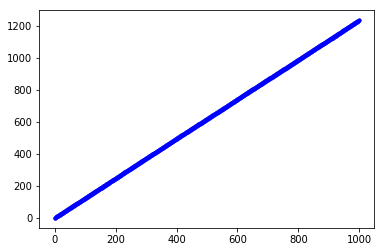

In [71]:
plt.plot(np.arange(Times), TOTALREWARD / epochN, 'b.')
plt.show()

The main problem is about randomness. If you on the first step take something, which results better than zero, you'll take only this one till the end. 

We can't prevent it with $\pi_1(a)$ initialization, cause everything distributes randomly and we can't guess the perfect one for sure. 


#### $\varepsilon$-greedy policy
The previous approach only exploits the environment. However, agent should spend some time learning probability distribtion of rewards, to maximize its reward in the long term. Thus is a question of balance **exploration** and **exploitation**.

Possible improvement:
$$\pi_t(a)=\frac{1-\varepsilon}{|\mathcal{A}_t|}[a \in A_t] + \frac{\varepsilon}{|\mathcal{A}|},\ \varepsilon \in [0, 1].$$

#### Exercises
1. Implement this policy.
2. What happens if you increase $\varepsilon$?
3. How do you change $\varepsilon$ during agent learning?
4. Check this policy on model problem, using different $\varepsilon$.

In [72]:
def epsGreedyPolicy(bestOptions, eps):
    probabilities = np.zeros(bestSize)
    probabilities.fill((1 - eps) / bestSize)
    probabilities.resize(Actions)
    probabilities += eps / Actions
    policy = stats.rv_discrete(name='eps_greedy', values=(bestOptions, probabilities))
    return stats.rv_discrete.rvs(policy)

In [73]:
Actions = 100
Times = 1000
Expecteds = np.random.normal(0, 1, Actions)
automats = np.zeros(shape=(Actions, 1000))
for i in range(Actions):
    automats[i] =  np.random.normal(Expecteds[i], 1, 1000)

bestOptions = np.arange(Actions)
bestSize = Actions

Q = np.zeros(shape=Actions, dtype=float)
uses = np.zeros(shape=Actions, dtype=float)

totalReward = np.zeros(shape=Times, dtype=float)
TOTALREWARD = np.zeros(shape=Times, dtype=float)

epochN = 100

In [74]:
for epoch in range(epochN):
    for t in range(1, Times):
        curAction = epsGreedyPolicy(bestOptions, 0.05)
        reward = np.random.choice(automats[curAction])
        Q[curAction] = (Q[curAction] * uses[curAction] + reward) / (uses[curAction] + 1)
        uses[curAction] += 1
        
        bestOptions = np.where(Q[:] == np.amax(Q[:]))
        bestOptions = np.asarray(bestOptions[0])
        bestSize = bestOptions.shape[0]
        #print(bestOptions)
        nonbestOptions = np.where(Q[:] != np.amax(Q[:]))
        nonbestOptions = np.asarray(nonbestOptions[0])       

        bestOptions = np.concatenate([bestOptions, nonbestOptions])

        totalReward[t] = totalReward[t - 1] + reward
    if epoch % 100 == 99:
        print(epoch + 1)
    TOTALREWARD = np.add(TOTALREWARD, totalReward)

100


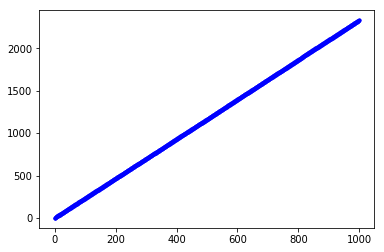

2330.3516468511316 2.401195836124825


In [80]:
plt.plot(np.arange(Times), TOTALREWARD / 100, 'b.')
plt.show()
print(TOTALREWARD[Times - 1] / 100, np.amax(Expecteds))

The greater $\varepsilon$ makes more randomness. 

If we start with $\varepsilon \sim 1$, and during train we decrease it, that means that we will try more automats before we choose the most efficient one.

#### Softmax
One more interpretation of $\varepsilon$-greedy policy

$$\pi_t(a)=\frac{\exp(\frac{1}{\varepsilon} \cdot Q_t(a))}{\sum_{b} \exp(\frac{1}{\varepsilon} \cdot Q_t(b))},\ \varepsilon >0.$$

#### Exercises
1. Implement this policy.
2. What happens if $\varepsilon \rightarrow 0$? What about $\varepsilon \rightarrow \infty$?
3. Compare softmax and $\varepsilon$-greedy policy on model problem.

In [88]:
def softamxPolicy(Q, eps):
    probabilities = Q
    probabilities /= eps
    probabilities = math.e ** probabilities
    
    summa = sum(probabilities)
    
    probabilities /= summa

    policy = stats.rv_discrete(name='softmax', values=(bestOptions, probabilities))
    return stats.rv_discrete.rvs(policy)

In [104]:
Actions = 100
Times = 1000
Expecteds = np.random.normal(0, 1, Actions)
automats = np.zeros(shape=(Actions, 1000))
for i in range(Actions):
    automats[i] =  np.random.normal(Expecteds[i], 1, 1000)

bestOptions = np.arange(Actions)
bestSize = Actions

Q = np.zeros(shape=Actions, dtype=float)
uses = np.zeros(shape=Actions, dtype=float)

totalReward = np.zeros(shape=Times, dtype=float)
TOTALREWARD = np.zeros(shape=Times, dtype=float)

epochN = 100

In [105]:
for epoch in range(epochN):
    for t in range(1, Times):
        curAction = epsGreedyPolicy(Q, 0.6)
        reward = np.random.choice(automats[curAction])
        Q[curAction] = (Q[curAction] * uses[curAction] + reward) / (uses[curAction] + 1)
        uses[curAction] += 1
        totalReward[t] = totalReward[t - 1] + reward
    if epoch % 100 == 99:
        print(epoch + 1)
    TOTALREWARD = np.add(TOTALREWARD, totalReward)

100


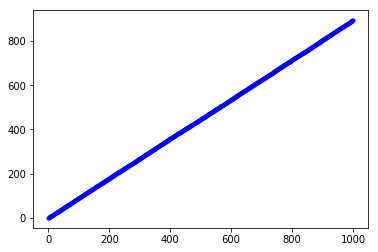

894.1146352155151 2.52130461838084


In [106]:
plt.plot(np.arange(Times), TOTALREWARD / epochN, 'b.')
plt.show()
print(TOTALREWARD[Times - 1] / epochN, np.amax(Expecteds))

#### UCB (upper confidence bound)
For each moment $t$ agent defines the most potentially profitable actions. Agent choice of $a \in A_t$ in accordance with following rule
$$\mathcal{A}_t = \arg\max Q_t(a) + \varepsilon \sqrt{\frac{2 \ln t}{c_t(a)}},\ \varepsilon \geq 0$$

The first part is well known, but the second summand is measure of how accurate agent estimates $Q_t(a)$ at this moment. The policy itself balances between exploration and exploitation. This policy can be considired as optimal in some sense, more inforamtion [here](http://homes.di.unimi.it/~cesabian/Pubblicazioni/ml-02.pdf).

#### Exercises
1. Implement policy.
2. What happens if $\varepsilon \rightarrow 0$? What about $\varepsilon \rightarrow \infty$?
3. Compare this policy with softmax and $\varepsilon$-greedy policy.

In [16]:
def greedyPolicy(bestOptions):
    probabilities = np.zeros(bestSize)
    probabilities.fill(1 / bestSize)
    probabilities.resize(Actions)
    policy = stats.rv_discrete(name='greedy', values=(bestOptions, probabilities))
    return stats.rv_discrete.rvs(policy)

In [17]:
Actions = 100
Times = 1000
Expecteds = np.random.normal(0, 1, Actions)
automats = np.zeros(shape=(Actions, 1000))
for i in range(Actions):
    automats[i] =  np.random.normal(Expecteds[i], 1, 1000)

bestOptions = np.arange(Actions)
bestSize = Actions

Q = np.zeros(shape=Actions, dtype=float)
uses = np.zeros(shape=Actions, dtype=float)
targetUCB = np.zeros(shape=Actions, dtype=float)

totalReward = np.zeros(shape=Times, dtype=float)
TOTALREWARD = np.zeros(shape=Times, dtype=float)

epochN = 100
eps = 0.1

In [19]:
for epoch in range(epochN):
    for t in range(1, Times):
        curAction = greedyPolicy(bestOptions)
        reward = np.random.choice(automats[curAction])
        Q[curAction] = (Q[curAction] * uses[curAction] + reward) / (uses[curAction] + 1)
        uses[curAction] += 1
        
        curGrowth = eps * math.sqrt(2 * math.log(t) / uses[curAction])
        targetUCB = Q + curGrowth
        
        bestOptions = np.where(targetUCB[:] == np.amax(targetUCB[:]))
        bestOptions = np.asarray(bestOptions[0])
        bestSize = bestOptions.shape[0]
        #print(bestOptions)
        nonbestOptions = np.where(targetUCB[:] != np.amax(targetUCB[:]))
        nonbestOptions = np.asarray(nonbestOptions[0])       

        bestOptions = np.concatenate([bestOptions, nonbestOptions])

        totalReward[t] = totalReward[t - 1] + reward
    if epoch % 100 == 0:
        print(epoch + 1)
    TOTALREWARD = np.add(TOTALREWARD, totalReward)

1


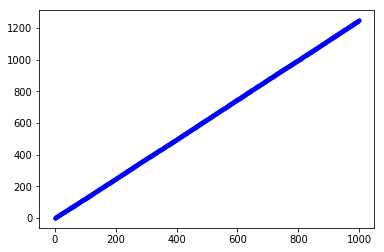

1249.8167819774221 2.7215784659438294


In [13]:
plt.plot(np.arange(Times), TOTALREWARD / epochN, 'b.')
plt.show()
print(TOTALREWARD[Times - 1] / epochN, np.amax(Expecteds))

#### Gradient policy
There are also adaptive policy. They can be used, if the environment is not stationary (the distribution of rewards may slowly change). In this case, it is proposed to use the already familiar exponential smoothing
We find smoothed average reward at moment $t$ for all actions:
$$\bar{r}_{t+1} = (1-\alpha_t)\cdot\bar{r}_t(a)+\alpha_t r_{t+1} = \bar{r}_t +\alpha_t (r_{t+1}-\bar{r}_t(a)),\ \alpha_t \in [0, 1].$$

**Hint** Сonvergence condition
* $\sum^{\infty} \alpha_t = \infty$
* $\sum^{\infty} \alpha^2_t < \infty$

By the way, if $\alpha_t = \frac{1}{t}$, then $\bar{r}_{t+1}$ is just average of all $r_t$.

For each action we have some priority $p_t(a)$. After each step we make following update
$$p_{t+1}(a) = p_t(a)+\lambda(r_t-\bar{r}_t)(1-\pi_t(a)), \text{ $a$ is choosen,}$$

$$p_{t+1}(a) = p_t(a)-\lambda(r_t-\bar{r}_t)\pi_t(a), \text{ another case.}$$

So policy $\pi_{t+1}$ looks like:
$$\pi_{t+1}(a) = \frac{\exp(p_{t+1}(a))}{\sum_{b} \exp(p_{t+1}(b))}$$
More details about this method you can find in the book.

#### Exercise
1. Implement policy.
2. In conclusion, try to understand which model is better for our problem.

In [104]:
def policy(vec = None):
    probabilities = priority
    probabilities = math.e ** probabilities
    
    summa = np.sum(probabilities)
    
    probabilities /= summa
    policy = stats.rv_discrete(name='gradient', values=(bestOptions, probabilities))
    
    probabilities += (1 - np.sum(probabilities)) / Actions
    if vec == None:
        return stats.rv_discrete.rvs(policy)
    else:
        return probabilities
    

In [105]:
Actions = 100
Times = 1000
Expecteds = np.random.normal(0, 1, Actions)
automats = np.zeros(shape=(Actions, 1000))
for i in range(Actions):
    automats[i] =  np.random.normal(Expecteds[i], 1, 1000)

bestOptions = np.arange(Actions)
bestSize = Actions

Q = np.zeros(shape=Actions, dtype=float)
uses = np.zeros(shape=Actions, dtype=float)
priority = np.zeros(shape=Actions, dtype=float)
alphas = np.zeros(shape=Times, dtype=float)
averageReward = 0
reward = 0

totalReward = np.zeros(shape=Times, dtype=float)
TOTALREWARD = np.zeros(shape=Times, dtype=float)

epochN = 100
lamda = 0.1
eps = 0.1

In [106]:
for epoch in range(epochN):
    for t in range(1, Times):
        prevReward = reward
        prevAverageReward = averageReward
        
        curAction = policy()
        reward = np.random.choice(automats[curAction])
        averageReward = (1 - alphas[t]) * averageReward + alphas[t] * reward
        
        prevPolicy = policy(True)
        prevPriorityCur = priority[curAction]
        priority = priority - lamda * (prevReward - prevAverageReward) * prevPolicy
        priority[curAction] = prevPriorityCur + lamda * (prevReward - prevAverageReward) * (1 - prevPolicy[a])

        uses[curAction] += 1

        totalReward[t] = totalReward[t - 1] + reward
    #if epoch % 100 == 0:
    print(epoch + 1)
    TOTALREWARD = np.add(TOTALREWARD, totalReward)

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100


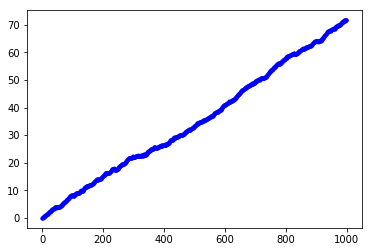

71.62348726019113 2.6198417057293972


In [107]:
plt.plot(np.arange(Times), TOTALREWARD / epochN, 'b.')
plt.show()
print(TOTALREWARD[Times - 1] / epochN, np.amax(Expecteds))

### 2. Markov decison process
#### Problem statement
Now agent acts in some environment with finite set of states $\mathcal{S}$. At moment $t$ agent at state $s_t$ can choose action $a_t \in \mathcal{A}_{s_t} \subset \mathcal{A}$. After agent's action, environment moves it to state $s_{t+1}$ and give reward $r_{t+1}$. Environment behaviour is defined with
$$p(s_{t+1}, r_{t+1}|s_t, a_t)  = \Pr\{ S_{t+1} = s_{t+1}, R_{t+1} =  r_{t+1} | S_t = s_t, A_t = a_t\}.$$

Agent has some policy $\pi$, which at moment $t$ defines probabilty of action $a_t \in \mathcal{A}_{s_t}$ for state $s_t$ $\pi_t(a_t|s_t) = p(a_t|s_t)$. Informally agent needs to maximize the total reward. If the decision process is finite, the problem is formalized as maximizing
$$G = \sum_{t=0}^{T} R_{t+1},$$
here $T$ – moment of time, when agent achives final state. We will consider this value as a random. If the process can last very long or infinite time than we have dealing with a discounted reward
$$ G_t = \sum_{k=0}^{\infty} \gamma^{k} R_{t+k+1},$$
here $\gamma \in [0, 1]$ defines how deep we look into the future.

The probability that the process moves into its new state is influenced by the chosen action. Specifically, it is given by the state transition function. Thus, the next state  depends on the current state and the decision maker's action. But given state and action, it is conditionally independent of all previous states and actions, in other words, the state transitions of an MDP satisfies the Markov property.

#### Exercises
1. Give life example of Markov decision process (it may be any game, etc.).
2. Can you give an example where a decision can't be modeled with a Markov process?
3. Using $p(s_{t+1}, r_{t+1}|s_t, a_t)$, find values below (all distribution are discrete):
  * $r(s_{t}, a_{t}) = \mathbb{E}[R_{t+1}|S_t = s_t, A_t = a_t]$ – average reward for action $a_t$ in state $s_t$ 
  * $p(s_{t+1} | s_t, a_t) = \Pr\{S_{t+1} = s_{t+1} | S_t = s_t, A_t = a_t \}$ – probability to move from $s_t$ to $s_{t+1}$, making $a_t$.
  * $r(s_t, a_t, s_{t+1}) = \mathbb{E}[R_{t+1}|S_{t+1} = s_{t+1}, S_t = s_t, A_t = a_t]$ – average reward when moving from $s_t$ to $s_{t+1}$, making $a_t$.

#### #1: Pinball. In each state you choose action, then ball moves, so we get reward from touching something (depends on action) and ball's place changes as well.

#### Let's show #3:
1) $\mathbb{E}[R_{t + 1} | S_t = s_t, A_t = a_t] = \sum_i r_i \mathbb{P}[R_{t + 1} = r_i | S_t = s_t, A_t = a_t] = $

$ = \sum_i r_i \sum_{j} p(s_j, r_i | s_t, a_t)$

2) $\mathbb{P}[S_{t+1} = s_{t+1} | S_t = s_t, A_t = a_t] = \sum_i p(s_{t + 1}, r_i | s_t, a_t)$

3) --

I'm not experinced it conditional expectation, so I probalby leave it here :(

#### Main definitions 
State-value function under the strategy of $\pi$ returns for state $s$ total reward, that agent gets, starting from $s$
$$V^\pi(s) = \mathbb{E}[G_t|S_t=s] = \mathbb{E}\Big[\sum_{k=0}^{\infty} \gamma^{k+1}R_{t+k+1}|S_t=s\Big].$$

Action-value function under the strategy $\pi$ for action $a$ and state $s$ returns total reward that agent gets, starting from $s$ and making $a$
$$Q^\pi(s, a) = \mathbb{E}[G_t|S_t=s, A_t=a] = \mathbb{E}\Big[\sum_{k=0}^{\infty} \gamma^{k+1}R_{t+k+1}|S_t=s,  A_t=a\Big].$$

Thus we have following equations (the first two are Bellman equations):

$$V^{\pi}(s) = \mathbb{E}\big[R_{t+1} + \gamma V^{\pi}(S_{t+1}) | S_t=s\big]$$

$$Q^{\pi}(s, a) = \mathbb{E}\big[R_{t+1} + \gamma Q^{\pi}(S_{t+1}, A_{t+1}) | S_t=s, A_t=a\big]$$

$$Q^{\pi}(s, a) = \mathbb{E}\big[R_{t+1} + \gamma V^{\pi}(S_{t+1}) | S_t=s, A_t=a\big]$$

#### Remark
It is important to note that policy $\pi$ is fixed and doesn't change with time. Although in real practice it is not true, because our strategy is constantly updating when agent learns environment.
Policy $\pi^{*}$ is optimal, if for each state $s$ and any other policy $\pi$ it is true that $V_{\pi^{*}}(s) \geq V_{\pi}(s)$. Posibly, there are several different optimal policies, however functions $V(s)$ and $Q(s, a)$, which they defines are the same. So, we denote these functions $V^*(s)$ и $Q^*(s, a)$ as optimal.

Equations below are Bellman optimality equations (more info [here](https://en.wikipedia.org/wiki/Bellman_equation):
$$V^*(s) = \max_{a \in \mathcal{A}} \mathbb{E}\big[R_{t+1} + \gamma V^*(S_{t+1}) | S_t=s, A_t=a\big]$$
$$Q^*(s, a) = \mathbb{E}\big[R_{t+1} + \gamma \max_{b \in \mathcal{A}} Q^*(S_{t+1}, b) | S_t=s, A_t=a\big]$$

Then the following two greedy strategies are equivalent and optimal ($\mathcal{A}_t$ – set):
$$\mathcal{A}_t = \arg\max_{a \in \mathcal{A}} \mathbb{E}\big[R_{t+1} + \gamma V^*(s_{t+1}) | s_t, a \big]$$
$$\mathcal{A}_t = \arg\max_{a \in \mathcal{A}} Q^*(s_t, a)$$

#### Dynamic programming
This part is based on the fact, that $p(s',r|s,a)$ is known.

#### Iterative policy evaluation
Let agent has some fixed policy $\pi$, then for $V^{\pi}$ we have
$$V^{\pi}(s) = \sum_a \pi(a|s) \sum_{s',r} p(s',r|s,a) \big[r + \gamma V^{\pi}(s') \big]$$

For simplicity we assume that the distribution of rewards is discrete random variable. Otherwise, it is necessary to use operator of integration instead of sum. For each state $s$ we can can evaluate $V^{\pi}$, using iterative algorithm ($V_0$ is initialized randomly)
$$V_{n+1}(s) = \sum_a \pi(a|s) \sum_{s',r} p(s',r|s,a) \big[r + \gamma V_n(s') \big].$$

By the way, if $s$ is a final state, then $V(s)$ is already known and we may use this value as initialization for faster convergence. The computation stops when $V(s)$ varies negligible from iteration to iteration.

#### Remarks
1. We make assumption that $p(s',r|s,a)$ is known, but it's often not truth in practice.
2. Compution of $V_{n+1}$ can be done **in place**, it accelerates convergence, since in the process of computation we will use the values from iteration $n$ and some new values from iteration $n+1$.

#### Policy improvement theorem
Suppose there are policies $\pi$ and $\pi'$, and for each state $s$ we have
$$Q^{\pi}(s, \pi'(s)) \geq V^{\pi}(s),$$
then the following inequality holds
$$V^{\pi'}(s) \geq V^{\pi}(s).$$

The main interest of this theorem is that it allows us to improve the current policy. We know how to calculate $V^{\pi}(s)$, so

$$
Q^{\pi}(s, a) =
\mathbb{E}\big[R_{t+1} + \gamma V^{\pi}(S_{t+1}) | S_t=s, A_t=a\big] =
\sum_{s',r}p(s',r|s, a)\big[ r + \gamma V^{\pi}(s') \big]
$$

In this way we can improve our policy
$$\pi'(a) = \arg\max_a Q^{\pi}(s, a).$$
The writing above means, that policy chooses action uniformly among all optimal actions. If we can't improve $V^{\pi}$, then out state-value function is optimal and satisfies the equation the Bellman equation. So, policy, which defines this policy, is also optimal.

#### Policy interation
Performing alternately calculation of $V^{\pi}$ and improving $\pi$, we can find optimal policy $\pi^*$. It should be noted that as initialization values of $V(s)$ you may use state-value function from previous iteration, it helps significantly speeds up the convergence of the algorithm.

#### Value interation
There is also interesting approach to compute $V^{*}(s)$ of optimal strategy $\pi^{*}$
$$V_{n+1}(s) = \max_a \sum_{s',r} p(s',r|s,a) \big[r + \gamma V_n(s') \big].$$

You may understand this method in the following way. On the one hand we in greedy manner update state value function during each iteration of value function evaluation. On the other hand we use Bellman equation to evaluate $V^{*}$ iteratively. It's rather practical method.

#### Exercises
1. Let you environment have 100 states. The distribution function $p(s',r|s,a)$ may be defined by your own.
2. Fix some discount value and find optimal policy.
3. What method is faster? For any state $s$, check how $V^*(s)$ varies during $\gamma$ changing.
4. Plot $\gamma \times V^*(s)$ for some 5 states.

### 3. Model problem
As a model problem we choose tic-tac-toe game. One agent plays against another, so environament for each player is its opponent. The set of states $\mathcal{S}_{X}$ is all possible positions of tic-tac-toe game for Xs and the set $\mathcal{S}_{O}$ defined in the same way for Os. You need to train both agents during some series of games where they play with each other. The criterion of success – both agent don't lose human.

### 4. Temporal difference
The speech will focus on more practical methods. Let imagine that we evaluate $V^{\pi}(s)$ for our policy $\pi$. Our agent visited state $s_t$ and we know total reward $G_t$. When agent visites the state $s_t$, we can improve estimation of $V^{\pi}$ using exponential smoothing
$$V^{\pi}_{n+1}(s_t) = V_{n}^{\pi}(s_t) + \alpha \big(G_t - V_{n}^{\pi}(s_t)\big).$$

However, you can make some trick and rewrite $G_t$
$$V_{n+1}^{\pi}(s_t) = V_{n}^{\pi}(s_t) + \alpha \big(R_t + \gamma V^{\pi}(S_{t+1}) - V_{n}^{\pi}(s_t)\big),$$
so we can update $V^{\pi}(s_t)$ after each visiting $s_t$. Similarly, we can compute
$$Q_{n+1}(s_t, a_t) = Q_{n}(s_t, a_t) + \alpha \big(R_{t+1} + \gamma Q^{\pi}(S_{t+1}, A_{t+1}) - Q_{n}^{\pi}(s_t, a_t)\big).$$

#### SARSA (State-Action-Reward-State-Action)
So, we want to find optimal policy $\pi^{*}$. Let's suppose we have some initial approximation $Q(s, a)$. We use нее $\varepsilon$-greedy policy $\mathcal{A}_s = \arg\max_{a \in \mathcal{A}} Q(s, a)$. 

$$\pi(a|s)=\frac{1-\varepsilon}{|\mathcal{A}_s|}[a \in \mathcal{A}_s] + \frac{\varepsilon}{|\mathcal{A}|},\ \varepsilon \in [0, 1].$$

In accordance with policy $\pi$ we choose $a_t$ and get reward $R_{t+1}$, after that environment move agent to state $S_{t+1}$. Agent one more time choose action $A_{t+1} \sim \pi(a|S_{t+1})$ and doesn't act in the environemnt, but only update $Q$ function
$$Q(s_t, a_t) = Q(s_t, a_t) + \alpha \big(R_{t+1} + \gamma Q^{\pi}(S_{t+1}, A_{t+1}) - Q^{\pi}(s_t, a_t)\big).$$

Also, there is more variation of this idea, that uses expected Q-value.
$$Q(s_t, a_t) = Q(s_t, a_t) + \alpha \big(R_{t+1} + \gamma \sum_b \pi(b|S_{t+1}) Q^{\pi}(S_{t+1}, b) - Q^{\pi}(s_t, a_t)\big).$$
So we use $\varepsilon$-greedy approach to improve our policy and evaluate.

####  Q-learning
The idea of this method is rather similar, but we also greedy update action-value function $Q$ 
$$Q(s_t, a_t) = Q(s_t, a_t) + \alpha \big(R_{t+1} + \gamma \max_{b} Q(S_{t+1}, b) - Q(s_t, a_t)\big).$$ For choosing actions during learning agent can use any policy, e.g. $\varepsilon$-greedy or softmax policy.

#### Exercises
1. Implement both algorithm for our model problem.
2. Which one converges faster? How can you estimate it?
3. Compare how action-value function $Q(s_t, a_t)$ differs for these two methods.
4. Try to play with your agents...
5. Use intentionally losing strategy for Os. What happened?
6. Try to beat the agent for Xs.

### Let's start with O-s. Gonna implement Q-learning.

In [157]:
def epsGreedyPolicy(bestOptions, eps): ## Definetly for both modes
    probabilities = np.zeros(bestSize)
    probabilities.fill((1 - eps) / bestSize)
    probabilities.resize(bestOptions.shape[0])
    probabilities += eps / bestOptions.shape[0]
    policy = stats.rv_discrete(name='eps_greedy', values=(bestOptions, probabilities))
    return stats.rv_discrete.rvs(policy)

In [158]:
#3 6 | 7 | 8
# ----------
#2 3 | 4 | 5
# ----------
#1 0 | 1 | 2
#  a  b  c
def toAction(turn): ## For player only
    return int(ord(turn[0]) - ord('a') + 3 * (ord(turn[1]) - ord('1')))
    

In [159]:
def isGame(curStat): ## Definetly for both modes
    # Horizontal
    if (curStat[0] == curStat[1] ==curStat[2]) and curStat[0] != '-':
        return curStat[0]
    if (curStat[3] == curStat[4] == curStat[5]) and curStat[3] != '-':
        return curStat[3]
    if (curStat[6] == curStat[7] ==curStat[8]) and curStat[6] != '-':
        return curStat[6]
    # Vertical
    if (curStat[0] == curStat[3] == curStat[6]) and curStat[0] != '-':
        return curStat[0]
    if (curStat[1] == curStat[4] == curStat[7]) and curStat[1] != '-':
        return curStat[1]
    if (curStat[2] == curStat[5] == curStat[8]) and curStat[2] != '-':
        return curStat[2]
    # Diagonal
    if (curStat[0] == curStat[4] == curStat[8]) and curStat[0] != '-':
        return curStat[0]
    if (curStat[2] == curStat[4] == curStat[6]) and curStat[2] != '-':
        return curStat[2]
    return '-'
    

In [160]:
def toReward(curState, curPlayer): ## Remaked
    if curPlayer == 'O':
        anotherPlayer = 'X'
    else:
        anotherPlayer = 'O'
    if isGame(curState) == curPlayer:
        return 1
    else:
        for i in range(9):
            if curState[i] == '-':
                newTempState = [0 for j in range(9)]
                for k in range(9):
                    newTempState[k] = curState[k]
                newTempState[i] = anotherPlayer
                if isGame(newTempState) == anotherPlayer:
                    return -1
        return 0

In [161]:
def toNum(state): ## Definetly for both modes
    res = 0
    for i in range(9):
        if state[i] == 'X':
            res += 3 ** i
        elif state[i] == 'O':
            res += 2 * 3 ** i
    return res

In [162]:
def choise(newStat, newStatNum, side): ## Done, I guess
    print(newStatNum)
    print(Q_O.shape)
    actionPool = []
    funcPool = []
    for i in range(9):
        if newStat[i] == '-':
            actionPool.append(i)
            if side == 'O':
                funcPool.append(Q_O[i, newStatNum])
            else:
                funcPool.append(Q_X[i, newStatNum])
    print("Act:", actionPool, "Func", funcPool)
    maxVal = max(funcPool)
    bestOps = []
    for i in range(len(actionPool)):
        if funcPool[i] == maxVal:
            bestOps.append(actionPool[i])

    bestSz = len(bestOps)

    bestOps = np.asarray(bestOps)
    nonbestOptions = []
    for i in range(len(actionPool)):
        if funcPool[i] != maxVal:
            nonbestOptions.append(actionPool[i])
    nonbestOptions = np.asarray(nonbestOptions)       
    bestOps = np.concatenate([bestOps, nonbestOptions])
    return bestOps, bestSz, maxVal

In [163]:
def printBoard(state): ## Definetly for both modes
    print(state[6], "|", state[7], "|", state[8])
    print("__|___|__")
    print(state[3], "|", state[4], "|", state[5])
    print("__|___|__")
    print(state[0], "|", state[1], "|", state[2])
    print("\n\n")

In [189]:
alpha = 0.4 ## HZ
gamma = 0.2 ## bad one

Actions = 9

bestOptions = np.arange(Actions)
bestSize = Actions

stateNum = 3**9

Q_X = np.zeros(shape=(Actions, stateNum), dtype=float)
Q_O = np.zeros(shape=(Actions, stateNum), dtype=float)
epochN = 10000

# Man vs machine

In [185]:
 for epoch in range(epochN):
    print("Start:")
    
    curState = ['-' for i in range(9)]
    isNotEnd = True
    # First turn
    turn = input() # a1...c3
    myAction = toAction(turn)
    curState[myAction] = 'X'
    newState = [0 for i in range(9)]
    for i in range(9):
        newState[i] = curState[i]

    
    printBoard(curState)
    newStateNum = toNum(newState)
    
    bestOptions, bestSize, _ = choise(newState, newStateNum, 'O')

    #bestOptions = [0,1,2,3,4,5,6,7,8]
    #bestOptions.remove(myAction)
    #bestSize = 8
    bestOptions = np.asarray(bestOptions)
    
    for twoTurns in range(4):
        print("Best Options:", bestOptions)
        curAction = epsGreedyPolicy(bestOptions, 0.1)

     
        newState[curAction] = 'O'
        curStateNum = toNum(curState)

        if isGame(newState) == 'O':
            Q_O[curAction, curStateNum] = Q_O[curAction, curStateNum] + alpha * (reward -  Q_O[curAction, curStateNum])
            printBoard(newState)
            break
 
        printBoard(newState)
        reward = toReward(newState, 'O')
        print("Reward:", reward)
#############################################
        turn = input() # a1...c3
        myAction = toAction(turn)
        newState[myAction] = 'X'
        
                
        curStateNum = toNum(curState)
        newStateNum = toNum(newState)
        
        if isGame(newState) == 'X':
            Q_O[curAction, curStateNum] = Q_O[curAction, curStateNum] + alpha * (reward -  Q_O[curAction, curStateNum])
            printBoard(newState)
            break
        
        printBoard(newState)

        bestOptions, bestSize, maxValue = choise(newState, newStateNum, 'O')

        Q_O[curAction, curStateNum] = Q_O[curAction, curStateNum] + alpha * (reward + gamma * maxValue -  Q_O[curAction, curStateNum])
#################################################
        for i in range(9):
            curState[i] = newState[i]


Start:
b2
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Best Options: [0. 1. 2. 3. 5. 6. 7. 8.]
O | - | -
__|___|__
- | X | -
__|___|__
- | - | -



Reward: 0
a1
O | - | -
__|___|__
- | X | -
__|___|__
X | - | -



1540
(9, 19683)
Act: [1, 2, 3, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Best Options: [1. 2. 3. 5. 7. 8.]
O | - | -
__|___|__
- | X | -
__|___|__
X | - | O



Reward: -1
c3
O | - | X
__|___|__
- | X | -
__|___|__
X | - | O



Start:
b2
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Best Options: [0. 1. 2. 3. 5. 6. 7. 8.]
- | - | O
__|___|__
- | X | -
__|___|__
- | - | -



Reward: 0
a3
X | - | O
__|___|__
- | X | -
__|___|__
- | - | -



13932
(9, 19683)
Act: [0, 1, 2, 3, 5, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Best Options: [0. 1. 2. 3. 5. 7.]
X | - | O
__|___|__
- | X | -
__|__

KeyboardInterrupt: 

# Machine vs machine

In [191]:
 for epoch in range(epochN):
    print("Start:")
    
    oldState = ['-' for i in range(9)]
    curState = ['-' for i in range(9)]
    newState = ['-' for i in range(9)]

    curPlayer = 'X'
    otherPlayer = 'O'
    turn = 1
    print("=\n=\n=\n=\n=\n")
    while turn <= 9:
        curStateNum = toNum(curState)

        bestOptions, bestSize, maxValue = choise(curState, curStateNum, curPlayer)
        bestOptions = np.asarray(bestOptions)

        curAction = epsGreedyPolicy(bestOptions, 0.1)

        newState[curAction] = curPlayer
        curStateNum = toNum(curState)
        
        reward = toReward(newState, curPlayer)
        print("Reward:", reward)

        if isGame(newState) == curPlayer:
            if curPlayer == 'O':
                Q_O[curAction, curStateNum] = Q_O[curAction, curStateNum] + alpha * (reward -  Q_O[curAction, curStateNum])
            else:
                Q_X[curAction, curStateNum] = Q_X[curAction, curStateNum] + alpha * (reward -  Q_X[curAction, curStateNum])                
            printBoard(newState)
            break
        printBoard(newState)

#############################################
        olsStateNum = toNum(oldState)
        curStateNum = toNum(curState)
        newStateNum = toNum(newState)
        
        if otherPlayer == 'X':
            Q_X[curAction, olsStateNum] = Q_X[curAction, olsStateNum] + alpha * (reward + gamma * maxValue -  Q_X[curAction, olsStateNum])
        elif turn != 1:
            Q_O[curAction, olsStateNum] = Q_O[curAction, olsStateNum] + alpha * (reward + gamma * maxValue -  Q_O[curAction, olsStateNum])
#################################################
        for i in range(9):
            oldState[i] = curState[i]
        for i in range(9):
            curState[i] = newState[i]
        turn += 1
        curPlayer, otherPlayer = otherPlayer, curPlayer


Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | - | -



6561
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | O | -
__|___|__
- | - | -



6723
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | O | -
__|___|__
- | - | X



6732
(9, 19683)
Act: [0, 1, 3, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
O | - | X
__|___|__
- | O | -
__|___|__
- | - | X



8190
(9, 19683)
Act: [0, 1, 3, 5, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | X
__|___|__
X | O | -
__|___|__
- | - | X



8217
(9, 19683)
Act: [0, 1, 5, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
O | O | X
__|___|__
X | O | -
__|___|__
- | - | X



12591
(9, 19683)
Act: [0, 1, 5] Func [0.0, 0.0, 0.0]
Reward: -1
O | O | X
__|___|__
X | O | -
__|___|__
X | - | X



12592
(9

- | X | -



15015
(9, 19683)
Act: [0, 2, 7] Func [0.0, 0.0, 0.0]
Reward: -1
O | X | O
__|___|__
X | O | X
__|___|__
- | X | -



17202
(9, 19683)
Act: [0, 2] Func [0.0, 0.0]
Reward: 1
O | X | O
__|___|__
X | O | X
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | X
__|___|__
- | - | -



405
(9, 19683)
Act: [0, 1, 2, 3, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | X
__|___|__
- | X | -



408
(9, 19683)
Act: [0, 2, 3, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | X
__|___|__
O | X | -



410
(9, 19683)
Act: [2, 3, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | -
__|___|__
- | O | X
__|___|__
O | X | X



419
(9, 19683)


Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
O | - | -



2189
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
O | - | X



2198
(9, 19683)
Act: [1, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | O | -
__|___|__
O | - | X



2360
(9, 19683)
Act: [1, 3, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | X | -
__|___|__
- | O | -
__|___|__
O | X | X



2363
(9, 19683)
Act: [3, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: 1
- | X | O
__|___|__
- | O | -
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0,

Act: [0, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
X | X | -



4378
(9, 19683)
Act: [2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | O
__|___|__
- | - | -
__|___|__
X | X | -



17500
(9, 19683)
Act: [2, 3, 4, 5, 6] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | O
__|___|__
- | X | -
__|___|__
X | X | -



17581
(9, 19683)
Act: [2, 3, 5, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | O
__|___|__
- | X | -
__|___|__
X | X | O



17599
(9, 19683)
Act: [3, 5, 6] Func [0.0, 0.0, 0.0]
Reward: -1
X | O | O
__|___|__
- | X | -
__|___|__
X | X | O



18328
(9, 19683)
Act: [3, 5] Func [0.0, 0.0]
Reward: 0
X | O | O
__|___|__
O | X | -
__|___|__
X | X | O



18382
(9, 19683)
Act: [5] Func [0.0]
Reward: 0
X | O | O
__|___|__
O | X | X
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- 

Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | O
__|___|__
- | - | -



513
(9, 19683)
Act: [0, 1, 2, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | O
__|___|__
X | - | -



514
(9, 19683)
Act: [1, 2, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | -
__|___|__
X | - | O
__|___|__
X | O | -



520
(9, 19683)
Act: [2, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | O
__|___|__
X | O | X



529
(9, 19683)
Act: [4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
X | - | O
__|___|__
X | O | X



1987
(9, 19683)
Act: [4, 7, 8] Func [0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
X | X | O
__|___|__
X | O | X



2068
(9, 19683)
Act: [7, 8] Func [0.0, 0.0]
Reward: 0
O | - | O
__|___|__
X | X | O
__|___|__
X | O | X



15190
(9, 19683)
Act: [7]

- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
- | - | X



1467
(9, 19683)
Act: [0, 1, 3, 4, 5, 7, 8] Func [0.0, -0.4, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
X | - | -
__|___|__
- | - | X



1494
(9, 19683)
Act: [0, 1, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
X | - | O
__|___|__
- | - | X



1980
(9, 19683)
Act: [0, 1, 4, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | X
__|___|__
X | - | O
__|___|__
- | - | X



8541
(9, 19683)
Act: [0, 1, 4, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | X
__|___|__
X | - | O
__|___|__
O | - | X



8543
(9, 19683)
Act: [1, 4, 7] Func [0.0, 0.0, 0.0]
Reward: 0
O | - | X
__|___|__
X | X | O
__|___|__
O | - | X



8624
(9, 19683)
Act: [1, 7] Func [0.0, 0.0]
Reward: 0
O | - | X
__|___|__
X | X | O
__|___|__
O | O | X



8630
(9, 19683)
Act: [7] Func [0.0]
Reward: 0
O | X 

Reward: -1
O | O | X
__|___|__
O | X | O
__|___|__
- | X | X



13026
(9, 19683)
Act: [0] Func [0.0]
Reward: 1
O | O | X
__|___|__
O | X | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
- | - | X



13131
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
X | - | X



13132
(9, 19683)
Act: [1, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | O
__|___|__
- | O | -
__|___|__
X | - | X



13294
(9, 19683)
Act: [1, 3, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | O
__|___|__
- | O | -
__|___|__
X | - | X



15481
(9, 19683)
Act: [1, 3, 5, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | X | O
__|

Reward: -1
X | - | X
__|___|__
O | - | -
__|___|__
O | X | O



7367
(9, 19683)
Act: [4, 5, 7] Func [0.0, 0.0, 0.0]
Reward: 0
X | - | X
__|___|__
O | X | -
__|___|__
O | X | O



7448
(9, 19683)
Act: [5, 7] Func [0.0, 0.0]
Reward: -1
X | - | X
__|___|__
O | X | O
__|___|__
O | X | O



7934
(9, 19683)
Act: [7] Func [0.0]
Reward: 1
X | X | X
__|___|__
O | X | O
__|___|__
O | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | X | X
__|___|__
- | - | -



378
(9, 19683)
Act: [0, 1, 2, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
O | X | X
__|___|__
- | - | -




Reward: -1
- | - | -
__|___|__
X | X | O
__|___|__
O | X | O



617
(9, 19683)
Act: [6, 7, 8] Func [0.0, 0.0, 0.0]
Reward: 1
- | X | -
__|___|__
X | X | O
__|___|__
O | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | - | -



6561
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
- | - | -



10935
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
- | X | -
__|___|__
- | - | -



11016
(9, 19683)
Act: [0, 1, 2, 3, 5, 6] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | X
__|___|__
- | X | -
__|___|__
- | - | O



11034
(9, 19683)
Act: [0, 1, 3, 5, 6] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | O | X
__|___|__
- | X | -
__|___|__
- | - | O



11763
(9, 19683)
Act: [0, 1, 3, 5] Func [0.0, 0.0, 0.0, 0.0]
Reward:

X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | O | -
__|___|__
- | - | -



189
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | O | X
__|___|__
- | - | -



432
(9, 19683)
Act: [0, 1, 2, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
X | O | X
__|___|__
- | - | -



1890
(9, 19683)
Act: [0, 1, 2, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
O | - | -
__|___|__
X | O | X
__|___|__
- | X | -



1893
(9, 19683)
Act: [0, 2, 7, 8] Func [0.0, 0.0, -0.4, 0.0]
Reward: 0
O | - | O
__|___|__
X | O | X
__|___|__
- | X | -



15015
(9, 19683)
Act: [0, 2, 7] Func [0.0, 0.0, 0.0]
Reward: -1
O | - | O
__|___|__
X | O | X
__|___|__
- | X | X



15024
(9, 19683)
Act: [0, 7] Func [0.0, 0.0]
Reward: 1
O | - | O
__|___|__
X | O | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 

X | O | O
__|___|__
- | X | X
__|___|__
O | X | O



18572
(9, 19683)
Act: [3] Func [0.0]
Reward: 1
X | O | O
__|___|__
X | X | X
__|___|__
O | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
O | - | -



29
(9, 19683)
Act: [1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, -0.4, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
O | - | X



38
(9, 19683)
Act: [1, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
O | O | X



44
(9, 19683)
Act: [4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | X | -
__|___|__
O | O | X



125
(9, 19683)
Act: [5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | -
__|___|__
X | X | O
__|_

Reward: 0
- | O | X
__|___|__
X | X | -
__|___|__
O | O | X



11060
(9, 19683)
Act: [5, 6] Func [0.0, 0.0]
Reward: -1
- | O | X
__|___|__
X | X | O
__|___|__
O | O | X



11546
(9, 19683)
Act: [6] Func [0.4]
Reward: 1
X | O | X
__|___|__
X | X | O
__|___|__
O | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | X | -



165
(9, 19683)
Act: [0, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | O | -
__|___|__
- | X | -



6726
(9, 19683)
Act: [0, 2, 3, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
- | O | -
__|___|__
- | X | -



11100
(9, 19683)
Act: [0, 2, 3, 5, 6] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
- | O | X
__|_

__|___|__
- | O | X



1149
(9, 19683)
Act: [0, 3, 7, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
- | O | X
__|___|__
- | O | X



14271
(9, 19683)
Act: [0, 3, 7] Func [0.0, 0.0, 0.0]
Reward: -1
X | - | O
__|___|__
X | O | X
__|___|__
- | O | X



14298
(9, 19683)
Act: [0, 7] Func [0.0, 0.0]
Reward: 1
X | - | O
__|___|__
X | O | X
__|___|__
O | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | O



19
(9, 19683)
Act: [1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, -0.4, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | X | O



22
(9, 19683)
Act: [3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
X | X | O



1480
(9, 19683)


Reward: 1
O | O | X
__|___|__
X | X | X
__|___|__
O | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
X | - | -
__|___|__
- | - | -



4401
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, -0.4, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
X | - | -
__|___|__
- | - | X



4410
(9, 19683)
Act: [0, 1, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
X | O | -
__|___|__
- | - | X



4572
(9, 19683)
Act: [0, 1, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | -
__|___|__
X | O | -
__|___|__
X | - | X



4573
(9, 19683)
Act: [1, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | O
__|___|__
X | O | -
__|___|__
X | - | X



17695
(9, 19683)
Act: [1, 5, 6] Func [0.0, 0.0, 0.0]
Reward: 1


Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | O



747
(9, 19683)
Act: [0, 1, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
X | - | O



748
(9, 19683)
Act: [1, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | -
__|___|__
- | - | O
__|___|__
X | - | O



1234
(9, 19683)
Act: [1, 3, 4, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 1
X | - | -
__|___|__
X | - | O
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 

Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
X | - | X



172
(9, 19683)
Act: [1, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | -
__|___|__
O | O | -
__|___|__
X | - | X



226
(9, 19683)
Act: [1, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | -
__|___|__
O | O | -
__|___|__
X | - | X



955
(9, 19683)
Act: [1, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
O | O | -
__|___|__
X | O | X



961
(9, 19683)
Act: [5, 7, 8] Func [0.0, 0.0, 0.0]
Reward: -1
X | - | X
__|___|__
O | O | -
__|___|__
X | O | X



7522
(9, 19683)
Act: [5, 7] Func [0.0, 0.0]
Reward: 1
X | - | X
__|___|__
O | O | O
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - 

Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
O | - | -



29
(9, 19683)
Act: [1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, -0.4, 0.0]
Reward: 0
X | - | -
__|___|__
X | - | -
__|___|__
O | - | -



758
(9, 19683)
Act: [1, 2, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, -0.4]
Reward: 0
X | - | -
__|___|__
X | - | O
__|___|__
O | - | -



1244
(9, 19683)
Act: [1, 2, 4, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | X | -
__|___|__
X | - | O
__|___|__
O | - | -



3431
(9, 19683)
Act: [1, 2, 4, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | X | -
__|___|__
X | - | O
__|___|__
O | O | -



3437
(9, 19683)
Act: [2, 4, 8] Func [0.0, 0.0, 0.0]
Reward: 1
X | X | X
__|___|__
X | - | O
__|___|__
O | O | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | 

Reward: 0
O | X | X
__|___|__
X | O | O
__|___|__
O | - | X



10892
(9, 19683)
Act: [1] Func [0.0]
Reward: 0
O | X | X
__|___|__
X | O | O
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | O



2205
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | X | O



2208
(9, 19683)
Act: [0, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | X | -
__|___|__
- | - | O
__|___|__
- | X | O



2694
(9, 19683)
Act: [0, 3, 4, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | X | -
__|___|__
- | - | O
__|___|__
X | X | O



2695
(9, 19683)
Act: [3, 4, 6, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|__

- | O | -
__|___|__
O | - | X
__|___|__
- | - | X



4680
(9, 19683)
Act: [0, 1, 4, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
O | X | X
__|___|__
- | - | X



4761
(9, 19683)
Act: [0, 1, 6, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | -
__|___|__
O | X | X
__|___|__
O | - | X



4763
(9, 19683)
Act: [1, 6, 8] Func [0.0, 0.0, 0.0]
Reward: 1
X | O | -
__|___|__
O | X | X
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | O | -
__|___|__
- | - | -



2349
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 8] Func [-0.4, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | X
__|___|__
- | O | -
__|___|__
- | - | -



8910
(9, 19683)
Act: [0, 1, 2, 3, 5, 6] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | X | X

Reward: 1
X | O | O
__|___|__
X | X | X
__|___|__
O | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | X | -



4377
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, -0.64, 0.0, 0.0, -0.24]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
X | X | -



4378
(9, 19683)
Act: [2, 3, 4, 5, 6, 8] Func [0.0, 0.0, -0.4, 0.0, 0.0, 0.0]
Reward: -1
- | O | -
__|___|__
- | - | O
__|___|__
X | X | -



4864
(9, 19683)
Act: [2, 3, 4, 6, 8] Func [0.0, 0.0, -0.4, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
- | - | O
__|___|__
X | X | -



11425
(9, 19683)
Act: [2, 3, 4, 6] Func [0.0, 0.0, 0.0, -0.144]
Reward: -1
- | O | X
__|___|__
- | O | O
__|___|__
X | X | -



11587
(9, 19683)
Act: [2, 3, 6] Func [0.0, 0.0, 0.0]
Re

O | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | O | -



7
(9, 19683)
Act: [2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, -0.4, 0.0, -0.64, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
X | O | -



34
(9, 19683)
Act: [2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | -
__|___|__
X | O | -
__|___|__
X | O | -



196
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
X | O | -
__|___|__
X | O | -



2383
(9, 19683)
Act: [2, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
O | X | -
__|___|__
X | O | -
__|___|__
X | O | -



3841
(9, 19683)
Act: [2, 5, 8] Func [0.0, 0.0, 0.0]
Reward: -1
O | X | -
__|___|__
X | O | X
__|___|__
X | O | -



408

X | - | -



13852
(9, 19683)
Act: [1, 2, 3, 4, 5, 7] Func [-0.4, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | O | O
__|___|__
- | - | -
__|___|__
X | - | -



18226
(9, 19683)
Act: [1, 2, 3, 4, 5] Func [0.0, 0.0, 0.0, -0.4, 0.0]
Reward: 1
X | O | O
__|___|__
X | - | -
__|___|__
X | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
X | - | -



4375
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 8] Func [0.0, -0.64, 0.0, 0.0, -0.64, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | X | -
__|___|__
X | - | -



4456
(9, 19683)
Act: [1, 2, 3, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | O
__|___|__
- | X | -
__|___|__
X | - | -



17578
(9, 19683)
Act: [1, 2, 3, 5, 6] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | O
__


9051
(9, 19683)
Act: [0, 2, 4, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | X | X
__|___|__
O | - | X
__|___|__
- | O | O



9069
(9, 19683)
Act: [0, 4, 6] Func [0.0, 0.0, 0.0]
Reward: -1
- | X | X
__|___|__
O | X | X
__|___|__
- | O | O



9150
(9, 19683)
Act: [0, 6] Func [0.0, 0.0]
Reward: -1
O | X | X
__|___|__
O | X | X
__|___|__
- | O | O



10608
(9, 19683)
Act: [0] Func [0.0]
Reward: 1
O | X | X
__|___|__
O | X | X
__|___|__
X | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
- | - | -
__|___|__
- | - | -



13851
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7] Func [0.0, 0.0, -0.4, -0.4, 0.0, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
- | - | X
__|___|__
- | - | -



14094
(9, 19683)
Act: [0, 1, 2, 3, 4, 7] Func [0.0, 0.0, 0.0, 0.0, 0.

Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | O | -



735
(9, 19683)
Act: [0, 2, 3, 4, 5, 7, 8] Func [-0.4, 0.0, -0.4, -0.4, 0.0, -0.64, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | X
__|___|__
- | O | -



978
(9, 19683)
Act: [0, 2, 3, 4, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
O | - | X
__|___|__
- | O | -



1032
(9, 19683)
Act: [0, 2, 4, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | X
__|___|__
O | - | X
__|___|__
- | O | -



7593
(9, 19683)
Act: [0, 2, 4, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | X
__|___|__
O | O | X
__|___|__
- | O | -



7755
(9, 19683)
Act: [0, 2, 7] Func [0.0, 0.0, 0.0]
Reward: -1
X | - | X
__|___|__
O | O | X
__|___|__
X | O | -



7756
(9, 19683)
Act: [2, 7] Func [0.0, 0.0]
Reward: -1
X | - | X
__|___|__
O | O | X
__|___|__
X | O | O



7774
(9, 19683)
Act: [7] Func [0.0]
Reward: 1
X | X | X
__|___|__
O | O | X
__|___|__
X | O |

Reward: 1
- | O | -
__|___|__
X | X | X
__|___|__
O | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | - | -



6561
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
- | - | -



10935
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6] Func [0.0, 0.0, -0.4, -0.24, 0.0, -0.64, -0.4]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
- | X | -



10938
(9, 19683)
Act: [0, 2, 3, 4, 5, 6] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
- | O | -
__|___|__
- | X | -



11100
(9, 19683)
Act: [0, 2, 3, 5, 6] Func [0.0, 0.0, 0.0, 0.0, -0.4]
Reward: 0
- | O | X
__|___|__
- | O | X
__|___|__
- | X | -



11343
(9, 19683)
Act: [0, 2, 3, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
O | O | X
__|___|__
- | O | X
__|___|__
- | X | -



12801
(9, 19683)
Act: [0, 2, 3] Func [0.0, 0.4, 0.0]

- | O | X
__|___|__
- | - | -
__|___|__
- | X | -



10938
(9, 19683)
Act: [0, 2, 3, 4, 5, 6] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
O | X | -



10940
(9, 19683)
Act: [2, 3, 4, 5, 6] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
- | - | X
__|___|__
O | X | -



11183
(9, 19683)
Act: [2, 3, 4, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | X
__|___|__
O | - | X
__|___|__
O | X | -



11237
(9, 19683)
Act: [2, 4, 6] Func [0.0, 0.0, 0.0]
Reward: 1
- | O | X
__|___|__
O | - | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.64, -0.4, -0.64, 0.0, 0.0, -0.4, 0.0]
Reward: 0
- | 

Reward: -1
- | - | O
__|___|__
O | X | -
__|___|__
- | X | -



13260
(9, 19683)
Act: [0, 2, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.4]
Reward: 1
- | X | O
__|___|__
O | X | -
__|___|__
- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | X | -



57
(9, 19683)
Act: [0, 2, 4, 5, 6, 7, 8] Func [-0.4, 0.0, 0.0, 0.0, -0.4, -0.4, -0.4]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | X | X



66
(9, 19683)
Act: [0, 4, 5, 6, 7, 8] Func [0.0, -0.4, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | -
__|___|__
O | - | O
__|___|__
- | X | X



552
(9, 19683)
Act: [0, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 1
- | - | -
__|___|__
O | - | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6

- | - | X
__|___|__
- | - | -



5346
(9, 19683)
Act: [0, 1, 2, 3, 4, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | O | -
__|___|__
O | - | X
__|___|__
- | - | -



5400
(9, 19683)
Act: [0, 1, 2, 4, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | O | -
__|___|__
O | - | X
__|___|__
X | - | -



5401
(9, 19683)
Act: [1, 2, 4, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
X | O | -
__|___|__
O | - | X
__|___|__
X | - | O



5419
(9, 19683)
Act: [1, 4, 8] Func [0.0, 0.0, 0.0]
Reward: 0
X | O | X
__|___|__
O | - | X
__|___|__
X | - | O



11980
(9, 19683)
Act: [1, 4] Func [0.0, 0.0]
Reward: -1
X | O | X
__|___|__
O | - | X
__|___|__
X | O | O



11986
(9, 19683)
Act: [4] Func [0.0]
Reward: 1
X | O | X
__|___|__
O | X | X
__|___|__
X | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.

- | - | -



6561
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
O | - | -
__|___|__
- | - | -



6615
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
O | - | -
__|___|__
- | X | -



6618
(9, 19683)
Act: [0, 2, 4, 5, 6, 7] Func [0.0, -0.4, 0.0, 0.0, -0.4, 0.0]
Reward: 0
- | O | X
__|___|__
O | - | -
__|___|__
- | X | -



10992
(9, 19683)
Act: [0, 2, 4, 5, 6] Func [-0.4, 0.0, -0.4, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
O | - | -
__|___|__
- | X | X



11001
(9, 19683)
Act: [0, 4, 5, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | X
__|___|__
O | - | O
__|___|__
- | X | X



11487
(9, 19683)
Act: [0, 4, 6] Func [0.0, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
O | X | O
__|___|__
- | X | X



11568
(9, 19683)
Act: [0, 6] Func [0.0, 0.0]
Reward: -1
O | O | X
__|___|__
O | X | O
__|___|__
- | X | X



13026
(9, 19683)
Act: [0] Func [0.4]
Reward: 1
O | O | X
__|

X | O | X
__|___|__
X | - | O
__|___|__
- | X | O



12198
(9, 19683)
Act: [0, 4] Func [0.0, 0.0]
Reward: -1
X | O | X
__|___|__
X | O | O
__|___|__
- | X | O



12360
(9, 19683)
Act: [0] Func [0.0]
Reward: 1
X | O | X
__|___|__
X | O | O
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | X
__|___|__
- | - | -



1701
(9, 19683)
Act: [0, 1, 2, 3, 4, 7, 8] Func [-0.4, 0.0, 0.0, 0.0, 0.0, -0.4, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | X
__|___|__
- | - | X



1710
(9, 19683)
Act: [0, 1, 3, 4, 7, 8] Func [0.0, 0.0, 0.0, 0.0, -0.4, 0.0]
Reward: -1
O | - | -
__|___|__
O | - | X
__|___|__
- | - | X



1764
(9, 19683)
Act: [0, 1, 4, 7, 8] Func [0.0, 0.0, -0.4, 0.0, 0.0]
Reward: -1
O | X | -
__|___|__
O | - | X
__|___

Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
X | X | -



490
(9, 19683)
Act: [2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
O | - | -
__|___|__
- | - | O
__|___|__
X | X | -



1948
(9, 19683)
Act: [2, 3, 4, 7, 8] Func [0.0, -0.4, 0.0, 0.0, 0.0]
Reward: 1
O | - | -
__|___|__
- | - | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
O | - | -



29
(9, 19683)
Act: [1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, -0.4, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | X
__|___|__
O | - | -



272
(9, 19683)
Act: [1, 2, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.03200000000000001, 0.0, 0.0]
Reward: -1
O | - | -
__|___|__
X | - | X
__|___|__
O | - | -



1730
(9, 19683)
Act: [1, 2, 4, 7, 

Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
O | - | -



6563
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, -0.4, -0.4, -0.24, 0.0, 0.0]
Reward: 0
X | - | X
__|___|__
- | - | -
__|___|__
O | - | -



7292
(9, 19683)
Act: [1, 2, 3, 4, 5, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | X
__|___|__
- | - | O
__|___|__
O | - | -



7778
(9, 19683)
Act: [1, 2, 3, 4, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | X
__|___|__
- | - | O
__|___|__
O | - | X



7787
(9, 19683)
Act: [1, 3, 4, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | X
__|___|__
- | O | O
__|___|__
O | - | X



7949
(9, 19683)
Act: [1, 3, 7] Func [0.0, 0.0, 0.0]
Reward: -1
X | - | X
__|___|__
- | O | O
__|___|__
O | X | X



7952
(9, 19683)
Act: [3, 7] Func [0.0, 0.0]
Reward: 0
X | O | X
__|___|__
- | O | O
__|___|__
O | X | X



12326
(9, 19683)
Act: [3] Func [0.0]
Reward: 0
X | O | X
__|___|__
X | O | O
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func

Reward: 1
X | - | X
__|___|__
O | O | O
__|___|__
X | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
O | - | -



731
(9, 19683)
Act: [1, 2, 3, 4, 5, 7, 8] Func [0.0, -0.24, -0.4, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
O | X | -



734
(9, 19683)
Act: [2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
- | - | -
__|___|__
O | X | -



13856
(9, 19683)
Act: [2, 3, 4, 5, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | O
__|___|__
- | - | X
__|___|__
O | X | -



14099
(9, 19683)
Act: [2, 3, 4, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
X | O | O
__|___|__
- | - | X
__|___|__
O | X | -



18473
(9, 19683)
Act: [2, 3, 4] Func [-0.4, -0.4, 0.0]
Reward

Reward: 0
- | - | -
__|___|__
X | - | O
__|___|__
- | - | -



513
(9, 19683)
Act: [0, 1, 2, 4, 6, 7, 8] Func [0.0, -0.64, -0.4, 0.0, 0.0, 0.0, -0.4]
Reward: 0
- | X | -
__|___|__
X | - | O
__|___|__
- | - | -



2700
(9, 19683)
Act: [0, 1, 2, 4, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
X | - | O
__|___|__
- | - | O



2718
(9, 19683)
Act: [0, 1, 4, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | X | -
__|___|__
X | - | O
__|___|__
- | X | O



2721
(9, 19683)
Act: [0, 4, 6, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
X | O | O
__|___|__
- | X | O



2883
(9, 19683)
Act: [0, 6, 8] Func [0.0, 0.0, 0.0]
Reward: -1
X | X | -
__|___|__
X | O | O
__|___|__
- | X | O



3612
(9, 19683)
Act: [0, 8] Func [0.0, 0.0]
Reward: 1
X | X | O
__|___|__
X | O | O
__|___|__
- | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | -

X | - | -
__|___|__
- | - | O
__|___|__
- | - | X



1224
(9, 19683)
Act: [0, 1, 3, 4, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | O
__|___|__
- | - | O
__|___|__
- | - | X



14346
(9, 19683)
Act: [0, 1, 3, 4, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
- | - | O
__|___|__
- | X | X



14349
(9, 19683)
Act: [0, 3, 4, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | O
__|___|__
O | - | O
__|___|__
- | X | X



14403
(9, 19683)
Act: [0, 4, 7] Func [0.0, 0.0, 0.0]
Reward: -1
X | X | O
__|___|__
O | - | O
__|___|__
- | X | X



16590
(9, 19683)
Act: [0, 4] Func [0.0, 0.0]
Reward: -1
X | X | O
__|___|__
O | - | O
__|___|__
O | X | X



16592
(9, 19683)
Act: [4] Func [0.0]
Reward: 1
X | X | O
__|___|__
O | X | O
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Fun

Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | O | -



87
(9, 19683)
Act: [0, 2, 3, 5, 6, 7, 8] Func [0.0, -0.4, 0.0, -0.4, 0.0, -0.4, 0.0]
Reward: 0
- | - | -
__|___|__
X | X | -
__|___|__
- | O | -



114
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, -0.4]
Reward: 0
- | - | -
__|___|__
X | X | O
__|___|__
- | O | -



600
(9, 19683)
Act: [0, 2, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, -0.4]
Reward: 0
- | X | -
__|___|__
X | X | O
__|___|__
- | O | -



2787
(9, 19683)
Act: [0, 2, 6, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | O
__|___|__
X | X | O
__|___|__
- | O | -



15909
(9, 19683)
Act: [0, 2, 6] Func [0.0, 0.0, 0.0]
Reward: -1
- | X | O
__|___|__
X | X | O
__|___|__
X | O | -



15910
(9, 19683)
Act: [2, 6] Func [0.0, 0.0]
Reward: 0
O | X | O
__|___|__
X | X | O
__|___|__
X | O | -



17368
(9, 19683)
Act: [2] Func [0.0]
Reward: 0
O | X | O
__|___|__
X | X | O
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0

Reward: 1
- | X | X
__|___|__
O | X | O
__|___|__
- | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | - | X



171
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [0.0, 0.0, -0.4, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | X
__|___|__
- | - | X



414
(9, 19683)
Act: [0, 1, 3, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, -0.4, 0.0]
Reward: -1
O | - | -
__|___|__
- | O | X
__|___|__
- | - | X



1872
(9, 19683)
Act: [0, 1, 3, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 1
O | - | X
__|___|__
- | O | X
__|___|__
- | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 196

6579
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7] Func [-0.24, 0.0, -0.4, -0.4, -0.4, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | X | O



6582
(9, 19683)
Act: [0, 3, 4, 5, 6, 7] Func [-0.4, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | O | -
__|___|__
- | X | O



6744
(9, 19683)
Act: [0, 3, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | X
__|___|__
X | O | -
__|___|__
- | X | O



6771
(9, 19683)
Act: [0, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
X | O | -
__|___|__
O | X | O



6773
(9, 19683)
Act: [5, 6, 7] Func [0.0, 0.0, 0.0]
Reward: -1
- | - | X
__|___|__
X | O | X
__|___|__
O | X | O



7016
(9, 19683)
Act: [6, 7] Func [0.0, 0.0]
Reward: 0
- | O | X
__|___|__
X | O | X
__|___|__
O | X | O



11390
(9, 19683)
Act: [6] Func [0.0]
Reward: 0
X | O | X
__|___|__
X | O | X
__|___|__
O | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | -

- | - | X
__|___|__
O | - | -



14096
(9, 19683)
Act: [1, 2, 3, 4, 7] Func [0.0, -0.4, 0.0, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
- | X | X
__|___|__
O | - | -



14177
(9, 19683)
Act: [1, 2, 3, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | O
__|___|__
- | X | X
__|___|__
O | O | -



14183
(9, 19683)
Act: [2, 3, 7] Func [0.0, 0.0, 0.0]
Reward: 1
X | - | O
__|___|__
X | X | X
__|___|__
O | O | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | O



19
(9, 19683)
Act: [1, 3, 4, 5, 6, 7, 8] Func [-0.24, 0.0, 0.0, 0.0, -0.544, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
X | - | O



100
(9, 19683)
Act: [1, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | -
__|___|__
O | X |

Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
X | - | X



13132
(9, 19683)
Act: [1, 3, 4, 5, 6, 7] Func [0.0, -0.4, -0.4, -0.24, 0.0, 0.0]
Reward: -1
O | - | O
__|___|__
- | - | -
__|___|__
X | - | X



14590
(9, 19683)
Act: [1, 3, 4, 5, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
O | - | O
__|___|__
- | X | -
__|___|__
X | - | X



14671
(9, 19683)
Act: [1, 3, 5, 7] Func [0.0, 0.0, 0.0, 0.4]
Reward: 1
O | O | O
__|___|__
- | X | -
__|___|__
X | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
X | - | -
__|___|__
- | - | -



1485
(9, 19683)
Act: [0, 1, 2, 4, 5, 7, 8] Func [0.0, 0.0, -0.4, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | X | -
__|___|__
X | - | -
__|___|__
- | - | -



3672
(9, 19683)
Act: [0, 1, 2, 4, 5, 8] Func [0.0, 0.0, 

__|___|__
- | O | O
__|___|__
X | O | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
X | - | -
__|___|__
- | - | -



13149
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7] Func [-0.144, 0.0, 0.0, 0.0, -0.4, -0.4, 0.0]
Reward: 0
- | X | O
__|___|__
X | - | -
__|___|__
- | - | -



15336
(9, 19683)
Act: [0, 1, 2, 4, 5, 6] Func [-0.4, 0.0, 0.0, -0.4, 0.0, 0.0]
Reward: 0
- | X | O
__|___|__
X | - | -
__|___|__
- | O | -



15342
(9, 19683)
Act: [0, 2, 4, 5, 6] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | O
__|___|__
X | X | -
__|___|__
- | O | -



15423
(9, 19683)
Act: [0, 2, 5, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | X | O
__|___|__
X | X | -
__|___|__
O | O | -



15425
(9, 19683)
Act: [2, 5, 6] Func [0.0, 0.0, 0.0]
Reward: 1
- | X | O
_

O | X | -
__|___|__
X | X | O



13279
(9, 19683)
Act: [5, 6, 7] Func [0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
O | X | X
__|___|__
X | X | O



13522
(9, 19683)
Act: [6, 7] Func [0.0, 0.0]
Reward: 0
- | O | O
__|___|__
O | X | X
__|___|__
X | X | O



17896
(9, 19683)
Act: [6] Func [0.0]
Reward: 0
X | O | O
__|___|__
O | X | X
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | - | X



63
(9, 19683)
Act: [0, 1, 4, 5, 6, 7, 8] Func [0.0, -0.64, 0.0, 0.0, 0.0, -0.4, -0.4]
Reward: 0
- | - | -
__|___|__
O | - | X
__|___|__
- | - | X



306
(9, 19683)
Act: [0, 1, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | -
__|___|__
O | O | X
__|___|__
- | - | X



468
(9, 19683)
Act: [0, 1

X | - | -



13123
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, -0.4, -0.9222400000000001]
Reward: 0
- | - | O
__|___|__
X | - | -
__|___|__
X | - | -



13150
(9, 19683)
Act: [1, 2, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | O
__|___|__
X | - | O
__|___|__
X | - | -



13636
(9, 19683)
Act: [1, 2, 4, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | O
__|___|__
X | X | O
__|___|__
X | - | -



13717
(9, 19683)
Act: [1, 2, 6, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | O
__|___|__
X | X | O
__|___|__
X | - | -



15175
(9, 19683)
Act: [1, 2, 7] Func [0.0, 0.0, 0.0]
Reward: -1
O | - | O
__|___|__
X | X | O
__|___|__
X | X | -



15178
(9, 19683)
Act: [2, 7] Func [0.0, 0.4]
Reward: 1
O | O | O
__|___|__
X | X | O
__|___|__
X | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0

Reward: 0
- | O | -
__|___|__
X | - | X
__|___|__
- | X | O



4665
(9, 19683)
Act: [0, 4, 6, 8] Func [-0.4, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
X | O | X
__|___|__
- | X | O



4827
(9, 19683)
Act: [0, 6, 8] Func [0.0, 0.0, 0.0]
Reward: -1
- | O | X
__|___|__
X | O | X
__|___|__
- | X | O



11388
(9, 19683)
Act: [0, 6] Func [0.0, 0.0]
Reward: 0
- | O | X
__|___|__
X | O | X
__|___|__
O | X | O



11390
(9, 19683)
Act: [6] Func [0.0]
Reward: 0
X | O | X
__|___|__
X | O | X
__|___|__
O | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
O | - | -



29
(9, 19683)
Act: [1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, -0.1430784, -0.4, 0.0]
Reward: 0
- | - | -
__|___|__
X | X | -
__|___|__
O | - | -



110
(

(9, 19683)
Act: [3, 4, 5] Func [0.0, 0.0, 0.0]
Reward: -1
X | O | X
__|___|__
- | - | X
__|___|__
X | O | O



11932
(9, 19683)
Act: [3, 4] Func [0.0, 0.0]
Reward: 1
X | O | X
__|___|__
- | O | X
__|___|__
X | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.8704000000000001, -0.4, -0.784, 0.0, 0.0, -0.4, 0.0]
Reward: 0
- | O | -
__|___|__
- | X | -
__|___|__
- | - | X



4464
(9, 19683)
Act: [0, 1, 3, 5, 6, 8] Func [-0.4, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | -
__|___|__
O | X | -
__|___|__
- | - | X



4518
(9, 19683)
Act: [0, 1, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, -0.4]
Reward: 0
- | O | X
__|___|__
O | X | -
__|___|__
- | - | X



11079
(9, 

Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
X | - | -
__|___|__
- | - | -



4401
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, -0.24, -0.4, 0.0, 0.0]
Reward: 0
X | O | -
__|___|__
X | - | -
__|___|__
- | - | -



5130
(9, 19683)
Act: [0, 1, 2, 4, 5, 8] Func [0.0, 0.0, 0.0, 0.0, -0.24, 0.0]
Reward: 0
X | O | -
__|___|__
X | - | -
__|___|__
O | - | -



5132
(9, 19683)
Act: [1, 2, 4, 5, 8] Func [-0.4, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | O | -
__|___|__
X | X | -
__|___|__
O | - | -



5213
(9, 19683)
Act: [1, 2, 5, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | O | -
__|___|__
X | X | -
__|___|__
O | O | -



5219
(9, 19683)
Act: [2, 5, 8] Func [0.0, 0.0, 0.0]
Reward: 1
X | O | -
__|___|__
X | X | -
__|___|__
O | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0

Reward: 0
X | - | -
__|___|__
X | - | -
__|___|__
- | - | O



774
(9, 19683)
Act: [0, 1, 4, 5, 7, 8] Func [0.0, 0.0, -0.4, 0.0, -0.4, 0.0]
Reward: -1
X | - | O
__|___|__
X | - | -
__|___|__
- | - | O



13896
(9, 19683)
Act: [0, 1, 4, 5, 7] Func [0.0, -0.64, 0.0, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
X | - | X
__|___|__
- | - | O



14139
(9, 19683)
Act: [0, 1, 4, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | O
__|___|__
X | - | X
__|___|__
- | O | O



14145
(9, 19683)
Act: [0, 4, 7] Func [0.0, 0.0, 0.0]
Reward: -1
X | X | O
__|___|__
X | - | X
__|___|__
- | O | O



16332
(9, 19683)
Act: [0, 4] Func [0.0, 0.0]
Reward: 1
X | X | O
__|___|__
X | - | X
__|___|__
O | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | - | -



6561
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | O
__

Reward: 1
X | - | -
__|___|__
- | X | O
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
X | - | -



487
(9, 19683)
Act: [1, 2, 3, 4, 6, 7, 8] Func [-0.4, 0.0, 0.0, -0.4, -0.784, -0.64, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
X | - | X



496
(9, 19683)
Act: [1, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, -0.4, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
X | O | X



502
(9, 19683)
Act: [3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | O
__|___|__
X | O | X



2689
(9, 19683)
Act: [3, 4, 6, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
O | - | O
__|___|__
X | O | X



2743
(9, 19683)
Act: [4, 6, 8] Func [0.0, 0.0, -0.4]
Reward: -

Reward: -1
O | - | -
__|___|__
X | - | X
__|___|__
O | - | -



1730
(9, 19683)
Act: [1, 2, 4, 7, 8] Func [0.0, -0.4, 0.4, 0.0, -0.4]
Reward: 1
O | - | -
__|___|__
X | X | X
__|___|__
O | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | O



2205
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, -0.4, 0.0, 0.0]
Reward: 0
- | X | X
__|___|__
- | - | -
__|___|__
- | - | O



8766
(9, 19683)
Act: [0, 1, 3, 4, 5, 6] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | X | X
__|___|__
- | O | -
__|___|__
- | - | O



8928
(9, 19683)
Act: [0, 1, 3, 5, 6] Func [-0.4, 0.0, -0.4, -0.4, 0.0]
Reward: 1
X | X | X
__|___|__
- | O | -
__|___|__
- | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3,

O | X | -
__|___|__
- | - | -
__|___|__
- | O | X



3660
(9, 19683)
Act: [0, 3, 4, 5, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | X | -
__|___|__
- | - | -
__|___|__
X | O | X



3661
(9, 19683)
Act: [3, 4, 5, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
O | X | O
__|___|__
- | - | -
__|___|__
X | O | X



16783
(9, 19683)
Act: [3, 4, 5] Func [0.0, 0.0, 0.0]
Reward: 0
O | X | O
__|___|__
- | - | X
__|___|__
X | O | X



17026
(9, 19683)
Act: [3, 4] Func [0.0, 0.0]
Reward: 0
O | X | O
__|___|__
- | O | X
__|___|__
X | O | X



17188
(9, 19683)
Act: [3] Func [0.0]
Reward: 0
O | X | O
__|___|__
X | O | X
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6,

- | O | O
__|___|__
X | - | X



658
(9, 19683)
Act: [1, 3, 6, 7, 8] Func [-0.4, 0.0, 0.0, 0.0, -0.4]
Reward: -1
X | - | -
__|___|__
- | O | O
__|___|__
X | - | X



1387
(9, 19683)
Act: [1, 3, 7, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | O
__|___|__
- | O | O
__|___|__
X | - | X



14509
(9, 19683)
Act: [1, 3, 7] Func [0.0, 0.0, 0.0]
Reward: 1
X | - | O
__|___|__
- | O | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | O



99
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [0.0, 0.0, -0.4, -0.64, -0.64, -0.4, -0.4]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | X | O



102
(9, 19683)
Act: [0, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | -
__|___|__
O | X

Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
O | - | -



29
(9, 19683)
Act: [1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, -0.48328704, -0.4, -0.4]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
O | X | -



32
(9, 19683)
Act: [2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, -0.4, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
O | X | O



50
(9, 19683)
Act: [4, 5, 6, 7, 8] Func [0.0, -0.4, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | X | -
__|___|__
O | X | O



131
(9, 19683)
Act: [5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | O
__|___|__
X | X | -
__|___|__
O | X | O



13253
(9, 19683)
Act: [5, 6, 7] Func [0.0, 0.0, 0.0]
Reward: 1
- | X | O
__|___|__
X | X | -
__|___|__
O | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward

Reward: -1
O | O | X
__|___|__
X | - | O
__|___|__
X | X | O



12928
(9, 19683)
Act: [4] Func [0.4]
Reward: 1
O | O | X
__|___|__
X | X | O
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | - | -



6561
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
- | - | -



10935
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6] Func [0.0, -0.4, -0.4, -0.144, 0.0, -0.784, -0.4]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
X | - | -



10936
(9, 19683)
Act: [1, 2, 3, 4, 5, 6] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | X
__|___|__
- | - | -
__|___|__
X | O | -



10942
(9, 19683)
Act: [2, 3, 4, 5, 6] Func [0.0, 0.0, 0.0, 0.0, -0.4]
Reward: -1
- | O | X
__|___|__
X | - | -
__|___|__
X | O | -



10969
(9, 19683)
Act: [2, 4, 5, 6] Func [0.0, 0.0, -0.4, 0.0]
Reward: -

Reward: 0
- | - | O
__|___|__
- | X | X
__|___|__
X | - | O



13465
(9, 19683)
Act: [1, 3, 6, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | O
__|___|__
- | X | X
__|___|__
X | - | O



17839
(9, 19683)
Act: [1, 3, 6] Func [0.0, 0.0, 0.0]
Reward: 1
- | O | O
__|___|__
X | X | X
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
- | - | X



1467
(9, 19683)
Act: [0, 1, 3, 4, 5, 7, 8] Func [0.0, -0.384, -0.4, 0.0, -0.4, -0.4, 0.0]
Reward: 0
O | - | -
__|___|__
- | X | -
__|___|__
- | - | X



1548
(9, 19683)
Act: [0, 1, 3, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
O | X | -
__|___|__
- | - | X



1602
(9, 19683)
Act: [0, 1, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward

O | X | X



2066
(9, 19683)
Act: [7, 8] Func [0.0, 0.0]
Reward: 0
O | O | -
__|___|__
X | X | O
__|___|__
O | X | X



6440
(9, 19683)
Act: [8] Func [0.0]
Reward: 0
O | O | X
__|___|__
X | X | O
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | O



45
(9, 19683)
Act: [0, 1, 4, 5, 6, 7, 8] Func [0.0, -0.4, 0.0, 0.0, 0.0, 0.0, -0.8704000000000001]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
X | - | O



46
(9, 19683)
Act: [1, 4, 5, 6, 7, 8] Func [-0.4, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | -
__|___|__
X | - | -
__|___|__
X | - | O



4420
(9, 19683)
Act: [1, 4, 5, 6, 8] Func [0.0, -0.4, 0.0, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
X | - | -
__|___|__
X | - | O



10981
(9, 19683)


Reward: 0
- | X | -
__|___|__
- | O | -
__|___|__
- | X | -



2352
(9, 19683)
Act: [0, 2, 3, 5, 6, 8] Func [-0.4, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | O
__|___|__
- | O | -
__|___|__
- | X | -



15474
(9, 19683)
Act: [0, 2, 3, 5, 6] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | X | O
__|___|__
- | O | -
__|___|__
- | X | -



16203
(9, 19683)
Act: [0, 2, 3, 5] Func [0.64, 0.0, 0.0, 0.0]
Reward: 1
X | X | O
__|___|__
- | O | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1459
(9, 19683)
Act: [1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, -0.4, -0.24, -0.4, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
X | - | X



1468
(9, 19683)
Act: [1, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.

Act: [0, 1, 2, 3, 5, 7, 8] Func [-0.64, -0.144, -0.4, -0.4, -0.64, 0.0, -0.4]
Reward: 0
O | X | -
__|___|__
- | X | -
__|___|__
- | - | -



3726
(9, 19683)
Act: [0, 1, 2, 3, 5, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
O | X | -
__|___|__
- | X | -
__|___|__
- | - | O



3744
(9, 19683)
Act: [0, 1, 3, 5, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | X | -
__|___|__
- | X | -
__|___|__
X | - | O



3745
(9, 19683)
Act: [1, 3, 5, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
O | X | -
__|___|__
- | X | O
__|___|__
X | - | O



4231
(9, 19683)
Act: [1, 3, 8] Func [0.0, 0.0, 0.4]
Reward: 1
O | X | X
__|___|__
- | X | O
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
O | - | -



2189
(9, 19683)


Act: [0, 1, 3, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: 1
X | - | X
__|___|__
O | O | O
__|___|__
- | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | - | -



6561
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
O | - | -
__|___|__
- | - | -



6615
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7] Func [0.0, -0.4, 0.0, 0.0, -0.4, 0.0, 0.0]
Reward: 0
- | X | X
__|___|__
O | - | -
__|___|__
- | - | -



8802
(9, 19683)
Act: [0, 1, 2, 4, 5, 6] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | X | X
__|___|__
O | - | -
__|___|__
- | - | -



10260
(9, 19683)
Act: [0, 1, 2, 4, 5] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
O | X | X
__|___|__
O | - | -
__|___|__
- | - | X



10269
(9, 19683)
Act: [0, 1, 4, 5] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
O | X | X
__|___|__
O | - | -
__|___|__
- | O | X



10275
(9, 1968

- | - | -



4455
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 8] Func [-0.24, 0.0, 0.0, 0.0, 0.0, -0.64, -0.24]
Reward: 0
- | O | -
__|___|__
- | X | X
__|___|__
- | - | -



4698
(9, 19683)
Act: [0, 1, 2, 3, 6, 8] Func [-0.4, -0.24, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | O
__|___|__
- | X | X
__|___|__
- | - | -



17820
(9, 19683)
Act: [0, 1, 2, 3, 6] Func [0.0, 0.0, -0.4, 0.0, 0.0]
Reward: 1
- | O | O
__|___|__
X | X | X
__|___|__
- | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
- | - | X



13131
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7] Func [0.0, 0.0, -0.4, -0.64, -0.64, -0.3264, -0.4]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
- | X | X



13134
(9, 19683)
Act: [0, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, -0.

Reward: -1
- | O | X
__|___|__
X | - | -
__|___|__
X | O | -



10969
(9, 19683)
Act: [2, 4, 5, 6] Func [0.0, 0.0, -0.4, 0.0]
Reward: 1
- | O | X
__|___|__
X | O | -
__|___|__
X | O | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | O



45
(9, 19683)
Act: [0, 1, 4, 5, 6, 7, 8] Func [0.0, -0.64, 0.0, 0.0, 0.0, -0.4, -0.8704000000000001]
Reward: 0
X | - | -
__|___|__
X | - | -
__|___|__
- | - | O



774
(9, 19683)
Act: [0, 1, 4, 5, 7, 8] Func [0.0, 0.0, -0.4, -0.4, -0.64, 0.0]
Reward: -1
X | - | O
__|___|__
X | - | -
__|___|__
- | - | O



13896
(9, 19683)
Act: [0, 1, 4, 5, 7] Func [0.0, -0.784, 0.0, 0.0, 0.0]
Reward: 1
X | - | O
__|___|__
X | - | -
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0

Reward: 1
- | O | O
__|___|__
X | X | X
__|___|__
- | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
X | - | -



163
(9, 19683)
Act: [1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, -0.4, 0.0, -0.4, 0.0]
Reward: 0
X | - | -
__|___|__
- | O | -
__|___|__
X | - | -



892
(9, 19683)
Act: [1, 2, 3, 5, 7, 8] Func [-0.4, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | O
__|___|__
- | O | -
__|___|__
X | - | -



14014
(9, 19683)
Act: [1, 2, 3, 5, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
- | O | X
__|___|__
X | - | -



14257
(9, 19683)
Act: [1, 2, 3, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
O | O | X
__|___|__
X | - | -



14311
(9, 19683)
Act: [1, 2, 7] Func [0.0, 0.0, 0.0]
Reward: 0


11751
(9, 19683)
Act: [0, 2, 3, 5] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | O | X
__|___|__
O | X | -
__|___|__
- | O | -



11805
(9, 19683)
Act: [0, 2, 5] Func [0.0, 0.0, 0.0]
Reward: 1
X | O | X
__|___|__
O | X | -
__|___|__
- | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
X | - | -
__|___|__
- | - | -



1485
(9, 19683)
Act: [0, 1, 2, 4, 5, 7, 8] Func [0.0, -0.4, -0.24, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | X
__|___|__
X | - | -
__|___|__
- | - | -



8046
(9, 19683)
Act: [0, 1, 2, 4, 5, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | X
__|___|__
X | - | -
__|___|__
- | O | -



8052
(9, 19683)
Act: [0, 2, 4, 5, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | X
__|___|__
X | - | -
__|___|__
X | O | -



8053
(9,

- | - | -
__|___|__
- | - | -



6561
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
O | - | -
__|___|__
- | - | -



6615
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7] Func [0.0, -0.4, 0.0, 0.0, -0.4, 0.0, 0.0]
Reward: 0
X | - | X
__|___|__
O | - | -
__|___|__
- | - | -



7344
(9, 19683)
Act: [0, 1, 2, 4, 5, 7] Func [-0.24, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | X
__|___|__
O | O | -
__|___|__
- | - | -



7506
(9, 19683)
Act: [0, 1, 2, 5, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | X
__|___|__
O | O | -
__|___|__
- | X | -



7509
(9, 19683)
Act: [0, 2, 5, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | X
__|___|__
O | O | -
__|___|__
- | X | O



7527
(9, 19683)
Act: [0, 5, 7] Func [0.0, 0.0, 0.0]
Reward: 0
X | - | X
__|___|__
O | O | X
__|___|__
- | X | O



7770
(9, 19683)
Act: [0, 7] Func [0.0, 0.0]
Reward: 0
X | O | X
__|___|__
O | O | X
__|___|__
- | X | O



12144
(9, 19683)
Act: [0] Func [0.0]
Reward

- | - | -
__|___|__
- | X | X



18237
(9, 19683)
Act: [0, 3, 4, 5] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | O | O
__|___|__
- | O | -
__|___|__
- | X | X



18399
(9, 19683)
Act: [0, 3, 5] Func [0.4, 0.0, 0.0]
Reward: 1
X | O | O
__|___|__
- | O | -
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | O | -



7
(9, 19683)
Act: [2, 3, 4, 5, 6, 7, 8] Func [-0.4, 0.0, -0.4, -0.64, -0.64, -0.64, -0.9222400000000001]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
X | O | -



34
(9, 19683)
Act: [2, 4, 5, 6, 7, 8] Func [0.0, 0.0, -0.24, 0.0, 0.0, 0.0]
Reward: -1
- | - | -
__|___|__
X | O | -
__|___|__
X | O | -



196
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [-0.4, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | -

11853
(9, 19683)
Act: [0, 1, 2, 5] Func [0.0, 0.0, -0.4, 0.0]
Reward: 1
X | O | X
__|___|__
X | O | -
__|___|__
- | O | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
- | - | X



1467
(9, 19683)
Act: [0, 1, 3, 4, 5, 7, 8] Func [0.0, -0.384, -0.544, 0.0, -0.4, -0.64, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
X | - | X



1468
(9, 19683)
Act: [1, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
X | O | X



1474
(9, 19683)
Act: [3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
X | - | -
__|___|__
X | O | X



1501
(9, 19683)
Act: [4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
X | - | O
__|___|__
X | O | X

Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
- | X | -



1461
(9, 19683)
Act: [0, 2, 3, 4, 5, 7, 8] Func [0.0, -0.4, 0.0, -0.64, -0.4, -0.4, -0.4]
Reward: 0
O | - | -
__|___|__
X | - | -
__|___|__
- | X | -



1488
(9, 19683)
Act: [0, 2, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | O
__|___|__
X | - | -
__|___|__
- | X | -



14610
(9, 19683)
Act: [0, 2, 4, 5, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
O | - | O
__|___|__
X | X | -
__|___|__
- | X | -



14691
(9, 19683)
Act: [0, 2, 5, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
O | - | O
__|___|__
X | X | -
__|___|__
O | X | -



14693
(9, 19683)
Act: [2, 5, 7] Func [0.0, 0.0, 0.0]
Reward: 1
O | X | O
__|___|__
X | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | - | -



6561
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
R

X | - | -



4402
(9, 19683)
Act: [1, 2, 4, 5, 6, 8] Func [0.0, -0.4, -0.24, -0.4, 0.0, -0.368]
Reward: 0
O | O | -
__|___|__
X | - | -
__|___|__
X | - | -



5860
(9, 19683)
Act: [1, 2, 4, 5, 8] Func [0.0, 0.0, 0.0, -0.4, 0.0]
Reward: 0
O | O | X
__|___|__
X | - | -
__|___|__
X | - | -



12421
(9, 19683)
Act: [1, 2, 4, 5] Func [-0.4, 0.0, 0.0, 0.0]
Reward: -1
O | O | X
__|___|__
X | - | O
__|___|__
X | - | -



12907
(9, 19683)
Act: [1, 2, 4] Func [0.0, 0.0, 0.0]
Reward: 0
O | O | X
__|___|__
X | - | O
__|___|__
X | X | -



12910
(9, 19683)
Act: [2, 4] Func [0.0, 0.0]
Reward: -1
O | O | X
__|___|__
X | - | O
__|___|__
X | X | O



12928
(9, 19683)
Act: [4] Func [0.64]
Reward: 1
O | O | X
__|___|__
X | X | O
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 

- | X | -



2406
(9, 19683)
Act: [0, 2, 5, 6, 8] Func [-0.4, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
O | O | X
__|___|__
- | X | -



2649
(9, 19683)
Act: [0, 2, 6, 8] Func [0.0, 0.0, -0.4, 0.0]
Reward: 0
- | X | -
__|___|__
O | O | X
__|___|__
O | X | -



2651
(9, 19683)
Act: [2, 6, 8] Func [0.0, 0.0, 0.0]
Reward: -1
- | X | -
__|___|__
O | O | X
__|___|__
O | X | X



2660
(9, 19683)
Act: [6, 8] Func [0.64, 0.0]
Reward: 1
O | X | -
__|___|__
O | O | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | X | -



57
(9, 19683)
Act: [0, 2, 4, 5, 6, 7, 8] Func [-0.24, -0.4, 0.0, -0.64, -0.4, -0.64, -0.64]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0

(9, 19683)
Act: [0, 3, 5, 6, 7, 8] Func [-0.784, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | -
__|___|__
O | X | -
__|___|__
- | X | O



156
(9, 19683)
Act: [0, 5, 6, 7, 8] Func [0.0, 0.0, -0.4, 0.4, 0.0]
Reward: 0
- | - | -
__|___|__
O | X | X
__|___|__
- | X | O



399
(9, 19683)
Act: [0, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | O
__|___|__
O | X | X
__|___|__
- | X | O



13521
(9, 19683)
Act: [0, 6, 7] Func [0.0, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
O | X | X
__|___|__
- | X | O



14250
(9, 19683)
Act: [0, 7] Func [0.0, 0.0]
Reward: 0
X | O | O
__|___|__
O | X | X
__|___|__
- | X | O



18624
(9, 19683)
Act: [0] Func [0.0]
Reward: 0
X | O | O
__|___|__
O | X | X
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O 

3591
(9, 19683)
Act: [0, 1, 2, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | X | O
__|___|__
X | O | O
__|___|__
- | - | -



16713
(9, 19683)
Act: [0, 1, 2] Func [0.0, 0.0, 0.0]
Reward: 1
X | X | O
__|___|__
X | O | O
__|___|__
X | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
- | X | -



13125
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7] Func [0.0, -0.4, 0.0, 0.0, -0.4, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | X | -
__|___|__
- | X | -



13206
(9, 19683)
Act: [0, 2, 3, 5, 6, 7] Func [-0.4, 0.0, -0.4, 0.0, 0.0, 0.0]
Reward: -1
- | - | O
__|___|__
- | X | -
__|___|__
- | X | O



13224
(9, 19683)
Act: [0, 3, 5, 6, 7] Func [0.0, -0.4, 0.0, -0.64, -0.4]
Reward: 0
- | - | O
__|___|__
- | X | X
__|___|__
- | X | O



1

- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | X | -
__|___|__
- | - | -



1539
(9, 19683)
Act: [0, 1, 2, 3, 5, 7, 8] Func [-0.64, -0.08639999999999999, -0.64, -0.4, -0.64, 0.0, -0.4]
Reward: 0
O | X | -
__|___|__
- | X | -
__|___|__
- | - | -



3726
(9, 19683)
Act: [0, 1, 2, 3, 5, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
O | X | -
__|___|__
- | X | -
__|___|__
O | - | -



3728
(9, 19683)
Act: [1, 2, 3, 5, 8] Func [0.4, 0.0, 0.0, 0.0, 0.0]
Reward: 1
O | X | -
__|___|__
- | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | - | -



6561
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | O
__|___|__
- | - | -



7047
(9, 19683)
Ac

X | - | O
__|___|__
- | X | -
__|___|__
X | - | O



13951
(9, 19683)
Act: [1, 3, 5, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | O
__|___|__
- | X | -
__|___|__
X | O | O



13957
(9, 19683)
Act: [3, 5, 7] Func [0.0, 0.0, 0.0]
Reward: 1
X | - | O
__|___|__
X | X | -
__|___|__
X | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | O



261
(9, 19683)
Act: [0, 1, 3, 4, 6, 7, 8] Func [0.0, -0.64, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
X | - | O



262
(9, 19683)
Act: [1, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, -0.24]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
X | O | O



268
(9, 19683)
Act: [3, 4, 6, 7, 8] Func [0.0, 0.0, -0.4, 0.0, 0.0]
Reward: 0
- | - | 

O | O | -
__|___|__
- | X | X



2415
(9, 19683)
Act: [0, 5, 6, 8] Func [0.0, 0.4, 0.0, 0.0]
Reward: 1
- | X | -
__|___|__
O | O | O
__|___|__
- | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.4, 0.0, -0.4, -0.64, -0.64, 0.0, -0.64]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | X



144
(9, 19683)
Act: [0, 1, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | O
__|___|__
O | X | -
__|___|__
- | - | X



13266
(9, 19683)
Act: [0, 1, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 1
X | - | O
__|___|__
O | X | -
__|___|__
- | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0

X | X | X
__|___|__
- | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | O



261
(9, 19683)
Act: [0, 1, 3, 4, 6, 7, 8] Func [0.0, -0.384, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | X | O



264
(9, 19683)
Act: [0, 3, 4, 6, 7, 8] Func [-0.4, 0.0, 0.0, 0.0, 0.0, -0.4]
Reward: 0
- | O | -
__|___|__
- | - | X
__|___|__
- | X | O



4638
(9, 19683)
Act: [0, 3, 4, 6, 8] Func [-0.4, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | O | -
__|___|__
- | - | X
__|___|__
- | X | O



5367
(9, 19683)
Act: [0, 3, 4, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
X | O | -
__|___|__
- | - | X
__|___|__
O | X | O



5369
(9, 19683)
Act: [3, 4, 8] Func [0.0, 0.0, 0.0]
Reward: 0
X | O | -
__|___|__
- | X | X

O | O | X



7982
(9, 19683)
Act: [7] Func [0.0]
Reward: 1
X | X | X
__|___|__
X | O | O
__|___|__
O | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
O | - | -



731
(9, 19683)
Act: [1, 2, 3, 4, 5, 7, 8] Func [-0.4, -0.24, -0.64, 0.0, -0.4, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | X | -
__|___|__
O | - | -



812
(9, 19683)
Act: [1, 2, 3, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | O | -
__|___|__
- | X | -
__|___|__
O | - | -



5186
(9, 19683)
Act: [1, 2, 3, 5, 8] Func [0.0, 0.4, 0.0, 0.0, 0.0]
Reward: 1
X | O | -
__|___|__
- | X | -
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -

- | - | -



7938
(9, 19683)
Act: [0, 1, 2, 3, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | X
__|___|__
- | O | O
__|___|__
- | - | X



7947
(9, 19683)
Act: [0, 1, 3, 7] Func [0.0, 0.0, 0.4, 0.0]
Reward: -1
X | - | X
__|___|__
- | O | O
__|___|__
O | - | X



7949
(9, 19683)
Act: [1, 3, 7] Func [0.0, 0.0, 0.0]
Reward: 1
X | X | X
__|___|__
- | O | O
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
O | - | -
__|___|__
- | - | -



783
(9, 19683)
Act: [0, 1, 2, 4, 5, 7, 8] Func [-0.8704000000000001, -0.4, 0.0, 0.0, -0.4, -0.64, -0.4]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -



864
(9, 19683)
Act: [0, 1, 2, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | -
__|___|__
O | X | O
_




5005
(9, 19683)
Act: [1, 6, 8] Func [0.4, 0.0, 0.0]
Reward: 1
- | O | -
__|___|__
O | X | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | X
__|___|__
- | - | -



405
(9, 19683)
Act: [0, 1, 2, 3, 6, 7, 8] Func [-0.4, -0.4, 0.0, 0.0, -0.4, -0.64, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | X
__|___|__
- | - | X



414
(9, 19683)
Act: [0, 1, 3, 6, 7, 8] Func [0.0, 0.0, -0.4, 0.0, -0.64, 0.0]
Reward: -1
- | - | -
__|___|__
- | O | X
__|___|__
O | - | X



416
(9, 19683)
Act: [1, 3, 6, 7, 8] Func [-0.4, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | -
__|___|__
X | O | X
__|___|__
O | - | X



443
(9, 19683)
Act: [1, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: 1
- | - | O
__|___|__
X | O | X
__|___|__
O | - | X



Sta

- | O | -
__|___|__
- | - | X
__|___|__
X | O | X



4633
(9, 19683)
Act: [3, 4, 6, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | -
__|___|__
O | - | X
__|___|__
X | O | X



4687
(9, 19683)
Act: [4, 6, 8] Func [0.0, -0.4, 0.0]
Reward: 0
- | O | -
__|___|__
O | X | X
__|___|__
X | O | X



4768
(9, 19683)
Act: [6, 8] Func [0.0, 0.0]
Reward: -1
- | O | O
__|___|__
O | X | X
__|___|__
X | O | X



17890
(9, 19683)
Act: [6] Func [0.0]
Reward: 1
X | O | O
__|___|__
O | X | X
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | O
__|___|__
- | - | -



567
(9, 19683)
Act: [0, 1, 2, 3, 6, 7, 8] Func [-0.4, 0.0, -0.4, 0.0, -0.384, 0.0, -0.4]
Reward: 0
- | - | -
__|___|__
- | X | O
__|___|__
- | X | -



570
(9, 19683)
A

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
O | - | -



29
(9, 19683)
Act: [1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, -0.88337240064, -0.64, -0.24]
Reward: 0
- | - | -
__|___|__
X | - | X
__|___|__
O | - | -



272
(9, 19683)
Act: [1, 2, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.03200000000000001, 0.0, 0.0]
Reward: -1
O | - | -
__|___|__
X | - | X
__|___|__
O | - | -



1730
(9, 19683)
Act: [1, 2, 4, 7, 8] Func [0.0, -0.4, 0.9533440000000001, 0.0, -0.4]
Reward: 1
O | - | -
__|___|__
X | X | X
__|___|__
O | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Fu

(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | X | -
__|___|__
- | - | -



4455
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 8] Func [-0.24, 0.0, 0.0, 0.0, 0.0, -0.64, -0.544]
Reward: 0
- | O | -
__|___|__
- | X | -
__|___|__
- | - | X



4464
(9, 19683)
Act: [0, 1, 3, 5, 6, 8] Func [-0.4, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | O
__|___|__
- | X | -
__|___|__
- | - | X



17586
(9, 19683)
Act: [0, 1, 3, 5, 6] Func [0.0, 0.0, 0.0, -0.4, 0.0]
Reward: -1
- | O | O
__|___|__
- | X | -
__|___|__
X | - | X



17587
(9, 19683)
Act: [1, 3, 5, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: 1
O | O | O
__|___|__
- | X | -
__|___|__
X | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__


Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | O



45
(9, 19683)
Act: [0, 1, 4, 5, 6, 7, 8] Func [0.0, -0.784, 0.0, 0.0, 0.0, -0.4, -0.9222400000000001]
Reward: 0
- | - | -
__|___|__
X | - | X
__|___|__
- | - | O



288
(9, 19683)
Act: [0, 1, 4, 6, 7, 8] Func [-0.24, 0.0, 0.0, 0.0, -0.64, 0.0]
Reward: 0
- | - | -
__|___|__
X | O | X
__|___|__
- | - | O



450
(9, 19683)
Act: [0, 1, 6, 7, 8] Func [0.0, 0.0, 0.0, -0.64, 0.0]
Reward: -1
- | - | -
__|___|__
X | O | X
__|___|__
X | - | O



451
(9, 19683)
Act: [1, 6, 7, 8] Func [-0.4, 0.0, 0.0, 0.0]
Reward: -1
- | - | O
__|___|__
X | O | X
__|___|__
X | - | O



13573
(9, 19683)
Act: [1, 6, 7] Func [-0.64, 0.0, 0.0]
Reward: 1
X | - | O
__|___|__
X | O | X
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 

- | O | -
__|___|__
- | X | O
__|___|__
- | X | -



4944
(9, 19683)
Act: [0, 2, 3, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
- | X | O
__|___|__
- | X | -



11505
(9, 19683)
Act: [0, 2, 3, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | X
__|___|__
- | X | O
__|___|__
- | X | O



11523
(9, 19683)
Act: [0, 3, 6] Func [0.0, 0.0, 0.0]
Reward: 1
- | O | X
__|___|__
- | X | O
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | X | -
__|___|__
- | - | -



4455
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 8] Func [-0.24, 0.0, 0.0, 0.0, 0.0, -0.64, -0.7264]
Reward: 0
- | O | -
__|___|__
X | X | -
__|___|__
- | - | -



4482
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.0, 0.0, -0.4, 0.0, 0.0, 0.0]
Reward: 0
- 

X | - | X



18532
(9, 19683)
Act: [1, 4] Func [0.0, 0.0]
Reward: -1
X | O | O
__|___|__
O | O | X
__|___|__
X | - | X



18694
(9, 19683)
Act: [1] Func [0.0]
Reward: 1
X | O | O
__|___|__
O | O | X
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
X | - | -
__|___|__
- | - | -



13149
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7] Func [-0.08639999999999999, 0.0, 0.0, 0.0, -0.64, -0.144, 0.0]
Reward: 0
- | - | O
__|___|__
X | - | -
__|___|__
- | X | -



13152
(9, 19683)
Act: [0, 2, 4, 5, 6, 7] Func [0.0, -0.4, 0.0, -0.4, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
X | O | -
__|___|__
- | X | -



13314
(9, 19683)
Act: [0, 2, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | O
__|___|__
X | O | -
__|___|__
- | X | X



13

- | O | -
__|___|__
- | X | -
__|___|__
O | - | X



4466
(9, 19683)
Act: [1, 3, 5, 6, 8] Func [0.0, 0.0, 0.0, -0.4, 0.0]
Reward: 0
- | O | -
__|___|__
X | X | -
__|___|__
O | - | X



4493
(9, 19683)
Act: [1, 5, 6, 8] Func [-0.4, 0.0, 0.0, 0.0]
Reward: -1
- | O | O
__|___|__
X | X | -
__|___|__
O | - | X



17615
(9, 19683)
Act: [1, 5, 6] Func [0.0, 0.64, 0.0]
Reward: 1
- | O | O
__|___|__
X | X | X
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | X
__|___|__
- | - | -



13365
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7] Func [-0.24, -0.4, 0.0, 0.0, 0.0, -0.4, 0.0]
Reward: 0
- | - | O
__|___|__
X | - | X
__|___|__
- | - | -



13392
(9, 19683)
Act: [0, 1, 2, 4, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, -0.4]
Reward: -1


__|___|__
X | X | O
__|___|__
O | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
O | - | -



83
(9, 19683)
Act: [1, 2, 3, 5, 6, 7, 8] Func [-0.64, 0.0, 0.0, -0.384, 0.0, -0.64, -0.4]
Reward: 0
X | - | -
__|___|__
- | X | -
__|___|__
O | - | -



812
(9, 19683)
Act: [1, 2, 3, 5, 7, 8] Func [0.0, 0.0, -0.4, -0.4, 0.0, 0.0]
Reward: -1
X | - | -
__|___|__
- | X | -
__|___|__
O | O | -



818
(9, 19683)
Act: [2, 3, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | -
__|___|__
- | X | X
__|___|__
O | O | -



1061
(9, 19683)
Act: [2, 3, 7, 8] Func [0.784, 0.0, 0.0, 0.0]
Reward: 1
X | - | -
__|___|__
- | X | X
__|___|__
O | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0

Reward: 0
- | - | X
__|___|__
- | - | O
__|___|__
- | - | -



7047
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7] Func [0.0, -0.4, -0.4, -0.8704000000000001, 0.0, -0.8704000000000001, 0.0]
Reward: 0
- | - | X
__|___|__
- | X | O
__|___|__
- | - | -



7128
(9, 19683)
Act: [0, 1, 2, 3, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | X
__|___|__
- | X | O
__|___|__
- | - | -



11502
(9, 19683)
Act: [0, 1, 2, 3, 6] Func [0.0, 0.0, 0.0, -0.4, -0.4]
Reward: 0
- | O | X
__|___|__
- | X | O
__|___|__
- | - | X



11511
(9, 19683)
Act: [0, 1, 3, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | X
__|___|__
- | X | O
__|___|__
O | - | X



11513
(9, 19683)
Act: [1, 3, 6] Func [0.0, 0.0, 0.0]
Reward: 1
X | O | X
__|___|__
- | X | O
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0,

- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | X | -
__|___|__
- | - | -



4455
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 8] Func [-0.24, -0.64, 0.0, 0.0, 0.0, -0.64, -0.7264]
Reward: 0
- | O | -
__|___|__
X | X | -
__|___|__
- | - | -



4482
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.0, 0.0, -0.4, 0.0, 0.0, 0.0]
Reward: -1
- | O | -
__|___|__
X | X | -
__|___|__
O | - | -



4484
(9, 19683)
Act: [1, 2, 5, 6, 8] Func [0.0, 0.0, 0.4, 0.0, 0.0]
Reward: 1
- | O | -
__|___|__
X | X | X
__|___|__
O | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | X | -
__|___|__
- | - | -



4455
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 8] Func [-0.54

Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
- | X | -



489
(9, 19683)
Act: [0, 2, 3, 4, 6, 7, 8] Func [-0.384, -0.64, -0.4, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | O
__|___|__
- | X | -



2676
(9, 19683)
Act: [0, 2, 3, 4, 6, 8] Func [0.0, 0.0, 0.0, 0.0, -0.784, 0.0]
Reward: -1
- | X | -
__|___|__
O | - | O
__|___|__
- | X | -



2730
(9, 19683)
Act: [0, 2, 4, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | X | -
__|___|__
O | - | O
__|___|__
- | X | -



3459
(9, 19683)
Act: [0, 2, 4, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | X | -
__|___|__
O | - | O
__|___|__
O | X | -



3461
(9, 19683)
Act: [2, 4, 8] Func [0.0, 0.0, 0.0]
Reward: 1
X | X | X
__|___|__
O | - | O
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
R

__|___|__
O | X | -



10940
(9, 19683)
Act: [2, 3, 4, 5, 6] Func [0.0, -0.4, 0.0, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
- | - | X
__|___|__
O | X | -



11183
(9, 19683)
Act: [2, 3, 4, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | X
__|___|__
O | - | X
__|___|__
O | X | -



11237
(9, 19683)
Act: [2, 4, 6] Func [0.64, 0.0, 0.0]
Reward: 1
- | O | X
__|___|__
O | - | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | O



45
(9, 19683)
Act: [0, 1, 4, 5, 6, 7, 8] Func [0.0, -0.8704000000000001, 0.0, 0.0, 0.0, -0.64, -0.9222400000000001]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
X | - | O



46
(9, 19683)
Act: [1, 4, 5, 6, 7, 8] Func [-0.4, 0.0, 0.0, 0.0, 0.0, -0.4]
Reward: -1
- | -

- | O | -



6567
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7] Func [-0.4, -0.64, -0.64, 0.0, -0.64, 0.0, 0.0]
Reward: 0
X | - | X
__|___|__
- | - | -
__|___|__
- | O | -



7296
(9, 19683)
Act: [0, 2, 3, 4, 5, 7] Func [0.0, -0.64, 0.0, 0.0, -0.24, 0.0]
Reward: -1
X | - | X
__|___|__
- | - | -
__|___|__
- | O | O



7314
(9, 19683)
Act: [0, 3, 4, 5, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | X
__|___|__
- | - | -
__|___|__
X | O | O



7315
(9, 19683)
Act: [3, 4, 5, 7] Func [0.0, 0.0, -0.4, 0.0]
Reward: -1
X | - | X
__|___|__
O | - | -
__|___|__
X | O | O



7369
(9, 19683)
Act: [4, 5, 7] Func [0.4, 0.0, 0.0]
Reward: 1
X | - | X
__|___|__
O | X | -
__|___|__
X | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
-

Reward: -1
X | O | -
__|___|__
O | O | X
__|___|__
- | - | X



5571
(9, 19683)
Act: [0, 1, 8] Func [0.0, 0.0, -0.4]
Reward: 0
X | O | -
__|___|__
O | O | X
__|___|__
- | X | X



5574
(9, 19683)
Act: [0, 8] Func [0.0, 0.0]
Reward: -1
X | O | -
__|___|__
O | O | X
__|___|__
O | X | X



5576
(9, 19683)
Act: [8] Func [0.0]
Reward: 1
X | O | X
__|___|__
O | O | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
X | - | -



163
(9, 19683)
Act: [1, 2, 3, 5, 6, 7, 8] Func [0.0, -0.4, 0.0, -0.64, 0.0, -0.64, -0.4]
Reward: 0
X | - | -
__|___|__
- | O | -
__|___|__
X | - | -



892
(9, 19683)
Act: [1, 2, 3, 5, 7, 8] Func [-0.4, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | -
__|___|__
- | O | O
__|___|__
X | 


0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.4, 0.0, -0.4, -0.64, -0.784, 0.0, -0.784]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, -0.4]
Reward: -1
O | - | -
__|___|__
O | X | -
__|___|__
- | X | -



1596
(9, 19683)
Act: [0, 2, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
O | - | -
__|___|__
O | X | -
__|___|__
- | X | X



1605
(9, 19683)
Act: [0, 5, 7, 8] Func [0.0, 0.0, 0.0, -0.4]
Reward: -1
O | - | -
__|___|__
O | X | O
__|___|__
- | X | X



2091
(9, 19683)
Act: [0, 7, 8] Func [0.0, 0.0, 0.0]
Reward: 1
O | X | -
__|___|__
O | X | O
__|___|__
- | X | X



Start:
=
=
=
=
=



Act: [0, 1, 2, 3, 4, 5, 6] Func [0.0, -0.64, -0.64, -0.144, 0.0, -0.784, -0.784]
Reward: 0
- | O | X
__|___|__
- | X | -
__|___|__
- | - | -



11016
(9, 19683)
Act: [0, 1, 2, 3, 5, 6] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | X
__|___|__
- | X | -
__|___|__
- | - | O



11034
(9, 19683)
Act: [0, 1, 3, 5, 6] Func [0.4, -0.4, 0.0, 0.0, 0.0]
Reward: 1
- | O | X
__|___|__
- | X | -
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | X
__|___|__
- | - | -



297
(9, 19683)
Act: [0, 1, 2, 4, 6, 7, 8] Func [-0.4, 0.0, 0.0, 0.0, 0.0, -0.64, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | X
__|___|__
- | - | X



306
(9, 19683)
Act: [0, 1, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | -
__|__

Reward: -1
X | - | O
__|___|__
- | - | X
__|___|__
O | O | X



14111
(9, 19683)
Act: [3, 4, 7] Func [0.0, 0.0, 0.0]
Reward: 1
X | - | O
__|___|__
- | X | X
__|___|__
O | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | O | -



7
(9, 19683)
Act: [2, 3, 4, 5, 6, 7, 8] Func [-0.64, 0.0, -0.64, -0.64, -0.64, -0.784, -0.985826304]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
X | O | -



34
(9, 19683)
Act: [2, 4, 5, 6, 7, 8] Func [0.0, 0.0, -0.544, 0.0, 0.0, 0.03200000000000001]
Reward: -1
- | - | O
__|___|__
X | - | -
__|___|__
X | O | -



13156
(9, 19683)
Act: [2, 4, 5, 6, 7] Func [0.0, 0.0, -0.64, -0.2304, -0.8704000000000001]
Reward: 0
- | X | O
__|___|__
X | - | -
__|___|__
X | O | -



15343
(9, 19683

Reward: 0
- | - | X
__|___|__
O | O | -
__|___|__
X | X | O



6799
(9, 19683)
Act: [5, 6, 7] Func [0.0, 0.0, 0.0]
Reward: -1
- | - | X
__|___|__
O | O | X
__|___|__
X | X | O



7042
(9, 19683)
Act: [6, 7] Func [0.0, 0.0]
Reward: 0
- | O | X
__|___|__
O | O | X
__|___|__
X | X | O



11416
(9, 19683)
Act: [6] Func [0.0]
Reward: 0
X | O | X
__|___|__
O | O | X
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.64, 0.0, -0.4, -0.64, -0.8704000000000001, 0.0, -0.784]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | X



144
(9, 19683)
Act: [0, 1, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | -
__|___|__
O | X |

Reward: 0
X | - | O
__|___|__
- | X | -
__|___|__
- | - | O



13950
(9, 19683)
Act: [0, 1, 3, 5, 7] Func [-0.4, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | O
__|___|__
- | X | -
__|___|__
- | X | O



13953
(9, 19683)
Act: [0, 3, 5, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | O
__|___|__
O | X | -
__|___|__
- | X | O



14007
(9, 19683)
Act: [0, 5, 7] Func [0.0, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
O | X | X
__|___|__
- | X | O



14250
(9, 19683)
Act: [0, 7] Func [0.0, 0.0]
Reward: -1
X | - | O
__|___|__
O | X | X
__|___|__
O | X | O



14252
(9, 19683)
Act: [7] Func [0.0]
Reward: 1
X | X | O
__|___|__
O | X | X
__|___|__
O | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | O



261
(9, 19683)
Act: [

O | X | -
__|___|__
X | O | X



13273
(9, 19683)
Act: [5, 6, 7] Func [0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
O | X | X
__|___|__
X | O | X



13516
(9, 19683)
Act: [6, 7] Func [0.0, 0.0]
Reward: 0
O | - | O
__|___|__
O | X | X
__|___|__
X | O | X



14974
(9, 19683)
Act: [7] Func [0.0]
Reward: 0
O | X | O
__|___|__
O | X | X
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | O
__|___|__
- | - | -



567
(9, 19683)
Act: [0, 1, 2, 3, 6, 7, 8] Func [-0.4, 0.0, -0.4, -0.4, -0.384, 0.0, -0.64]
Reward: 0
- | - | -
__|___|__
- | X | O
__|___|__
- | - | X



576
(9, 19683)
Act: [0, 1, 3, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | X | O
__|___|__
- | - | X



2034
(9, 19683)
Act:

Reward: 1
X | X | O
__|___|__
O | X | X
__|___|__
O | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | - | X



63
(9, 19683)
Act: [0, 1, 4, 5, 6, 7, 8] Func [0.0, -0.6304000000000001, -0.3264, -0.4, 0.0, -0.64, -0.69184]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
X | - | X



64
(9, 19683)
Act: [1, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, -0.4, 0.0, 0.0]
Reward: -1
- | O | -
__|___|__
O | - | -
__|___|__
X | - | X



4438
(9, 19683)
Act: [1, 4, 5, 6, 8] Func [-0.4, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
O | X | -
__|___|__
X | - | X



4519
(9, 19683)
Act: [1, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | -
__|___|__
O | X | -
__|___|__
X | O | X



4525
(9, 19683)
Act: [5, 6, 8] Func [0.

- | O | O
__|___|__
- | - | -
__|___|__
- | X | X



17508
(9, 19683)
Act: [0, 3, 4, 5, 6] Func [0.0, 0.0, -0.4, 0.0, 0.0]
Reward: 0
X | O | O
__|___|__
- | - | -
__|___|__
- | X | X



18237
(9, 19683)
Act: [0, 3, 4, 5] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | O | O
__|___|__
- | - | O
__|___|__
- | X | X



18723
(9, 19683)
Act: [0, 3, 4] Func [0.0, 0.0, 0.0]
Reward: 1
X | O | O
__|___|__
- | X | O
__|___|__
- | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | O



747
(9, 19683)
Act: [0, 1, 3, 4, 5, 7, 8] Func [-0.4, -0.64, 0.0, -0.64, -0.784, 0.0, -0.15690239999999997]
Reward: 0
X | - | -
__|___|__
- | X | -
__|___|__
- | - | O



828
(9, 19683)
Act: [0, 1, 3, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 

X | X | O



14980
(9, 19683)
Act: [7] Func [0.4]
Reward: 1
O | X | O
__|___|__
O | X | X
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
O | X | -



5
(9, 19683)
Act: [2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, -0.24, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
O | X | -



32
(9, 19683)
Act: [2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, -0.4, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
X | - | -
__|___|__
O | X | -



13154
(9, 19683)
Act: [2, 4, 5, 6, 7] Func [0.0, 0.0, -0.784, 0.0, -0.544]
Reward: -1
- | - | O
__|___|__
X | - | -
__|___|__
O | X | X



13163
(9, 19683)
Act: [4, 5, 6, 7] Func [0.64, 0.0, 0.0, 0.0]
Reward: 1
- | - | O
__|___|__
X | O | -
__|___|__
O | X | X



Start:
=


- | X | -
__|___|__
- | - | -



13203
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7] Func [-0.4, -0.4, -0.08639999999999999, -0.64, -0.64, -0.4, 0.0]
Reward: 0
- | X | O
__|___|__
- | X | -
__|___|__
- | - | -



15390
(9, 19683)
Act: [0, 1, 2, 3, 5, 6] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | X | O
__|___|__
- | X | O
__|___|__
- | - | -



15876
(9, 19683)
Act: [0, 1, 2, 3, 6] Func [0.0, -0.4, 0.0, 0.0, 0.0]
Reward: -1
- | X | O
__|___|__
- | X | O
__|___|__
X | - | -



15877
(9, 19683)
Act: [1, 2, 3, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: 1
- | X | O
__|___|__
- | X | O
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | X | -



57
(9, 19683)
Act: [0, 2, 4, 5, 6, 7, 8] Func [-0.24, -0.4, 0.0, -

- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | O | X



15
(9, 19683)
Act: [0, 3, 4, 5, 6, 7, 8] Func [-0.4, 0.0, 0.0, 0.0, -0.4, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | O | X



42
(9, 19683)
Act: [0, 4, 5, 6, 7, 8] Func [0.0, 0.0, -0.4, 0.0, 0.0, -0.64]
Reward: 0
O | - | -
__|___|__
X | - | -
__|___|__
- | O | X



1500
(9, 19683)
Act: [0, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, -0.64, 0.0]
Reward: 0
O | X | -
__|___|__
X | - | -
__|___|__
- | O | X



3687
(9, 19683)
Act: [0, 4, 5, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
O | X | -
__|___|__
X | O | -
__|___|__
- | O | X



3849
(9, 19683)
Act: [0, 5, 8] Func [0.0, 0.0, 0.0]
Reward: 0
O | X | -
__|___|__
X | O | X
__|___|__
- | O | X



4092
(9, 19683)
Act: [0, 8] Func [0.0, 0.0]
Reward: 0
O | X | O
__|___|__
X | O | X
__|___|__
- | O | X



17214
(9, 19683)
Act: [0] Func [0.0]
Reward: 0
O | X | O
__|___|__
X |

- | O | -



924
(9, 19683)
Act: [0, 2, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | X | -
__|___|__
X | O | -
__|___|__
- | O | -



3111
(9, 19683)
Act: [0, 2, 5, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | X | -
__|___|__
X | O | -
__|___|__
- | O | O



3129
(9, 19683)
Act: [0, 5, 8] Func [0.0, 0.0, 0.0]
Reward: -1
X | X | -
__|___|__
X | O | X
__|___|__
- | O | O



3372
(9, 19683)
Act: [0, 8] Func [0.4, 0.0]
Reward: 1
X | X | -
__|___|__
X | O | X
__|___|__
O | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | - | -



6561
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
- | - | -



10935
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6] Func [0.0, -0.64, -0.784, -0.144, 0.0, -0.8704000000000001, -0.784]
Reward: 0
- | O | X
__|___|__
- | X | -
__|___|__
- | - | -



11

Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | X | -
__|___|__
- | - | -



13203
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7] Func [-0.4, -0.4, -0.08639999999999999, -0.64, -0.784, -0.4, 0.0]
Reward: 0
- | - | O
__|___|__
- | X | -
__|___|__
X | - | -



13204
(9, 19683)
Act: [1, 2, 3, 5, 6, 7] Func [-0.64, 0.0, -0.8704000000000001, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | X | -
__|___|__
X | - | O



13222
(9, 19683)
Act: [1, 3, 5, 6, 7] Func [-0.4, 0.0, 0.0, -0.608, -0.4]
Reward: 0
- | - | O
__|___|__
- | X | X
__|___|__
X | - | O



13465
(9, 19683)
Act: [1, 3, 6, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
O | X | X
__|___|__
X | - | O



13519
(9, 19683)
Act: [1, 6, 7] Func [0.0, -0.4, 0.0]
Reward: 0
- | - | O
__|___|__
O | X | X
__|___|__
X | X | O



13522
(9, 19683)
Act: [6, 7] Func [0.0, 0.0]
Reward: 0
- | O | O
__|___|__


Reward: 0
X | O | X
__|___|__
- | - | X
__|___|__
- | - | O



11925
(9, 19683)
Act: [0, 1, 3, 4] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
X | O | X
__|___|__
- | - | X
__|___|__
- | O | O



11931
(9, 19683)
Act: [0, 3, 4] Func [0.0, 0.0, 0.0]
Reward: -1
X | O | X
__|___|__
- | X | X
__|___|__
- | O | O



12012
(9, 19683)
Act: [0, 3] Func [0.4, 0.0]
Reward: 1
X | O | X
__|___|__
- | X | X
__|___|__
O | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
O | - | X



11
(9, 19683)
Act: [1, 3, 4, 5, 6, 7, 8] Func [0.0, -0.784, 0.0, 0.0, -0.24, -0.784, -0.4]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
O | X | X



14
(9, 19683)
Act: [3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, -0.4, -0.4, 0.0]
Reward: 0
- | - | -
__|___|_

Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
- | - | X



13131
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7] Func [0.0, 0.0, -0.64, -0.9222400000000001, -0.64, -0.7575040000000001, -0.8704000000000001]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
- | X | X



13134
(9, 19683)
Act: [0, 3, 4, 5, 6, 7] Func [0.0, -0.64, 0.0, 0.0, -0.3264, -0.4]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
O | X | X



13136
(9, 19683)
Act: [3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | O
__|___|__
- | - | X
__|___|__
O | X | X



13379
(9, 19683)
Act: [3, 4, 6, 7] Func [-0.4, 0.0, 0.0, 0.0]
Reward: 1
- | - | O
__|___|__
- | O | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0

O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.0, -0.144, 0.0, 0.0, 0.0, -0.4]
Reward: -1
- | - | -
__|___|__
O | X | -
__|___|__
O | X | -



140
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.64, 0.0]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
O | X | -



5
(9, 19683)
Act: [2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, -0.144, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
O | X | -



734
(9, 19683)
Act: [2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, -0.4, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
- | - | -
__|___|__
O | X | -



13856
(9, 19683)
Act: [2, 3, 4, 5, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 

Act: [0, 2, 4, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
X | - | X
__|___|__
X | O | -



1735
(9, 19683)
Act: [2, 4, 7, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
O | - | O
__|___|__
X | - | X
__|___|__
X | O | -



14857
(9, 19683)
Act: [2, 4, 7] Func [0.0, 0.0, 0.0]
Reward: 0
O | X | O
__|___|__
X | - | X
__|___|__
X | O | -



17044
(9, 19683)
Act: [2, 4] Func [0.0, 0.0]
Reward: 0
O | X | O
__|___|__
X | O | X
__|___|__
X | O | -



17206
(9, 19683)
Act: [2] Func [0.0]
Reward: 0
O | X | O
__|___|__
X | O | X
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | O | -



87
(9, 19683)
Act: [0, 2, 3, 5, 6, 7, 8] Func [0.0, -0.784, 0.0, -0.46303744, -0.24, -0.64, 0.0]
Reward: 0

Act: [1, 2, 3, 5, 6, 7, 8] Func [-0.4, -0.4, 0.0, -0.784, 0.0, -0.64, -0.64]
Reward: 0
- | - | -
__|___|__
X | O | -
__|___|__
X | - | -



190
(9, 19683)
Act: [1, 2, 5, 6, 7, 8] Func [-0.4, 0.0, -0.4, 0.0, 0.0, -0.4]
Reward: -1
- | - | -
__|___|__
X | O | -
__|___|__
X | - | O



208
(9, 19683)
Act: [1, 5, 6, 7, 8] Func [0.0, -0.4, 0.0, 0.0, 0.0]
Reward: -1
- | - | X
__|___|__
X | O | -
__|___|__
X | - | O



6769
(9, 19683)
Act: [1, 5, 6, 7] Func [0.0, 0.0, 0.64, 0.0]
Reward: -1
- | - | X
__|___|__
X | O | O
__|___|__
X | - | O



7255
(9, 19683)
Act: [1, 6, 7] Func [0.0, 0.0, 0.0]
Reward: 1
X | - | X
__|___|__
X | O | O
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | O
__|___|__
- | - | -



1215
(9, 19683

- | - | X
__|___|__
- | - | -
__|___|__
O | - | -



6563
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, -0.53824, -0.64, -0.26150399999999996, -0.10506239999999999, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
O | - | X



6572
(9, 19683)
Act: [1, 3, 4, 5, 6, 7] Func [-0.24, 0.0, 0.0, 0.0, 0.0, -0.4]
Reward: -1
O | - | X
__|___|__
- | - | -
__|___|__
O | - | X



8030
(9, 19683)
Act: [1, 3, 4, 5, 7] Func [0.0, 0.0, 0.0, 0.784, 0.0]
Reward: 1
O | - | X
__|___|__
- | - | X
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | O | -



249
(9, 19683)
Act: [0, 2, 3, 4, 6, 7, 8] Func [-0.24, -0.24, 0.0, 0.0, -0.4, -0.784, -0.64]
Reward: 0
- | - | -
__|___|__
X | - | X
__|___|__
- | O | 

Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
X | - | -



13123
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, -0.64, -0.226944, -0.9222400000000001]
Reward: 0
- | - | O
__|___|__
X | - | -
__|___|__
X | - | -



13150
(9, 19683)
Act: [1, 2, 4, 5, 6, 7] Func [0.0, 0.0, -0.4, -0.4, 0.0, 0.0]
Reward: -1
- | O | O
__|___|__
X | - | -
__|___|__
X | - | -



17524
(9, 19683)
Act: [1, 2, 4, 5, 6] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | O
__|___|__
X | - | -
__|___|__
X | X | -



17527
(9, 19683)
Act: [2, 4, 5, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | O
__|___|__
X | - | O
__|___|__
X | X | -



18013
(9, 19683)
Act: [2, 4, 6] Func [0.0, 0.0, 0.0]
Reward: 1
X | O | O
__|___|__
X | - | O
__|___|__
X | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | - | -



6561
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0

- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | O



21
(9, 19683)
Act: [0, 3, 4, 5, 6, 7, 8] Func [0.0, -0.2304, 0.0, -0.39744, -0.4, 0.0, -0.4]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | X | O



102
(9, 19683)
Act: [0, 3, 5, 6, 7, 8] Func [-0.8704000000000001, -0.3262208, 0.03200000000000001, 0.0, 0.0, 0.0]
Reward: -1
- | - | O
__|___|__
- | X | -
__|___|__
- | X | O



13224
(9, 19683)
Act: [0, 3, 5, 6, 7] Func [0.0, -0.7102208, 0.0, -0.64, -0.4]
Reward: -1
- | - | O
__|___|__
- | X | -
__|___|__
X | X | O



13225
(9, 19683)
Act: [3, 5, 6, 7] Func [0.0, 0.9222400000000001, -0.4, 0.0]
Reward: 1
- | - | O
__|___|__
- | X | O
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act:

O | X | O
__|___|__
- | - | -



7182
(9, 19683)
Act: [0, 1, 2, 6, 7] Func [0.784, 0.0, 0.0, 0.0, 0.0]
Reward: 1
- | - | X
__|___|__
O | X | O
__|___|__
X | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
O | - | -



2189
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 8] Func [0.0, -0.64, -0.8704000000000001, 0.0, -0.24, -0.64, -0.901504]
Reward: 0
- | X | -
__|___|__
- | X | -
__|___|__
O | - | -



2270
(9, 19683)
Act: [1, 2, 3, 5, 6, 8] Func [0.0, -0.4, -0.4, 0.0, -0.4, 0.0]
Reward: -1
- | X | O
__|___|__
- | X | -
__|___|__
O | - | -



15392
(9, 19683)
Act: [1, 2, 3, 5, 6] Func [0.8704000000000001, -0.4, 0.0, 0.0, 0.0]
Reward: 1
- | X | O
__|___|__
- | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act:

Reward: -1
X | X | -
__|___|__
X | O | -
__|___|__
O | - | -



3107
(9, 19683)
Act: [1, 2, 5, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | X | -
__|___|__
X | O | O
__|___|__
O | - | -



3593
(9, 19683)
Act: [1, 2, 8] Func [0.0, 0.0, 0.0]
Reward: -1
X | X | -
__|___|__
X | O | O
__|___|__
O | - | X



3602
(9, 19683)
Act: [1, 8] Func [0.0, 0.0]
Reward: 1
X | X | O
__|___|__
X | O | O
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
O | - | -



2189
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 8] Func [0.0, -0.64, -0.8704000000000001, 0.0, -0.24, -0.64, -0.9409024]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
O | X | -



2192
(9, 19683)
Act: [2, 3, 4, 5, 6, 8] Func [-0.4, 0.0, 0.0, -0.4, 0.0, -0.4]
R

Reward: 0
O | X | O
__|___|__
O | - | X
__|___|__
X | X | -



17068
(9, 19683)
Act: [2, 4] Func [0.0, 0.0]
Reward: -1
O | X | O
__|___|__
O | O | X
__|___|__
X | X | -



17230
(9, 19683)
Act: [2] Func [0.4]
Reward: 1
O | X | O
__|___|__
O | O | X
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | X | -
__|___|__
- | - | -



13203
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7] Func [-0.4, -0.4, -0.05183999999999999, -0.64, -0.784, -0.4, 0.0]
Reward: 0
- | X | O
__|___|__
- | X | -
__|___|__
- | - | -



15390
(9, 19683)
Act: [0, 1, 2, 3, 5, 6] Func [-0.4, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | X | O
__|___|__
- | X | -
__|___|__
- | - | O



15408
(9, 19683)
Act: [0, 1, 3, 5, 6] Func [0.0, -0.4, 0.0, 0.0, 0.0]
Reward: -1
X

Reward: 0
X | X | O
__|___|__
- | - | -
__|___|__
- | - | -



16038
(9, 19683)
Act: [0, 1, 2, 3, 4, 5] Func [0.0, -0.4, 0.0, 0.0, -0.4, 0.0]
Reward: 0
X | X | O
__|___|__
- | - | -
__|___|__
- | - | O



16056
(9, 19683)
Act: [0, 1, 3, 4, 5] Func [0.0, -0.33728, 0.0, -0.4, 0.0]
Reward: -1
X | X | O
__|___|__
- | - | -
__|___|__
X | - | O



16057
(9, 19683)
Act: [1, 3, 4, 5] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | X | O
__|___|__
- | - | -
__|___|__
X | O | O



16063
(9, 19683)
Act: [3, 4, 5] Func [0.0, 0.0, 0.0]
Reward: 0
X | X | O
__|___|__
- | - | X
__|___|__
X | O | O



16306
(9, 19683)
Act: [3, 4] Func [0.0, 0.0]
Reward: -1
X | X | O
__|___|__
- | O | X
__|___|__
X | O | O



16468
(9, 19683)
Act: [3] Func [0.0]
Reward: 1
X | X | O
__|___|__
X | O | X
__|___|__
X | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 

Reward: 1
- | - | -
__|___|__
O | - | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | X | -
__|___|__
- | - | -
__|___|__
- | - | -



3645
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 8] Func [-0.24, 0.0, 0.0, -0.4, 0.0, -0.4, 0.0]
Reward: 0
O | X | X
__|___|__
- | - | -
__|___|__
- | - | -



10206
(9, 19683)
Act: [0, 1, 2, 3, 4, 5] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | X | X
__|___|__
- | O | -
__|___|__
- | - | -



10368
(9, 19683)
Act: [0, 1, 2, 3, 5] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
O | X | X
__|___|__
- | O | X
__|___|__
- | - | -



10611
(9, 19683)
Act: [0, 1, 2, 3] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
O | X | X
__|___|__
- | O | X
__|___|__
O | - | -



10613
(9, 19683)
Act: [1, 2, 3] Func [0.0, 0.0, 0.0]
Re

Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
X | O | X



151
(9, 19683)
Act: [5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | -
__|___|__
O | X | -
__|___|__
X | O | X



4525
(9, 19683)
Act: [5, 6, 8] Func [0.0, 0.0, 0.4]
Reward: 1
- | O | X
__|___|__
O | X | -
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | X | -



165
(9, 19683)
Act: [0, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, -0.24, -0.4, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | O | -
__|___|__
- | X | -



894
(9, 19683)
Act: [0, 2, 3, 5, 7, 8] Func [0.0, -0.4, -0.144, 0.0, 0.0, 0.0]
Reward: 0
X | O | -
__|___|__
- | O | -
__|___|__
- | X | -



5268
(9, 19683)
Act: [0, 2, 3, 5, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0


(9, 19683)
Act: [3, 5, 6, 7] Func [0.0, -0.4, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
- | O | -
__|___|__
X | X | O



11119
(9, 19683)
Act: [3, 5, 6] Func [0.0, 0.0, 0.0]
Reward: -1
- | O | X
__|___|__
- | O | X
__|___|__
X | X | O



11362
(9, 19683)
Act: [3, 6] Func [0.0, 0.4]
Reward: 0
- | O | X
__|___|__
O | O | X
__|___|__
X | X | O



11416
(9, 19683)
Act: [6] Func [0.0]
Reward: 0
X | O | X
__|___|__
O | O | X
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
O | - | -
__|___|__
- | - | -



2241
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 8] Func [-0.24, 0.0, 0.0, -0.4, -0.48640000000000005, 0.0, -0.415104]
Reward: 0
X | X | -
__|___|__
O | - | -
__|___|__
- | - | -



2970
(9, 19683)
Act: [0, 1, 2, 4, 5, 8] Func [0.0,

- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
O | - | X



11
(9, 19683)
Act: [1, 3, 4, 5, 6, 7, 8] Func [0.0, -0.784, -0.24, 0.0, -0.24, -0.784, -0.144]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
O | X | X



14
(9, 19683)
Act: [3, 4, 5, 6, 7, 8] Func [-0.4, 0.0, 0.0, -0.4, -0.64, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
O | X | X



500
(9, 19683)
Act: [3, 4, 6, 7, 8] Func [-0.4, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | O
__|___|__
O | X | X



2687
(9, 19683)
Act: [3, 4, 6, 8] Func [0.0, 0.0, 0.0, -0.4]
Reward: 0
- | X | -
__|___|__
- | O | O
__|___|__
O | X | X



2849
(9, 19683)
Act: [3, 6, 8] Func [0.0, 0.0, 0.0]
Reward: -1
X | X | -
__|___|__
- | O | O
__|___|__
O | X | X



3578
(9, 19683)
Act: [3, 8] Func [0.64, 0.0]
Reward: 1
X | X | -
__|___|__
O | O | O
__|___|__
O | X | X



Start:
=
=
=
=
=


Reward: 0
X | - | -
__|___|__
O | - | -
__|___|__
X | - | O



802
(9, 19683)
Act: [1, 4, 5, 7, 8] Func [0.0, 0.0, -0.4, 0.0, 0.0]
Reward: 0
X | X | -
__|___|__
O | - | -
__|___|__
X | - | O



2989
(9, 19683)
Act: [1, 4, 5, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | X | -
__|___|__
O | - | -
__|___|__
X | O | O



2995
(9, 19683)
Act: [4, 5, 8] Func [0.0, 0.0, 0.0]
Reward: 0
X | X | -
__|___|__
O | - | X
__|___|__
X | O | O



3238
(9, 19683)
Act: [4, 8] Func [0.0, 0.0]
Reward: 0
X | X | O
__|___|__
O | - | X
__|___|__
X | O | O



16360
(9, 19683)
Act: [4] Func [0.0]
Reward: 0
X | X | O
__|___|__
O | X | X
__|___|__
X | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | O | -
__|___|__
- | - | -



2349
(9, 19683)
Act: [0, 1,

Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | - | X



171
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-0.13823999999999997, 0.0, -0.64, -0.24, -0.64, 0.0, -0.4]
Reward: 0
- | X | -
__|___|__
- | O | -
__|___|__
- | - | X



2358
(9, 19683)
Act: [0, 1, 3, 5, 6, 8] Func [0.0, -0.4, -0.4, 0.0, -0.64, 0.0]
Reward: 0
- | X | -
__|___|__
- | O | -
__|___|__
O | - | X



2360
(9, 19683)
Act: [1, 3, 5, 6, 8] Func [0.0, -0.4, 0.0, 0.0, 0.0]
Reward: -1
- | X | -
__|___|__
- | O | -
__|___|__
O | X | X



2363
(9, 19683)
Act: [3, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.9222400000000001]
Reward: 1
- | X | O
__|___|__
- | O | -
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0

X | - | O
__|___|__
O | X | -
__|___|__
X | - | O



14005
(9, 19683)
Act: [1, 5, 7] Func [0.0, 0.0, 0.0]
Reward: -1
X | - | O
__|___|__
O | X | -
__|___|__
X | X | O



14008
(9, 19683)
Act: [5, 7] Func [0.4, 0.0]
Reward: 1
X | - | O
__|___|__
O | X | O
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
O | - | -



29
(9, 19683)
Act: [1, 2, 4, 5, 6, 7, 8] Func [0.0, -0.4, 0.0, 0.0, -0.96979083853824, -0.64, -0.24]
Reward: 0
- | - | -
__|___|__
X | - | X
__|___|__
O | - | -



272
(9, 19683)
Act: [1, 2, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.03200000000000001, 0.0, 0.0]
Reward: -1
O | - | -
__|___|__
X | - | X
__|___|__
O | - | -



1730
(9, 19683)
Act: [1, 2, 4, 7, 8] Func [0.0, -0.4, 0.989922304, 0.0, 

Reward: 1
- | O | X
__|___|__
- | O | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | O



21
(9, 19683)
Act: [0, 3, 4, 5, 6, 7, 8] Func [0.0, -0.2304, 0.0, -0.635904, -0.4, 0.0, -0.63744]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | X | O



22
(9, 19683)
Act: [3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, -0.4, -0.4]
Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
X | X | O



508
(9, 19683)
Act: [3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | O
__|___|__
X | X | O



7069
(9, 19683)
Act: [3, 4, 6, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | X
__|___|__
- | - | O
__|___|__
X | X | O



11443
(9, 19683)
Act: [3, 4, 6] Func [-0.4, -0.4, 0.0

- | - | O
__|___|__
X | - | O
__|___|__
- | X | X



13647
(9, 19683)
Act: [0, 4, 6, 7] Func [0.0, -0.4, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
X | - | O
__|___|__
O | X | X



13649
(9, 19683)
Act: [4, 6, 7] Func [0.0, 0.0, -0.4]
Reward: 0
- | - | O
__|___|__
X | X | O
__|___|__
O | X | X



13730
(9, 19683)
Act: [6, 7] Func [0.0, 0.0]
Reward: -1
O | - | O
__|___|__
X | X | O
__|___|__
O | X | X



15188
(9, 19683)
Act: [7] Func [0.0]
Reward: 1
O | X | O
__|___|__
X | X | O
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | X | -



4377
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, -0.4, -0.4704, -0.83584, -0.4, -0.24]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | X | X



4386
(

O | X | X
__|___|__
X | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
- | - | -
__|___|__
- | - | -



13851
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7] Func [0.0, -0.64, -0.29184, -0.384, 0.0, -0.784, -0.784]
Reward: 0
X | - | O
__|___|__
- | - | -
__|___|__
X | - | -



13852
(9, 19683)
Act: [1, 2, 3, 4, 5, 7] Func [-0.4, 0.0, 0.0, -0.4, 0.0, 0.0]
Reward: -1
X | - | O
__|___|__
- | - | -
__|___|__
X | - | O



13870
(9, 19683)
Act: [1, 3, 4, 5, 7] Func [-0.4, 0.0, 0.0, 0.0, -0.64]
Reward: 1
X | - | O
__|___|__
X | - | -
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)


__|___|__
O | X | O
__|___|__
X | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1459
(9, 19683)
Act: [1, 2, 3, 4, 5, 7, 8] Func [0.0, -0.2304, -0.4, -0.4, -0.7264, -0.384, 0.0]
Reward: 0
O | - | X
__|___|__
- | - | -
__|___|__
X | - | -



8020
(9, 19683)
Act: [1, 2, 3, 4, 5, 7] Func [-0.64, 0.0, -0.24, 0.0, -0.8704000000000001, 0.0]
Reward: -1
O | O | X
__|___|__
- | - | -
__|___|__
X | - | -



12394
(9, 19683)
Act: [1, 2, 3, 4, 5] Func [0.0, -0.4, 0.0, 0.8704000000000001, 0.0]
Reward: 1
O | O | X
__|___|__
- | X | -
__|___|__
X | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|_

- | - | -
__|___|__
- | X | -
__|___|__
O | - | -



83
(9, 19683)
Act: [1, 2, 3, 5, 6, 7, 8] Func [-0.9222400000000001, 0.0, 0.0, -0.2304, 0.0, -0.9222400000000001, -0.784]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
O | - | X



92
(9, 19683)
Act: [1, 3, 5, 6, 7, 8] Func [-0.4, 0.0, -0.4, 0.0, -0.4, 0.0]
Reward: -1
- | - | O
__|___|__
- | X | -
__|___|__
O | - | X



13214
(9, 19683)
Act: [1, 3, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 1
X | - | O
__|___|__
- | X | -
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | O | -



33
(9, 19683)
Act: [0, 2, 4, 5, 6, 7, 8] Func [-0.24, 0.0, -0.2304, 0.0, 0.0, -0.46941696, -0.9409024]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | O 

X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | O | -



735
(9, 19683)
Act: [0, 2, 3, 4, 5, 7, 8] Func [-0.144, 0.0, -0.144, -0.53824, 0.0, -0.48294400000000004, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | X
__|___|__
- | O | -



978
(9, 19683)
Act: [0, 2, 3, 4, 7, 8] Func [0.0, 0.0, -0.4, -0.4, 0.0, -0.64]
Reward: 0
X | O | -
__|___|__
- | - | X
__|___|__
- | O | -



5352
(9, 19683)
Act: [0, 2, 3, 4, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | O | -
__|___|__
- | - | X
__|___|__
X | O | -



5353
(9, 19683)
Act: [2, 3, 4, 8] Func [0.0, 0.0, 0.0, -0.4]
Reward: -1
X | O | -
__|___|__
- | - | X
__|___|__
X | O | O



5371
(9, 19683)
Act: [3, 4, 8] Func [0.64, 0.0, 0.0]
Reward: 1
X | O | -
__|___|__
X | - | X
__|___|__
X | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,

X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | O



747
(9, 19683)
Act: [0, 1, 3, 4, 5, 7, 8] Func [-0.24, -0.784, 0.0, -0.784, -0.784, 0.0, -0.05648486399999998]
Reward: 0
X | - | -
__|___|__
X | - | -
__|___|__
- | - | O



774
(9, 19683)
Act: [0, 1, 4, 5, 7, 8] Func [0.0, 0.0, -0.4, -0.4, -0.64, -0.64]
Reward: -1
X | - | -
__|___|__
X | - | -
__|___|__
- | O | O



780
(9, 19683)
Act: [0, 4, 5, 7, 8] Func [0.8704000000000001, 0.0, 0.0, -0.4, 0.0]
Reward: 1
X | - | -
__|___|__
X | - | -
__|___|__
X | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | - | X



__|___|__
- | X | O
__|___|__
O | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | O | -



735
(9, 19683)
Act: [0, 2, 3, 4, 5, 7, 8] Func [-0.144, 0.0, -0.144, -0.53824, 0.0, -0.17385984, 0.0]
Reward: 0
X | - | X
__|___|__
- | - | -
__|___|__
- | O | -



7296
(9, 19683)
Act: [0, 2, 3, 4, 5, 7] Func [0.0, -0.64, -0.4, 0.0, -0.24, 0.0]
Reward: -1
X | - | X
__|___|__
- | O | -
__|___|__
- | O | -



7458
(9, 19683)
Act: [0, 2, 3, 5, 7] Func [0.0, 0.0, 0.0, -0.4, 0.64]
Reward: 1
X | X | X
__|___|__
- | O | -
__|___|__
- | O | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(

Reward: -1
- | X | X
__|___|__
X | O | O
__|___|__
O | X | O



9446
(9, 19683)
Act: [6] Func [0.64]
Reward: 1
X | X | X
__|___|__
X | O | O
__|___|__
O | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | X
__|___|__
- | - | -



297
(9, 19683)
Act: [0, 1, 2, 4, 6, 7, 8] Func [-0.784, 0.0, 0.0, 0.0, -0.144, -0.28224, 0.0]
Reward: 0
- | - | -
__|___|__
O | X | X
__|___|__
- | - | -



378
(9, 19683)
Act: [0, 1, 2, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | X | X
__|___|__
- | - | O



396
(9, 19683)
Act: [0, 1, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | X | X
__|___|__
X | - | O



397
(9, 19683)
Act: [1, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O


Reward: 0
- | - | -
__|___|__
O | - | X
__|___|__
- | - | -



297
(9, 19683)
Act: [0, 1, 2, 4, 6, 7, 8] Func [-0.784, 0.0, 0.0, 0.0, -0.144, -0.28224, 0.0]
Reward: 0
X | - | -
__|___|__
O | - | X
__|___|__
- | - | -



1026
(9, 19683)
Act: [0, 1, 2, 4, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
O | - | X
__|___|__
- | - | -



14148
(9, 19683)
Act: [0, 1, 2, 4, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
O | X | X
__|___|__
- | - | -



14229
(9, 19683)
Act: [0, 1, 2, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | O
__|___|__
O | X | X
__|___|__
O | - | -



14231
(9, 19683)
Act: [1, 2, 7] Func [0.0, -0.4, 0.0]
Reward: 0
X | - | O
__|___|__
O | X | X
__|___|__
O | X | -



14234
(9, 19683)
Act: [2, 7] Func [0.0, 0.0]
Reward: -1
X | - | O
__|___|__
O | X | X
__|___|__
O | X | O



14252
(9, 19683)
Act: [7] Func [0.4]
Reward: 1
X | X | O
__|___|__
O | X | X
__|___|__
O | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 

- | - | -



1350
(9, 19683)
Act: [0, 1, 2, 7, 8] Func [0.0, 0.0, 0.64, 0.0, 0.0]
Reward: 1
X | - | -
__|___|__
O | X | O
__|___|__
- | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | O



747
(9, 19683)
Act: [0, 1, 3, 4, 5, 7, 8] Func [-0.24, -0.8704000000000001, 0.0, -0.784, -0.784, 0.0, -0.05648486399999998]
Reward: 0
X | - | -
__|___|__
X | - | -
__|___|__
- | - | O



774
(9, 19683)
Act: [0, 1, 4, 5, 7, 8] Func [0.0, 0.0, -0.4, -0.4, -0.64, -0.64]
Reward: 0
X | - | -
__|___|__
X | - | -
__|___|__
O | - | O



776
(9, 19683)
Act: [1, 4, 5, 7, 8] Func [0.0, 0.0, -0.4, 0.0, 0.0]
Reward: -1
X | X | -
__|___|__
X | - | -
__|___|__
O | - | O



2963
(9, 19683)
Act: [1, 4, 5, 8] Func [-0.4, 0.0, 0.0, 0.0]

Reward: 0
- | - | X
__|___|__
- | X | O
__|___|__
- | - | -



7128
(9, 19683)
Act: [0, 1, 2, 3, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | X
__|___|__
- | X | O
__|___|__
- | - | -



11502
(9, 19683)
Act: [0, 1, 2, 3, 6] Func [-0.24, 0.0, -0.4, -0.4, -0.4]
Reward: 0
- | O | X
__|___|__
- | X | O
__|___|__
- | - | X



11511
(9, 19683)
Act: [0, 1, 3, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | X
__|___|__
- | X | O
__|___|__
- | O | X



11517
(9, 19683)
Act: [0, 3, 6] Func [0.4, 0.0, -0.4]
Reward: 1
- | O | X
__|___|__
- | X | O
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | X
__|___|__
- | - | -



1701
(9, 19683)
Act: [0, 1, 2, 3, 4, 7, 8] Func [-0.322944, 0.0, -0.83584, -0.37824, 0

Act: [0, 2, 3, 4, 5, 6, 8] Func [-0.6304000000000001, -0.19584000000000001, -0.544, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | X | -
__|___|__
- | - | -
__|___|__
- | O | -



2922
(9, 19683)
Act: [0, 2, 3, 4, 5, 8] Func [0.0, 0.0, -0.4, -0.4, -0.4, 0.0]
Reward: -1
X | X | -
__|___|__
- | - | -
__|___|__
- | O | O



2940
(9, 19683)
Act: [0, 3, 4, 5, 8] Func [0.0, -0.4, 0.0, 0.0, 0.0]
Reward: -1
X | X | -
__|___|__
- | - | X
__|___|__
- | O | O



3183
(9, 19683)
Act: [0, 3, 4, 8] Func [0.4, 0.0, 0.0, 0.0]
Reward: 1
X | X | -
__|___|__
- | - | X
__|___|__
O | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | - | X
__|___|__
- | - | -



4617
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 8] Func [-0.4, -0.384, -0.52224, 0.0, 0.0, -0.8704000000000001

Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
X | - | -



55
(9, 19683)
Act: [1, 2, 4, 5, 6, 7, 8] Func [0.0, -0.4, 0.0, -0.64, 0.0, -0.8704000000000001, -0.37824]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
X | - | -



136
(9, 19683)
Act: [1, 2, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | -
__|___|__
O | X | -
__|___|__
X | - | -



4510
(9, 19683)
Act: [1, 2, 5, 6, 8] Func [0.0, 0.0, -0.4, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
O | X | -
__|___|__
X | X | -



4513
(9, 19683)
Act: [2, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
O | O | -
__|___|__
O | X | -
__|___|__
X | X | -



5971
(9, 19683)
Act: [2, 5, 8] Func [0.0, 0.0, 0.0]
Reward: 1
O | O | -
__|___|__
O | X | -
__|___|__
X | 

Reward: -1
X | - | -
__|___|__
- | O | -
__|___|__
O | X | X



905
(9, 19683)
Act: [3, 5, 7, 8] Func [0.0, 0.0, -0.4, 0.4]
Reward: 1
X | - | O
__|___|__
- | O | -
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | X | -
__|___|__
- | - | -
__|___|__
- | - | -



3645
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 8] Func [-0.544, 0.0, -0.4, -0.4, 0.0, -0.4, 0.0]
Reward: 0
O | X | -
__|___|__
- | - | -
__|___|__
- | X | -



3648
(9, 19683)
Act: [0, 2, 3, 4, 5, 8] Func [0.0, 0.0, -0.64, 0.0, -0.4, 0.0]
Reward: -1
O | X | -
__|___|__
- | - | -
__|___|__
O | X | -



3650
(9, 19683)
Act: [2, 3, 4, 5, 8] Func [-0.4, 0.0, 0.0, 0.0, 0.0]
Reward: -1
O | X | X
__|___|__
- | - | -
__|___|__
O | X | -



10211
(9, 19683)
Act: [2, 3, 4, 5] Func [0.0, 0.64,

Reward: -1
O | - | -
__|___|__
- | X | O
__|___|__
X | X | O



2047
(9, 19683)
Act: [3, 7, 8] Func [0.0, 0.0, 0.4]
Reward: 1
O | - | X
__|___|__
- | X | O
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | O



21
(9, 19683)
Act: [0, 3, 4, 5, 6, 7, 8] Func [0.0, -0.13823999999999997, 0.0, -0.3815424, -0.4, 0.0, -0.63744]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | X | O



102
(9, 19683)
Act: [0, 3, 5, 6, 7, 8] Func [-0.9222400000000001, -0.3262208, 0.019200000000000002, 0.0, 0.0, 0.077760512]
Reward: -1
- | - | O
__|___|__
- | X | -
__|___|__
- | X | O



13224
(9, 19683)
Act: [0, 3, 5, 6, 7] Func [0.0, -0.7102208, 0.0, -0.64, -0.64]
Reward: -1
- | - | O
__|___|__
- | X | -
__|___|_

(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | O
__|___|__
- | - | -



567
(9, 19683)
Act: [0, 1, 2, 3, 6, 7, 8] Func [-0.8704000000000001, 0.0, -0.784, -0.4, -0.2304, 0.0, -0.8704000000000001]
Reward: 0
- | - | -
__|___|__
- | X | O
__|___|__
- | X | -



570
(9, 19683)
Act: [0, 2, 3, 6, 7, 8] Func [0.0, 0.0, -0.322239488, -0.11600621568, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | X | O
__|___|__
- | X | -



4944
(9, 19683)
Act: [0, 2, 3, 6, 8] Func [0.0, -0.4, 0.0, 0.0, 0.0]
Reward: 0
X | O | -
__|___|__
- | X | O
__|___|__
- | X | -



5673
(9, 19683)
Act: [0, 2, 3, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | O | -
__|___|__
O | X | O
__|___|__
- | X | -



5727
(9, 19683)
Act: [0, 2, 8] Func [0.0, -0.4, -0.4]
Reward: 0
X | O | -
__|___|__
O | X

Reward: 0
X | X | -
__|___|__
- | O | -
__|___|__
- | O | X



3093
(9, 19683)
Act: [0, 3, 5, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | X | -
__|___|__
- | O | O
__|___|__
- | O | X



3579
(9, 19683)
Act: [0, 3, 8] Func [0.0, 0.0, 0.0]
Reward: 1
X | X | X
__|___|__
- | O | O
__|___|__
- | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
O | - | -



29
(9, 19683)
Act: [1, 2, 4, 5, 6, 7, 8] Func [0.0, -0.4, 0.0, 0.0, -0.979314503122944, -0.64, -0.24]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
O | X | -



32
(9, 19683)
Act: [2, 4, 5, 6, 7, 8] Func [-0.4, 0.0, 0.0, -0.4, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | O
__|___|__
O | X | -



518
(9, 19683)
Act: [2, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0

Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
O | - | -



245
(9, 19683)
Act: [1, 2, 3, 4, 6, 7, 8] Func [-0.501504, -0.4, -0.049766399999999995, 0.0, -0.46892543999999997, -0.8704000000000001, -0.64]
Reward: 0
- | - | -
__|___|__
- | X | X
__|___|__
O | - | -



326
(9, 19683)
Act: [1, 2, 3, 6, 7, 8] Func [0.0, -0.64, 0.0, -0.08639999999999999, 0.0, -0.4]
Reward: -1
- | - | -
__|___|__
- | X | X
__|___|__
O | O | -



332
(9, 19683)
Act: [2, 3, 6, 7, 8] Func [0.0, 0.64, 0.0, 0.0, 0.0]
Reward: 1
- | - | -
__|___|__
X | X | X
__|___|__
O | O | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | - | -



6561
(9, 19683)
Act: [0, 

Act: [0, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, -0.64, -0.68224, -0.83584, -0.4, -0.24]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
X | X | -



4378
(9, 19683)
Act: [2, 3, 4, 5, 6, 8] Func [0.0, 0.0, -0.144, 0.0, 0.0, 0.0]
Reward: -1
O | O | -
__|___|__
- | - | -
__|___|__
X | X | -



5836
(9, 19683)
Act: [2, 3, 4, 5, 8] Func [0.4, 0.0, 0.0, 0.0, 0.0]
Reward: 1
O | O | -
__|___|__
- | - | -
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
X | - | -



55
(9, 19683)
Act: [1, 2, 4, 5, 6, 7, 8] Func [0.0, -0.4, 0.0, -0.64, 0.0, -0.9222400000000001, -0.6269440000000001]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
X | - | -



136
(9, 19683)
Act: [1, 2, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 

Act: [0, 1, 2, 3, 4, 5, 6] Func [0.0, -0.77824, -0.784, -0.144, 0.0, -0.9222400000000001, -0.9533440000000001]
Reward: 0
- | O | X
__|___|__
- | X | -
__|___|__
- | - | -



11016
(9, 19683)
Act: [0, 1, 2, 3, 5, 6] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | X
__|___|__
- | X | -
__|___|__
- | - | O



11034
(9, 19683)
Act: [0, 1, 3, 5, 6] Func [0.64, -0.4, 0.0, 0.0, 0.0]
Reward: 1
- | O | X
__|___|__
- | X | -
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
O | - | -



2189
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 8] Func [0.0, -0.64, -0.9222400000000001, 0.0, -0.24, -0.9222400000000001, -0.96454144]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
O | X | -



2192
(9, 19683)
Act: [2, 3,

Reward: -1
- | - | O
__|___|__
- | X | -
__|___|__
X | X | O



13225
(9, 19683)
Act: [3, 5, 6, 7] Func [0.0, 0.98320384, -0.4, 0.0]
Reward: 1
- | - | O
__|___|__
- | X | O
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | - | -



6561
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
O | - | -



6563
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, -0.8337664, -0.784, -0.26150399999999996, -0.43600579133440004, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
O | X | -



6566
(9, 19683)
Act: [2, 3, 4, 5, 6, 7] Func [0.0, 0.0, -0.68224, -0.83584, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
O | X | -



10940
(9, 19683)
Act: [2, 3, 4, 5, 6] Func [0.0, -0.384, 0.0, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
- | X | -
__|___|__
O | X | -

Reward: -1
O | X | X
__|___|__
- | X | -
__|___|__
O | O | X



10304
(9, 19683)
Act: [3, 5] Func [0.0, 0.0]
Reward: 1
O | X | X
__|___|__
O | X | -
__|___|__
O | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
- | - | -
__|___|__
- | - | -



13851
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7] Func [0.0, -0.64, -0.5751040000000001, -0.384, 0.0, -0.8704000000000001, -0.784]
Reward: 0
X | - | O
__|___|__
- | - | -
__|___|__
X | - | -



13852
(9, 19683)
Act: [1, 2, 3, 4, 5, 7] Func [-0.4, 0.0, 0.0, -0.4, 0.0, 0.0]
Reward: -1
X | - | O
__|___|__
- | - | O
__|___|__
X | - | -



14338
(9, 19683)
Act: [1, 2, 3, 4, 7] Func [0.0, 0.0, 0.4, 0.0, 0.0]
Reward: 1
X | - | O
__|___|__
X | - | O
__|___|__
X | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Ac

Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | O | -



33
(9, 19683)
Act: [0, 2, 4, 5, 6, 7, 8] Func [-0.144, 0.0, -0.13823999999999997, 0.0, 0.0, -0.5673517055999999, -0.9409024]
Reward: 0
X | - | -
__|___|__
X | - | -
__|___|__
- | O | -



762
(9, 19683)
Act: [0, 2, 4, 5, 7, 8] Func [0.0, -0.24, 0.0, -0.544, 0.02048, 0.0]
Reward: -1
X | O | -
__|___|__
X | - | -
__|___|__
- | O | -



5136
(9, 19683)
Act: [0, 2, 4, 5, 8] Func [0.9222400000000001, 0.0, 0.0, -0.4, 0.0]
Reward: 1
X | O | -
__|___|__
X | - | -
__|___|__
X | O | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | - | X
__|___|__
- | - | -



4617
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 8] Fun

Reward: -1
O | O | X
__|___|__
X | - | O
__|___|__
X | X | O



12928
(9, 19683)
Act: [4] Func [0.784]
Reward: 1
O | O | X
__|___|__
X | X | O
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | O | -
__|___|__
- | - | -



891
(9, 19683)
Act: [0, 1, 2, 3, 5, 7, 8] Func [-0.05183999999999999, 0.0, 0.0, 0.0, -0.08639999999999999, -0.4, 0.0]
Reward: 0
X | - | -
__|___|__
- | O | -
__|___|__
- | - | X



900
(9, 19683)
Act: [0, 1, 3, 5, 7, 8] Func [0.0, -0.4, -0.4, -0.4, -0.64, -0.4]
Reward: 0
X | - | -
__|___|__
- | O | -
__|___|__
O | - | X



902
(9, 19683)
Act: [1, 3, 5, 7, 8] Func [0.0, -0.4, 0.0, 0.0, 0.0]
Reward: -1
X | - | -
__|___|__
X | O | -
__|___|__
O | - | X



929
(9, 19683)
Act: [1, 5, 7, 8] Func [0.0, 0

O | O | X
__|___|__
X | O | -
__|___|__
X | - | -



12583
(9, 19683)
Act: [1, 2, 5] Func [0.0, 0.0, 0.0]
Reward: -1
O | O | X
__|___|__
X | O | -
__|___|__
X | - | X



12592
(9, 19683)
Act: [1, 5] Func [0.4, 0.0]
Reward: -1
O | O | X
__|___|__
X | O | O
__|___|__
X | - | X



13078
(9, 19683)
Act: [1] Func [0.64]
Reward: 1
O | O | X
__|___|__
X | O | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | O
__|___|__
- | - | -
__|___|__
- | - | -



15309
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6] Func [-0.24, 0.0, 0.0, -0.53824, 0.0, -0.4, 0.0]
Reward: 0
- | X | O
__|___|__
- | - | -
__|___|__
- | X | -



15312
(9, 19683)
Act: [0, 2, 3, 4, 5, 6] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | X | O
__|___|__
O | - | -
__|___|__
- |

Act: [1, 2, 5, 6, 7, 8] Func [-0.4, 0.0, -0.4, 0.0, 0.0, -0.64]
Reward: 0
O | - | -
__|___|__
X | O | -
__|___|__
X | - | -



1648
(9, 19683)
Act: [1, 2, 5, 7, 8] Func [0.0, 0.0, -0.4, 0.0, 0.0]
Reward: -1
O | - | X
__|___|__
X | O | -
__|___|__
X | - | -



8209
(9, 19683)
Act: [1, 2, 5, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | X
__|___|__
X | O | O
__|___|__
X | - | -



8695
(9, 19683)
Act: [1, 2, 7] Func [0.0, 0.0, 0.0]
Reward: -1
O | - | X
__|___|__
X | O | O
__|___|__
X | X | -



8698
(9, 19683)
Act: [2, 7] Func [0.0, 0.0]
Reward: 1
O | - | X
__|___|__
X | O | O
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | O | -
__|___|__
- | - | -
__|___|__
- | - | -



5103
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 8] Func [0.0, -0.87040

- | O | -
__|___|__
- | - | -
__|___|__
- | X | X



4386
(9, 19683)
Act: [0, 3, 4, 5, 6, 8] Func [0.0, -0.368, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | O
__|___|__
- | - | -
__|___|__
- | X | X



17508
(9, 19683)
Act: [0, 3, 4, 5, 6] Func [0.0, 0.0, -0.4, -0.4, 0.0]
Reward: -1
- | O | O
__|___|__
X | - | -
__|___|__
- | X | X



17535
(9, 19683)
Act: [0, 4, 5, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: 1
O | O | O
__|___|__
X | - | -
__|___|__
- | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
O | - | -



2189
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 8] Func [0.0, -0.64, -0.9533440000000001, 0.0, -0.24, -0.9222400000000001, -0.96454144]
Reward: 0
- | X | -
__|___|__
- | X | -
__|___|__
O | - | -



2270
(9, 19683)
Act: 

__|___|__
X | - | -
__|___|__
- | O | X



12435
(9, 19683)
Act: [0, 4, 5] Func [0.0, 0.0, 0.0]
Reward: 0
O | O | X
__|___|__
X | X | -
__|___|__
- | O | X



12516
(9, 19683)
Act: [0, 5] Func [0.0, 0.0]
Reward: -1
O | O | X
__|___|__
X | X | -
__|___|__
O | O | X



12518
(9, 19683)
Act: [5] Func [0.784]
Reward: 1
O | O | X
__|___|__
X | X | X
__|___|__
O | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
- | - | -
__|___|__
- | - | -



13851
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7] Func [0.0, -0.64, -0.5751040000000001, -0.384, 0.0, -0.9222400000000001, -0.784]
Reward: 0
X | - | O
__|___|__
- | X | -
__|___|__
- | - | -



13932
(9, 19683)
Act: [0, 1, 2, 3, 5, 7] Func [-0.4, -0.4, 0.0, -0.4, 0.0, 0.0]
Reward: -1
X | O | O
__|___|__

Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | O
__|___|__
- | - | -



567
(9, 19683)
Act: [0, 1, 2, 3, 6, 7, 8] Func [-0.9222400000000001, 0.0, -0.8704000000000001, -0.4, -0.2304, -0.24, -0.8704000000000001]
Reward: 0
- | - | -
__|___|__
- | X | O
__|___|__
- | X | -



570
(9, 19683)
Act: [0, 2, 3, 6, 7, 8] Func [0.0, 0.0, -0.322239488, -0.02505734258688, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | X | O
__|___|__
- | X | -



4944
(9, 19683)
Act: [0, 2, 3, 6, 8] Func [0.0, -0.24, -0.4, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | X | O
__|___|__
X | X | -



4945
(9, 19683)
Act: [2, 3, 6, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
O | O | -
__|___|__
- | X | O
__|___|__
X | X | -



6403
(9, 19683)
Act: [2, 3, 8] Func [0.0, 0.0, 0.0]
Reward: 1
O | O | -
__|___|__
- | X | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 

__|___|__
- | - | X



7110
(9, 19683)
Act: [0, 1, 4, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | X
__|___|__
O | - | O
__|___|__
- | X | X



7113
(9, 19683)
Act: [0, 4, 6, 7] Func [0.0, 0.64, 0.0, 0.0]
Reward: 1
- | - | X
__|___|__
O | O | O
__|___|__
- | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | O | X



15
(9, 19683)
Act: [0, 3, 4, 5, 6, 7, 8] Func [-0.64, 0.0, 0.0, 0.0, -0.48640000000000005, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | O | X



16
(9, 19683)
Act: [3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
X | O | X



178
(9, 19683)
Act: [3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | -
__

Reward: -1
X | - | X
__|___|__
X | O | O
__|___|__
O | X | O



7988
(9, 19683)
Act: [7] Func [0.784]
Reward: 1
X | X | X
__|___|__
X | O | O
__|___|__
O | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | O | -



7
(9, 19683)
Act: [2, 3, 4, 5, 6, 7, 8] Func [-0.64, 0.0, -0.64, -0.64, -0.64, -0.9181440000000001, -0.9935717972597696]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
X | O | -



34
(9, 19683)
Act: [2, 4, 5, 6, 7, 8] Func [0.0, 0.0, -0.3264, 0.0, 0.0, 0.03200000000000001]
Reward: -1
- | - | O
__|___|__
X | - | -
__|___|__
X | O | -



13156
(9, 19683)
Act: [2, 4, 5, 6, 7] Func [0.0, -0.4, -0.64, -0.257915904, -0.989922304]
Reward: 0
- | - | O
__|___|__
X | - | -
__|___|__
X | O | X



13165
(9, 

X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | O



2205
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.4, -0.8280064, 0.0, -0.4, -0.713344, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
X | - | -
__|___|__
- | - | O



2232
(9, 19683)
Act: [0, 1, 4, 5, 6, 8] Func [-0.4, -0.4, 0.0, 0.0, -0.64, -0.4]
Reward: 0
- | X | -
__|___|__
X | - | O
__|___|__
- | - | O



2718
(9, 19683)
Act: [0, 1, 4, 6, 8] Func [-0.4, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | X | -
__|___|__
X | - | O
__|___|__
- | X | O



2721
(9, 19683)
Act: [0, 4, 6, 8] Func [0.0, 0.0, -0.64, 0.0]
Reward: -1
- | X | -
__|___|__
X | - | O
__|___|__
O | X | O



2723
(9, 19683)
Act: [4, 6, 8] Func [0.0, 0.0, 0.0]
Reward: -1
X | X | -
__|___|__
X | - 

O | X | X
__|___|__
X | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | O



21
(9, 19683)
Act: [0, 3, 4, 5, 6, 7, 8] Func [0.0, -0.13823999999999997, 0.0, -0.3815424, -0.4, 0.0, -0.865745895424]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | X | O



102
(9, 19683)
Act: [0, 3, 5, 6, 7, 8] Func [-0.98320384, -0.3262208, 0.006912000000000001, 0.0, 0.0, 0.077760512]
Reward: -1
- | - | -
__|___|__
- | X | -
__|___|__
O | X | O



104
(9, 19683)
Act: [3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.4, 0.0]
Reward: 1
- | X | -
__|___|__
- | X | -
__|___|__
O | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
-

13446
(9, 19683)
Act: [0, 1, 2, 3, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | O
__|___|__
- | X | X
__|___|__
- | - | -



17820
(9, 19683)
Act: [0, 1, 2, 3, 6] Func [0.0, 0.0, -0.4, 0.8704000000000001, 0.0]
Reward: 1
- | O | O
__|___|__
X | X | X
__|___|__
- | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | O | X



15
(9, 19683)
Act: [0, 3, 4, 5, 6, 7, 8] Func [-0.784, 0.0, 0.0, 0.0, -0.48640000000000005, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | O | X



42
(9, 19683)
Act: [0, 4, 5, 6, 7, 8] Func [0.0, 0.0, -0.544, 0.0, 0.0, -0.384]
Reward: 0
- | O | -
__|___|__
X | - | -
__|___|__
- | O | X



4416
(9, 19683)
Act: [0, 4, 5, 6, 8] Func [-0.784, 0.0, -0.4, 0.0, -0.4]


Act: [1, 2, 3, 5, 7, 8] Func [0.0, 0.0, -0.64, -0.64, 0.0, -0.64]
Reward: -1
X | - | -
__|___|__
- | X | -
__|___|__
O | O | -



818
(9, 19683)
Act: [2, 3, 5, 7, 8] Func [0.64, 0.0, 0.0, 0.0, 0.0]
Reward: 1
X | - | -
__|___|__
- | X | -
__|___|__
O | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | X
__|___|__
- | - | -



13365
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7] Func [-0.83584, -0.4, -0.544, 0.0, 0.0, -0.64, -0.4]
Reward: 0
- | - | O
__|___|__
X | - | X
__|___|__
- | - | -



13392
(9, 19683)
Act: [0, 1, 2, 4, 6, 7] Func [0.0, 0.0, 0.0, 0.0, -0.4, -0.544]
Reward: -1
- | - | O
__|___|__
X | - | X
__|___|__
O | - | -



13394
(9, 19683)
Act: [1, 2, 4, 6, 7] Func [-0.4, 0.0, 0.64, 0.0, -0.4]
Reward: 1
- | - | O
__|___|__


Reward: 0
- | - | -
__|___|__
- | X | O
__|___|__
O | X | X



581
(9, 19683)
Act: [3, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | -
__|___|__
O | X | O
__|___|__
O | X | X



635
(9, 19683)
Act: [6, 7, 8] Func [0.0, 0.0, 0.0]
Reward: -1
- | - | X
__|___|__
O | X | O
__|___|__
O | X | X



7196
(9, 19683)
Act: [6, 7] Func [0.0, 0.0]
Reward: -1
- | O | X
__|___|__
O | X | O
__|___|__
O | X | X



11570
(9, 19683)
Act: [6] Func [0.8704000000000001]
Reward: 1
X | O | X
__|___|__
O | X | O
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
X | - | -
__|___|__
- | - | -



4401
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 8] Func [0.0, -0.68224, 0.0, -0.006718463999999998, -0.05183999999999999, 0.0, -0.4]
Reward: 0
X | O | -


Reward: -1
O | X | X
__|___|__
O | O | -
__|___|__
X | O | X



10438
(9, 19683)
Act: [5] Func [0.0]
Reward: 1
O | X | X
__|___|__
O | O | X
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1459
(9, 19683)
Act: [1, 2, 3, 4, 5, 7, 8] Func [0.0, -0.029859839999999995, -0.784, -0.4, -0.7264, -0.6304000000000001, -0.64]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
X | X | -



1462
(9, 19683)
Act: [2, 3, 4, 5, 7, 8] Func [0.0, -0.8704000000000001, -0.031103999999999993, -0.8704000000000001, -0.9222400000000001, -0.4]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
X | X | O



1480
(9, 19683)
Act: [3, 4, 5, 7, 8] Func [-0.64, 0.0, -0.866944, -0.4, -0.64]
Reward: 0
O | - | -
__|___|__


Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
O | - | -



83
(9, 19683)
Act: [1, 2, 3, 5, 6, 7, 8] Func [-0.9720064, -0.24, 0.0, -0.13823999999999997, 0.0, -0.9222400000000001, -0.8704000000000001]
Reward: 0
- | - | -
__|___|__
X | X | -
__|___|__
O | - | -



110
(9, 19683)
Act: [1, 2, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, -0.24, -0.24, 0.0]
Reward: -1
- | - | -
__|___|__
X | X | -
__|___|__
O | O | -



116
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [0.0, 0.4, 0.0, 0.0, -0.64]
Reward: 1
- | - | -
__|___|__
X | X | X
__|___|__
O | O | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | - | -



6561
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
O | - 

Reward: 0
X | - | O
__|___|__
- | X | -
__|___|__
- | - | -



13932
(9, 19683)
Act: [0, 1, 2, 3, 5, 7] Func [-0.4, -0.4, 0.0, -0.4, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
- | X | -
__|___|__
- | - | O



13950
(9, 19683)
Act: [0, 1, 3, 5, 7] Func [-0.4, 0.0, -0.24, 0.0, 0.0]
Reward: -1
X | - | O
__|___|__
X | X | -
__|___|__
- | - | O



13977
(9, 19683)
Act: [0, 1, 5, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | O | O
__|___|__
X | X | -
__|___|__
- | - | O



18351
(9, 19683)
Act: [0, 1, 5] Func [0.0, 0.0, 0.0]
Reward: 1
X | O | O
__|___|__
X | X | -
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
- | - | -
__|___|__
- | - | -



13851
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7] Func [0.0, -0.64, -0.3450624, -0.384, 0.0

Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | - | X



171
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-0.002321901158399999, 0.0, -0.64, -0.24, -0.784, 0.0, -0.64]
Reward: 0
- | X | -
__|___|__
- | O | -
__|___|__
- | - | X



2358
(9, 19683)
Act: [0, 1, 3, 5, 6, 8] Func [0.0, -0.784, -0.4, 0.0, -0.64, 0.0]
Reward: 0
- | X | -
__|___|__
- | O | -
__|___|__
O | - | X



2360
(9, 19683)
Act: [1, 3, 5, 6, 8] Func [0.0, -0.4, 0.0, 0.0, 0.0]
Reward: -1
- | X | -
__|___|__
- | O | X
__|___|__
O | - | X



2603
(9, 19683)
Act: [1, 3, 6, 8] Func [0.0, 0.0, -0.64, 0.0]
Reward: 1
- | X | O
__|___|__
- | O | X
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0


Reward: -1
- | X | -
__|___|__
O | O | X
__|___|__
X | X | O



2668
(9, 19683)
Act: [6, 8] Func [0.0, 0.0]
Reward: 0
- | X | O
__|___|__
O | O | X
__|___|__
X | X | O



15790
(9, 19683)
Act: [6] Func [0.0]
Reward: 0
X | X | O
__|___|__
O | O | X
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
- | - | -
__|___|__
- | - | -



13851
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7] Func [0.0, -0.64, -0.60703744, -0.384, 0.0, -0.9222400000000001, -0.8704000000000001]
Reward: 0
X | - | O
__|___|__
- | X | -
__|___|__
- | - | -



13932
(9, 19683)
Act: [0, 1, 2, 3, 5, 7] Func [-0.4, -0.4, 0.0, -0.64, 0.0, 0.0]
Reward: -1
X | O | O
__|___|__
- | X | -
__|___|__
- | - | -



18306
(9, 19683)
Act: [0, 1, 2, 3, 5] Func [0.0, 0.0, -0.4,

Reward: 0
X | - | -
__|___|__
X | - | -
__|___|__
- | - | O



774
(9, 19683)
Act: [0, 1, 4, 5, 7, 8] Func [0.0, 0.0, -0.4, -0.4, -0.8704000000000001, -0.9222400000000001]
Reward: 0
X | - | -
__|___|__
X | - | -
__|___|__
O | - | O



776
(9, 19683)
Act: [1, 4, 5, 7, 8] Func [0.0, -0.57728, -0.4, 0.0, 0.0]
Reward: -1
X | X | -
__|___|__
X | - | -
__|___|__
O | - | O



2963
(9, 19683)
Act: [1, 4, 5, 8] Func [-0.784, 0.0, 0.0, 0.0]
Reward: 1
X | X | -
__|___|__
X | - | -
__|___|__
O | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | X
__|___|__
- | - | -



405
(9, 19683)
Act: [0, 1, 2, 3, 6, 7, 8] Func [-0.8704000000000001, -0.52224, 0.0, -0.64, -0.144, -0.784, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | X
__|___|__
X | - | 

Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | X
__|___|__
- | - | -



405
(9, 19683)
Act: [0, 1, 2, 3, 6, 7, 8] Func [-0.8704000000000001, -0.313344, 0.0, -0.64, -0.144, -0.784, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | X
__|___|__
- | - | X



414
(9, 19683)
Act: [0, 1, 3, 6, 7, 8] Func [0.0, 0.0, -0.784, -0.4, -0.8704000000000001, 0.0]
Reward: -1
- | - | -
__|___|__
- | O | X
__|___|__
- | O | X



420
(9, 19683)
Act: [0, 3, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.64]
Reward: 1
- | - | X
__|___|__
- | O | X
__|___|__
- | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__


Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | X
__|___|__
- | - | -
__|___|__
- | - | -



8019
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7] Func [-0.4, 0.0, -0.1361664, 0.0, -0.05183999999999999, -0.144, 0.0]
Reward: 0
O | X | X
__|___|__
- | - | -
__|___|__
- | - | -



10206
(9, 19683)
Act: [0, 1, 2, 3, 4, 5] Func [-0.4, -0.4, -0.24, -0.64, 0.0, -0.4]
Reward: 0
O | X | X
__|___|__
- | O | -
__|___|__
- | - | -



10368
(9, 19683)
Act: [0, 1, 2, 3, 5] Func [-0.24, 0.0, 0.0, 0.0, 0.0]
Reward: -1
O | X | X
__|___|__
X | O | -
__|___|__
- | - | -



10395
(9, 19683)
Act: [0, 1, 2, 5] Func [0.0, -0.4, 0.0, 0.0]
Reward: 0
O | X | X
__|___|__
X | O | O
__|___|__
- | - | -



10881
(9, 19683)
Act: [0, 1, 2] Func [0.0, 0.0, 0.0]
Reward: 0
O | X | X
__|___|__
X | O | O
__|___|__
- | - | X



10890
(9, 19683)
Act: [0, 1] Func [0.0, 0.0]
Reward: 0
O | X | X
__|___|__
X | O | O
__|___|__
- | O | X



10896
(9, 19683)
Act: [0] Func [0.0]
Reward: 0
O | X | 

Reward: 1
- | X | O
__|___|__
X | O | O
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | O | -
__|___|__
- | - | -



891
(9, 19683)
Act: [0, 1, 2, 3, 5, 7, 8] Func [-0.4186624, -0.4, 0.0, 0.0, -0.08639999999999999, -0.4, 0.0]
Reward: 0
X | - | X
__|___|__
- | O | -
__|___|__
- | - | -



7452
(9, 19683)
Act: [0, 1, 2, 3, 5, 7] Func [0.0, 0.0, -0.4, -0.24, -0.4, 0.0]
Reward: -1
X | - | X
__|___|__
- | O | -
__|___|__
- | O | -



7458
(9, 19683)
Act: [0, 2, 3, 5, 7] Func [0.0, 0.0, 0.0, -0.4, 0.8704000000000001]
Reward: 1
X | X | X
__|___|__
- | O | -
__|___|__
- | O | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|

__|___|__
- | - | X



13131
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7] Func [0.0, 0.0, -0.64, -0.9222400000000001, -0.784, -0.8545024000000001, -0.8704000000000001]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
- | X | X



13134
(9, 19683)
Act: [0, 3, 4, 5, 6, 7] Func [0.0, -0.784, 0.0, -0.4, -0.3264, -0.64]
Reward: -1
- | - | O
__|___|__
- | O | -
__|___|__
- | X | X



13296
(9, 19683)
Act: [0, 3, 5, 6, 7] Func [0.4, 0.0, -0.4, -0.4, -0.4]
Reward: 1
- | - | O
__|___|__
- | O | -
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
O | - | -



731
(9, 19683)
Act: [1, 2, 3, 4, 5, 7, 8] Func [-0.8704000000000001, -0.018662399999999996, -0.64, 0.0, -0.4, -0.784, -0.64]
Reward: 0
X | - | -
__|___|__
- |

Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
O | - | X



11
(9, 19683)
Act: [1, 3, 4, 5, 6, 7, 8] Func [0.0, -0.784, -0.24, 0.0, -0.24, -0.784, -0.018662399999999996]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
O | - | X



254
(9, 19683)
Act: [1, 3, 4, 6, 7, 8] Func [-0.64, -0.4, -0.08639999999999999, -0.64, 0.0, 0.0]
Reward: -1
- | O | -
__|___|__
- | - | X
__|___|__
O | - | X



4628
(9, 19683)
Act: [1, 3, 4, 6, 8] Func [-0.4, -0.4, 0.0, 0.0, -0.4]
Reward: 0
- | O | -
__|___|__
- | X | X
__|___|__
O | - | X



4709
(9, 19683)
Act: [1, 3, 6, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | -
__|___|__
- | X | X
__|___|__
O | O | X



4715
(9, 19683)
Act: [3, 6, 8] Func [0.0, 0.64, 0.0]
Reward: 1
X | O | -
__|___|__
- | X | X
__|___|__
O | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | 

Act: [0, 4, 7, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | O | -
__|___|__
O | - | O
__|___|__
- | X | X



5655
(9, 19683)
Act: [0, 4, 8] Func [0.0, 0.4, 0.0]
Reward: 1
X | O | -
__|___|__
O | X | O
__|___|__
- | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1459
(9, 19683)
Act: [1, 2, 3, 4, 5, 7, 8] Func [0.0, -0.010749542399999997, -0.784, -0.4, -0.7264, -0.6304000000000001, -0.64]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
X | X | -



1462
(9, 19683)
Act: [2, 3, 4, 5, 7, 8] Func [0.0, -0.8704000000000001, -0.006718463999999998, -0.9222400000000001, -0.9222400000000001, -0.4]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
X | X | O



1480
(9, 19683)
Act: [3, 4, 5, 7, 8] Func [-0.64, 

Act: [0, 2, 3, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | X
__|___|__
O | X | O
__|___|__
- | X | -



11559
(9, 19683)
Act: [0, 2, 6] Func [0.64, 0.0, 0.0]
Reward: 1
- | O | X
__|___|__
O | X | O
__|___|__
X | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9222400000000001, -0.4, -0.4, -0.8704000000000001, -0.9533440000000001, 0.0, -0.9720064]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.0, 0.0, -0.4, 0.0, 0.0, 0.0]
Reward: -1
- | X | -
__|___|__
O | X | -
__|___|__
O | - | -



2324
(9, 19683)
Act: [1, 2, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, -0.4]
Reward: 0
X | X | -
__|___|__
O

Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
- | X | -



1461
(9, 19683)
Act: [0, 2, 3, 4, 5, 7, 8] Func [0.0, -0.004031078399999999, 0.0, -0.64, -0.24, -0.384, -0.19584000000000001]
Reward: 0
O | - | -
__|___|__
X | - | -
__|___|__
- | X | -



1488
(9, 19683)
Act: [0, 2, 4, 5, 7, 8] Func [0.0, -0.4, -0.4, -0.784, 0.0, 0.0]
Reward: 0
O | O | -
__|___|__
X | - | -
__|___|__
- | X | -



5862
(9, 19683)
Act: [0, 2, 4, 5, 8] Func [0.0, 0.0, -0.4, 0.0, 0.0]
Reward: -1
O | O | -
__|___|__
X | - | -
__|___|__
- | X | X



5871
(9, 19683)
Act: [0, 4, 5, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
O | O | -
__|___|__
X | O | -
__|___|__
- | X | X



6033
(9, 19683)
Act: [0, 5, 8] Func [-0.4, 0.0, 0.0]
Reward: -1
O | O | -
__|___|__
X | O | X
__|___|__
- | X | X



6276
(9, 19683)
Act: [0, 8] Func [0.0, 0.0]
Reward: 1
O | O | O
__|___|__
X | 




3770
(9, 19683)
Act: [5, 8] Func [0.0, 0.0]
Reward: -1
O | X | O
__|___|__
X | X | -
__|___|__
O | O | X



16892
(9, 19683)
Act: [5] Func [0.0]
Reward: 1
O | X | O
__|___|__
X | X | X
__|___|__
O | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | O
__|___|__
- | - | -



567
(9, 19683)
Act: [0, 1, 2, 3, 6, 7, 8] Func [-0.9222400000000001, 0.0, -0.8704000000000001, -0.4, -0.13823999999999997, -0.144, -0.8704000000000001]
Reward: 0
- | - | -
__|___|__
- | X | O
__|___|__
- | X | -



570
(9, 19683)
Act: [0, 2, 3, 6, 7, 8] Func [0.0, 0.0, -0.322239488, -0.02505734258688, 0.0, 0.0]
Reward: -1
- | - | O
__|___|__
- | X | O
__|___|__
- | X | -



13692
(9, 19683)
Act: [0, 2, 3, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.784]
Reward: 1


Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
O | - | -



245
(9, 19683)
Act: [1, 2, 3, 4, 6, 7, 8] Func [-0.7009023999999999, -0.638244864, -0.049766399999999995, 0.0, -0.88184782848, -0.9222400000000001, -0.64]
Reward: 0
- | - | -
__|___|__
- | X | X
__|___|__
O | - | -



326
(9, 19683)
Act: [1, 2, 3, 6, 7, 8] Func [0.0, -0.64, 0.0, 0.021939200000000034, 0.0, -0.4]
Reward: -1
- | O | -
__|___|__
- | X | X
__|___|__
O | - | -



4700
(9, 19683)
Act: [1, 2, 3, 6, 8] Func [0.0, 0.0, 0.15334400000000004, 0.0, 0.0]
Reward: 1
- | O | -
__|___|__
X | X | X
__|___|__
O | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -


Reward: 0
X | - | -
__|___|__
- | O | -
__|___|__
X | - | -



892
(9, 19683)
Act: [1, 2, 3, 5, 7, 8] Func [-0.384, 0.0, 0.0, -0.144, -0.4, -0.4]
Reward: -1
X | - | -
__|___|__
- | O | -
__|___|__
X | - | O



910
(9, 19683)
Act: [1, 3, 5, 7, 8] Func [0.0, 0.0, -0.4, 0.0, 0.0]
Reward: 0
X | - | X
__|___|__
- | O | -
__|___|__
X | - | O



7471
(9, 19683)
Act: [1, 3, 5, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | X
__|___|__
O | O | -
__|___|__
X | - | O



7525
(9, 19683)
Act: [1, 5, 7] Func [0.0, 0.0, 0.0]
Reward: 1
X | X | X
__|___|__
O | O | -
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | O



261
(9, 19683)
Act: [0, 1, 3, 4, 6, 7, 8] Func [0.0, -0.17385984, 0.0, 0.0, 0.0, -0.144,

Act: [0, 1, 2, 3, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
O | X | X
__|___|__
- | - | -



13500
(9, 19683)
Act: [0, 1, 2, 6, 7] Func [0.0, -0.4, 0.0, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
O | X | X
__|___|__
- | - | -



14229
(9, 19683)
Act: [0, 1, 2, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
O | X | X
__|___|__
- | - | O



14247
(9, 19683)
Act: [0, 1, 7] Func [0.0, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
O | X | X
__|___|__
- | X | O



14250
(9, 19683)
Act: [0, 7] Func [0.0, 0.0]
Reward: -1
X | - | O
__|___|__
O | X | X
__|___|__
O | X | O



14252
(9, 19683)
Act: [7] Func [0.64]
Reward: 1
X | X | O
__|___|__
O | X | X
__|___|__
O | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___

__|___|__
O | X | X
__|___|__
O | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | O



747
(9, 19683)
Act: [0, 1, 3, 4, 5, 7, 8] Func [-0.018662399999999996, -0.9533440000000001, 0.0, -0.8704000000000001, -0.784, 0.0, -0.05648486399999998]
Reward: 0
X | X | -
__|___|__
- | - | -
__|___|__
- | - | O



2934
(9, 19683)
Act: [0, 1, 3, 4, 5, 8] Func [-0.4, 0.0, -0.784, -0.4, 0.0, 0.0]
Reward: 0
X | X | O
__|___|__
- | - | -
__|___|__
- | - | O



16056
(9, 19683)
Act: [0, 1, 3, 4, 5] Func [0.0, -0.7614208, 0.0, -0.4, 0.0]
Reward: -1
X | X | O
__|___|__
- | - | -
__|___|__
X | - | O



16057
(9, 19683)
Act: [1, 3, 4, 5] Func [0.0, 0.0, 0.0, 0.0]
Reward: 1
X | X | O
__|___|__
- | - | O
__|___|__
X | - | O





Act: [0, 2, 6, 7, 8] Func [0.0, 0.0, -0.4, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
O | O | X
__|___|__
- | X | -



2649
(9, 19683)
Act: [0, 2, 6, 8] Func [0.0, -0.4, -0.4, 0.0]
Reward: 0
- | X | O
__|___|__
O | O | X
__|___|__
- | X | -



15771
(9, 19683)
Act: [0, 2, 6] Func [0.0, 0.0, -0.64]
Reward: 0
- | X | O
__|___|__
O | O | X
__|___|__
X | X | -



15772
(9, 19683)
Act: [2, 6] Func [0.0, 0.0]
Reward: -1
O | X | O
__|___|__
O | O | X
__|___|__
X | X | -



17230
(9, 19683)
Act: [2] Func [0.64]
Reward: 1
O | X | O
__|___|__
O | O | X
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
- | X | -



13125
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7] Func [0.0, -0.2304, 0.0, 0.0, -0.64, 0.0, -0.64]
Reward: 

X | O | -
__|___|__
X | O | -
__|___|__
- | X | -



5295
(9, 19683)
Act: [0, 2, 5, 8] Func [0.0, -0.4, 0.0, 0.0]
Reward: 0
X | O | -
__|___|__
X | O | -
__|___|__
O | X | -



5297
(9, 19683)
Act: [2, 5, 8] Func [0.0, 0.0, 0.0]
Reward: -1
X | O | -
__|___|__
X | O | -
__|___|__
O | X | X



5306
(9, 19683)
Act: [5, 8] Func [0.0, 0.0]
Reward: 1
X | O | O
__|___|__
X | O | -
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
X | - | -



163
(9, 19683)
Act: [1, 2, 3, 5, 6, 7, 8] Func [-0.4, -0.989922304, 0.0, -0.784, 0.0, -0.9533440000000001, -0.784]
Reward: 0
- | - | -
__|___|__
X | O | -
__|___|__
X | - | -



190
(9, 19683)
Act: [1, 2, 5, 6, 7, 8] Func [-0.8704000000000001, 0.0, -0.57728, 0.0, 0.0, -

X | - | -
__|___|__
X | O | O
__|___|__
- | X | -



1407
(9, 19683)
Act: [0, 2, 7, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | -
__|___|__
X | O | O
__|___|__
- | X | O



1425
(9, 19683)
Act: [0, 7, 8] Func [0.8704000000000001, -0.4, 0.0]
Reward: 1
X | - | -
__|___|__
X | O | O
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | O | -
__|___|__
- | - | -



2349
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 8] Func [-0.784, -0.3949824, -0.64, -0.69184, -0.80131584, 0.0, 0.0]
Reward: 0
X | X | -
__|___|__
- | O | -
__|___|__
- | - | -



3078
(9, 19683)
Act: [0, 1, 2, 3, 5, 8] Func [0.0, -0.784, -0.8384, -0.4, 0.0, 0.0]
Reward: -1
X | X | -
__|___|__
- | O | -
__|___|__
O | - | -



3080
(9, 19683)
Act: [1, 2, 3, 5, 8] Fu

- | X | X
__|___|__
- | O | O
__|___|__
O | X | X



9410
(9, 19683)
Act: [3, 6] Func [0.0, 0.0]
Reward: 1
- | X | X
__|___|__
O | O | O
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | X
__|___|__
- | - | -



405
(9, 19683)
Act: [0, 1, 2, 3, 6, 7, 8] Func [-0.8704000000000001, -0.75280384, 0.0, -0.64, -0.144, -0.784, 0.0]
Reward: 0
- | - | X
__|___|__
- | O | X
__|___|__
- | - | -



6966
(9, 19683)
Act: [0, 1, 2, 3, 6, 7] Func [-0.64, -0.4, 0.0, 0.0, -0.4, 0.0]
Reward: -1
- | - | X
__|___|__
O | O | X
__|___|__
- | - | -



7020
(9, 19683)
Act: [0, 1, 2, 6, 7] Func [-0.4, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | X
__|___|__
O | O | X
__|___|__
- | - | -



7749
(9, 19683)
Act: [0, 1, 2, 7] Func [0.0, 0.0, 0.0,

__|___|__
O | X | X
__|___|__
O | O | -



16424
(9, 19683)
Act: [2] Func [0.784]
Reward: 1
X | X | O
__|___|__
O | X | X
__|___|__
O | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | O | -



2193
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 8] Func [-0.866944, -0.7105024, -0.544, -0.784, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | X
__|___|__
- | O | -



2436
(9, 19683)
Act: [0, 2, 3, 4, 6, 8] Func [0.0, 0.0, -0.24, -0.24, -0.24, 0.0]
Reward: 0
- | X | O
__|___|__
- | - | X
__|___|__
- | O | -



15558
(9, 19683)
Act: [0, 2, 3, 4, 6] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | O
__|___|__
- | - | X
__|___|__
X | O | -



15559
(9, 19683)
Act: [2, 3, 4, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
O | X | 

Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
O | X | -



2192
(9, 19683)
Act: [2, 3, 4, 5, 6, 8] Func [-0.4, 0.0, 0.0, -0.4, 0.0, -0.64]
Reward: -1
- | X | -
__|___|__
O | - | -
__|___|__
O | X | -



2246
(9, 19683)
Act: [2, 4, 5, 6, 8] Func [0.0, 0.9222400000000001, 0.0, 0.0, -0.4]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | X
__|___|__
- | - | -



1701
(9, 19683)
Act: [0, 1, 2, 3, 4, 7, 8] Func [-0.41409260126208003, 0.0, -0.83584, -0.049019903999999996, 0.0, -0.64, -0.784]
Reward: 0
O | - | -
__|___|__
- | X | X
__|___|__
- | - | -



1782
(9, 19683)
Act: [0, 1, 2, 3, 7, 8] Func [0.06272000000000001, -0.4, 0.0, 0.0, -0.784, 0.0]
Reward: -1
O | - | -
__|__

- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
- | X | -



489
(9, 19683)
Act: [0, 2, 3, 4, 6, 7, 8] Func [-0.3212519424, -0.384, -0.13823999999999997, 0.0, 0.0, 0.0, -0.64]
Reward: 0
X | - | -
__|___|__
- | - | O
__|___|__
- | X | -



1218
(9, 19683)
Act: [0, 2, 3, 4, 7, 8] Func [0.0, -0.43110400000000004, 0.0, 0.0, -0.64, -0.4]
Reward: 0
X | - | O
__|___|__
- | - | O
__|___|__
- | X | -



14340
(9, 19683)
Act: [0, 2, 3, 4, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | O
__|___|__
X | - | O
__|___|__
- | X | -



14367
(9, 19683)
Act: [0, 2, 4, 7] Func [0.0, 0.8704000000000001, 0.0, 0.0]
Reward: 1
X | - | O
__|___|__
X | - | O
__|___|__
- | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2

Reward: 0
- | X | -
__|___|__
- | O | -
__|___|__
O | X | -



2354
(9, 19683)
Act: [2, 3, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | X | -
__|___|__
- | O | -
__|___|__
O | X | -



3083
(9, 19683)
Act: [2, 3, 5, 8] Func [0.0, -0.4, 0.0, 0.0]
Reward: -1
X | X | -
__|___|__
- | O | O
__|___|__
O | X | -



3569
(9, 19683)
Act: [2, 3, 8] Func [0.0, 0.0, 0.0]
Reward: 1
X | X | X
__|___|__
- | O | O
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | X | -



57
(9, 19683)
Act: [0, 2, 4, 5, 6, 7, 8] Func [-0.83584, -0.4, 0.0, -0.9222400000000001, -0.784, -0.017915903999999996, -0.4704]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func

O | X | -
__|___|__
- | X | -



11073
(9, 19683)
Act: [0, 2, 5, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
O | O | X
__|___|__
O | X | -
__|___|__
- | X | -



12531
(9, 19683)
Act: [0, 2, 5] Func [0.0, 0.0, 0.0]
Reward: 1
O | O | X
__|___|__
O | X | -
__|___|__
X | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
O | - | -



731
(9, 19683)
Act: [1, 2, 3, 4, 5, 7, 8] Func [-0.713344, -0.011197439999999996, -0.784, 0.0, -0.4, -0.8704000000000001, -0.64]
Reward: 0
X | - | -
__|___|__
- | X | -
__|___|__
O | - | -



812
(9, 19683)
Act: [1, 2, 3, 5, 7, 8] Func [0.0, 0.0, -0.64, -0.64, 0.0, -0.64]
Reward: 0
X | - | -
__|___|__
- | X | -
__|___|__
O | - | O



830
(9, 19683)
Act: [1, 3, 5, 7, 8] Func [0.0, 0.0, -0.784

- | - | O
__|___|__
X | - | -



8506
(9, 19683)
Act: [1, 2, 3, 4, 7] Func [-0.784, -0.4, -0.4, 0.9222400000000001, 0.0]
Reward: 1
O | - | X
__|___|__
- | X | O
__|___|__
X | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | O | -
__|___|__
- | - | -



891
(9, 19683)
Act: [0, 1, 2, 3, 5, 7, 8] Func [-0.4186624, -0.416, 0.0, 0.0, -0.08639999999999999, -0.784, 0.0]
Reward: 0
X | - | X
__|___|__
- | O | -
__|___|__
- | - | -



7452
(9, 19683)
Act: [0, 1, 2, 3, 5, 7] Func [0.0, 0.0, -0.4, -0.24, -0.4, 0.0]
Reward: 0
X | O | X
__|___|__
- | O | -
__|___|__
- | - | -



11826
(9, 19683)
Act: [0, 1, 2, 3, 5] Func [-0.544, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | O | X
__|___|__
- | O | -
__|___|__
- | - | X



11835
(9, 19683)
Act: [0, 1, 

- | - | X
__|___|__
- | - | -



1701
(9, 19683)
Act: [0, 1, 2, 3, 4, 7, 8] Func [-0.7810451764543488, 0.0, -0.83584, -0.049019903999999996, 0.0, -0.64, -0.784]
Reward: 0
O | - | -
__|___|__
- | X | X
__|___|__
- | - | -



1782
(9, 19683)
Act: [0, 1, 2, 3, 7, 8] Func [0.06272000000000001, -0.4, 0.0, 0.0, -0.784, 0.0]
Reward: -1
O | - | -
__|___|__
- | X | X
__|___|__
O | - | -



1784
(9, 19683)
Act: [1, 2, 3, 7, 8] Func [-0.784, 0.0, 0.98320384, 0.0, 0.0]
Reward: 1
O | - | -
__|___|__
X | X | X
__|___|__
O | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9720064, -0.4, -0.4, -0.8704000000000001, -0.9720064, 0.0, -0.9720064]
Reward: 0
- | X | -
__

O | X | -



6566
(9, 19683)
Act: [2, 3, 4, 5, 6, 7] Func [0.0, 0.0, -0.7284183040000001, -0.83584, 0.0, 0.0]
Reward: 0
O | - | X
__|___|__
- | - | -
__|___|__
O | X | -



8024
(9, 19683)
Act: [2, 3, 4, 5, 7] Func [-0.34188799999999997, 0.0, 0.0, 0.0, -0.5248]
Reward: -1
O | - | X
__|___|__
- | X | -
__|___|__
O | X | -



8105
(9, 19683)
Act: [2, 3, 5, 7] Func [0.0, 0.83584, -0.64, 0.0]
Reward: 1
O | - | X
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | O | -
__|___|__
- | - | -



189
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [0.0, -0.4, -0.8704000000000001, -0.544, 0.0, -0.9222400000000001, -0.4]
Reward: 0
- | - | -
__|___|__
X | O | -
__|___|__
- | - | X



198
(9, 19683)
Act: [0, 1, 5, 6

X | X | -



1462
(9, 19683)
Act: [2, 3, 4, 5, 7, 8] Func [0.0, -0.9222400000000001, -0.0008707129343999997, -0.9222400000000001, -0.9222400000000001, -0.4]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
X | X | O



1480
(9, 19683)
Act: [3, 4, 5, 7, 8] Func [-0.784, 0.0, -0.866944, -0.9222400000000001, -0.77824]
Reward: 0
O | - | -
__|___|__
- | X | -
__|___|__
X | X | O



1561
(9, 19683)
Act: [3, 5, 7, 8] Func [-0.64, -0.3488, 0.0, 0.0]
Reward: -1
O | - | O
__|___|__
- | X | -
__|___|__
X | X | O



14683
(9, 19683)
Act: [3, 5, 7] Func [0.0, 0.0, 0.9222400000000001]
Reward: 1
O | X | O
__|___|__
- | X | -
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | O | -



33
(9, 19683)
Act: [0, 2, 4

- | - | O



99
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-0.4, 0.0, -0.784, -0.9837014630400001, -0.9222400000000001, -0.24, -0.9841959300460708]
Reward: 0
- | - | X
__|___|__
- | X | -
__|___|__
- | - | O



6660
(9, 19683)
Act: [0, 1, 3, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, -0.4]
Reward: -1
- | O | X
__|___|__
- | X | -
__|___|__
- | - | O



11034
(9, 19683)
Act: [0, 1, 3, 5, 6] Func [0.784, -0.4, 0.0, 0.0, 0.0]
Reward: 1
- | O | X
__|___|__
- | X | -
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | X
__|___|__
- | - | -



13365
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7] Func [-0.9409024, -0.4, -0.7264, 0.0, 0.0, -0.784, -0.4]
Reward: 0
- | - | O
__|___|__
X | - | X
__|___|__
- | - | -



13392
(9, 19683)

Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
- | - | X



1467
(9, 19683)
Act: [0, 1, 3, 4, 5, 7, 8] Func [-0.784, -0.53824, -0.9872349184, -0.64, -0.4, -0.9720064, 0.0]
Reward: 0
O | - | X
__|___|__
- | - | -
__|___|__
- | - | X



8028
(9, 19683)
Act: [0, 1, 3, 4, 5, 7] Func [0.0, 0.0, 0.0, -0.314368, 0.0, 0.0]
Reward: -1
O | O | X
__|___|__
- | - | -
__|___|__
- | - | X



12402
(9, 19683)
Act: [0, 1, 3, 4, 5] Func [0.0, -0.4, 0.0, 0.0, 0.9720064]
Reward: 1
O | O | X
__|___|__
- | - | X
__|___|__
- | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
- | - | 


8065
(9, 19683)
Act: [1, 4, 5, 7] Func [-0.4, 0.64, 0.0, 0.0]
Reward: 1
O | - | X
__|___|__
X | O | -
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | - | X



171
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-0.0013931406950399995, 0.0, -0.784, -0.144, -0.784, 0.0, -0.2304]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | X | X



174
(9, 19683)
Act: [0, 3, 5, 6, 7, 8] Func [0.0, -0.8704000000000001, 0.0, -0.64, -0.77824, -0.4]
Reward: -1
- | - | -
__|___|__
- | O | O
__|___|__
- | X | X



660
(9, 19683)
Act: [0, 3, 6, 7, 8] Func [0.64, 0.0, 0.0, 0.0, 0.0]
Reward: 1
- | - | -
__|___|__
- | O | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.

Reward: -1
- | - | O
__|___|__
- | X | -
__|___|__
- | X | O



13224
(9, 19683)
Act: [0, 3, 5, 6, 7] Func [0.0, -0.9624446156800001, 0.0, -0.64, -0.8704000000000001]
Reward: -1
- | - | O
__|___|__
- | X | -
__|___|__
X | X | O



13225
(9, 19683)
Act: [3, 5, 6, 7] Func [0.0, 0.9978232176640001, -0.4, 0.0]
Reward: 1
- | - | O
__|___|__
- | X | O
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | O | -
__|___|__
- | - | -



189
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [0.0, -0.4, -0.8704000000000001, -0.544, 0.0, -0.9533440000000001, -0.4]
Reward: 0
X | - | -
__|___|__
X | O | -
__|___|__
- | - | -



918
(9, 19683)
Act: [0, 1, 2, 5, 7, 8] Func [0.0, -0.18613248, -0.64, -0.4, 0.0, -0.4]
Reward: 0
X | - | -
__|___|_

Act: [0, 1, 2, 3, 5, 6, 8] Func [-0.9409024, -0.8704000000000001, -0.64, -0.24, 0.0, -0.9533440000000001, -0.978724864]
Reward: 0
- | O | -
__|___|__
- | X | X
__|___|__
- | - | -



4698
(9, 19683)
Act: [0, 1, 2, 3, 6, 8] Func [-0.4, -0.144, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | O
__|___|__
- | X | X
__|___|__
- | - | -



17820
(9, 19683)
Act: [0, 1, 2, 3, 6] Func [0.0, 0.0, -0.4, 0.9533440000000001, 0.0]
Reward: 1
- | O | O
__|___|__
X | X | X
__|___|__
- | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | O



261
(9, 19683)
Act: [0, 1, 3, 4, 6, 7, 8] Func [0.0, -0.17385984, 0.0, 0.0, 0.0, -0.48640000000000005, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | X
__|___|__
- | - | O



6822
(9, 19683)
Act: [

Reward: -1
X | O | -
__|___|__
X | - | X
__|___|__
O | O | -



5381
(9, 19683)
Act: [2, 4, 8] Func [0.0, 0.4, 0.0]
Reward: 1
X | O | -
__|___|__
X | X | X
__|___|__
O | O | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | - | -



6561
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | O
__|___|__
- | - | -



7047
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7] Func [-0.08639999999999999, -0.8704000000000001, -0.784, -0.9533440000000001, 0.0, -0.8704000000000001, -0.4704]
Reward: 0
- | - | X
__|___|__
- | X | O
__|___|__
- | - | -



7128
(9, 19683)
Act: [0, 1, 2, 3, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | X
__|___|__
- | X | O
__|___|__
- | O | -



7134
(9, 19683)
Act: [0, 2, 3, 6, 7] Func [-0.64, -0.64, -0.4, 0.0, 0.0]
Reward: 0
X | - | X
__|___|__
- | X | O
__|___|__
- | O 

Reward: 0
X | O | -
__|___|__
X | O | X
__|___|__
O | - | -



5537
(9, 19683)
Act: [1, 2, 8] Func [0.0, 0.0, 0.0]
Reward: -1
X | O | X
__|___|__
X | O | X
__|___|__
O | - | -



12098
(9, 19683)
Act: [1, 2] Func [0.0, 0.0]
Reward: 1
X | O | X
__|___|__
X | O | X
__|___|__
O | O | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
X | - | -



4375
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 8] Func [-0.9720064, -0.784, 0.0, -0.4, -0.98320384, 0.0, -0.64]
Reward: 0
X | O | -
__|___|__
- | - | -
__|___|__
X | - | -



5104
(9, 19683)
Act: [1, 2, 3, 4, 5, 8] Func [0.0, -0.842558464, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | O | O
__|___|__
- | - | -
__|___|__
X | - | -



18226
(9, 19683)
Act: [1, 2, 3, 4, 5] Func [0.0, 0.0, 0.9533440000

- | X | O
__|___|__
- | X | -



11505
(9, 19683)
Act: [0, 2, 3, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
O | O | X
__|___|__
- | X | O
__|___|__
- | X | -



12963
(9, 19683)
Act: [0, 2, 3] Func [0.0, 0.0, 0.0]
Reward: 1
O | O | X
__|___|__
- | X | O
__|___|__
X | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | - | -



6561
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
O | - | -
__|___|__
- | - | -



6615
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7] Func [-0.4, -0.8704000000000001, 0.0, -0.8704000000000001, -0.144, -0.144, 0.0]
Reward: 0
- | X | X
__|___|__
O | - | -
__|___|__
- | - | -



8802
(9, 19683)
Act: [0, 1, 2, 4, 5, 6] Func [0.0512, 0.0, -0.4, 0.0, 0.0, 0.0]
Reward: -1
- | X | X
__|___|__
O | - | -
__|___|__
O | - | -



8804
(9, 19683)
Act: [1, 2, 4, 5, 6] Func [0.0, -0.64, 0.0, 0.0

Reward: 0
X | X | O
__|___|__
- | - | X
__|___|__
- | - | O



16299
(9, 19683)
Act: [0, 1, 3, 4] Func [0.0, -0.4, 0.0, -0.64]
Reward: 0
X | X | O
__|___|__
- | - | X
__|___|__
O | - | O



16301
(9, 19683)
Act: [1, 3, 4] Func [0.0, -0.784, 0.0]
Reward: -1
X | X | O
__|___|__
- | - | X
__|___|__
O | X | O



16304
(9, 19683)
Act: [3, 4] Func [0.0, 0.0]
Reward: 1
X | X | O
__|___|__
- | O | X
__|___|__
O | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
O | - | -



731
(9, 19683)
Act: [1, 2, 3, 4, 5, 7, 8] Func [-0.713344, -0.0024186470399999993, -0.784, 0.0, -0.4, -0.8704000000000001, -0.64]
Reward: 0
X | - | -
__|___|__
- | X | -
__|___|__
O | - | -



812
(9, 19683)
Act: [1, 2, 3, 5, 7, 8] Func [0.0, 0.0, -0

15480
(9, 19683)
Act: [0, 1, 3, 5, 6] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | X | O
__|___|__
- | O | X
__|___|__
- | - | X



15723
(9, 19683)
Act: [0, 1, 3, 6] Func [0.4, 0.0, 0.0, -0.4]
Reward: 1
- | X | O
__|___|__
- | O | X
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
O | - | -



2189
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 8] Func [0.0, -0.64, -0.9533440000000001, 0.0, -0.83584, -0.9533440000000001, -0.9872349184]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
O | X | -



2192
(9, 19683)
Act: [2, 3, 4, 5, 6, 8] Func [-0.4, 0.0, 0.0, -0.4, -0.64, -0.64]
Reward: 0
- | X | -
__|___|__
- | O | -
__|___|__
O | X | -



2354
(9, 19683)
Act: [2, 3, 5, 6, 8] Func [-0.4, 0.0, -0.4, 0.0, 0.0

Act: [0, 1, 6, 7] Func [0.4, 0.0, 0.0, 0.0]
Reward: 1
- | - | O
__|___|__
X | O | X
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | O



2205
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.64, -0.89680384, 0.0, -0.24, -0.65680384, 0.0, 0.0]
Reward: 0
- | X | X
__|___|__
- | - | -
__|___|__
- | - | O



8766
(9, 19683)
Act: [0, 1, 3, 4, 5, 6] Func [0.0, 0.0, -0.9222400000000001, -0.4, -0.8704000000000001, 0.0]
Reward: 0
O | X | X
__|___|__
- | - | -
__|___|__
- | - | O



10224
(9, 19683)
Act: [0, 1, 3, 4, 5] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
O | X | X
__|___|__
- | - | -
__|___|__
- | X | O



10227
(9, 19683)
Act: [0, 3, 4, 5] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
O | X | X
__|___

Reward: 0
X | - | X
__|___|__
X | - | O
__|___|__
- | - | O



7821
(9, 19683)
Act: [0, 1, 4, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | X
__|___|__
X | - | O
__|___|__
O | - | O



7823
(9, 19683)
Act: [1, 4, 7] Func [0.0, -0.4, 0.64]
Reward: 1
X | X | X
__|___|__
X | - | O
__|___|__
O | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
- | X | -



489
(9, 19683)
Act: [0, 2, 3, 4, 6, 7, 8] Func [-0.59275116544, -0.384, -0.13823999999999997, 0.0, 0.0, 0.0, -0.384]
Reward: 0
- | X | -
__|___|__
- | - | O
__|___|__
- | X | -



2676
(9, 19683)
Act: [0, 2, 3, 4, 6, 8] Func [0.0, -0.4, -0.384, 0.0, -0.713344, -0.4]
Reward: 0
- | X | -
__|___|__
- | O | O
__|___|__
- | X | -



2838
(9, 19683)
Act: [0, 2, 3, 6, 8]

O | X | -
__|___|__
- | - | -



15444
(9, 19683)
Act: [0, 1, 2, 5, 6] Func [0.0, 0.9720064, -0.4, 0.0, 0.0]
Reward: 1
- | X | O
__|___|__
O | X | -
__|___|__
- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | X | -
__|___|__
- | - | -



13203
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7] Func [-0.784, -0.144, -0.79519744, -0.9222400000000001, -0.9222400000000001, -0.4, 0.0]
Reward: 0
- | X | O
__|___|__
- | X | -
__|___|__
- | - | -



15390
(9, 19683)
Act: [0, 1, 2, 3, 5, 6] Func [-0.784, 0.0, 0.0, -0.6304000000000001, 0.0, -0.384]
Reward: 0
- | X | O
__|___|__
- | X | -
__|___|__
- | O | -



15396
(9, 19683)
Act: [0, 2, 3, 5, 6] Func [-0.4, 0.0, 0.0, -0.4, -0.4]
Reward: 0
- | X | O
__|___|__
- | X | -
__|___|__
- | O | X



15405

- | X | -
__|___|__
- | - | O
__|___|__
- | - | -



2673
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 8] Func [-0.784, 0.0, -0.58320384, 0.0, -0.08639999999999999, -0.144, -0.415104]
Reward: 0
- | X | -
__|___|__
- | - | O
__|___|__
- | X | -



2676
(9, 19683)
Act: [0, 2, 3, 4, 6, 8] Func [0.0, -0.4, -0.2304, 0.0, -0.713344, -0.4]
Reward: -1
- | X | -
__|___|__
- | - | O
__|___|__
O | X | -



2678
(9, 19683)
Act: [2, 3, 4, 6, 8] Func [0.0, -0.4, 0.784, 0.0, -0.4]
Reward: 1
- | X | -
__|___|__
- | X | O
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | - | -



6561
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | O | -



6567
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7] Func [-0.9222400000000001, -0.8704000000000001, -0.64, -0.784, -0.8704000000000001, 0.0, 0.0]
Reward

Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | O | -



2193
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 8] Func [-0.866944, -0.8263014399999999, -0.544, -0.784, 0.0, 0.0, 0.0]
Reward: 0
X | X | -
__|___|__
- | - | -
__|___|__
- | O | -



2922
(9, 19683)
Act: [0, 2, 3, 4, 5, 8] Func [0.0, 0.0, -0.4, -0.4, -0.8704000000000001, 0.0]
Reward: 0
X | X | O
__|___|__
- | - | -
__|___|__
- | O | -



16044
(9, 19683)
Act: [0, 2, 3, 4, 5] Func [0.0, 0.0, 0.0, -0.4, 0.0]
Reward: 0
X | X | O
__|___|__
- | - | X
__|___|__
- | O | -



16287
(9, 19683)
Act: [0, 2, 3, 4] Func [0.0, -0.48640000000000005, 0.0, 0.0]
Reward: 0
X | X | O
__|___|__
- | - | X
__|___|__
O | O | -



16289
(9, 19683)
Act: [2, 3, 4] Func [0.0, -0.4, 0.0]
Reward: -1
X | X | O
__|___|__
- | X | X
__|___|__
O | O | -



16370
(9, 19683)
Act: [2, 3] Func [0.0, 0.0]
Reward: -1
X | X | O
__|___|__
O | X | X
__|___|__
O | O | -



16424
(9, 19683)
Act: [2] Func [0.8704000000000001]
Reward: 1
X | X | O
__|___|__
O | X | X
__|___|__
O 

O | - | -
__|___|__
X | O | -
__|___|__
X | - | X



1657
(9, 19683)
Act: [1, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
O | O | -
__|___|__
X | O | -
__|___|__
X | - | X



6031
(9, 19683)
Act: [1, 5, 8] Func [0.4, 0.0, 0.0]
Reward: 1
O | O | -
__|___|__
X | O | -
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | O | X



15
(9, 19683)
Act: [0, 3, 4, 5, 6, 7, 8] Func [-0.8704000000000001, -0.4, 0.0, -0.4, -0.48640000000000005, -0.64, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | O | X



96
(9, 19683)
Act: [0, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | -
__|___|__
O | X | -
__|___|__
- | O | X



150
(9, 19683)
Act: [0, 5, 6, 7, 8] Func [-0.4, 0.0, -0.4,

- | - | -
__|___|__
- | - | O
__|___|__
- | X | X



498
(9, 19683)
Act: [0, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | -
__|___|__
O | - | O
__|___|__
- | X | X



552
(9, 19683)
Act: [0, 4, 6, 7, 8] Func [0.4, 0.0, 0.0, 0.0, 0.0]
Reward: 1
- | - | -
__|___|__
O | - | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
O | - | -



245
(9, 19683)
Act: [1, 2, 3, 4, 6, 7, 8] Func [-0.7009023999999999, -0.638244864, -0.049766399999999995, 0.0, -0.9042834807246029, -0.9709533184, -0.64]
Reward: 0
- | - | -
__|___|__
- | X | X
__|___|__
O | - | -



326
(9, 19683)
Act: [1, 2, 3, 6, 7, 8] Func [0.0, -0.706239488, 0.0, 0.021939200000000034, -0.320483729408, -0.4]
Reward: -1
O | 

Reward: -1
X | X | -
__|___|__
X | - | -
__|___|__
O | O | -



2951
(9, 19683)
Act: [2, 4, 5, 8] Func [0.0, 0.0, -0.4, 0.0]
Reward: -1
X | X | -
__|___|__
X | O | -
__|___|__
O | O | -



3113
(9, 19683)
Act: [2, 5, 8] Func [0.0, 0.0, 0.4]
Reward: 1
X | X | X
__|___|__
X | O | -
__|___|__
O | O | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | O | -
__|___|__
- | - | -



891
(9, 19683)
Act: [0, 1, 2, 3, 5, 7, 8] Func [-0.550718464, -0.28159999999999996, 0.0, 0.0, -0.08639999999999999, -0.68224, 0.0]
Reward: 0
X | - | -
__|___|__
- | O | -
__|___|__
- | - | X



900
(9, 19683)
Act: [0, 1, 3, 5, 7, 8] Func [-0.784, -0.4, -0.64, -0.4, -0.64, -0.4]
Reward: 0
X | - | -
__|___|__
- | O | -
__|___|__
- | O | X



906
(9, 19683)
Act: [0

- | - | O
__|___|__
- | - | -
__|___|__
X | - | -



13123
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7] Func [0.0, -0.53824, 0.0, 0.0, -0.784, -0.05565178773503999, -0.7432038400000001]
Reward: 0
- | - | O
__|___|__
- | X | -
__|___|__
X | - | -



13204
(9, 19683)
Act: [1, 2, 3, 5, 6, 7] Func [-0.64, -0.24, -0.9222400000000001, -0.6304000000000001, 0.0, 0.0]
Reward: 0
- | O | O
__|___|__
- | X | -
__|___|__
X | - | -



17578
(9, 19683)
Act: [1, 2, 3, 5, 6] Func [-0.4, 0.0, 0.0, -0.4, 0.0]
Reward: 0
X | O | O
__|___|__
- | X | -
__|___|__
X | - | -



18307
(9, 19683)
Act: [1, 2, 3, 5] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | O | O
__|___|__
- | X | -
__|___|__
X | - | O



18325
(9, 19683)
Act: [1, 3, 5] Func [0.0, 0.4, 0.0]
Reward: 1
X | O | O
__|___|__
X | X | -
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4

Reward: 0
O | - | X
__|___|__
- | - | -
__|___|__
- | - | -



8019
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7] Func [-0.144, 0.0, -0.029411942399999995, 0.0, -0.018662399999999996, -0.144, 0.0]
Reward: 0
O | - | X
__|___|__
X | - | -
__|___|__
- | - | -



8046
(9, 19683)
Act: [0, 1, 2, 4, 5, 7] Func [-0.784, 0.0, 0.0, 0.0, 0.0, -0.4]
Reward: 0
O | - | X
__|___|__
X | O | -
__|___|__
- | - | -



8208
(9, 19683)
Act: [0, 1, 2, 5, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
O | - | X
__|___|__
X | O | -
__|___|__
- | X | -



8211
(9, 19683)
Act: [0, 2, 5, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
O | O | X
__|___|__
X | O | -
__|___|__
- | X | -



12585
(9, 19683)
Act: [0, 2, 5] Func [0.0, 0.0, 0.0]
Reward: 0
O | O | X
__|___|__
X | O | -
__|___|__
- | X | X



12594
(9, 19683)
Act: [0, 5] Func [0.0, 0.0]
Reward: -1
O | O | X
__|___|__
X | O | O
__|___|__
- | X | X



13080
(9, 19683)
Act: [0] Func [0.4]
Reward: 1
O | O | X
__|___|__
X | O | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 1

Reward: 0
- | - | -
__|___|__
X | - | O
__|___|__
- | - | -



513
(9, 19683)
Act: [0, 1, 2, 4, 6, 7, 8] Func [0.0, -0.384, -0.99234095104, -0.989922304, 0.0, -0.7264, -0.69184]
Reward: 0
- | - | -
__|___|__
X | - | O
__|___|__
X | - | -



514
(9, 19683)
Act: [1, 2, 4, 6, 7, 8] Func [-0.08639999999999999, 0.0, 0.0, 0.0, -0.05183999999999999, 0.0]
Reward: -1
- | - | -
__|___|__
X | O | O
__|___|__
X | - | -



676
(9, 19683)
Act: [1, 2, 6, 7, 8] Func [0.0, 0.0, 0.9533440000000001, 0.0, 0.0]
Reward: 1
X | - | -
__|___|__
X | O | O
__|___|__
X | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | X | -



57
(9, 19683)
Act: [0, 2, 4, 5, 6, 7, 8] Func [-0.901504, -0.4, 0.0, -0.9222400000000001, -0.784, -0.0038698352

Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
- | - | X



495
(9, 19683)
Act: [0, 1, 3, 4, 6, 7, 8] Func [0.0, 0.0, -0.8280064, -0.3416064, -0.8263014399999999, -0.4, -0.7264]
Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
X | - | X



496
(9, 19683)
Act: [1, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, -0.5533440000000001, -0.24, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
X | O | X



502
(9, 19683)
Act: [3, 4, 6, 7, 8] Func [-0.4, 0.0, 0.0, 0.0, -0.4]
Reward: 0
- | X | -
__|___|__
- | - | O
__|___|__
X | O | X



2689
(9, 19683)
Act: [3, 4, 6, 8] Func [0.0, 0.0, -0.4, 0.0]
Reward: 0
- | X | -
__|___|__
- | O | O
__|___|__
X | O | X



2851
(9, 19683)
Act: [3, 6, 8] Func [0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
X | O | O
__|___|__
X | O | X



2878
(9, 19683)
Act: [6, 8] Func [0.0, 0.0]
Reward: -1
- | X | O
__|___|__
X | O | O
__|___|__
X | O | X



16000
(9, 19683)
Act: [6] Func [0.4]
Reward: 

Act: [0, 1, 2, 3, 4, 6, 8] Func [-0.9222400000000001, 0.0, -0.58320384, 0.0, -0.05183999999999999, -0.144, -0.415104]
Reward: 0
- | X | -
__|___|__
X | - | O
__|___|__
- | - | -



2700
(9, 19683)
Act: [0, 1, 2, 4, 6, 8] Func [-0.4, -0.4, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
X | - | O
__|___|__
- | - | O



2718
(9, 19683)
Act: [0, 1, 4, 6, 8] Func [-0.64, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | X
__|___|__
X | - | O
__|___|__
- | - | O



9279
(9, 19683)
Act: [0, 1, 4, 6] Func [0.0, -0.4, 0.0, 0.0]
Reward: -1
- | X | X
__|___|__
X | - | O
__|___|__
O | - | O



9281
(9, 19683)
Act: [1, 4, 6] Func [0.0, 0.0, 0.4]
Reward: 1
X | X | X
__|___|__
X | - | O
__|___|__
O | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | 

Act: [0, 1, 2, 3, 6, 7, 8] Func [-0.989922304, 0.0, -0.9222400000000001, -0.4, -0.13823999999999997, -0.031103999999999993, -0.9720064]
Reward: 0
- | - | -
__|___|__
- | X | O
__|___|__
- | X | -



570
(9, 19683)
Act: [0, 2, 3, 6, 7, 8] Func [0.0, 0.0, -0.322239488, -0.02505734258688, 0.0, 0.0]
Reward: -1
- | - | -
__|___|__
- | X | O
__|___|__
- | X | O



588
(9, 19683)
Act: [0, 3, 6, 7, 8] Func [0.0, -0.4, -0.64, 0.989922304, 0.0]
Reward: 1
- | X | -
__|___|__
- | X | O
__|___|__
- | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | O
__|___|__
- | - | -



567
(9, 19683)
Act: [0, 1, 2, 3, 6, 7, 8] Func [-0.989922304, 0.0, -0.9533440000000001, -0.4, -0.13823999999999997, -0.031103999999999993, -0.9720064]
Reward: 0
- | - 

Reward: 1
O | X | X
__|___|__
X | O | O
__|___|__
- | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | O



99
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-0.4, 0.0, -0.784, -0.9837014630400001, -0.9222400000000001, -0.544, -0.9843934726083513]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | X | O



102
(9, 19683)
Act: [0, 3, 5, 6, 7, 8] Func [-0.99921635835904, -0.59573248, 0.0005374771199999999, -0.4, 0.0, 0.077760512]
Reward: -1
- | - | O
__|___|__
- | X | -
__|___|__
- | X | O



13224
(9, 19683)
Act: [0, 3, 5, 6, 7] Func [0.0, -0.9624446156800001, 0.0, -0.784, -0.8704000000000001]
Reward: 0
- | - | O
__|___|__
- | X | X
__|___|__
- | X | O



13467
(9, 19683)
Act: [0, 3, 6, 7] Func [-0.64, 0.0

Act: [0, 1, 4, 5, 8] Func [-0.4, 0.0, 0.0, -0.4, 0.0]
Reward: 0
X | O | X
__|___|__
X | - | -
__|___|__
- | - | O



11709
(9, 19683)
Act: [0, 1, 4, 5] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | O | X
__|___|__
X | O | -
__|___|__
- | - | O



11871
(9, 19683)
Act: [0, 1, 5] Func [0.0, 0.0, 0.0]
Reward: 0
X | O | X
__|___|__
X | O | -
__|___|__
- | X | O



11874
(9, 19683)
Act: [0, 5] Func [0.0, 0.0]
Reward: -1
X | O | X
__|___|__
X | O | O
__|___|__
- | X | O



12360
(9, 19683)
Act: [0] Func [0.8704000000000001]
Reward: 1
X | O | X
__|___|__
X | O | O
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | X | -



57
(9, 19683)
Act: [0, 2, 4, 5, 6, 7, 8] Func [-0.9409024, -0.4, 0.0, -0.922240000000000

Act: [0, 2, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | -
__|___|__
X | O | X
__|___|__
- | O | -



1167
(9, 19683)
Act: [0, 2, 7, 8] Func [0.0, 0.0, 0.8704000000000001, 0.0]
Reward: 1
X | O | -
__|___|__
X | O | X
__|___|__
- | O | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
X | - | -



13123
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7] Func [0.0, -0.53824, 0.0, 0.0, -0.8704000000000001, -0.05565178773503999, -0.44592230400000005]
Reward: 0
- | - | O
__|___|__
- | X | -
__|___|__
X | - | -



13204
(9, 19683)
Act: [1, 2, 3, 5, 6, 7] Func [-0.64, -0.24, -0.9222400000000001, -0.6304000000000001, 0.0, 0.0]
Reward: 0
O | - | O
__|___|__
- | X | -
__|___|__
X | - | -



14662
(9, 19683)
Act: [1, 2, 3, 5, 7]

6561
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
O | - | -



6563
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7] Func [-0.4, 0.0, -0.97845612544, -0.8704000000000001, -0.09414143999999998, -0.07218228620049776, -0.4]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
O | - | X



6572
(9, 19683)
Act: [1, 3, 4, 5, 6, 7] Func [-0.30720000000000003, 0.0, 0.0, 0.0, 0.0, -0.24]
Reward: -1
O | - | X
__|___|__
- | - | -
__|___|__
O | - | X



8030
(9, 19683)
Act: [1, 3, 4, 5, 7] Func [0.0, 0.0, 0.0, 0.989922304, 0.0]
Reward: 1
O | - | X
__|___|__
- | - | X
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | X | -



165
(9,

Reward: 0
O | - | X
__|___|__
- | X | X
__|___|__
- | O | -



8349
(9, 19683)
Act: [0, 2, 3, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
O | - | X
__|___|__
- | X | X
__|___|__
O | O | -



8351
(9, 19683)
Act: [2, 3, 7] Func [0.0, 0.0, 0.0]
Reward: 1
O | - | X
__|___|__
X | X | X
__|___|__
O | O | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | X | -
__|___|__
- | - | -



4455
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 8] Func [-0.9409024, -0.8704000000000001, -0.8704000000000001, -0.144, 0.0, -0.9720064, -0.99234095104]
Reward: 0
- | O | -
__|___|__
- | X | X
__|___|__
- | - | -



4698
(9, 19683)
Act: [0, 1, 2, 3, 6, 8] Func [-0.4, -0.144, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | O
__|___|__
- | X | X
__|___|__
- | - | -



17820
(9, 19683)

(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
X | - | -



13123
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7] Func [0.0, -0.53824, 0.0, 0.0, -0.8704000000000001, -0.03339107264102399, -0.44592230400000005]
Reward: 0
- | - | O
__|___|__
X | - | -
__|___|__
X | - | -



13150
(9, 19683)
Act: [1, 2, 4, 5, 6, 7] Func [-0.64, 0.0, -0.64, -0.544, 0.0, -0.24]
Reward: -1
- | - | O
__|___|__
X | - | -
__|___|__
X | O | -



13156
(9, 19683)
Act: [2, 4, 5, 6, 7] Func [0.0, -0.64, -0.64, -0.0072199946502143975, -0.99921635835904]
Reward: 0
- | - | O
__|___|__
X | - | -
__|___|__
X | O | X



13165
(9, 19683)
Act: [4, 5, 6, 7] Func [-0.96965632, -0.7759718400000001, 0.0, 0.0]
Reward: 0
O | - | O
__|___|__
X | - | -
__|___|__
X | O | X



14623
(9, 19683)
Act

Act: [1, 2, 4, 5, 6, 7] Func [-0.64, 0.0, -0.64, -0.544, 0.0, -0.24]
Reward: -1
- | - | O
__|___|__
X | - | -
__|___|__
X | - | O



13168
(9, 19683)
Act: [1, 4, 5, 6, 7] Func [-0.608, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | O
__|___|__
X | X | -
__|___|__
X | - | O



13249
(9, 19683)
Act: [1, 5, 6, 7] Func [0.0, 0.64, 0.0, 0.0]
Reward: 1
- | - | O
__|___|__
X | X | O
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | O



45
(9, 19683)
Act: [0, 1, 4, 5, 6, 7, 8] Func [0.0, -0.9720064, -0.24, -0.784, 0.0, -0.384, -0.9533440000000001]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
X | - | O



46
(9, 19683)
Act: [1, 4, 5, 6, 7, 8] Func [-0.4, 0.0, -0.4, 0.0, -0.784, -0.4]
Reward: 0
O | - | -

X | - | X



5761
(9, 19683)
Act: [1, 3, 8] Func [0.0, 0.0, 0.0]
Reward: -1
X | O | X
__|___|__
- | O | O
__|___|__
X | - | X



12322
(9, 19683)
Act: [1, 3] Func [0.0, 0.0]
Reward: 1
X | O | X
__|___|__
O | O | O
__|___|__
X | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
O | - | -



245
(9, 19683)
Act: [1, 2, 3, 4, 6, 7, 8] Func [-0.7009023999999999, -0.638244864, -0.049766399999999995, 0.0, -0.9758851652765141, -0.9709533184, -0.64]
Reward: 0
- | - | -
__|___|__
- | X | X
__|___|__
O | - | -



326
(9, 19683)
Act: [1, 2, 3, 6, 7, 8] Func [0.0, -0.706239488, 0.0, 0.021939200000000034, -0.320483729408, -0.4]
Reward: -1
O | - | -
__|___|__
- | X | X
__|___|__
O | - | -



1784
(9, 19683)
Act: [1, 2, 3, 7, 8]

Reward: 0
O | - | X
__|___|__
X | - | -
__|___|__
- | - | O



8064
(9, 19683)
Act: [0, 1, 4, 5, 7] Func [-0.24, 0.0, 0.0, 0.0, 0.0]
Reward: -1
O | - | X
__|___|__
X | - | -
__|___|__
- | X | O



8067
(9, 19683)
Act: [0, 4, 5, 7] Func [-0.4, 0.0, 0.0, 0.0]
Reward: 0
O | O | X
__|___|__
X | - | -
__|___|__
- | X | O



12441
(9, 19683)
Act: [0, 4, 5] Func [0.0, 0.0, 0.0]
Reward: 0
O | O | X
__|___|__
X | X | -
__|___|__
- | X | O



12522
(9, 19683)
Act: [0, 5] Func [0.0, 0.0]
Reward: -1
O | O | X
__|___|__
X | X | -
__|___|__
O | X | O



12524
(9, 19683)
Act: [5] Func [0.64]
Reward: 1
O | O | X
__|___|__
X | X | X
__|___|__
O | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | O



747
(9, 19683)
Act: [

Reward: 1
O | O | O
__|___|__
O | X | X
__|___|__
X | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | O | -
__|___|__
- | - | -



891
(9, 19683)
Act: [0, 1, 2, 3, 5, 7, 8] Func [-0.550718464, -0.20095999999999997, 0.0, -0.030720000000000004, -0.08384, -0.409344, 0.0]
Reward: 0
X | - | -
__|___|__
- | O | -
__|___|__
- | - | X



900
(9, 19683)
Act: [0, 1, 3, 5, 7, 8] Func [-0.9222400000000001, -0.4, -0.384, -0.4, -0.64, -0.4]
Reward: 0
X | - | -
__|___|__
O | O | -
__|___|__
- | - | X



954
(9, 19683)
Act: [0, 1, 5, 7, 8] Func [0.0, -0.144, 0.0, -0.99637202944, -0.2304]
Reward: 0
X | - | -
__|___|__
O | O | X
__|___|__
- | - | X



1197
(9, 19683)
Act: [0, 1, 7, 8] Func [-0.2304, 0.0, 0.0, 0.0]
Reward: -1
X | O | -
__|___|__

- | - | -
__|___|__
- | X | X
__|___|__
O | - | -



326
(9, 19683)
Act: [1, 2, 3, 6, 7, 8] Func [0.0, -0.706239488, 0.0, 0.021939200000000034, -0.320483729408, -0.4]
Reward: -1
O | - | -
__|___|__
- | X | X
__|___|__
O | - | -



1784
(9, 19683)
Act: [1, 2, 3, 7, 8] Func [-0.784, 0.0, 0.9998984400433316, 0.0, 0.0]
Reward: 1
O | - | -
__|___|__
X | X | X
__|___|__
O | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | X | -
__|___|__
- | - | -
__|___|__
- | - | -



3645
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 8] Func [-0.661504, 0.0, -0.784, -0.64, 0.0, -0.4, 0.0]
Reward: 0
O | X | X
__|___|__
- | - | -
__|___|__
- | - | -



10206
(9, 19683)
Act: [0, 1, 2, 3, 4, 5] Func [-0.4, -0.4, -0.05183999999999999, -0.8704000000000001, 0.0, -0.64]
Reward: 0
O | 

- | - | O
__|___|__
X | - | -
__|___|__
X | - | O



13168
(9, 19683)
Act: [1, 4, 5, 6, 7] Func [-0.608, 0.0, 0.0, 0.0, 0.0]
Reward: 1
X | - | O
__|___|__
X | - | -
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | X
__|___|__
- | - | -



297
(9, 19683)
Act: [0, 1, 2, 4, 6, 7, 8] Func [-0.784, -0.4, 0.0, 0.0, -0.415104, -0.266978304, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | X
__|___|__
- | - | X



306
(9, 19683)
Act: [0, 1, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | -
__|___|__
O | - | X
__|___|__
- | O | X



312
(9, 19683)
Act: [0, 4, 6, 7, 8] Func [-0.4, -0.4, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
O | - | X
__|___|__
- | O | X



2499
(9, 19683)
Act: [0, 4, 6, 8] Func [0.0,

Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
- | X | -



1461
(9, 19683)
Act: [0, 2, 3, 4, 5, 7, 8] Func [0.0, -0.0014511882239999995, 0.0, -0.64, -0.24, -0.322944, -0.042301439999999996]
Reward: 0
O | - | -
__|___|__
X | - | -
__|___|__
- | X | -



1488
(9, 19683)
Act: [0, 2, 4, 5, 7, 8] Func [0.0, -0.384, -0.784, -0.68224, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
X | O | -
__|___|__
- | X | -



1650
(9, 19683)
Act: [0, 2, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
O | - | -
__|___|__
X | O | X
__|___|__
- | X | -



1893
(9, 19683)
Act: [0, 2, 7, 8] Func [0.0, -0.4, -0.4, 0.0]
Reward: 0
O | - | O
__|___|__
X | O | X
__|___|__
- | X | -



15015
(9, 19683)
Act: [0, 2, 7] Func [0.0, 0.0, 0.0]
Reward: -1
O | X | O
__|___|__
X | O | X
__|___|__
- | X | -



17202
(9, 19683)
Act: [0, 2] Func [0.784, 0.0]
Reward: 1
O | X | O
__|___|__
X | O | X
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,

- | - | -
__|___|__
O | - | -
__|___|__
- | - | X



63
(9, 19683)
Act: [0, 1, 4, 5, 6, 7, 8] Func [0.0, -0.226944, -0.42538086399999997, -0.8704000000000001, -0.4, -0.9533440000000001, -0.815104]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
X | - | X



64
(9, 19683)
Act: [1, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, -0.24, -0.4, 0.0]
Reward: -1
- | - | O
__|___|__
O | - | -
__|___|__
X | - | X



13186
(9, 19683)
Act: [1, 4, 5, 6, 7] Func [-0.64, 0.0, -0.4, 0.0, -0.784]
Reward: 0
- | - | O
__|___|__
O | X | -
__|___|__
X | - | X



13267
(9, 19683)
Act: [1, 5, 6, 7] Func [0.0, -0.24, 0.0, 0.0]
Reward: -1
- | O | O
__|___|__
O | X | -
__|___|__
X | - | X



17641
(9, 19683)
Act: [1, 5, 6] Func [-0.4, 0.0, 0.784]
Reward: 1
X | O | O
__|___|__
O | X | -
__|___|__
X | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 

X | O | -
__|___|__
X | - | -



1648
(9, 19683)
Act: [1, 2, 5, 7, 8] Func [0.0, 0.0, -0.144, -0.6304000000000001, 0.0]
Reward: -1
O | - | X
__|___|__
X | O | -
__|___|__
X | - | -



8209
(9, 19683)
Act: [1, 2, 5, 7] Func [-0.64, -0.144, 0.0, -0.4]
Reward: 0
O | - | X
__|___|__
X | O | O
__|___|__
X | - | -



8695
(9, 19683)
Act: [1, 2, 7] Func [0.0, 0.0, 0.0]
Reward: -1
O | - | X
__|___|__
X | O | O
__|___|__
X | X | -



8698
(9, 19683)
Act: [2, 7] Func [0.64, 0.0]
Reward: 1
O | - | X
__|___|__
X | O | O
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | - | X



171
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-0.0008358844170239997, 0.0, -0.8704000000000001, -0.69184, -0.68224, 0.0, -0.1382399

X | - | O
__|___|__
X | - | -
__|___|__
X | O | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
O | - | -



29
(9, 19683)
Act: [1, 2, 4, 5, 6, 7, 8] Func [-0.64, -0.64, 0.0, 0.0, -0.9850287018737665, -0.13823999999999997, -0.05183999999999999]
Reward: 0
- | - | -
__|___|__
X | - | X
__|___|__
O | - | -



272
(9, 19683)
Act: [1, 2, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.03200000000000001, 0.0, 0.0]
Reward: -1
O | - | -
__|___|__
X | - | X
__|___|__
O | - | -



1730
(9, 19683)
Act: [1, 2, 4, 7, 8] Func [0.0, -0.4, 0.9978232176640001, 0.0, -0.4]
Reward: 1
O | - | -
__|___|__
X | X | X
__|___|__
O | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]

X | - | -
__|___|__
- | O | -
__|___|__
O | - | X



902
(9, 19683)
Act: [1, 3, 5, 7, 8] Func [0.0, -0.4, 0.0, 0.0, 0.0]
Reward: 0
X | - | X
__|___|__
- | O | -
__|___|__
O | - | X



7463
(9, 19683)
Act: [1, 3, 5, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | X
__|___|__
O | O | -
__|___|__
O | - | X



7517
(9, 19683)
Act: [1, 5, 7] Func [0.0, 0.4, 0.0]
Reward: 1
X | - | X
__|___|__
O | O | X
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1459
(9, 19683)
Act: [1, 2, 3, 4, 5, 7, 8] Func [0.0, -3.8999023360671725e-05, -0.8704000000000001, -0.4, -0.7264, -0.6304000000000001, -0.64]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
X | X | -



1462
(9, 19683)
Act: [2, 3, 4, 5, 7, 8] F

- | - | -
__|___|__
- | O | -
__|___|__
- | X | -



165
(9, 19683)
Act: [0, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, -0.3264, -0.08639999999999999, 0.0, -0.08639999999999999, 0.0]
Reward: 0
- | - | X
__|___|__
- | O | -
__|___|__
- | X | -



6726
(9, 19683)
Act: [0, 2, 3, 5, 6, 7] Func [-0.64, 0.0, 0.0, 0.0, -0.4, -0.4]
Reward: 0
- | - | X
__|___|__
- | O | O
__|___|__
- | X | -



7212
(9, 19683)
Act: [0, 2, 3, 6, 7] Func [0.0, -0.4, 0.0, 0.0, 0.0]
Reward: -1
- | - | X
__|___|__
- | O | O
__|___|__
X | X | -



7213
(9, 19683)
Act: [2, 3, 6, 7] Func [0.0, 0.4, 0.0, 0.0]
Reward: 1
- | - | X
__|___|__
O | O | O
__|___|__
X | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
- | - | X



1467
(9, 19683)
Act: [0, 1, 3, 4, 

- | X | -
__|___|__
- | - | X
__|___|__
- | O | O



2454
(9, 19683)
Act: [0, 3, 4, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | X | -
__|___|__
- | - | X
__|___|__
- | O | O



3183
(9, 19683)
Act: [0, 3, 4, 8] Func [0.64, 0.0, 0.0, 0.0]
Reward: 1
X | X | -
__|___|__
- | - | X
__|___|__
O | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | - | -



6561
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
- | - | -



10935
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6] Func [0.0, -0.95209984, -0.8704000000000001, -0.48640000000000005, 0.0, -0.9720064, -0.989922304]
Reward: 0
- | O | X
__|___|__
- | X | -
__|___|__
- | - | -



11016
(9, 19683)
Act: [0, 1, 2, 3, 5, 6] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | X
__|___|__
O | X | -
__|___|__
- | - | -



11070
(9, 19

Reward: -1
O | - | O
__|___|__
- | X | X
__|___|__
X | - | O



14923
(9, 19683)
Act: [1, 3, 7] Func [0.0, 0.64, 0.0]
Reward: 1
O | - | O
__|___|__
X | X | X
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
- | X | -



1461
(9, 19683)
Act: [0, 2, 3, 4, 5, 7, 8] Func [0.0, -0.0014511882239999995, 0.0, -0.384, -0.24, -0.322944, -0.042301439999999996]
Reward: 0
O | - | -
__|___|__
X | - | -
__|___|__
- | X | -



1488
(9, 19683)
Act: [0, 2, 4, 5, 7, 8] Func [0.0, -0.384, -0.784, -0.809344, 0.0, 0.0]
Reward: 0
O | O | -
__|___|__
X | - | -
__|___|__
- | X | -



5862
(9, 19683)
Act: [0, 2, 4, 5, 8] Func [0.0, 0.0, -0.64, 0.0, 0.0]
Reward: -1
O | O | -
__|___|__
X | - | X
__|___|__
- | X | -



6105
(9, 

- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | O | -
__|___|__
- | - | -



189
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [0.0, -0.4, -0.9533440000000001, -0.544, 0.0, -0.9720064, -0.24]
Reward: 0
- | - | -
__|___|__
X | O | -
__|___|__
X | - | -



190
(9, 19683)
Act: [1, 2, 5, 6, 7, 8] Func [-0.9222400000000001, 0.0, -0.57728, 0.0, 0.0, -0.9533440000000001]
Reward: -1
- | O | -
__|___|__
X | O | -
__|___|__
X | - | -



4564
(9, 19683)
Act: [1, 2, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.989922304, 0.0]
Reward: 1
X | O | -
__|___|__
X | O | -
__|___|__
X | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - |

__|___|__
X | O | -
__|___|__
- | O | O



3129
(9, 19683)
Act: [0, 5, 8] Func [0.0, 0.0, 0.0]
Reward: 1
X | X | X
__|___|__
X | O | -
__|___|__
- | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | X | -
__|___|__
- | - | -



13203
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7] Func [-0.784, -0.05183999999999999, -0.877118464, -0.9533440000000001, -0.9720064, -0.4, 0.0]
Reward: 0
- | X | O
__|___|__
- | X | -
__|___|__
- | - | -



15390
(9, 19683)
Act: [0, 1, 2, 3, 5, 6] Func [-0.784, 0.0, 0.0, -0.466944, 0.0, -0.866944]
Reward: -1
- | X | O
__|___|__
- | X | O
__|___|__
- | - | -



15876
(9, 19683)
Act: [0, 1, 2, 3, 6] Func [-0.64, -0.64, 0.0, -0.64, 0.0]
Reward: -1
X | X | O
__|___|__
- | X | O
__|___|__
- | - | -



16605
(9, 19683

- | - | -
__|___|__
- | O | -
__|___|__
O | X | X



176
(9, 19683)
Act: [3, 5, 6, 7, 8] Func [-0.608, 0.07919378432000002, -0.784, 0.0, 0.0]
Reward: -1
- | - | -
__|___|__
- | O | X
__|___|__
O | X | X



419
(9, 19683)
Act: [3, 6, 7, 8] Func [-0.4, 0.0, -0.4, 0.4]
Reward: 1
- | - | O
__|___|__
- | O | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | O | -
__|___|__
- | - | -
__|___|__
- | - | -



5103
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 8] Func [0.0, -0.9222400000000001, -0.8704000000000001, 0.0, -0.784, -0.9222400000000001, -0.4704]
Reward: 0
X | O | -
__|___|__
X | - | -
__|___|__
- | - | -



5130
(9, 19683)
Act: [0, 1, 2, 4, 5, 8] Func [0.0, 0.0, 0.0, 0.0, -0.08639999999999999, 0.0]
Reward: -1
X | O | -
__|___|__
X | O | -
__

X | O | O
__|___|__
- | - | X
__|___|__
- | - | X



18477
(9, 19683)
Act: [0, 1, 3, 4] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | O | O
__|___|__
- | - | X
__|___|__
- | O | X



18483
(9, 19683)
Act: [0, 3, 4] Func [0.0, 0.0, 0.4]
Reward: 1
X | O | O
__|___|__
- | X | X
__|___|__
- | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | X | -
__|___|__
- | - | -



1539
(9, 19683)
Act: [0, 1, 2, 3, 5, 7, 8] Func [-0.9720064, -0.0014511882239999995, -0.9533440000000001, -0.9533440000000001, -0.8704000000000001, 0.0, -0.4704]
Reward: 0
O | X | -
__|___|__
- | X | -
__|___|__
- | - | -



3726
(9, 19683)
Act: [0, 1, 2, 3, 5, 8] Func [0.0, 0.0, -0.64, 0.0, -0.7264, -0.031103999999999993]
Reward: -1
O | X | -
__|___|__
- | X | -
__|___|__

Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | O
__|___|__
- | - | -



567
(9, 19683)
Act: [0, 1, 2, 3, 6, 7, 8] Func [-0.989922304, 0.0, -0.98320384, -0.4, -0.48294400000000004, -0.031103999999999993, -0.97684253835264]
Reward: 0
- | - | -
__|___|__
- | X | O
__|___|__
- | X | -



570
(9, 19683)
Act: [0, 2, 3, 6, 7, 8] Func [-0.320483729408, 0.0, -0.322239488, -0.02505734258688, 0.0, 0.079516270592]
Reward: -1
- | - | -
__|___|__
- | X | O
__|___|__
O | X | -



572
(9, 19683)
Act: [2, 3, 6, 7, 8] Func [-0.784, -0.4, 0.0, 0.8704000000000001, -0.4]
Reward: 1
- | X | -
__|___|__
- | X | O
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0

X | O | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | O



261
(9, 19683)
Act: [0, 1, 3, 4, 6, 7, 8] Func [0.0, -0.7025895424, 0.0, 0.0, -0.24, -0.48640000000000005, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | X
__|___|__
- | - | O



342
(9, 19683)
Act: [0, 1, 3, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, -0.64]
Reward: -1
O | - | -
__|___|__
- | X | X
__|___|__
- | - | O



1800
(9, 19683)
Act: [0, 1, 3, 7, 8] Func [0.0, 0.0, 0.665344, 0.0, 0.0]
Reward: 1
O | - | -
__|___|__
X | X | X
__|___|__
- | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | - | -



6561


Reward: 0
O | O | -
__|___|__
X | - | -
__|___|__
X | - | -



5860
(9, 19683)
Act: [1, 2, 4, 5, 8] Func [-0.5662208, 0.0, 0.0, -0.89152, 0.0]
Reward: -1
O | O | -
__|___|__
X | X | -
__|___|__
X | - | -



5941
(9, 19683)
Act: [1, 2, 5, 8] Func [0.0, -0.64, 0.0, 0.9533440000000001]
Reward: 1
O | O | O
__|___|__
X | X | -
__|___|__
X | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | - | X
__|___|__
- | - | -



4617
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 8] Func [-0.4, -0.384, -0.49680384, 0.0, 0.0, -0.9222400000000001, -0.9939533824]
Reward: 0
- | O | -
__|___|__
- | X | X
__|___|__
- | - | -



4698
(9, 19683)
Act: [0, 1, 2, 3, 6, 8] Func [-0.4, -0.37213023764479997, 0.0, 0.0, 0.0, 0.077760512]
Reward: -1
- | O | O
__|___|__
- |

- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
O | - | -



2189
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 8] Func [0.0, -0.64, -0.9533440000000001, 0.0, -0.83584, -0.5720064, -0.9972427423744]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
O | X | -



2192
(9, 19683)
Act: [2, 3, 4, 5, 6, 8] Func [-0.4, 0.0, 0.0, -0.4, -0.784, -0.2304]
Reward: 0
- | X | -
__|___|__
- | O | -
__|___|__
O | X | -



2354
(9, 19683)
Act: [2, 3, 5, 6, 8] Func [-0.4, -0.4, -0.64, 0.0, 0.0]
Reward: 0
- | X | X
__|___|__
- | O | -
__|___|__
O | X | -



8915
(9, 19683)
Act: [2, 3, 5, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | X | X
__|___|__
- | O | O
__|___|__
O | X | -



9401
(9, 19683)
Act: [2, 3, 6] Func [-0.4, 0.0, 0.0]
Reward: 1
X | X | X
__|___|__
- | O | O
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0,

__|___|__
O | - | X
__|___|__
- | - | X



13428
(9, 19683)
Act: [0, 1, 4, 6, 7] Func [0.0, -0.4, 0.0, -0.4, 0.0]
Reward: 0
- | - | O
__|___|__
O | - | X
__|___|__
X | - | X



13429
(9, 19683)
Act: [1, 4, 6, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
O | - | O
__|___|__
O | - | X
__|___|__
X | - | X



14887
(9, 19683)
Act: [1, 4, 7] Func [0.0, 0.0, 0.0]
Reward: 1
O | - | O
__|___|__
O | - | X
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | - | X



63
(9, 19683)
Act: [0, 1, 4, 5, 6, 7, 8] Func [0.0, -0.226944, -0.6552285184, -0.9720064, -0.4, -0.9533440000000001, -0.8890624]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
X | - | X



64
(9, 19683)
Act: [1, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, -

Reward: -1
X | O | -
__|___|__
X | - | O
__|___|__
O | - | X



5627
(9, 19683)
Act: [1, 4, 8] Func [-0.4, 0.4, 0.0]
Reward: 1
X | O | -
__|___|__
X | X | O
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
- | - | -
__|___|__
- | - | -



13851
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7] Func [0.0, -0.64, -0.718672052224, -0.384, 0.0, -0.9720064, -0.989922304]
Reward: 0
X | - | O
__|___|__
- | - | -
__|___|__
X | - | -



13852
(9, 19683)
Act: [1, 2, 3, 4, 5, 7] Func [-0.4, 0.0, 0.0, -0.4, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
O | - | -
__|___|__
X | - | -



13906
(9, 19683)
Act: [1, 2, 4, 5, 7] Func [0.0, 0.0, -0.4, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
O | - | -
__|___|__
X | - | X



13915
(9, 19683)
Act: [1, 4, 5, 

- | - | -
__|___|__
- | X | -



13854
(9, 19683)
Act: [0, 2, 3, 4, 5, 7] Func [-0.784, 0.0, 0.0, -0.4, -0.24, -0.7264]
Reward: 0
X | - | O
__|___|__
O | - | -
__|___|__
- | X | -



13908
(9, 19683)
Act: [0, 2, 4, 5, 7] Func [-0.24, 0.0, -0.4, -0.4, 0.0]
Reward: 0
X | X | O
__|___|__
O | - | -
__|___|__
- | X | -



16095
(9, 19683)
Act: [0, 2, 4, 5] Func [-0.4, 0.0, 0.0, 0.0]
Reward: -1
X | X | O
__|___|__
O | - | O
__|___|__
- | X | -



16581
(9, 19683)
Act: [0, 2, 4] Func [0.0, 0.0, 0.64]
Reward: 1
X | X | O
__|___|__
O | X | O
__|___|__
- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | O
__|___|__
- | - | -



1215
(9, 19683)
Act: [0, 1, 2, 3, 4, 7, 8] Func [-0.06303743999999999, -0.784, -0.9720064, 0.0, -0.9720064

Reward: 0
X | - | O
__|___|__
- | O | -
__|___|__
- | X | -



14016
(9, 19683)
Act: [0, 2, 3, 5, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | X | O
__|___|__
- | O | -
__|___|__
- | X | -



16203
(9, 19683)
Act: [0, 2, 3, 5] Func [0.784, 0.0, 0.0, 0.0]
Reward: 1
X | X | O
__|___|__
- | O | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | - | -



6561
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
- | - | -



10935
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6] Func [0.0, -0.95209984, -0.8704000000000001, -0.69184, 0.0, -0.98320384, -0.989922304]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
- | - | X



10944
(9, 19683)
Act: [0, 1, 3, 4, 5, 6] Func [-0.368, 0.0, -0.24, 0.0, 0.0, 0.0]
Reward: -1
O | O | X
__|___|__
- | - | -
__|___|__
- | - | X



12402

- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
X | - | -



55
(9, 19683)
Act: [1, 2, 4, 5, 6, 7, 8] Func [0.0, -0.2304, -0.24, -0.28224, -0.4, -0.9533440000000001, -0.939922120704]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
X | X | -



58
(9, 19683)
Act: [2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.06272000000000001]
Reward: -1
- | - | O
__|___|__
O | - | -
__|___|__
X | X | -



13180
(9, 19683)
Act: [2, 4, 5, 6, 7] Func [-0.48640000000000005, -0.4, -0.4, -0.4, 0.0]
Reward: 0
- | X | O
__|___|__
O | - | -
__|___|__
X | X | -



15367
(9, 19683)
Act: [2, 4, 5, 6] Func [0.0, 0.0, 0.0, -0.4]
Reward: -1
- | X | O
__|___|__
O | - | O
__|___|__
X | X | -



15853
(9, 19683)
Act: [2, 4, 6] Func [0.784, 0.4, 0.0]
Reward: 1
- | X | O
__|___|__
O | - | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 

Reward: 1
O | - | X
__|___|__
O | - | X
__|___|__
- | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | O
__|___|__
- | - | -



567
(9, 19683)
Act: [0, 1, 2, 3, 6, 7, 8] Func [-0.98759208075264, 0.0, -0.98320384, -0.4, -0.48294400000000004, -0.031103999999999993, -0.979744221364224]
Reward: 0
- | - | -
__|___|__
- | X | O
__|___|__
- | X | -



570
(9, 19683)
Act: [0, 2, 3, 6, 7, 8] Func [-0.320483729408, 0.07865630720000001, -0.322239488, -0.02505734258688, 0.0, 0.079516270592]
Reward: -1
- | - | O
__|___|__
- | X | O
__|___|__
- | X | -



13692
(9, 19683)
Act: [0, 2, 3, 6, 7] Func [-0.4, 0.0, 0.0, 0.0, 0.98320384]
Reward: 1
- | X | O
__|___|__
- | X | O
__|___|__
- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 

Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | X | -



57
(9, 19683)
Act: [0, 2, 4, 5, 6, 7, 8] Func [-0.96454144, -0.4, 0.0, -0.9533440000000001, -0.9222400000000001, -0.003869835263999999, -0.4704]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.0, -0.148543488, 0.0, 0.0, 0.0, -0.4]
Reward: -1
- | - | -
__|___|__
O | X | O
__|___|__
- | X | -



624
(9, 19683)
Act: [0, 2, 6, 7, 8] Func [-0.64, -0.784, 0.0, -0.8704000000000001, 0.0]
Reward: 0
- | - | X
__|___|__
O | X | O
__|___|__
- | X | -



7185
(9, 19683)
Act: [0, 2, 6, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | X
__|___|__
O | X | O
__|___|__
- | X | -



11559
(9, 19683)
Act: [0, 2, 6] Func [0.784, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
O | X | O
__|___|__
- | X | X



11568
(9, 19683)
Act: [0, 6] Func [0.0, 0.0]
Reward: -1
- | O | X
__|___|__
O | X | O
__|___|__
O | X | X



11570
(9, 19683)
Act: [6] Func [0.9222400000000001]
Reward: 1
X | O | X
__|___

O | - | X
__|___|__
O | - | X



308
(9, 19683)
Act: [1, 4, 6, 7, 8] Func [0.0, -0.64, 0.0, -0.4, 0.784]
Reward: 1
- | - | X
__|___|__
O | - | X
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | - | X



171
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-6.499837226778621e-05, 0.0, -0.8704000000000001, -0.69184, -0.68224, 0.0, -0.049766399999999995]
Reward: 0
- | X | -
__|___|__
- | O | -
__|___|__
- | - | X



2358
(9, 19683)
Act: [0, 1, 3, 5, 6, 8] Func [0.0, -0.8704000000000001, -0.64, -0.64, -0.784, 0.0]
Reward: 0
- | X | O
__|___|__
- | O | -
__|___|__
- | - | X



15480
(9, 19683)
Act: [0, 1, 3, 5, 6] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | X | O
__|___|__
X | O | -
__|___|__
- | - | X



__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | O | -
__|___|__
- | - | -



2349
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 8] Func [-0.95033344, -0.3949824, -0.64, -0.8120934399999999, -0.967266033664, 0.0, 0.0]
Reward: 0
X | X | -
__|___|__
- | O | -
__|___|__
- | - | -



3078
(9, 19683)
Act: [0, 1, 2, 3, 5, 8] Func [0.0, -0.784, -0.8384, -0.4, 0.0, 0.0]
Reward: 0
X | X | O
__|___|__
- | O | -
__|___|__
- | - | -



16200
(9, 19683)
Act: [0, 1, 2, 3, 5] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | X | O
__|___|__
- | O | -
__|___|__
- | X | -



16203
(9, 19683)
Act: [0, 2, 3, 5] Func [0.8704000000000001, 0.0, 0.0, 0.0]
Reward: 1
X | X | O
__|___|__
- | O | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5,

O | X | -
__|___|__
- | O | -



2328
(9, 19683)
Act: [0, 2, 5, 6, 8] Func [-0.784, 0.0, 0.0, 0.0, -0.4]
Reward: 0
- | X | -
__|___|__
O | X | X
__|___|__
- | O | -



2571
(9, 19683)
Act: [0, 2, 6, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
O | X | X
__|___|__
- | O | O



2589
(9, 19683)
Act: [0, 6, 8] Func [0.0, -0.4, 0.0]
Reward: -1
- | X | X
__|___|__
O | X | X
__|___|__
- | O | O



9150
(9, 19683)
Act: [0, 6] Func [0.0, 0.0]
Reward: 1
- | X | X
__|___|__
O | X | X
__|___|__
O | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
X | - | -
__|___|__
- | - | -



1485
(9, 19683)
Act: [0, 1, 2, 4, 5, 7, 8] Func [-0.77824, -0.8896374784000001, -0.08639999999999999, 0.0, 0.0, -0.544, 0.0]
Reward: 0
O | - | X
__|___|__

- | - | -
__|___|__
- | O | -



2193
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 8] Func [-0.8231639040000001, -0.9333725184, -0.544, -0.784, 0.0, 0.0, 0.0]
Reward: 0
- | X | X
__|___|__
- | - | -
__|___|__
- | O | -



8754
(9, 19683)
Act: [0, 2, 3, 4, 5, 6] Func [0.0512, 0.0, -0.9222400000000001, -0.144, -0.64, 0.0]
Reward: -1
- | X | X
__|___|__
- | - | -
__|___|__
O | O | -



8756
(9, 19683)
Act: [2, 3, 4, 5, 6] Func [0.0, -0.64, -0.368, -0.784, 0.64]
Reward: 1
X | X | X
__|___|__
- | - | -
__|___|__
O | O | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | O
__|___|__
- | - | -



2673
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 8] Func [-0.9533440000000001, 0.0, -0.2099533824, 0.0, -0.018662399999999996, -0.08639999999999999, -0.415104]


- | - | -
__|___|__
O | - | -



6563
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7] Func [-0.4, 0.0, -0.9922442051584001, -0.9222400000000001, -0.05648486399999998, -0.6659856230321792, -0.4]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
O | - | X



6572
(9, 19683)
Act: [1, 3, 4, 5, 6, 7] Func [-0.30720000000000003, 0.0, -0.320483729408, 0.0, 0.0, -0.08639999999999999]
Reward: 0
- | - | X
__|___|__
- | - | O
__|___|__
O | - | X



7058
(9, 19683)
Act: [1, 3, 4, 6, 7] Func [-0.64, -0.144, 0.0, 0.0, 0.0]
Reward: 0
X | - | X
__|___|__
- | - | O
__|___|__
O | - | X



7787
(9, 19683)
Act: [1, 3, 4, 7] Func [-0.4, 0.0, 0.0, 0.0]
Reward: -1
X | - | X
__|___|__
O | - | O
__|___|__
O | - | X



7841
(9, 19683)
Act: [1, 4, 7] Func [0.0, 0.4, 0.0]
Reward: 1
X | - | X
__|___|__
O | X | O
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)

- | - | -
__|___|__
- | - | O



8766
(9, 19683)
Act: [0, 1, 3, 4, 5, 6] Func [0.0, -0.27110399999999996, -0.9222400000000001, -0.3264, -0.890624, 0.0]
Reward: 0
O | X | X
__|___|__
- | - | -
__|___|__
- | - | O



10224
(9, 19683)
Act: [0, 1, 3, 4, 5] Func [-0.4, 0.0, -0.64, 0.0, -0.4]
Reward: -1
O | X | X
__|___|__
- | - | -
__|___|__
- | X | O



10227
(9, 19683)
Act: [0, 3, 4, 5] Func [-0.4, 0.0, 0.0, 0.0]
Reward: 1
O | X | X
__|___|__
- | O | -
__|___|__
- | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
- | X | -



489
(9, 19683)
Act: [0, 2, 3, 4, 6, 7, 8] Func [-0.755650699264, -0.384, -0.13823999999999997, 0.0, 0.0, 0.0, -0.77187869835264]
Reward: 0
- | - | -
__|___|__
- | X | O
__|___|__
- | X | -



5

Reward: 0
- | X | X
__|___|__
- | - | -
__|___|__
- | O | -



8754
(9, 19683)
Act: [0, 2, 3, 4, 5, 6] Func [0.0512, 0.0, -0.9222400000000001, -0.144, -0.64, 0.0]
Reward: -1
- | X | X
__|___|__
- | - | -
__|___|__
O | O | -



8756
(9, 19683)
Act: [2, 3, 4, 5, 6] Func [0.0, -0.64, -0.368, -0.784, 0.784]
Reward: 1
X | X | X
__|___|__
- | - | -
__|___|__
O | O | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
X | - | -



163
(9, 19683)
Act: [1, 2, 3, 5, 6, 7, 8] Func [-0.4, -0.9978232176640001, 0.0, -0.784, 0.0, -0.9720064, -0.784]
Reward: 0
X | - | -
__|___|__
- | O | -
__|___|__
X | - | -



892
(9, 19683)
Act: [1, 2, 3, 5, 7, 8] Func [-0.6304000000000001, 0.0, 0.0, -0.144, -0.144, -0.144]
Reward: -1
X | - | -
__|__

- | - | -
__|___|__
X | - | O



8038
(9, 19683)
Act: [1, 3, 4, 5, 7] Func [0.0, -0.784, 0.0, 0.0, -0.4]
Reward: 1
O | - | X
__|___|__
- | X | -
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | X | -
__|___|__
- | - | -
__|___|__
- | - | -



3645
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 8] Func [-0.7969024, 0.0, -0.784, -0.784, 0.0, -0.4, 0.0]
Reward: 0
O | X | X
__|___|__
- | - | -
__|___|__
- | - | -



10206
(9, 19683)
Act: [0, 1, 2, 3, 4, 5] Func [-0.4, -0.784, -0.031103999999999993, -0.8704000000000001, 0.0, -0.64]
Reward: 0
O | X | X
__|___|__
- | O | -
__|___|__
- | - | -



10368
(9, 19683)
Act: [0, 1, 2, 3, 5] Func [-0.576062464, 0.0, 0.0, -0.4, 0.0]
Reward: -1
O | X | X
__|___|__
- | O | X
__|___|__
- | - | -



10611
(9, 19683

Reward: -1
X | O | X
__|___|__
- | - | X
__|___|__
- | O | -



11913
(9, 19683)
Act: [0, 2, 3, 4] Func [0.0, 0.0, -0.4, 0.64]
Reward: 1
X | O | X
__|___|__
- | O | X
__|___|__
- | O | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
- | - | X



1467
(9, 19683)
Act: [0, 1, 3, 4, 5, 7, 8] Func [-0.68224, -0.90025984, -0.985562239968215, -0.784, -0.144, -0.989922304, 0.0]
Reward: 0
O | - | X
__|___|__
- | - | -
__|___|__
- | - | X



8028
(9, 19683)
Act: [0, 1, 3, 4, 5, 7] Func [0.079516270592, 0.0, 0.079516270592, -0.18862079999999998, 0.0, 0.0]
Reward: -1
O | - | X
__|___|__
O | - | -
__|___|__
- | - | X



8082
(9, 19683)
Act: [0, 1, 4, 5, 7] Func [0.0, -0.64, 0.0, 0.9939533824, -0.64]
Reward: 0
O | - | X
__|___|__


X | O | O
__|___|__
X | X | -



2137
(9, 19683)
Act: [2, 7, 8] Func [0.0, 0.0, 0.0]
Reward: -1
O | - | X
__|___|__
X | O | O
__|___|__
X | X | -



8698
(9, 19683)
Act: [2, 7] Func [0.784, 0.0]
Reward: 1
O | - | X
__|___|__
X | O | O
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | O | -



2193
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 8] Func [-0.92978540544, -0.9333725184, -0.544, -0.784, 0.0, 0.0, 0.0]
Reward: 0
X | X | -
__|___|__
- | - | -
__|___|__
- | O | -



2922
(9, 19683)
Act: [0, 2, 3, 4, 5, 8] Func [0.0, 0.0, -0.64, -0.24, -0.313344, 0.0]
Reward: 0
X | X | O
__|___|__
- | - | -
__|___|__
- | O | -



16044
(9, 19683)
Act: [0, 2, 3, 4, 5] Func [0.0, 0.0, 0.0, -0.4, 0.0]
Reward: 0
X | X 

- | - | -
__|___|__
X | - | O



19
(9, 19683)
Act: [1, 3, 4, 5, 6, 7, 8] Func [-0.70303744, -0.07050239999999999, 0.0, -0.64, -0.988419087990784, -0.64, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
X | - | O



100
(9, 19683)
Act: [1, 3, 5, 6, 7, 8] Func [-0.42538086399999997, -0.64, 0.0, 0.0, 0.0, 0.0]
Reward: -1
O | - | -
__|___|__
- | X | -
__|___|__
X | - | O



1558
(9, 19683)
Act: [1, 3, 5, 7, 8] Func [0.0, -0.4, -0.784, -0.784, -0.4]
Reward: 0
O | - | -
__|___|__
- | X | -
__|___|__
X | X | O



1561
(9, 19683)
Act: [3, 5, 7, 8] Func [-0.64, -0.642046976, 0.0, 0.0]
Reward: -1
O | O | -
__|___|__
- | X | -
__|___|__
X | X | O



5935
(9, 19683)
Act: [3, 5, 8] Func [0.0, 0.0, 0.99637202944]
Reward: -1
O | O | -
__|___|__
X | X | -
__|___|__
X | X | O



5962
(9, 19683)
Act: [5, 8] Func [0.0, 0.0]
Reward: 1
O | O | O
__|___|__
X | X | -
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0

- | X | O
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | O



261
(9, 19683)
Act: [0, 1, 3, 4, 6, 7, 8] Func [0.0, -0.7025895424, 0.0, 0.0, -0.544, -0.48640000000000005, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
X | - | O



262
(9, 19683)
Act: [1, 3, 4, 6, 7, 8] Func [-0.29184, -0.4, 0.0, 0.0, -0.4, -0.544]
Reward: 0
- | - | -
__|___|__
- | O | X
__|___|__
X | - | O



424
(9, 19683)
Act: [1, 3, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | X
__|___|__
- | O | X
__|___|__
X | - | O



6985
(9, 19683)
Act: [1, 3, 6, 7] Func [0.0, 0.0, 0.8704000000000001, 0.0]
Reward: 1
O | - | X
__|___|__
- | O | X
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1,

- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
- | - | -
__|___|__
- | - | -



13851
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7] Func [0.0, -0.64, -0.4312032313344, -0.2304, 0.0, -0.98320384, -0.9939533824]
Reward: 0
X | - | O
__|___|__
- | - | -
__|___|__
X | - | -



13852
(9, 19683)
Act: [1, 2, 3, 4, 5, 7] Func [-0.4, 0.0, 0.0, -0.4, 0.0, 0.0]
Reward: -1
X | O | O
__|___|__
- | - | -
__|___|__
X | - | -



18226
(9, 19683)
Act: [1, 2, 3, 4, 5] Func [0.0, 0.0, 0.99637202944, -0.4, 0.0]
Reward: 1
X | O | O
__|___|__
X | - | -
__|___|__
X | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
- | X | -



1461
(9, 196

O | X | O
__|___|__
- | - | -



16659
(9, 19683)
Act: [0, 1, 2] Func [0.0, 0.0, 0.784]
Reward: 1
X | X | O
__|___|__
O | X | O
__|___|__
- | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
- | - | -
__|___|__
- | - | -



13851
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7] Func [0.0, -0.64, -0.4312032313344, -0.2304, 0.0, -0.98320384, -0.99637202944]
Reward: 0
X | - | O
__|___|__
- | X | -
__|___|__
- | - | -



13932
(9, 19683)
Act: [0, 1, 2, 3, 5, 7] Func [-0.4, -0.43584, 0.0, -0.64, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
- | X | -
__|___|__
- | - | O



13950
(9, 19683)
Act: [0, 1, 3, 5, 7] Func [-0.64, 0.0, -0.24, 0.0, -0.4]
Reward: -1
X | - | O
__|___|__
- | X | -
__|___|__
- | X | O



13953
(9, 19683)
Act: [0, 3, 5, 7] Func [0.0,

__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | X
__|___|__
- | - | -



297
(9, 19683)
Act: [0, 1, 2, 4, 6, 7, 8] Func [-0.9720064, -0.784, 0.0, -0.4, -0.6490624, -0.5601869824000001, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | X
__|___|__
- | - | X



306
(9, 19683)
Act: [0, 1, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
O | - | X
__|___|__
- | - | X



13428
(9, 19683)
Act: [0, 1, 4, 6, 7] Func [0.0, -0.4, 0.0, -0.64, -0.4]
Reward: 0
- | - | O
__|___|__
O | - | X
__|___|__
X | - | X



13429
(9, 19683)
Act: [1, 4, 6, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | O
__|___|__
O | - | X
__|___|__
X | - | X



17803
(9, 19683)
Act: [1, 4, 6] Func [-0.4, -0.64, 0.0]
Reward: 0


- | - | -



6561
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
- | - | -



10935
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6] Func [0.0, -0.95209984, -0.9222400000000001, -0.815104, 0.0, -0.98320384, -0.9986939305984001]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
X | - | -



10936
(9, 19683)
Act: [1, 2, 3, 4, 5, 6] Func [0.0, -0.64, -0.64, 0.0, -0.4, 0.0]
Reward: -1
O | O | X
__|___|__
- | - | -
__|___|__
X | - | -



12394
(9, 19683)
Act: [1, 2, 3, 4, 5] Func [0.0, -0.4, 0.0, 0.98320384, 0.0]
Reward: 0
O | O | X
__|___|__
X | - | -
__|___|__
X | - | -



12421
(9, 19683)
Act: [1, 2, 4, 5] Func [-0.59584, -0.4, 0.0, 0.0]
Reward: 0
O | O | X
__|___|__
X | O | -
__|___|__
X | - | -



12583
(9, 19683)
Act: [1, 2, 5] Func [0.0, 0.0, -0.368]
Reward: -1
O | O | X
__|___|__
X | O | -
__|___|__
X | - | X



12592
(9, 19683)
Act: [1, 5] Func [0.64, 0.0]
Reward: 1
O | O | X
__|___|__
X | O | -
__|___|_

O | - | -



83
(9, 19683)
Act: [1, 2, 3, 5, 6, 7, 8] Func [-0.9986939305984001, -0.7264, 0.0, -0.049766399999999995, 0.0, -0.9222400000000001, -0.98320384]
Reward: 0
- | - | -
__|___|__
X | X | -
__|___|__
O | - | -



110
(9, 19683)
Act: [1, 2, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, -0.144, -0.08639999999999999, 0.0]
Reward: 0
- | - | -
__|___|__
X | X | O
__|___|__
O | - | -



596
(9, 19683)
Act: [1, 2, 6, 7, 8] Func [0.0, -0.24, -0.784, 0.0, -0.4]
Reward: 0
- | - | -
__|___|__
X | X | O
__|___|__
O | X | -



599
(9, 19683)
Act: [2, 6, 7, 8] Func [0.0, -0.4, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
X | X | O
__|___|__
O | X | -



4973
(9, 19683)
Act: [2, 6, 8] Func [0.0, 0.0, -0.64]
Reward: 0
X | O | -
__|___|__
X | X | O
__|___|__
O | X | -



5702
(9, 19683)
Act: [2, 8] Func [0.0, 0.0]
Reward: 0
X | O | -
__|___|__
X | X | O
__|___|__
O | X | O



5720
(9, 19683)
Act: [8] Func [0.0]
Reward: 0
X | O | X
__|___|__
X | X | O
__|___|__
O | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 

- | X | -



57
(9, 19683)
Act: [0, 2, 4, 5, 6, 7, 8] Func [-0.99234095104, -0.4, 0.0, -0.9720064, -0.9533440000000001, -0.002321901158399999, -0.4704]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.0, -0.148543488, 0.0, 0.0, 0.0, -0.24]
Reward: 0
- | O | -
__|___|__
O | X | -
__|___|__
- | X | -



4512
(9, 19683)
Act: [0, 2, 5, 6, 8] Func [-0.4, -0.4, -0.8704000000000001, 0.0, -0.8704000000000001]
Reward: 0
X | O | -
__|___|__
O | X | -
__|___|__
- | X | -



5241
(9, 19683)
Act: [0, 2, 5, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | O | -
__|___|__
O | X | O
__|___|__
- | X | -



5727
(9, 19683)
Act: [0, 2, 8] Func [0.0, 0.4096000000000001, -0.784]
Reward: 1
X | O | -
__|___|__
O | X | O
__|___|__
- | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 

=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
X | - | -



163
(9, 19683)
Act: [1, 2, 3, 5, 6, 7, 8] Func [-0.4, -0.99921635835904, 0.0, -0.784, 0.0, -0.9720064, -0.784]
Reward: 0
X | - | -
__|___|__
- | O | -
__|___|__
X | - | -



892
(9, 19683)
Act: [1, 2, 3, 5, 7, 8] Func [-0.6304000000000001, 0.0, 0.0, -0.144, -0.05183999999999999, -0.48640000000000005]
Reward: -1
X | - | -
__|___|__
- | O | -
__|___|__
X | - | O



910
(9, 19683)
Act: [1, 3, 5, 7, 8] Func [-0.64, -0.784, -0.4, 0.0, -0.4]
Reward: 0
X | X | -
__|___|__
- | O | -
__|___|__
X | - | O



3097
(9, 19683)
Act: [1, 3, 5, 8] Func [-0.4, 0.0, 0.0, 0.0]
Reward: -1
X | X | -
__|___|__
- | O | O
__|___|__
X | - | O



3583
(9, 19683)
Act: [1, 3, 8] Func [0.0, 0.0, 0.

- | - | -



2349
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 8] Func [-0.9821200384000001, -0.3949824, -0.64, -0.8120934399999999, -0.98520521211904, 0.0, 0.0]
Reward: 0
- | X | X
__|___|__
- | O | -
__|___|__
- | - | -



8910
(9, 19683)
Act: [0, 1, 2, 3, 5, 6] Func [-0.4, -0.784, 0.0, 0.0, 0.037632000000000006, 0.0]
Reward: -1
- | X | X
__|___|__
- | O | O
__|___|__
- | - | -



9396
(9, 19683)
Act: [0, 1, 2, 3, 6] Func [0.0, 0.0, 0.0, 0.0, 0.9998984400433316]
Reward: 1
X | X | X
__|___|__
- | O | O
__|___|__
- | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | O | -



2193
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 8] Func [-0.92978540544, -0.9333725184, -0.544, -0.784, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | 

- | - | X



1278
(9, 19683)
Act: [0, 1, 4, 7, 8] Func [-0.4, -0.4, 0.99637202944, 0.0, -0.64]
Reward: 1
X | - | -
__|___|__
O | X | O
__|___|__
- | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
- | - | -
__|___|__
- | - | -



13851
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7] Func [0.0, -0.64, -0.555233163280384, -0.13823999999999997, 0.0, -0.98320384, -0.99637202944]
Reward: 0
X | - | O
__|___|__
- | - | -
__|___|__
X | - | -



13852
(9, 19683)
Act: [1, 2, 3, 4, 5, 7] Func [-0.4, 0.0, 0.0, -0.4, 0.0, 0.0]
Reward: -1
X | - | O
__|___|__
- | - | O
__|___|__
X | - | -



14338
(9, 19683)
Act: [1, 2, 3, 4, 7] Func [0.0, 0.0, 0.64, 0.0, 0.0]
Reward: 1
X | - | O
__|___|__
X | - | O
__|___|__
X | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Ac

(9, 19683)
Act: [2, 3, 6, 7] Func [0.0, 0.64, 0.0, 0.0]
Reward: 1
- | - | X
__|___|__
O | O | O
__|___|__
X | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | - | -



6561
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | X
__|___|__
- | - | -
__|___|__
- | - | -



8019
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7] Func [-0.420925917364224, 0.0, -0.24381178773504003, 0.0, -0.0014511882239999995, -0.144, 0.0]
Reward: 0
O | - | X
__|___|__
X | - | -
__|___|__
- | - | -



8046
(9, 19683)
Act: [0, 1, 2, 4, 5, 7] Func [-0.8704000000000001, -0.8704000000000001, 0.0, 0.0, -0.64, -0.64]
Reward: 0
O | - | X
__|___|__
X | O | -
__|___|__
- | - | -



8208
(9, 19683)
Act: [0, 1, 2, 5, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | X
__|___|__
X | O | -
__|___|__
- | - | X



8217
(9, 19683)
Act: [0, 1, 5, 7] Func [-

O | - | -



812
(9, 19683)
Act: [1, 2, 3, 5, 7, 8] Func [0.0, 0.0, -0.784, -0.64, -0.64, -0.64]
Reward: 0
X | - | -
__|___|__
- | X | -
__|___|__
O | - | O



830
(9, 19683)
Act: [1, 3, 5, 7, 8] Func [0.0, 0.0, -0.784, 0.0, -0.784]
Reward: -1
X | - | -
__|___|__
X | X | -
__|___|__
O | - | O



857
(9, 19683)
Act: [1, 5, 7, 8] Func [-0.4, 0.0, -0.4, 0.0]
Reward: -1
X | - | O
__|___|__
X | X | -
__|___|__
O | - | O



13979
(9, 19683)
Act: [1, 5, 7] Func [0.0, 0.64, -0.4]
Reward: 1
X | - | O
__|___|__
X | X | X
__|___|__
O | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | O | -



7
(9, 19683)
Act: [2, 3, 4, 5, 6, 7, 8] Func [-0.64, 0.0, -0.64, -0.78144, -0.64, -0.9483264, -0.9935999993813179]
Reward: 0
- | -

- | O | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
X | - | -



13123
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7] Func [-0.4, -0.4337664, 0.0, 0.0, -0.8704000000000001, -0.0025964898085660253, -0.44592230400000005]
Reward: 0
- | - | O
__|___|__
X | - | -
__|___|__
X | - | -



13150
(9, 19683)
Act: [1, 2, 4, 5, 6, 7] Func [-0.64, 0.0, -0.8704000000000001, -0.544, 0.0, -0.24]
Reward: 0
O | - | O
__|___|__
X | - | -
__|___|__
X | - | -



14608
(9, 19683)
Act: [1, 2, 4, 5, 7] Func [0.0, -0.4, 0.0, 0.0, 0.0]
Reward: -1
O | - | O
__|___|__
X | X | -
__|___|__
X | - | -



14689
(9, 19683)
Act: [1, 2, 5, 7] Func [0.0, 0.0, 0.0, 0.64]
Reward: 1
O | O | O
__|___|__
X | X | -
__|___|__
X | - | -



Start:
=
=
=
=
=

0
(9, 196

7047
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7] Func [-0.08639999999999999, -0.9222400000000001, -0.784, -0.98320384, 0.0, -0.8704000000000001, -0.960749145882624]
Reward: 0
- | - | X
__|___|__
- | X | O
__|___|__
- | - | -



7128
(9, 19683)
Act: [0, 1, 2, 3, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.07900029255680001, 0.07626752000000002]
Reward: -1
O | - | X
__|___|__
- | X | O
__|___|__
- | - | -



8586
(9, 19683)
Act: [0, 1, 2, 3, 7] Func [-0.4, 0.0, 0.0, -0.4, 0.0]
Reward: 0
O | - | X
__|___|__
- | X | O
__|___|__
- | - | X



8595
(9, 19683)
Act: [0, 1, 3, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
O | O | X
__|___|__
- | X | O
__|___|__
- | - | X



12969
(9, 19683)
Act: [0, 1, 3] Func [0.4, 0.0, 0.0]
Reward: 1
O | O | X
__|___|__
- | X | O
__|___|__
X | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0,

- | - | -



4401
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 8] Func [0.0, -0.8856064, 0.0, -0.28995447399383034, -0.006718463999999998, 0.0, -0.24]
Reward: 0
- | O | -
__|___|__
X | - | -
__|___|__
- | - | X



4410
(9, 19683)
Act: [0, 1, 4, 5, 6, 8] Func [-0.28224, -0.05183999999999999, 0.0, 0.0, -0.384, -0.08639999999999999]
Reward: 0
- | O | -
__|___|__
X | O | -
__|___|__
- | - | X



4572
(9, 19683)
Act: [0, 1, 5, 6, 8] Func [0.0, 0.0, -0.4, -0.64, -0.64]
Reward: -1
- | O | -
__|___|__
X | O | -
__|___|__
X | - | X



4573
(9, 19683)
Act: [1, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | O
__|___|__
X | O | -
__|___|__
X | - | X



17695
(9, 19683)
Act: [1, 5, 6] Func [0.784, 0.0, 0.0]
Reward: 1
- | O | O
__|___|__
X | O | -
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.

(9, 19683)
Act: [0, 1, 3, 4, 6, 7, 8] Func [0.0, 0.0, -0.8280064, -0.9693763446374399, -0.8263014399999999, -0.64, -0.901504]
Reward: 0
- | - | X
__|___|__
- | - | O
__|___|__
- | - | X



7056
(9, 19683)
Act: [0, 1, 3, 4, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
O | - | O
__|___|__
- | - | X



7110
(9, 19683)
Act: [0, 1, 4, 6, 7] Func [-0.4, 0.0, 0.0, -0.4, 0.0]
Reward: -1
- | - | X
__|___|__
O | - | O
__|___|__
- | X | X



7113
(9, 19683)
Act: [0, 4, 6, 7] Func [0.0, 0.784, 0.0, 0.0]
Reward: -1
- | O | X
__|___|__
O | - | O
__|___|__
- | X | X



11487
(9, 19683)
Act: [0, 4, 6] Func [0.0, 0.0, -0.4]
Reward: 0
- | O | X
__|___|__
O | X | O
__|___|__
- | X | X



11568
(9, 19683)
Act: [0, 6] Func [0.0, 0.0]
Reward: -1
- | O | X
__|___|__
O | X | O
__|___|__
O | X | X



11570
(9, 19683)
Act: [6] Func [0.9533440000000001]
Reward: 1
X | O | X
__|___|__
O | X | O
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0

X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 1.6384000000000008e-05, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | O
__|___|__
- | - | -



567
(9, 19683)
Act: [0, 1, 2, 3, 6, 7, 8] Func [-0.98759208075264, 0.0, -0.98320384, -0.4, -0.48294400000000004, -0.031103999999999993, -0.9825298370553446]
Reward: 0
- | - | -
__|___|__
- | X | O
__|___|__
- | X | -



570
(9, 19683)
Act: [0, 2, 3, 6, 7, 8] Func [-0.320483729408, 0.07865630720000001, -0.322239488, -0.02505734258688, 0.0, 0.079516270592]
Reward: -1
- | - | O
__|___|__
- | X | O
__|___|__
- | X | -



13692
(9, 19683)
Act: [0, 2, 3, 6, 7] Func [-0.4, 0.0, 0.0, 0.0, 0.9986939305984001]
Reward: 1
- | X | O
__|___|__
- | X | O
__|___|__
- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func

Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | O | -



87
(9, 19683)
Act: [0, 2, 3, 5, 6, 7, 8] Func [-0.77824, -0.98320384, 0.0, -0.4077772509282304, -0.24, -0.9720064, 0.0]
Reward: 0
- | - | X
__|___|__
- | X | -
__|___|__
- | O | -



6648
(9, 19683)
Act: [0, 2, 3, 5, 6, 7] Func [0.0, 0.0, -0.83584, 0.0, -0.4, 0.0]
Reward: -1
- | - | X
__|___|__
- | X | O
__|___|__
- | O | -



7134
(9, 19683)
Act: [0, 2, 3, 6, 7] Func [-0.784, -0.64, -0.4, 0.0, 0.0]
Reward: 1
- | - | X
__|___|__
- | X | O
__|___|__
X | O | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 1.6384000000000008e-05, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
-

X | X | X
__|___|__
- | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 1.6384000000000008e-05, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | O
__|___|__
- | - | -



567
(9, 19683)
Act: [0, 1, 2, 3, 6, 7, 8] Func [-0.98759208075264, 0.0, -0.98356100235264, -0.4, -0.48294400000000004, -0.031103999999999993, -0.9840704278302489]
Reward: 0
- | - | -
__|___|__
- | X | O
__|___|__
- | X | -



570
(9, 19683)
Act: [0, 2, 3, 6, 7, 8] Func [-0.320483729408, 0.12719085939324798, -0.322239488, -0.02505734258688, 0.0, 0.079516270592]
Reward: -1
- | - | -
__|___|__
- | X | O
__|___|__
- | X | O



588
(9, 19683)
Act: [0, 3, 6, 7, 8] Func [-0.4, -0.4, -0.64, 0.99637202944, 0.0]
Reward: 1
- | X | -
__|___|__
- | X | O
__|___|__
- | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 

__|___|__
- | X | -
__|___|__
- | X | O



102
(9, 19683)
Act: [0, 3, 5, 6, 7, 8] Func [-0.9999971569711971, -0.59573248, 1.9499511680335864e-06, -0.4, 0.0, 0.0466563072]
Reward: -1
- | - | O
__|___|__
- | X | -
__|___|__
- | X | O



13224
(9, 19683)
Act: [0, 3, 5, 6, 7] Func [0.0, -0.9624446156800001, 0.0, -0.9756317669233071, -0.9507840000000001]
Reward: 0
- | - | O
__|___|__
- | X | X
__|___|__
- | X | O



13467
(9, 19683)
Act: [0, 3, 6, 7] Func [-0.64, 0.0, 0.03200000000000001, 0.0]
Reward: -1
O | - | O
__|___|__
- | X | X
__|___|__
- | X | O



14925
(9, 19683)
Act: [0, 3, 7] Func [0.0, 0.9978232176640001, 0.0]
Reward: 1
O | - | O
__|___|__
X | X | X
__|___|__
- | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 1.6384000000000008e-05, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | - | -



6561
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | X
__

- | - | X
__|___|__
- | X | -
__|___|__
- | O | -



6648
(9, 19683)
Act: [0, 2, 3, 5, 6, 7] Func [0.0, 0.0, -0.83584, -0.4, -0.64, 0.0]
Reward: -1
- | - | X
__|___|__
- | X | -
__|___|__
- | O | O



6666
(9, 19683)
Act: [0, 3, 5, 6, 7] Func [0.0, 0.0, -0.4, 0.0, -0.8704000000000001]
Reward: -1
X | - | X
__|___|__
- | X | -
__|___|__
- | O | O



7395
(9, 19683)
Act: [0, 3, 5, 7] Func [0.0, 0.0, -0.4, 0.0]
Reward: -1
X | O | X
__|___|__
- | X | -
__|___|__
- | O | O



11769
(9, 19683)
Act: [0, 3, 5] Func [0.4, 0.0, 0.0]
Reward: 1
X | O | X
__|___|__
- | X | -
__|___|__
X | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 1.6384000000000008e-05, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.98413444

O | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 9.830400000000003e-06, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | O



99
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-0.4, 0.0, -0.784, -0.9837014630400001, -0.9222400000000001, -0.32017915904, -0.990606043499501]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | X | O



102
(9, 19683)
Act: [0, 3, 5, 6, 7, 8] Func [-0.999998976509631, -0.59573248, 1.1699707008201518e-06, -0.4, 0.0, 0.0466563072]
Reward: -1
- | - | O
__|___|__
- | X | -
__|___|__
- | X | O



13224
(9, 19683)
Act: [0, 3, 5, 6, 7] Func [0.0, -0.9624446156800001, 0.0, -0.9096916635346948, -0.9507840000000001]
Reward: 0
- | - | O
__|___|__
- | X | X
__|___|__
- | X | O



13467
(9, 19683)
Act: [0, 3, 6, 7] Func [-0.64, 0.0, 0.03200

- | O | O
__|___|__
O | X | -
__|___|__
X | - | X



17641
(9, 19683)
Act: [1, 5, 6] Func [-0.4, 0.0, 0.8704000000000001]
Reward: 1
X | O | O
__|___|__
O | X | -
__|___|__
X | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 2.228224000000001e-05, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
- | X | -



13125
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7] Func [0.0, -0.029859839999999995, 0.0, -0.24, -0.9222400000000001, 0.0, -0.6304000000000001]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
X | X | -



13126
(9, 19683)
Act: [2, 3, 4, 5, 6, 7] Func [0.0, -0.7774464, -0.608, 0.0, -0.4, 0.0]
Reward: -1
- | - | O
__|___|__
- | - | O
__|___|__
X | X | -



13612
(9, 19683)
Act: [2, 3, 4, 6, 7] Func [0.784, 0.0, 0.0, 0.0, 0.0]
Reward: 1
- | - | O
__|___|__
- | - | O
__|_

- | X | O
__|___|__
X | X | -
__|___|__
- | O | -



15423
(9, 19683)
Act: [0, 2, 5, 6] Func [-0.4, 0.0, 0.0, -0.83968]
Reward: -1
- | X | O
__|___|__
X | X | -
__|___|__
- | O | O



15441
(9, 19683)
Act: [0, 5, 6] Func [0.0, 0.784, 0.0]
Reward: 1
- | X | O
__|___|__
X | X | X
__|___|__
- | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 2.228224000000001e-05, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.984159992701059, -0.05183999999999999, -0.4, -0.9222400000000001, -0.98320384, 0.0, -0.9876178796544]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.07919378432000002, 0.0, -0.169344, -0.24, 0.07377920000000002, 0.0]
Reward: -1
- | X 

Reward: 0
- | X | O
__|___|__
- | X | -
__|___|__
- | - | -



15390
(9, 19683)
Act: [0, 1, 2, 3, 5, 6] Func [-0.9720064, 0.0, 0.0, -0.013071443558399998, 0.0, -0.9997103660495011]
Reward: -1
- | X | O
__|___|__
- | X | -
__|___|__
- | - | O



15408
(9, 19683)
Act: [0, 1, 3, 5, 6] Func [0.0, -0.64, -0.4, 0.0, 0.0]
Reward: 0
- | X | O
__|___|__
- | X | X
__|___|__
- | - | O



15651
(9, 19683)
Act: [0, 1, 3, 6] Func [0.0, 0.0, 0.0, -0.4]
Reward: -1
- | X | O
__|___|__
- | X | X
__|___|__
- | O | O



15657
(9, 19683)
Act: [0, 3, 6] Func [0.0, 0.4, 0.0]
Reward: 1
- | X | O
__|___|__
X | X | X
__|___|__
- | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 2.228224000000001e-05, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2,

Reward: 0
- | - | -
__|___|__
- | X | O
__|___|__
- | - | -



567
(9, 19683)
Act: [0, 1, 2, 3, 6, 7, 8] Func [-0.98759208075264, 0.0, -0.9746525190635044, -0.4, -0.48294400000000004, -0.031103999999999993, -0.9840704278302489]
Reward: 0
- | - | -
__|___|__
- | X | O
__|___|__
- | X | -



570
(9, 19683)
Act: [0, 2, 3, 6, 7, 8] Func [-0.320483729408, 0.12719085939324798, -0.322239488, -0.3350425303486615, 0.0, 0.079516270592]
Reward: -1
O | - | -
__|___|__
- | X | O
__|___|__
- | X | -



2028
(9, 19683)
Act: [0, 2, 3, 7, 8] Func [0.0, 0.0, 0.0, 0.4, 0.0]
Reward: 1
O | X | -
__|___|__
- | X | O
__|___|__
- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 2.228224000000001e-05, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | X | -
__|___|__
- | - | -



4455
(9, 19683)
Act: [0, 1

Reward: 0
- | O | X
__|___|__
X | X | -
__|___|__
O | O | X



11060
(9, 19683)
Act: [5, 6] Func [0.0, 0.0]
Reward: -1
O | O | X
__|___|__
X | X | -
__|___|__
O | O | X



12518
(9, 19683)
Act: [5] Func [0.8704000000000001]
Reward: 1
O | O | X
__|___|__
X | X | X
__|___|__
O | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 2.9753344000000016e-05, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
- | - | X



13131
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7] Func [0.0, 0.0, -0.64, -0.999529815015424, -0.4704, -0.9685725184, -0.9533440000000001]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
X | - | X



13132
(9, 19683)
Act: [1, 3, 4, 5, 6, 7] Func [0.0, -0.384, -0.384, -0.144, 0.0, 0.0]
Reward: -1
O | - | O
__|___|__
- | - | -
__|___|__
X | - | X



14590
(9, 19683)
Ac

(9, 19683)
Act: [0, 1, 2, 3, 6] Func [0.0, 0.0, -0.4, 0.9999999938113452, 0.0]
Reward: 1
- | O | O
__|___|__
X | X | X
__|___|__
- | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 2.9753344000000016e-05, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | O



21
(9, 19683)
Act: [0, 3, 4, 5, 6, 7, 8] Func [-0.39377915904, -0.13823999999999997, 0.0, -0.37735526399999997, -0.8704000000000001, 0.0, -0.9868657831800909]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | X | O



2208
(9, 19683)
Act: [0, 3, 4, 5, 6, 8] Func [-0.83584, -0.9222400000000001, 0.0, -0.4, 0.0, -0.4]
Reward: 0
- | X | -
__|___|__
- | O | -
__|___|__
- | X | O



2370
(9, 19683)
Act: [0, 3, 5, 6, 8] Func [-0.4, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | X | -
__|___|__
X | O | -
__|___|__
- | X

Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 1.6384000000000008e-05, 0.0, 0.0, 2.9753344000000016e-05, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, -0.002823080066617127, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | X | -
__|___|__
- | - | -



1539
(9, 19683)
Act: [0, 1, 2, 3, 5, 7, 8] Func [-0.9997178890092544, -0.4000406239826674, -0.9720064, -0.9986939305984001, -0.52224, 0.0, -0.4704]
Reward: 0
O | X | -
__|___|__
- | X | -
__|___|__
- | - | -



3726
(9, 19683)
Act: [0, 1, 2, 3, 5, 8] Func [0.0, 0.0, -0.9222400000000001, 0.0, -0.96454144, -0.14159457190202573]
Reward: -1
O | X | -
__|___|__
O | X | -
__|___|__
- | - | -



3780
(9, 19683)
Act: [0, 1, 2, 5, 8] Func [0.0, -0.77824, 0.0, 0.0, -0.784]
Reward: -1
O | X | -
__|___|__
O | X | X
__|___|__
- | - | -



4023
(9, 19683)
Act: [0, 1, 2, 8] Func [0.9533440000000001, 0.0, -0.4, 0.0]
Rewar

- | X | O



102
(9, 19683)
Act: [0, 3, 5, 6, 7, 8] Func [-0.9999998673556482, -0.59573248, 9.097692169577498e-08, -0.64, 0.0, 0.0466563072]
Reward: -1
- | - | O
__|___|__
- | X | -
__|___|__
- | X | O



13224
(9, 19683)
Act: [0, 3, 5, 6, 7] Func [0.0, -0.9624446156800001, 0.0, -0.9870752877564579, -0.17047040000000002]
Reward: -1
- | - | O
__|___|__
- | X | -
__|___|__
X | X | O



13225
(9, 19683)
Act: [3, 5, 6, 7] Func [0.0, 0.9999997789260803, -0.4, 0.0]
Reward: 1
- | - | O
__|___|__
- | X | O
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 1.6384000000000008e-05, 0.0, 0.0, 2.9753344000000016e-05, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, -0.003127120359970276, 0.0, -6.687075336191998e-05, 0.0]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9841612385994587

- | X | O



588
(9, 19683)
Act: [0, 3, 6, 7, 8] Func [-0.64, -0.4, -0.64, 0.9999868378296158, 0.0]
Reward: 1
- | X | -
__|___|__
- | X | O
__|___|__
- | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 1.6384000000000008e-05, 0.0, 0.0, 2.9753344000000016e-05, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | - | -



6561
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | O
__|___|__
- | - | -



7047
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7] Func [-0.08639999999999999, -0.9222400000000001, -0.784, -0.98320384, 0.0, -0.915919976595456, -0.960749145882624]
Reward: 0
- | - | X
__|___|__
- | X | O
__|___|__
- | - | -



7128
(9, 19683)
Act: [0, 1, 2, 3, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.07900029255680001, 0.07626752000000002]
Reward: -1
- | - | X
__|___|__
- | X | O
__|___|__
- | - | O



7146
(9, 19683)
Act: [0, 1, 3, 6, 7] Func [0.4, 0.0, -0.4, -0.4, 0.0]
Rew

- | X | O



102
(9, 19683)
Act: [0, 3, 5, 6, 7, 8] Func [-0.9999999522480334, -0.59573248, 5.458615301746498e-08, -0.64, 0.0, 0.0466563072]
Reward: -1
- | - | O
__|___|__
- | X | -
__|___|__
- | X | O



13224
(9, 19683)
Act: [0, 3, 5, 6, 7] Func [0.0, -0.9624446156800001, 0.0, -0.9447871099592537, -0.17047040000000002]
Reward: -1
- | - | O
__|___|__
- | X | -
__|___|__
X | X | O



13225
(9, 19683)
Act: [3, 5, 6, 7] Func [0.0, 0.9999998673556482, -0.4, 0.0]
Reward: 1
- | - | O
__|___|__
- | X | O
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 9.830400000000003e-06, 0.0, 0.0, 2.9753344000000016e-05, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, -0.005071003305074203, 0.0, 0.0, -0.003418999041589299, 0.0, -6.739031236724075e-07, 0.0]
Reward: 0
- | - | O
__|___|__
- | X | -
__|___|__
- | - | -



13203
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7] Func [

- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, -0.00039432121700256993, 0.0, 0.0, -0.0035240753669721473, 0.0, -1.4556307471324004e-07, -0.004147199999999999]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
O | - | -



83
(9, 19683)
Act: [1, 2, 3, 5, 6, 7, 8] Func [-0.9612966971345807, -0.043304730624000004, -0.4, -0.017915903999999996, -0.4, -0.5533440000000001, -0.989922304]
Reward: 0
- | X | -
__|___|__
- | X | -
__|___|__
O | - | -



2270
(9, 19683)
Act: [1, 2, 3, 5, 6, 8] Func [0.0, -0.24, -0.9610991976448, -0.4, -0.4, 0.0]
Reward: -1
- | X | O
__|___|__
- | X | -
__|___|__
O | - | -



15392
(9, 19683)
Act: [1, 2, 3, 5, 6] Func [0.9978232176640001, -0.4, 0.0, 0.0, 0.0]
Reward: 1
- | X | O
__|___|__
- | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 9.830400000000003e-06, 0.0, 0.0, 1.7852006400000007e-05, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)

O | - | -



83
(9, 19683)
Act: [1, 2, 3, 5, 6, 7, 8] Func [-0.584177506392449, -0.043304730624000004, -0.4, -0.017915903999999996, -0.4, -0.5533440000000001, -0.9939533824]
Reward: 0
- | - | -
__|___|__
- | X | X
__|___|__
O | - | -



326
(9, 19683)
Act: [1, 2, 3, 6, 7, 8] Func [0.039360512000000014, -0.706239488, 0.0, 0.021939200000000034, -0.5143720656896, -0.5607494580961281]
Reward: -1
- | - | -
__|___|__
- | X | X
__|___|__
O | O | -



332
(9, 19683)
Act: [2, 3, 6, 7, 8] Func [0.0, 0.9979764631404544, 0.0, 0.0, 0.0]
Reward: 1
- | - | -
__|___|__
X | X | X
__|___|__
O | O | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 9.830400000000003e-06, 0.0, 0.0, 1.7852006400000007e-05, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, -0.007104272300908833, 0.0, 0.0, -0.0027104506344659833, 0.0, -0.002293288114706897, -0.004147199999999999]
Reward: 0
- | - | -
__|___|__

Reward: 1
O | - | O
__|___|__
X | X | X
__|___|__
- | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 9.830400000000003e-06, 0.0, 0.0, 1.7852006400000007e-05, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, -0.003630248951962405, 0.0, 0.0, -0.003470074970546791, -0.004147199999999999, -0.002293288114706897, -0.004147199999999999]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | O



99
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-0.4, 0.0, -0.5200004972544, -0.9837014630400001, -0.9533440000000001, -0.32017915904, -0.9906687380648782]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | X | O



102
(9, 19683)
Act: [0, 3, 5, 6, 7, 8] Func [-0.9999999896855752, -0.59573248, 2.5467715551828457e-09, -0.64, 0.0, 0.0466563072]
Reward: -1
- | - | O
__|___|__
- | X | -
__|___|__
- | X | O



13224
(9, 19683)
Act: [0, 3, 5, 6, 7] Func [-0.39744, -0.96244461568

- | X | O



5259
(9, 19683)
Act: [0, 5, 8] Func [0.0, -0.4, 0.0]
Reward: 0
X | O | -
__|___|__
O | X | -
__|___|__
X | X | O



5260
(9, 19683)
Act: [5, 8] Func [0.0, 0.0]
Reward: -1
X | O | -
__|___|__
O | X | O
__|___|__
X | X | O



5746
(9, 19683)
Act: [8] Func [0.9533440000000001]
Reward: 1
X | O | X
__|___|__
O | X | O
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 5.898240000000002e-06, 0.0, 0.0, 1.7852006400000007e-05, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [0.0, -0.0042488237370616536, 0.0, 0.0, -0.0035153173023280745, -0.004147199999999999, -0.002293288114706897, -0.004147199999999999]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | O



99
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-0.6362674954240001, 0.0, -0.5200004972544, -0.9837014630400001, -0.9533440000000001, -0.32017915904, -0.9906687385214994]
Reward: 0
- | - | -

X | O | -
__|___|__
O | X | -
__|___|__
- | X | -



5241
(9, 19683)
Act: [0, 2, 5, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | O | -
__|___|__
O | X | -
__|___|__
O | X | -



5243
(9, 19683)
Act: [2, 5, 8] Func [0.784, 0.0, 0.0]
Reward: 1
X | O | -
__|___|__
O | X | -
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 5.898240000000002e-06, 0.0, 0.0, 1.7852006400000007e-05, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.004147199999999999, -0.00469784755632319, 0.0, 0.0, -0.0035685222845028637, -0.004147199999999999, -0.002293288114706897, -0.003921592319999999]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | O



99
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-0.6362674954240001, 0.0, -0.5200004972544, -0.9864883732480001, -0.9533440000000001, -0.32017915904, -0.9906687385461398]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | X | O


__|___|__
- | - | -



4455
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 8] Func [-0.960808935424, -0.91601915904, -0.5533440000000001, -0.45183999999999996, 0.0, -0.9720064, -0.9906461735691965]
Reward: 0
- | O | -
__|___|__
- | X | X
__|___|__
- | - | -



4698
(9, 19683)
Act: [0, 1, 2, 3, 6, 8] Func [-0.4, -0.37213023764479997, 0.0, 0.0, 0.0, 0.0466563072]
Reward: -1
- | O | O
__|___|__
- | X | X
__|___|__
- | - | -



17820
(9, 19683)
Act: [0, 1, 2, 3, 6] Func [0.0, 0.0, -0.4, 0.9999999991979504, 0.0]
Reward: 1
- | O | O
__|___|__
X | X | X
__|___|__
- | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 5.898240000000002e-06, 0.0, 0.0, 1.7852006400000007e-05, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.004147199999999999, -0.00032663047374970847, 0.0, 0.0, -0.002141113370701718, -0.004147199999999999, -0.002293288114706897, -0.003921592319999999]
Reward: 0
- | - | -
_

- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.004147199999999999, -0.0018412658079563773, 0.0, 0.0, -0.002141113370701718, -0.004147199999999999, -0.0013759728688241381, -0.003921592319999999]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | O



99
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-0.6362674954240001, 0.0, -0.5200004972544, -0.9864883732480001, -0.9533440000000001, -0.32017915904, -0.9906687385599977]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | X | O



102
(9, 19683)
Act: [0, 3, 5, 6, 7, 8] Func [-0.9999999896855752, -0.757439488, 1.1974537443922406e-12, -0.784, 0.0, 0.0466563072]
Reward: -1
- | - | O
__|___|__
- | X | -
__|___|__
- | X | O



13224
(9, 19683)
Act: [0, 3, 5, 6, 7] Func [-0.39744, -0.974906769408, 0.0, -0.9935950425650026, 0.958017375502336]
Reward: 1
- | X | O
__|___|__
- | X | -
__|___|__
- | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 5.898240000000002e-06,

- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.0, -0.148543488, 0.0, 0.07931741265723394, 0.0, -0.144]
Reward: -1
O | - | -
__|___|__
O | X | -
__|___|__
- | X | -



1596
(9, 19683)
Act: [0, 2, 5, 7, 8] Func [0.0, 0.0, -0.4, 0.9998984400433316, 0.0]
Reward: 1
O | X | -
__|___|__
O | X | -
__|___|__
- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 5.898240000000002e-06, 0.0, 0.0, 1.7852006400000007e-05, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.0024883199999999996, -0.0064667601859982335, 0.0, 0.0, -0.002141113370701718, -0.004147199999999999, -0.0013759728688241381, -0.0014117732351999997]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9965788275374831, -0.05183999999999999, -0.24, -0.989922304, -0.9843420270853076, -0.19584000000000001

Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 5.898240000000002e-06, 0.0, 0.0, 1.7852006400000007e-05, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.0024883199999999996, -0.003982898246141224, 0.0, 0.0, -0.002141113370701718, -0.004147199999999999, -0.0013759728688241381, -0.0014117732351999997]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9965788275374831, -0.05183999999999999, -0.5376546069874213, -0.989922304, -0.9841524978963521, -0.19584000000000001, -0.9876178796544]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.07919378432000002, 0.0, -0.169344, -0.24, 0.07377920000000002, 0.0]
Reward: -1
- | X | -
__|___|__
O | X | -
__|___|__
O | - | -



2324
(9, 19683)
Act: [1, 2, 5, 6, 8] Func [0.9999921026977695, 0.0, 0.0, 0.0, -0.83968]
Reward: 1
- | X | -
__|___|__
O | 

6713
(9, 19683)
Act: [5, 6, 7] Func [0.0, 0.0, 0.0]
Reward: -1
- | X | X
__|___|__
O | X | -
__|___|__
O | O | X



8900
(9, 19683)
Act: [5, 6] Func [0.0, 0.0]
Reward: 1
O | X | X
__|___|__
O | X | -
__|___|__
O | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 5.898240000000002e-06, 0.0, 0.0, 1.7852006400000007e-05, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | O | -



7
(9, 19683)
Act: [2, 3, 4, 5, 6, 7, 8] Func [-0.64, 0.0, -0.64, -0.8663040000000001, -0.64, -0.9483264, -0.9935999996287908]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
X | O | -



34
(9, 19683)
Act: [2, 4, 5, 6, 7, 8] Func [0.0, 0.0, -0.3264, 0.0, 0.0, 0.03200000000000001]
Reward: -1
- | - | O
__|___|__
X | - | -
__|___|__
X | O | -



13156
(9, 19683)
Act: [2, 4, 5, 6, 7] Func [0.0, -0.64, -0.64, 

__|___|__
- | - | -



6696
(9, 19683)
Act: [0, 1, 2, 5, 6, 7] Func [0.0, 0.0, 0.0, -0.24, 0.0, 0.0]
Reward: -1
- | O | X
__|___|__
O | X | -
__|___|__
- | - | -



11070
(9, 19683)
Act: [0, 1, 2, 5, 6] Func [0.0, 0.0, -0.4, -0.4, -0.4]
Reward: 1
- | O | X
__|___|__
O | X | -
__|___|__
X | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 3.538944000000001e-06, 0.0, 0.0, 1.7852006400000007e-05, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.0024883199999999996, -0.009955478013452475, -0.004147199999999999, 0.0, -0.005431868022421031, -0.004147199999999999, -0.022226291310700263, -0.011889246923665704]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9841670816977303, -0.43110400000000004, -0.8877122492317946, -0.989922304, -0.7513960944246469, -0.4666951641924528, -0.99257072779264]
Reward: 0
- | - | 

O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 2.1233664000000004e-06, 0.0, 0.0, 1.7852006400000007e-05, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.0024883199999999996, -0.05096390126967747, -0.004147199999999999, 0.0, -0.005431868022421031, -0.004147199999999999, -0.054317744767480004, -0.007133548154199422]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9841614065783616, -0.43110400000000004, -0.8877122492317946, -0.989922304, -0.9837890377807731, -0.27620986270792447, -0.99257072779264]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.07919378432000002, 0.0, -0.169344, -0.4640001364653825, 0.07377920000000002, 0.0]
Reward: -1
- | X | -
__|___|__
O | X | -
__|___|__
O | - | -



2324
(9, 19683)
Act: [1, 2,

Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.0024883199999999996, -0.030578340761806478, -0.004147199999999999, 0.0, -0.005431868022421031, -0.004147199999999999, -0.05524076543596903, -0.007133548154199422]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9841612437289641, -0.43110400000000004, -0.8877122492317946, -0.9876178796544, -0.9837890377807731, -0.27620986270792447, -0.9892069339299839]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.07919378432000002, 0.0, -0.169344, -0.4640001364653825, 0.07377920000000002, 0.0]
Reward: -1
- | X | -
__|___|__
O | X | -
__|___|__
O | - | -



2324
(9, 19683)
Act: [1, 2, 5, 6, 8] Func [0.9999999999993715, -0.4, 0.0, 0.0, -0.83968]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 

- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.0024883199999999996, -0.030578340761806478, -0.024585109016633962, 0.0, -0.005431868022421031, -0.004147199999999999, -0.055241952266845834, -0.007133548154199422]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9841612431459594, -0.43110400000000004, -0.8877122492317946, -0.99257072779264, -0.9837890377807731, -0.27620986270792447, -0.9892069339299839]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.07919378432000002, 0.0, -0.169344, -0.4640001364653825, 0.07377920000000002, 0.0]
Reward: -1
- | X | -
__|___|__
O | X | -
__|___|__
O | - | -



2324
(9, 19683)
Act: [1, 2, 5, 6, 8] Func [0.9999999999999895, -0.4, 0.0, 0.0, -0.83968]
Reward: -1
- | X | X
__|___|__
O | X | -
__|___|__
O | - | -



8885
(9, 19683)
Act: [1, 2, 5, 6] Func [0.0, 0.0, 0.0, 0.64]
Reward: 1
O | X | X
__|___|__
O | X | -
_

Reward: -1
O | - | -
__|___|__
O | X | -
__|___|__
- | X | -



1596
(9, 19683)
Act: [0, 2, 5, 7, 8] Func [0.0, 0.0, -0.4, 0.9999999995187702, 0.0]
Reward: 1
O | X | -
__|___|__
O | X | -
__|___|__
- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 7.644119040000001e-07, 0.0, 0.0, 2.709520384000001e-05, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.02358978101663396, -0.08466316725306972, -0.024585109016633962, 0.0, -0.005431868022421031, -0.004147199999999999, -0.05524196816224126, -0.007133548154199422]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9841612431381511, -0.43110400000000004, -0.8877122492317946, -0.9932580951910557, -0.9937992532261343, -0.5657259176247547, -0.9892069339299839]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] F

- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.04864218860998038, -0.08621138159041809, -0.024585109016633962, 0.0, -0.037747440813452625, -0.004147199999999999, -0.05524196816224126, -0.007133548154199422]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9841612431381511, -0.43110400000000004, -0.9303430080545484, -0.9959548571146334, -0.9876060882577338, -0.5657259176247547, -0.9892069339299839]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.0, -0.148543488, 0.0, 0.028554268556604215, 0.0, -0.144]
Reward: -1
O | - | -
__|___|__
O | X | -
__|___|__
- | X | -



1596
(9, 19683)
Act: [0, 2, 5, 7, 8] Func [0.0, 0.0, -0.4, 0.9999999999970902, 0.0]
Reward: 1
O | X | -
__|___|__
O | X | -
__|___|__
- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 7.644119040000001e-07, 0.0, 0.0, 2.709520384000001e-05, 0.0, 0

- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.04864218860998038, -0.0862207984057779, -0.024585109016633962, 0.0, -0.037747440813452625, -0.004147199999999999, -0.06763350089734477, -0.007133548154199422]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9841612431372907, -0.43110400000000004, -0.9559214633482007, -0.9959548571146334, -0.9942872609245568, -0.5657259176247547, -0.9892069339299839]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.0, -0.148543488, 0.0, 0.028554268556604215, 0.0, -0.144]
Reward: -1
O | - | -
__|___|__
O | X | -
__|___|__
- | X | -



1596
(9, 19683)
Act: [0, 2, 5, 7, 8] Func [0.0, 0.0, -0.4, 0.9999999999999992, 0.0]
Reward: 1
O | X | -
__|___|__
O | X | -
__|___|__
- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 7.644119040000001e-07, 0.0, 0.0, 1.62571223

X | O | O
__|___|__
O | X | O



7988
(9, 19683)
Act: [7] Func [0.9533440000000001]
Reward: 1
X | X | X
__|___|__
X | O | O
__|___|__
O | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 4.5864714240000004e-07, 0.0, 0.0, 5.852564029440002e-06, 0.0, 0.0, 0.0, 1.6384000000000008e-05]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | O



261
(9, 19683)
Act: [0, 1, 3, 4, 6, 7, 8] Func [0.0, -0.7025895424, 0.0, 0.0, -0.544, -0.69184, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | X
__|___|__
- | - | O



6822
(9, 19683)
Act: [0, 1, 3, 4, 6, 7] Func [0.0, 0.0, 0.0, -0.4, 0.0, -0.784]
Reward: 0
- | - | X
__|___|__
- | - | X
__|___|__
O | - | O



6824
(9, 19683)
Act: [1, 3, 4, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | X
__|___|__
X | - | X
__|___|__
O | - | O



6851
(9, 19683)
Act: [1, 4

- | - | -
__|___|__
O | - | X



6572
(9, 19683)
Act: [1, 3, 4, 5, 6, 7] Func [-0.30720000000000003, 0.0, -0.320483729408, 0.0, 0.0, -0.08639999999999999]
Reward: -1
- | - | X
__|___|__
O | - | -
__|___|__
O | - | X



6626
(9, 19683)
Act: [1, 4, 5, 6, 7] Func [0.0, -0.4, 0.901504, 0.0, 0.0]
Reward: 1
- | - | X
__|___|__
O | - | X
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 2.7518828544000004e-07, 0.0, 0.0, 3.511538417664001e-06, 0.0, 0.0, 0.0, 1.6384000000000008e-05]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | - | -



6561
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | O | -



6567
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7] Func [-0.9896278838240871, -0.9181440000000001, -0.64, -0.8704000000000001, -0.9533440000000001, -0.4, 0.0]
Reward: 0
- | X | X
__|___|__
- | - | -
__|___|__
- | O | -



8754
(9, 19683)
Act: [0, 2, 3, 4, 5, 6] F

138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.0, -0.148543488, 0.0, 0.028554268556604215, 0.0, -0.144]
Reward: -1
O | - | -
__|___|__
O | X | -
__|___|__
- | X | -



1596
(9, 19683)
Act: [0, 2, 5, 7, 8] Func [0.0, 0.0, -0.4, 0.9999999999999999, 0.0]
Reward: 1
O | X | -
__|___|__
O | X | -
__|___|__
- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 9.90677827584e-08, 0.0, 0.0, 1.7648153830359046e-05, 0.0, 0.0, 0.0, 1.6384000000000008e-05]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.04864218860998038, -0.0862207999732232, -0.024585109016633962, 0.0, -0.037747440813452625, -0.004147199999999999, -0.06763350089734477, -0.007133548154199422]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9841612431372907, -0.43110400000000004, -0.9559214633482007, -0.9959548571146334, -0.9942890935105501, -0.5657259176247547, -0.99

Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | O | -



249
(9, 19683)
Act: [0, 2, 3, 4, 6, 7, 8] Func [-0.9409024, -0.7450624, 0.0, 0.0, -0.64, -0.8704000000000001, -0.384]
Reward: 0
- | - | -
__|___|__
X | - | X
__|___|__
- | O | -



276
(9, 19683)
Act: [0, 2, 4, 6, 7, 8] Func [-0.8704000000000001, -0.9720064, 0.0, -0.83584, -0.08639999999999999, -0.9464319999999999]
Reward: -1
- | O | -
__|___|__
X | - | X
__|___|__
- | O | -



4650
(9, 19683)
Act: [0, 2, 4, 6, 8] Func [0.0, 0.0, 0.4, -0.784, 0.0]
Reward: 1
- | O | -
__|___|__
X | X | X
__|___|__
- | O | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 5.944066965504e-08, 0.0, 0.0, 1.7648153830359046e-05, 0.0, 0.0, 0.0, 1.6384000000000008e-05]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.04864218860998038, -0.0862207999998381, -0.024585109016633962, 0.0, -0.05713678448807158, -0.004147199999999999, -0.06763350089734477, -0.

O | X | -
__|___|__
O | X | -
__|___|__
- | - | X



3789
(9, 19683)
Act: [0, 1, 5, 8] Func [0.9720064, 0.0, -0.4, 0.0]
Reward: 1
O | X | -
__|___|__
O | X | -
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 5.944066965504e-08, 0.0, 0.0, 1.7648153830359046e-05, 0.0, 0.0, 0.0, 1.6384000000000008e-05]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.06367363316598823, -0.05588010118944777, -0.024585109016633962, 0.0, -0.05713678448807158, -0.004147199999999999, -0.05393730584731421, -0.03876844889251966]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9841612431362788, -0.43110400000000004, -0.9735528780089204, -0.9959548571146334, -0.9820378500949909, -0.26391245672241864, -0.991239818873462]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.04751

__|___|__
- | - | X
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 5.944066965504e-08, 0.0, 0.0, 1.7648153830359046e-05, 0.0, 0.0, 0.0, 1.6384000000000008e-05]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.06367363316598823, -0.05588010118944777, -0.024585109016633962, 0.0, -0.05713678448807158, -0.004147199999999999, -0.05278500512429485, -0.03876844889251966]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9841612431362788, -0.43110400000000004, -0.9735528780089204, -0.9959548571146334, -0.9751614969778651, -0.26391245672241864, -0.991239818873462]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.002216919120740352, 0.0, -0.93540818944, -0.8070400491275377, 0.12426751999999995, -0.32000000000000084]
Reward: 0
- | X | -
__|___|__
O | X | -


Reward: -1
O | X | -
__|___|__
O | X | -
__|___|__
X | - | O



3799
(9, 19683)
Act: [1, 5, 8] Func [0.0, 0.0, 0.8704000000000001]
Reward: 1
O | X | X
__|___|__
O | X | -
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 5.944066965504e-08, 0.0, 0.0, 2.6972892298215437e-05, 0.0, 0.0, 0.0, 1.6384000000000008e-05]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.06367363316598823, -0.051953124223401204, -0.024585109016633962, 0.0, -0.05713678448807158, -0.004147199999999999, -0.03239328155311691, -0.03876844889251966]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9841612431362788, -0.24872099840000003, -0.9735528780089204, -0.9959548571146334, -0.9850243705895927, -0.15697686914273418, -0.991239818873462]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] F

Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9841612431362788, -0.24872099840000003, -0.9735528780089204, -0.9959548571146334, -0.9902299915020306, -0.15697686914273418, -0.991239818873462]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [1.0423620825915414e-06, 0.0, -0.93540818944, -0.8070400491275377, 0.07456051199999997, -0.32000000000000084]
Reward: -1
O | X | -
__|___|__
O | X | -
__|___|__
- | - | -



3780
(9, 19683)
Act: [0, 1, 2, 5, 8] Func [0.0, -0.9201664, -0.977963556864, -0.9751756800000001, -0.9533440000000001]
Reward: 0
O | X | -
__|___|__
O | X | -
__|___|__
X | - | -



3781
(9, 19683)
Act: [1, 2, 5, 8] Func [0.0, 0.06272000000000001, 0.0, 0.0]
Reward: -1
O | X | -
__|___|__
O | X | -
__|___|__
X | - | O



3799
(9, 19683)
Act: [1, 5, 8] Func [0.0, 0.0, 0.99637202944]
Reward: 1
O | X | X
__|___|__
O | X | -
__|___|__
X | - | O



Start:
=
=
=

- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.06367363316598823, -0.026238014439275672, -0.024585109016633962, 0.0, -0.04684022022426168, -0.004147199999999999, -0.03139541031363434, -0.03876844889251966]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.5904967458817673, -0.24872099840000003, -0.9735528780089204, -0.9916080733087801, -0.9851189898754888, -0.15697686914273418, -0.991239818873462]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [3.781658948502398e-09, 0.0, -0.93540818944, -0.8070400491275377, 0.07456051199999997, -0.32000000000000084]
Reward: -1
O | X | -
__|___|__
O | X | -
__|___|__
- | - | -



3780
(9, 19683)
Act: [0, 1, 2, 5, 8] Func [0.0, -0.9201664, -0.9873603380437781, -0.9800878080000001, -0.9533440000000001]
Reward: 0
O | X | -
__|___|__
O | X | -
__|___|__
X | - | -



3781
(9, 19683)
Act: [1, 2, 5

- | - | -
__|___|__
- | X | -
__|___|__
- | - | O



99
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-0.62532379377664, 0.0, -0.7082677937766401, -0.9864883732480001, -0.9720064, -0.32017915904, -0.9906687385599999]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | X | O



102
(9, 19683)
Act: [0, 3, 5, 6, 7, 8] Func [-0.9999999896855752, -0.757439488, 1.1974537443922406e-12, -0.784, 0.0, 0.0466563072]
Reward: -1
- | - | O
__|___|__
- | X | -
__|___|__
- | X | O



13224
(9, 19683)
Act: [0, 3, 5, 6, 7] Func [-0.39744, -0.974906769408, 0.0, -0.9935950425650026, 0.9999974417478851]
Reward: 1
- | X | O
__|___|__
- | X | -
__|___|__
- | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 5.944066965504e-08, 0.0, 0.0, 2.6972892298215437e-05, 0.0, 0.0, 0.0, 1.6384000000000008e-05]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03687250129982714, -0.01718687287094176, -0.024585109016633962,

Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.5904967458817673, -0.14326775808000003, -0.9930045354722157, -0.9916080733087801, -0.9987429653385222, -0.2956893099569541, -0.991239818873462]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.0, -0.148543488, -0.69632, 0.006167722008226509, 0.0, -0.144]
Reward: -1
O | - | -
__|___|__
O | X | -
__|___|__
- | X | -



1596
(9, 19683)
Act: [0, 2, 5, 7, 8] Func [0.0, 0.0, -0.4, 0.9999999999999999, -0.8704000000000001]
Reward: 1
O | X | -
__|___|__
O | X | -
__|___|__
- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 5.944066965504e-08, 0.0, 0.0, 2.6972892298215437e-05, 0.0, 0.0, 0.0, 1.6384000000000008e-05]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03687250129982714, -0.02844283947408931, -0.024585109016633

Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 5.944066965504e-08, 0.0, 0.0, 2.6972892298215437e-05, 0.0, 0.0, 0.0, 9.830400000000003e-06]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03687250129982714, -0.028652277520254198, -0.02621248605638038, 0.0, -0.017722442672734207, -0.004147199999999999, -0.018837232177907004, -0.03876844889251966]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.7538046297684022, -0.14326775808000003, -0.9953093035226713, -0.9949648439852681, -0.9987662188706572, -0.2956893099569541, -0.991239818873462]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.0, -0.148543488, -0.69632, 0.006167722008226509, 0.0, -0.144]
Reward: -1
O | - | -
__|___|__
O | X | -
__|___|__
- | X | -



1596
(9, 19683)
Act: [0, 2, 5, 7, 8] Func [0.0, 0.0, -0.4, 0.99

- | X | -



1596
(9, 19683)
Act: [0, 2, 5, 7, 8] Func [0.0, 0.0, -0.64, 0.9999999999999999, -0.8704000000000001]
Reward: 1
O | X | -
__|___|__
O | X | -
__|___|__
- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 5.944066965504e-08, 0.0, 0.0, 1.6183735378929264e-05, 0.0, 0.0, 0.0, 9.830400000000003e-06]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03687250129982714, -0.028653548842570892, -0.02621248605638038, 0.0, -0.022094886250040528, -0.004147199999999999, -0.018837232177907004, -0.03876844889251966]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.4522827778610413, -0.14326775808000003, -0.9966921643529447, -0.9949648439852681, -0.9987664547395136, -0.2956893099569541, -0.991239818873462]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.0, -0.409126

Reward: 1
O | - | X
__|___|__
- | X | -
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 3.5664401793024e-08, 0.0, 0.0, 1.6183735378929264e-05, 0.0, 0.0, 0.0, 9.830400000000003e-06]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03687250129982714, -0.028653551614695984, -0.02621248605638038, 0.0, -0.022094886250040528, -0.004147199999999999, -0.018837232177907004, -0.023261069335511794]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.4522827778610413, -0.14326775808000003, -0.9966921643529447, -0.9964854886305028, -0.998963822701945, -0.2956893099569541, -0.991239818873462]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.0, -0.4091260928, -0.69632, 0.0037006332049359055, 0.0, -0.144]
Reward: -1
O | - | -
__|___|__
O | X | -
__|___|__
- | X | -


- | - | -
__|___|__
O | X | -
__|___|__
O | X | -



140
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.5169283569575527, 0.0]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 3.5664401793024e-08, 0.0, 0.0, 2.6094241227357565e-05, 0.0, 0.0, 0.0, 9.830400000000003e-06]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03687250129982714, -0.028653551615986865, -0.027774768014536943, 0.0, -0.02471835239642432, -0.004147199999999999, -0.018837232177907004, -0.023261069335511794]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.67107361606023, -0.14326775808000003, -0.9966921643529447, -0.9964854886305028, -0.9681739217438499, -0.2956893099569541, -0.9980012226403656]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8

O | X | -
__|___|__
O | X | -



140
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [-0.64, 0.0, 0.0, 0.9774618094222115, 0.0]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 3.5664401793024e-08, 0.0, 0.0, 2.6094241227357565e-05, 0.0, 0.0, 0.0, 9.830400000000003e-06]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03687250129982714, -0.028653551616000004, -0.02812628145512217, 0.0, -0.02471835239642432, -0.004147199999999999, -0.018837232177907004, -0.023261069335511794]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9787440383871262, -0.14326775808000003, -0.9966921643529447, -0.9978912931783017, -0.9987377487419322, -0.2956893099569541, -0.9980012226403656]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.08, -0.

Reward: -1
- | - | O
__|___|__
- | X | O
__|___|__
- | X | -



13692
(9, 19683)
Act: [0, 2, 3, 6, 7] Func [-0.64, 0.0, 0.0, 0.0, 0.9999868378296158]
Reward: 1
- | X | O
__|___|__
- | X | O
__|___|__
- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 3.5664401793024e-08, 0.0, 0.0, 2.6094241227357565e-05, 0.0, 0.0, 0.0, 9.830400000000003e-06]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03687250129982714, -0.0171921309696, -0.028337189519473303, 0.0, -0.02471835239642432, -0.004147199999999999, -0.018837232177907004, -0.023261069335511794]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9839885589156023, -0.14326775808000003, -0.9966921643529447, -0.9978912931783017, -0.9987377487419322, -0.5026081515845036, -0.9980012226403656]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2

- | - | -
__|___|__
O | X | -
__|___|__
O | X | -



140
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [-0.8704000000000001, 0.0, 0.0, 0.9999998220090972, 0.0]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 3.5664401793024e-08, 0.0, 0.0, 2.6094241227357565e-05, 0.0, 0.0, 0.0, 9.830400000000003e-06]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03687250129982714, -0.028418474033623603, -0.028463734358083984, 0.0, -0.01626428375785459, -0.004147199999999999, -0.018837232177907004, -0.023261069335511794]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9839999850571498, -0.14326775808000003, -0.9966921643529447, -0.998734775906981, -0.9987377487419322, -0.5026081515845036, -0.9980012226403656]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: 

- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03687250129982714, -0.028651182575588404, -0.028463734358083984, 0.0, -0.021219990901112755, -0.004147199999999999, -0.00678140358404652, -0.023261069335511794]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9839999998494106, -0.14326775808000003, -0.9966921643529447, -0.998734775906981, -0.9987377487419322, -0.5026081515845036, -0.5988007335842194]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.08, -0.4091260928, -0.7627601711150709, 0.035419764634154444, 0.0, -0.40940509207703846]
Reward: -1
- | - | -
__|___|__
O | X | -
__|___|__
O | X | -



140
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [-0.8704000000000001, 0.0, 0.0, 0.999999998923757, 0.0]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.

- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
O | - | X



11
(9, 19683)
Act: [1, 3, 4, 5, 6, 7, 8] Func [0.0, -0.784, -0.0024186470399999993, 0.0, -0.24, -0.9222400000000001, -0.400313456656384]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
O | X | X



14
(9, 19683)
Act: [3, 4, 5, 6, 7, 8] Func [-0.9222400000000001, 0.0, -0.9786238218236067, -0.7776644972544, -0.53824, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
O | X | X



13136
(9, 19683)
Act: [3, 4, 5, 6, 7] Func [0.0, 0.0, -0.4, -0.4, -0.64]
Reward: -1
- | - | O
__|___|__
X | - | -
__|___|__
O | X | X



13163
(9, 19683)
Act: [4, 5, 6, 7] Func [0.98320384, 0.0, 0.0, 0.0]
Reward: 1
- | - | O
__|___|__
X | O | -
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 3.5664401793024e-08, 1.6384000000000008e-05, 0.0, 1.5656544736414

- | X | -
__|___|__
- | O | -
__|___|__
- | - | X



2358
(9, 19683)
Act: [0, 1, 3, 5, 6, 8] Func [0.0, -0.9222400000000001, -0.784, -0.64, -0.784, 0.0]
Reward: 0
- | X | -
__|___|__
- | O | -
__|___|__
O | - | X



2360
(9, 19683)
Act: [1, 3, 5, 6, 8] Func [-0.4, -0.64, 0.0, -0.4, 0.0]
Reward: -1
- | X | -
__|___|__
- | O | X
__|___|__
O | - | X



2603
(9, 19683)
Act: [1, 3, 6, 8] Func [-0.4, 0.0, -0.64, 0.64]
Reward: 1
- | X | O
__|___|__
- | O | X
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 3.5664401793024e-08, 1.6384000000000008e-05, 0.0, 3.38181366306554e-06, 0.0, 0.0, 0.0, 7.644119040000001e-07]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
- | - | X



1467
(9, 19683)
Act: [0, 1, 3, 4, 5, 7, 8] Func [-0.8693214677827583, -0.90025984, -0.9849760423335691, -0.784, -0.144, -

- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
- | - | X



1467
(9, 19683)
Act: [0, 1, 3, 4, 5, 7, 8] Func [-0.9366707961845513, -0.90025984, -0.9849760423335691, -0.784, -0.144, -0.989922304, 0.0]
Reward: 0
O | - | X
__|___|__
- | - | -
__|___|__
- | - | X



8028
(9, 19683)
Act: [0, 1, 3, 4, 5, 7] Func [0.1272260329472, 0.0, 0.079516270592, -0.18862079999999998, 0.0, 0.0]
Reward: -1
O | - | X
__|___|__
- | - | -
__|___|__
O | - | X



8030
(9, 19683)
Act: [1, 3, 4, 5, 7] Func [0.0, 0.0, -0.4, 0.9998307334055526, -0.4]
Reward: 1
O | - | X
__|___|__
- | - | X
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 3.5664401793024e-08, 1.6384000000000008e-05, 0.0, 1.2174529187035946e-06, 0.0, 0.0, 0.0, 2.7518828544000004e-07]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
A

- | O | O
__|___|__
X | - | -
__|___|__
X | O | X



17539
(9, 19683)
Act: [4, 5, 6] Func [0.0, -0.64, 0.9998307334055526]
Reward: 1
X | O | O
__|___|__
X | - | -
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 2.13986410758144e-08, 1.6384000000000008e-05, 0.0, 7.304717512221567e-07, 0.0, 0.0, 0.0, 9.90677827584e-08]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
- | - | X



1467
(9, 19683)
Act: [0, 1, 3, 4, 5, 7, 8] Func [-0.9518243950749548, -0.90025984, -0.9849760423335691, -0.784, -0.144, -0.989922304, 0.0]
Reward: 0
O | - | X
__|___|__
- | - | -
__|___|__
- | - | X



8028
(9, 19683)
Act: [0, 1, 3, 4, 5, 7] Func [0.1272260329472, 0.0, 0.079516270592, -0.18862079999999998, 0.0, 0.0]
Reward: -1
O | - | X
__|___|__
- | - | -
__|___|__
O | - | X



8030
(9, 19683)
Act: [1, 3, 4, 5, 

Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.08, -0.4091260928, -0.7627601711150709, 0.035419764634154444, 0.0, -0.40940509207703846]
Reward: -1
- | - | -
__|___|__
O | X | -
__|___|__
O | X | -



140
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [-0.8704000000000001, 0.0, 0.0, 0.9999999999960953, 0.0]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
O | X | -



869
(9, 19683)
Act: [2, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | O | -
__|___|__
O | X | -
__|___|__
O | X | -



5243
(9, 19683)
Act: [2, 5, 8] Func [0.9222400000000001, 0.0, 0.0]
Reward: 1
X | O | -
__|___|__
O | X | -
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 4.622106472375909e-09, 1.6384000000000008e-05, 0.0, 1.6541781898263996e-05, 0.0, 0.0, 0.0, 5.944066965504e-08]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03687250129982714, -0

Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03687250129982714, -0.02776231151535423, -0.028463734358083984, 0.0, -0.014165266860667651, -0.004147199999999999, -0.00678140358404652, -0.023261069335511794]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9839999999996721, -0.14326775808000003, -0.9966921643529447, -0.998734775906981, -0.9803604962317957, -0.5026081515845036, -0.8436281153879045]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.08, -0.4091260928, -0.7776561026690425, 0.1012518587801803, 0.0, -0.40940509207703846]
Reward: -1
O | - | -
__|___|__
O | X | -
__|___|__
- | X | -



1596
(9, 19683)
Act: [0, 2, 5, 7, 8] Func [0.0, 0.0, -0.784, 0.94816, -0.8704000000000001]
Reward: 1
O | X | -
__|___|__
O | X | -
__|___|__
- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4,

(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.12793034296524802, -0.4091260928, -0.7776561026690425, 0.1012518587801803, 0.0, -0.40940509207703846]
Reward: -1
- | - | -
__|___|__
O | X | -
__|___|__
O | X | -



140
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [-0.8704000000000001, 0.0, 0.0, 0.7119999999991565, 0.0]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 2.7732638834255455e-09, 1.6384000000000008e-05, 0.0, 2.630906913895841e-05, 0.0, 0.0, 0.0, 5.944066965504e-08]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03687250129982714, -0.028651611580291787, -0.028463734358083984, 0.0, -0.014165266860667651, -0.004147199999999999, -0.00678140358404652, -0.023261069335511794]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9764845222229783, -0.14326775808000003, -0.9966921643

- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03687250129982714, -0.028653549082178733, -0.028463734358083984, 0.0, -0.00993243243640059, -0.013949740646400002, -0.015530262796827916, -0.023261069335511794]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9744184386324638, -0.14326775808000003, -0.5980152986117668, -0.9890064381069688, -0.9842745660555049, -0.5026081515845036, -0.8436281153879045]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.12793034296524802, -0.4091260928, -0.7776561026690425, 0.060751115268108176, 0.0, -0.40940509207703846]
Reward: -1
O | - | -
__|___|__
O | X | -
__|___|__
- | X | -



1596
(9, 19683)
Act: [0, 2, 5, 7, 8] Func [0.0, 0.0, -0.784, 0.1994775722393599, -0.8704000000000001]
Reward: 1
O | X | -
__|___|__
O | X | -
__|___|__
- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4,

Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03687250129982714, -0.0286535516140144, -0.028463734358083984, 0.0, -0.0059594594618403544, -0.013949740646400002, -0.015530262796827916, -0.013956641601307076]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9744139412181994, -0.14326775808000003, -0.5980152986117668, -0.9890064381069688, -0.9803303121960831, -0.5026081515845036, -0.8959424417955228]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -



864
(9, 19683)
Act: [0, 1, 2, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | -



866
(9, 19683)
Act: [1, 2, 5, 7, 8] Func [0.0, 0.9222400000000001, -0.4, 0.0, 0.0]
Reward: 1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 1.6639583300553273e-09, 1.638400000000000

X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | O
__|___|__
- | - | -



1215
(9, 19683)
Act: [0, 1, 2, 3, 4, 7, 8] Func [-0.02269347839999999, -0.8704000000000001, -0.98320384, 0.0, -0.9720064, -0.97726937595904, -0.99921635835904]
Reward: 0
X | - | -
__|___|__
X | - | O
__|___|__
- | - | -



1242
(9, 19683)
Act: [0, 1, 2, 4, 7, 8] Func [0.0, -0.9933303038359895, 0.0, -0.144, -0.4, 0.0]
Reward: 0
X | - | -
__|___|__
X | - | O
__|___|__
O | - | -



1244
(9, 19683)
Act: [1, 2, 4, 7, 8] Func [-0.64, -0.966084132864, 0.0, -0.64, 0.0]
Reward: 0
X | - | -
__|___|__
X | X | O
__|___|__
O | - | -



1325
(9, 19683)
Act: [1, 2, 7, 8] Func [-0.64, 0.0, 0.0, -0.4]
Reward: -1
X | O | -
__|___|__
X | X | O
__|___|__
O | - | -



5699
(9, 19683)
Act: [1, 2, 8] Func [0.0, 0.8704000000000001, -0.4]
Reward: 1
X | O | -
__|___|__
X | X | O
__|___|__
O | - | X



Start:

- | - | -
__|___|__
- | - | X
__|___|__
O | - | X



254
(9, 19683)
Act: [1, 3, 4, 6, 7, 8] Func [-0.64, -0.64, -0.006718463999999998, -0.384, 0.0, 0.0]
Reward: -1
O | - | -
__|___|__
- | - | X
__|___|__
O | - | X



1712
(9, 19683)
Act: [1, 3, 4, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.64]
Reward: 1
O | - | X
__|___|__
- | - | X
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 1.6639583300553273e-09, 1.6384000000000008e-05, 0.0, 1.5785441483375044e-05, 0.0, 0.0, 0.0, 7.703510787293183e-09]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | O
__|___|__
- | - | -



1215
(9, 19683)
Act: [0, 1, 2, 3, 4, 7, 8] Func [-0.013616087039999994, -0.8704000000000001, -0.98320384, 0.0, -0.9720064, -0.97726937595904, -0.99921635835904]
Reward: 0
X | - | -
__|___|__
X | - | O
__|___|__
- | - | -



1242
(9, 19683)
Act:

__|___|__
X | O | X
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 1.6639583300553273e-09, 1.6384000000000008e-05, 0.0, 9.471264890025026e-06, 0.0, 0.0, 0.0, 7.703510787293183e-09]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | - | X



63
(9, 19683)
Act: [0, 1, 4, 5, 6, 7, 8] Func [0.0, -0.049019903999999996, -0.95531761598464, -0.90997202944, -0.24, -0.9720064, -0.9760374784]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
X | - | X



64
(9, 19683)
Act: [1, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, -0.08639999999999999, -0.64, 0.0]
Reward: -1
- | - | -
__|___|__
O | - | O
__|___|__
X | - | X



550
(9, 19683)
Act: [1, 4, 6, 7, 8] Func [0.99921635835904, 0.0, 0.0, -0.784, -0.4]
Reward: 1
- | - | -
__|___|__
O | - | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1,

- | - | X



10944
(9, 19683)
Act: [0, 1, 3, 4, 5, 6] Func [-0.77248, 0.0, -0.24, 0.0, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
- | - | O
__|___|__
- | - | X



11430
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [0.0, 0.0, 0.0, 0.0, -0.4]
Reward: 0
- | O | X
__|___|__
- | - | O
__|___|__
X | - | X



11431
(9, 19683)
Act: [1, 3, 4, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | X
__|___|__
- | - | O
__|___|__
X | O | X



11437
(9, 19683)
Act: [3, 4, 6] Func [0.0, 0.0, 0.0]
Reward: -1
X | O | X
__|___|__
- | - | O
__|___|__
X | O | X



12166
(9, 19683)
Act: [3, 4] Func [0.0, 0.0]
Reward: -1
X | O | X
__|___|__
O | - | O
__|___|__
X | O | X



12220
(9, 19683)
Act: [4] Func [0.0]
Reward: 1
X | O | X
__|___|__
O | X | O
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 5.990249988199179e-10, 1.6384000000000008e-05, 0.0, 2.0457932162454057e-06, 0.0, 0.0, 0.0, 2.7732638834255455e-09]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(

O | - | -
__|___|__
- | - | X



63
(9, 19683)
Act: [0, 1, 4, 5, 6, 7, 8] Func [0.0, -0.049019903999999996, -0.973190569590784, -0.945983217664, -0.24, -0.9720064, -0.98562248704]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
X | - | X



64
(9, 19683)
Act: [1, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, -0.05183999999999999, -0.784, 0.0]
Reward: -1
- | - | -
__|___|__
O | - | O
__|___|__
X | - | X



550
(9, 19683)
Act: [1, 4, 6, 7, 8] Func [0.999529815015424, 0.0, 0.0, -0.784, -0.4]
Reward: 1
- | - | -
__|___|__
O | - | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 3.594149992919507e-10, 1.6384000000000008e-05, 0.0, 1.2274759297472435e-06, 0.0, 0.0, 0.0, 1.6639583300553273e-09]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
- | - | X



495
(9, 19683)
Act: [0, 1, 3, 4, 6, 7, 8] Func

O | - | -
__|___|__
- | - | -
__|___|__
- | - | X



1467
(9, 19683)
Act: [0, 1, 3, 4, 5, 7, 8] Func [-0.9739184877317123, -0.90025984, -0.9849760423335691, -0.784, -0.144, -0.989922304, 0.0]
Reward: 0
O | - | X
__|___|__
- | - | -
__|___|__
- | - | X



8028
(9, 19683)
Act: [0, 1, 3, 4, 5, 7] Func [0.1272260329472, 0.0, 0.079516270592, -0.18862079999999998, 0.0, 0.0]
Reward: -1
O | - | X
__|___|__
- | - | -
__|___|__
O | - | X



8030
(9, 19683)
Act: [1, 3, 4, 5, 7] Func [0.0, 0.0, -0.4, 0.9999971569711971, -0.4]
Reward: 1
O | - | X
__|___|__
- | - | X
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 1.6768866206965247e-11, 1.6384000000000008e-05, 0.0, 7.36485557848346e-07, 0.0, 0.0, 0.0, 9.983749980331964e-10]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | - | X



171
(9, 19683)

__|___|__
- | O | O
__|___|__
O | X | X



10868
(9, 19683)
Act: [3] Func [0.0]
Reward: 0
O | X | X
__|___|__
X | O | O
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 1.0061319724179148e-11, 1.6384000000000008e-05, 0.0, 9.544852829714563e-08, 0.0, 0.0, 0.0, 3.594149992919507e-10]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | O | X



15
(9, 19683)
Act: [0, 3, 4, 5, 6, 7, 8] Func [-0.713344, -0.9533440000000001, -0.851682304, -0.08294399999999999, -0.29184, -0.8704000000000001, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | O | X



6576
(9, 19683)
Act: [0, 3, 4, 5, 6, 7] Func [-0.64, 0.0, 0.0, 0.0, -0.4, 0.0]
Reward: -1
- | - | X
__|___|__
- | O | -
__|___|__
- | O | X



6738
(9, 19683)
Act: [0, 3, 5, 6, 7] Func [-0.4, -0.4, 0.4, -0.784, 0.0]
Reward: 1
- | - | X
__|

Act: [0, 3, 4, 5, 6, 7] Func [-0.64, 0.0, 0.0, 0.0, -0.4, 0.0]
Reward: -1
- | - | X
__|___|__
O | - | -
__|___|__
- | O | X



6630
(9, 19683)
Act: [0, 4, 5, 6, 7] Func [-0.4, 0.0, 0.8704000000000001, 0.0, 0.0]
Reward: 1
- | - | X
__|___|__
O | - | X
__|___|__
- | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 7.823682217521704e-13, 1.6384000000000008e-05, 0.0, 3.436147018697242e-08, 0.0, 0.0, 0.0, 7.763363984706134e-11]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | - | X



171
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-1.833675519731649e-08, 0.0, -0.8704000000000001, -0.815104, -0.409344, 0.0, -0.0887219011584]
Reward: 0
- | X | -
__|___|__
- | O | -
__|___|__
- | - | X



2358
(9, 19683)
Act: [0, 1, 3, 5, 6, 8] Func [0.0, -0.9222400000000001, -0.8704000000000001, -0.784, -0.784, 0.0]
Rew

- | X | O
__|___|__
- | O | X
__|___|__
X | O | X



15730
(9, 19683)
Act: [3, 6] Func [0.0, 0.0]
Reward: 0
O | X | O
__|___|__
- | O | X
__|___|__
X | O | X



17188
(9, 19683)
Act: [3] Func [0.0]
Reward: 0
O | X | O
__|___|__
X | O | X
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 4.694209330513022e-13, 1.6384000000000008e-05, 0.0, 1.2370129267310071e-08, 0.0, 0.0, 0.0, 2.794811034494208e-11]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
- | - | X



1467
(9, 19683)
Act: [0, 1, 3, 4, 5, 7, 8] Func [-0.9743257233661748, -0.90025984, -0.9849760423335691, -0.784, -0.144, -0.989922304, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
- | X | X



1470
(9, 19683)
Act: [0, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
O | - | -
__|___|__
- | - | O
__|___|__
- | X 

O | - | -
__|___|__
X | - | X



64
(9, 19683)
Act: [1, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, -0.031103999999999993, -0.784, 0.0]
Reward: -1
- | - | -
__|___|__
O | O | -
__|___|__
X | - | X



226
(9, 19683)
Act: [1, 5, 6, 7, 8] Func [-0.64, 0.0, -0.64, 0.0, -0.570368]
Reward: -1
- | X | -
__|___|__
O | O | -
__|___|__
X | - | X



2413
(9, 19683)
Act: [1, 5, 6, 8] Func [0.0, 0.8704000000000001, 0.0, 0.0]
Reward: 1
- | X | -
__|___|__
O | O | O
__|___|__
X | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 4.694209330513022e-13, 1.6384000000000008e-05, 0.0, 7.422077560386043e-09, 0.0, 0.0, 0.0, 6.036791834507488e-12]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | O | X



15
(9, 19683)
Act: [0, 3, 4, 5, 6, 7, 8] Func [-0.713344, -0.98320384, -0.9110093824, -0.08294399999999999, -0.29184, -0.95334

Act: [0, 1, 3, 4, 5, 7, 8] Func [-0.9745369809239085, -0.90025984, -0.9849760423335691, -0.784, -0.48640000000000005, -0.989922304, 0.0]
Reward: 0
O | - | X
__|___|__
- | - | -
__|___|__
- | - | X



8028
(9, 19683)
Act: [0, 1, 3, 4, 5, 7] Func [0.1272260329472, 0.0, 0.079516270592, -0.18862079999999998, 0.0, 0.0]
Reward: -1
O | - | X
__|___|__
- | - | -
__|___|__
O | - | X



8030
(9, 19683)
Act: [1, 3, 4, 5, 7] Func [0.0, 0.0, -0.4, 0.9999999204133889, -0.4]
Reward: 1
O | - | X
__|___|__
- | - | X
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 6.083695292344876e-14, 1.6384000000000008e-05, 0.0, 4.453246536231625e-09, 0.0, 0.0, 0.0, 1.3039470362536174e-12]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
- | - | X



1467
(9, 19683)
Act: [0, 1, 3, 4, 5, 7, 8] Func [-0.9745441059185691

Reward: 0
- | X | -
__|___|__
O | - | -
__|___|__
- | X | -



2244
(9, 19683)
Act: [0, 2, 4, 5, 6, 8] Func [0.0, -0.8704000000000001, 0.0, 0.0, -0.4, -0.64]
Reward: -1
- | X | -
__|___|__
O | - | O
__|___|__
- | X | -



2730
(9, 19683)
Act: [0, 2, 4, 6, 8] Func [-0.4, 0.0, 0.784, -0.4, 0.0]
Reward: 1
- | X | -
__|___|__
O | X | O
__|___|__
- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 3.650217175406925e-14, 1.6384000000000008e-05, 0.0, 1.6386671947921748e-05, 0.0, 0.0, 0.0, 1.3039470362536174e-12]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03687250129982714, -0.028653551615999806, -0.028539661261250394, 0.0, -0.013723479384301518, -0.019831265034240004, -0.020779578324496752, -0.013956641601307076]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.8397243164094608, -0.14326775808000003, -0.7485747517298402, 

- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.15637096953907745, -0.4091260928, -0.7776561026690425, 0.14423020700272027, 0.0, -0.6608788399565879]
Reward: -1
O | - | -
__|___|__
O | X | -
__|___|__
- | X | -



1596
(9, 19683)
Act: [0, 2, 5, 7, 8] Func [0.0, 0.0, -0.784, 0.9951595469991078, -0.9222400000000001]
Reward: 1
O | X | -
__|___|__
O | X | -
__|___|__
- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 3.650217175406925e-14, 9.830400000000003e-06, 0.0, 2.621600316875306e-05, 0.0, 0.0, 0.0, 4.694209330513022e-13]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03687250129982714, -0.028332705190992943, -0.028539661261250394, 0.0, -0.013723479384301518, -0.019831265034240004, -0.007480648196818831, -0.013956641601307076]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9651145899906023, -0.143267758

Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 3.650217175406925e-14, 9.830400000000003e-06, 0.0, 3.2113601901251844e-05, 0.0, 0.0, 0.0, 2.816525598307813e-13]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03687250129982714, -0.0286503182232661, -0.028539661261250394, 0.0, -0.013723479384301518, -0.019831265034240004, -0.007480648196818831, -0.019835405607184248]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9686894133541225, -0.14326775808000003, -0.8491448510379042, -0.9890064381069688, -0.9705740315121011, -0.5026081515845036, -0.9375654650773138]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.15637096953907745, -0.4091260928, -0.7776561026690425, 0.14423020700272027, 0.0, -0.6608788399565879]
Re

Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 3.650217175406925e-14, 3.538944000000001e-06, 0.0, 3.2113601901251844e-05, 0.0, 0.0, 0.0, 1.6899153589846878e-13]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03687250129982714, -0.028653519030850987, -0.028539661261250394, 0.0, -0.013723479384301518, -0.019831265034240004, -0.007480648196818831, -0.023362664010710552]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.7362312458751094, -0.14326775808000003, -0.8491448510379042, -0.9808941853010551, -0.9705740315121011, -0.5026081515845036, -0.9375654650773138]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.15637096953907745, -0.4091260928, -0.7776561026690425, 0.08653812420163215, 0.0, -0.7165293085112979]

- | - | X
__|___|__
- | X | -
__|___|__
- | O | -



6648
(9, 19683)
Act: [0, 2, 3, 5, 6, 7] Func [0.0, 0.0, -0.83584, -0.4, -0.4704, -0.4]
Reward: -1
- | - | X
__|___|__
- | X | -
__|___|__
- | O | O



6666
(9, 19683)
Act: [0, 3, 5, 6, 7] Func [0.64, 0.0, -0.4, -0.4, -0.9222400000000001]
Reward: 1
- | - | X
__|___|__
- | X | -
__|___|__
X | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 2.190130305244155e-14, 3.538944000000001e-06, 0.0, 3.2113601901251844e-05, 0.0, 0.0, 0.0, 1.6899153589846878e-13]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03687250129982714, -0.028653551287616784, -0.02858521740315024, 0.0, -0.013723479384301518, -0.019831265034240004, -0.007480648196818831, -0.014017598406426331]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9648207902596488, -0.14326775808000003, -0.8491448510379042, -0.98

- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.15637096953907745, -0.56547568934853, -0.7865936952699555, 0.08653812420163215, 0.0, -0.42991758510677874]
Reward: -1
- | - | -
__|___|__
O | X | -
__|___|__
O | X | -



140
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [-0.9222400000000001, -0.64, 0.0, 0.9999999929312248, 0.0]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 1.314078183146493e-14, 3.538944000000001e-06, 0.0, 3.2113601901251844e-05, 0.0, 0.0, 0.0, 1.6899153589846878e-13]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03687250129982714, -0.02831231898522731, -0.02858521740315024, 0.0, -0.013723479384301518, -0.019831265034240004, -0.007480648196818831, -0.014017598406426331]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7,

Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 1.314078183146493e-14, 3.538944000000001e-06, 0.0, 1.9268161140751105e-05, 0.0, 0.0, 0.0, 1.6899153589846878e-13]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03687250129982714, -0.028653105942502127, -0.02858521740315024, 0.0, -0.013723479384301518, -0.023360179666944005, -0.007480648196818831, -0.014017598406426331]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9687256633186186, -0.14326775808000003, -0.8491448510379042, -0.9788599825391763, -0.9705740315121011, -0.5026081515845036, -0.9625392790463883]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.15637096953907745, -0.56547568934853, -0.8591737303187135, 0.07915372470688863, 0.0, -0.42991758510677874]
Reward: -1
- | - | -
__|___|__
O | X | -
__|___|__
O | X | -



140
(9, 19683)
Act: [2, 5

- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03687250129982714, -0.02865354712463798, -0.02858521740315024, 0.0, -0.013723479384301518, -0.025477528446566405, -0.004488388918091299, -0.014017598406426331]
Reward: 0
- | - | -
__|___|__
- | X | O
__|___|__
- | - | -



567
(9, 19683)
Act: [0, 1, 2, 3, 6, 7, 8] Func [-0.98759208075264, 0.0, -0.9745660593979476, -0.4, -0.6795911312485402, -0.031103999999999993, -0.9752055313919551]
Reward: 0
- | - | -
__|___|__
- | X | O
__|___|__
- | X | -



570
(9, 19683)
Act: [0, 2, 3, 6, 7, 8] Func [-0.320483729408, 0.12719085939324798, -0.322239488, -0.3350425303486615, 0.0, 0.12770962588981746]
Reward: -1
- | - | O
__|___|__
- | X | O
__|___|__
- | X | -



13692
(9, 19683)
Act: [0, 2, 3, 6, 7] Func [-0.64, 0.0, 0.0, 0.0, 0.9999982941827182]
Reward: 1
- | X | O
__|___|__
- | X | O
__|___|__
- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 1.314078183146493e-14, 3.538944000000001e-06, 0.0, 1

O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.15637096953907745, -0.56547568934853, -0.8493282381924591, 0.07915372470688863, 0.0, -0.42991758510677874]
Reward: -1
- | - | -
__|___|__
O | X | -
__|___|__
O | X | -



140
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [-0.9222400000000001, -0.64, 0.0, 0.9999894702636917, 0.0]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 1.314078183146493e-14, 3.538944000000001e-06, 0.0, 1.1560896684450662e-05, 0.0, 0.0, 0.0, 1.0139492153908127e-13]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03687250129982714, -0.028570863719873073, -0.02858521740315024, 0.0, -0.013723479384301518, -0.025477528446566405, -0.004488388918091299, -0.014017598406426331]
Reward: 0
- | - | -
__|___|__
- | X | O
__|___|__
- | - | -



567
(9, 19683)
Act: [0, 1, 2, 3, 6, 7, 8] Func [-0.987592

Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9687258060920968, -0.14326775808000003, -0.8491448510379042, -0.9873159895235057, -0.5823444189072606, -0.5026081515845036, -0.9625392790463883]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.15637096953907745, -0.56547568934853, -0.8493282381924591, 0.07915372470688863, 0.0, -0.42991758510677874]
Reward: -1
- | - | -
__|___|__
O | X | -
__|___|__
O | X | -



140
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [-0.9222400000000001, -0.64, 0.0, 0.9999997052347737, 0.0]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 1.314078183146493e-14, 3.538944000000001e-06, 0.0, 2.3320538010670405e-05, 0.0, 0.0, 0.0, 6.083695292344876e-14]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] 

Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.15637096953907745, -0.56547568934853, -0.8493282381924591, 0.07915372470688863, 0.0, -0.42991758510677874]
Reward: -1
- | - | -
__|___|__
O | X | -
__|___|__
O | X | -



140
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [-0.9222400000000001, -0.64, 0.0, 0.9999999989306004, 0.0]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 1.314078183146493e-14, 3.538944000000001e-06, 0.0, 1.3992322806402242e-05, 0.0, 0.0, 0.0, 3.650217175406925e-14]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | O



2205
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9222400000000001, -0.89680384, 0.0, -0.144, -0.8293130665984001, 0.0, 0.0]
Reward: 0
- | X | X
__|

Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03358492142629629, -0.0286535398345682, -0.02858521740315024, 0.0, -0.01640187322474855, -0.025477528446566405, -0.013077240656912872, -0.014017598406426331]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9687258060921844, -0.14326775808000003, -0.8491448510379042, -0.9873159895235057, -0.7458277467683564, -0.5026081515845036, -0.579008333918824]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.15637096953907745, -0.6823254136157705, -0.852636942922128, 0.1560116114556812, 0.0, -0.6009905510707197]
Reward: -1
- | - | -
__|___|__
O | X | -
__|___|__
O | X | -



140
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [-0.9222400000000001, -0.784, 0.0, 0.8271999999501061, 0.0]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 

Act: [0, 2, 6] Func [-0.784, 0.0, 0.0]
Reward: -1
X | X | O
__|___|__
X | X | O
__|___|__
- | O | -



16638
(9, 19683)
Act: [0, 2] Func [0.0, 0.784]
Reward: 1
X | X | O
__|___|__
X | X | O
__|___|__
- | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 1.314078183146493e-14, 2.1233664000000004e-06, 0.0, 1.3992322806402242e-05, 0.0, 0.0, 0.0, 1.314078183146493e-14]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03358492142629629, -0.02865355160061264, -0.02858521740315024, 0.0, -0.01640187322474855, -0.025477528446566405, -0.007846344394147723, -0.014017598406426331]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9687258060921844, -0.14326775808000003, -0.8969772330596163, -0.9873159895235057, -0.7458277467683564, -0.5026081515845036, -0.579008333918824]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



13

Act: [0, 2, 5, 6, 7, 8] Func [0.15637096953907745, -0.6823254136157705, -0.852636942922128, 0.1560116114556812, 0.0, -0.7283571431148321]
Reward: -1
- | - | -
__|___|__
O | X | -
__|___|__
O | X | -



140
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [-0.9222400000000001, -0.784, 0.0, 0.9999995087246227, 0.0]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 1.314078183146493e-14, 2.1233664000000004e-06, 0.0, 8.395393683841345e-06, 0.0, 0.0, 0.0, 1.314078183146493e-14]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03358492142629629, -0.028643999286315506, -0.02858521740315024, 0.0, -0.01640187322474855, -0.025477528446566405, -0.007846344394147723, -0.014017598406426331]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | O | -



87
(9, 19683)
Act: [0, 2, 3, 5, 6, 7, 8] Func [-0.25635594240000004, -0.9998307334055526, 0.0, -0.139247931

Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 7.884469098878958e-15, 1.2740198400000002e-06, 0.0, 8.395393683841345e-06, 0.0, 0.0, 0.0, 7.884469098878958e-15]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03161237350217778, -0.028653493856715218, -0.02858521740315024, 0.0, -0.01640187322474855, -0.025477528446566405, -0.004707806636488634, -0.014017598406426331]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9687258060921844, -0.14326775808000003, -0.8969772330596163, -0.9873159895235057, -0.8474966480610139, -0.5026081515845036, -0.579008333918824]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.15637096953907745, -0.6823254136157705, -0.852636942922128, 0.1560116114556812, 0.0, -0.7283571431148321]

- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9687258060921844, -0.08596065484800001, -0.8969772330596163, -0.9873159895235057, -0.8474966480610139, -0.5026081515845036, -0.579008333918824]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.15637096953907745, -0.7293952482550142, -0.8398765657599293, 0.1560116114556812, 0.0, -0.7283571431148321]
Reward: -1
- | - | -
__|___|__
O | X | -
__|___|__
O | X | -



140
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [-0.9222400000000001, -0.784, 0.0, 0.986563071989223, 0.0]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 7.884469098878958e-15, 7.644119040000001e-07, 0.0, 8.395393683841345e-06, 0.0, 0.0, 0.0, 7.884469098878958e-15]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03161

Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | - | X



171
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-6.601231871033936e-09, 0.0, -0.8704000000000001, -0.815104, -0.409344, 0.0, -0.031939884417024]
Reward: 0
- | - | -
__|___|__
- | O | X
__|___|__
- | - | X



414
(9, 19683)
Act: [0, 1, 3, 6, 7, 8] Func [0.0, -0.4, -0.784, -0.64, -0.9535744, 0.0]
Reward: -1
- | - | -
__|___|__
- | O | X
__|___|__
O | - | X



416
(9, 19683)
Act: [1, 3, 6, 7, 8] Func [-0.4, -0.368, 0.0, 0.0, 0.9533440000000001]
Reward: 1
- | - | X
__|___|__
- | O | X
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 7.884469098878958e-15, 7.644119040000001e-07, 0.0, 5.037236210304807e-06, 0.0, 0.0, 0.0, 7.884469098878958e-15]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03161237350217778, -0.017190418564772658, -0.0240

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 4.730681459327374e-15, 7.644119040000001e-07, 0.0, 5.037236210304807e-06, 0.0, 0.0, 0.0, 7.884469098878958e-15]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.025844276489146667, -0.017175624624668782, -0.024027982829730146, 0.0, -0.010419657004385689, -0.025477528446566405, -0.012019850054025548, -0.014017598406426331]
Reward: 0
O | - | -
__|___|__
- | X | -
__|___|__
- | - | -



1539
(9, 19683)
Act: [0, 1, 2, 3, 5, 7, 8] Func [-0.9998984400433316, -0.05184526486815368, -0.98320384, -0.9999634384155994, -0.938082304, -0.544, -0.93136384]
Reward: 0
O | - | -
__|___|__
- | X | -
__|___|__
- | X | -



1542
(9, 19683)
Act: [0, 2, 3, 5, 7, 8] Func [-0.9222400000000001, -0.4, 0.0, 0.0, 0.0, 0.0]
Reward: -1
O | - | O
__|___|__
- | X | -
__|___|__
- | X | -



14664
(9, 19683)
Act: [0, 2, 3, 5, 7] Func [0.0, -0.4, 0.0, 0.0, 0.0]
Reward: -1
O | - | O
__|___|__
- | X |

- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.025844276489146667, -0.016869138044342542, -0.024027982829730146, 0.0, -0.010419657004385689, -0.025477528446566405, -0.012019850054025548, -0.014017598406426331]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9687258064506016, -0.08596065484800001, -0.9356263398357698, -0.9727412857133498, -0.939372545980365, -0.2890552133875759, -0.579008333918824]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.15637096953907745, -0.7745822925134829, -0.8398765657599293, 0.020219104844656284, 0.0, -0.7570145891253052]
Reward: -1
- | - | -
__|___|__
O | X | -
__|___|__
O | X | -



140
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [-0.9222400000000001, -0.784, 0.0, 0.9999999989306004, 0.0]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Fun

X | O | -
__|___|__
X | - | -



190
(9, 19683)
Act: [1, 2, 5, 6, 7, 8] Func [-0.9720064, 0.0, -0.746368, 0.0, 0.0, -0.9533440000000001]
Reward: -1
- | - | -
__|___|__
X | O | -
__|___|__
X | - | O



208
(9, 19683)
Act: [1, 5, 6, 7, 8] Func [0.0, -0.5888, 0.99921635835904, 0.0, 0.0]
Reward: 1
X | - | -
__|___|__
X | O | -
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 2.8384088755964243e-15, 4.5864714240000004e-07, 0.0, 3.022341726182884e-06, 0.0, 0.0, 0.0, 7.884469098878958e-15]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.022383418281328, -0.017191979103176425, -0.024027982829730146, 0.0, -0.010419657004385689, -0.02017487406130791, -0.012019850054025548, -0.014017598406426331]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9762316126303411, -0.08596065484800001, -0.9588158039014619, -0.9836447714

- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.022383418281328, -0.017186741938866972, -0.024027982829730146, 0.0, -0.010419657004385689, -0.02017487406130791, -0.012019850054025548, -0.014017598406426331]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9687316879547367, -0.08596065484800001, -0.9588158039014619, -0.9776771852936798, -0.939372545980365, -0.16092345046941933, -0.7348953227881683]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.15637096953907745, -0.7847493755104846, -0.8398765657599293, 0.007278877744076261, 0.0, -0.7570145891253052]
Reward: -1
- | - | -
__|___|__
O | X | -
__|___|__
O | X | -



140
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [-0.9222400000000001, -0.784, 0.0, 0.9999999999999981, 0.0]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683

Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9687258107014569, -0.4515763929088001, -0.9627798047777509, -0.9776771852936798, -0.9511138500250929, -0.16092345046941933, -0.7348953227881683]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [2.9406179983554643e-10, 0.0, -0.961244913664, -0.8070400491275377, 0.04473630719999998, -0.32000000000000084]
Reward: -1
O | X | -
__|___|__
O | X | -
__|___|__
- | - | -



3780
(9, 19683)
Act: [0, 1, 2, 5, 8] Func [0.0, -0.9201664, -0.9874485613262842, -0.9800878080000001, -0.9533440000000001]
Reward: 0
O | X | -
__|___|__
O | X | -
__|___|__
X | - | -



3781
(9, 19683)
Act: [1, 2, 5, 8] Func [0.0, 0.06272000000000001, 0.0, 0.0]
Reward: -1
O | X | -
__|___|__
O | X | -
__|___|__
X | - | O



3799
(9, 19683)
Act: [1, 5, 8] Func [0.64, 0.0, 0.9999921026977695]
Reward: 1
O | X | X
__|___|__
O | X | -
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 2.83

Act: [1, 5, 8] Func [0.64, 0.0, 0.9999997789260803]
Reward: 1
O | X | X
__|___|__
O | X | -
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 2.8384088755964243e-15, 4.5864714240000004e-07, 0.0, 1.8197405035709737e-05, 0.0, 0.0, 0.0, 7.884469098878958e-15]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.022383418281328, -0.017192129449295206, -0.028263912810929787, 0.0, -0.007685066522631413, -0.02017487406130791, -0.032062761017197676, -0.02128443508140935]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9776565818448741, -0.4515763929088001, -0.9627798047777509, -0.9776771852936798, -0.7538282275822122, -0.16092345046941933, -0.840937193672901]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [4.93910903992581e-12, 0.0, -0.9767469481984, -0.807040

Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.02630392700635035, -0.010315277669577124, -0.028263912810929787, 0.0, -0.007685066522631413, -0.02017487406130791, -0.030515498500915887, -0.02128443508140935]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9776565818448741, -0.4515763929088001, -0.9751078828666506, -0.9776771852936798, -0.9886620620546172, -0.16092345046941933, -0.840937193672901]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [4.9774839415224156e-14, 0.0, -0.9767469481984, -0.8070400491275377, 0.04473630719999998, -0.32000000000000084]
Reward: -1
O | X | -
__|___|__
O | X | -
__|___|__
- | - | -



3780
(9, 19683)
Act: [0, 1, 2, 5, 8] Func [0.0, -0.9201664, -0.9874559902845759, -0.9837915785324403, -0.9533440000000001]
Reward: 0
O | X | -
__|___|__
O | X | -
__|___|__
X | - | -



3781
(9, 19683)
Act: [1, 2, 5, 8] Func [0.0, 0.06272000000000001, 0.07999

Act: [0, 1, 2, 5, 8] Func [0.0, -0.9201664, -0.986073594280766, -0.9839964995901149, -0.9656064001100205]
Reward: 0
O | X | -
__|___|__
O | X | -
__|___|__
X | - | -



3781
(9, 19683)
Act: [1, 2, 5, 8] Func [0.0, 0.06272000000000001, 0.07999999862474337, 0.0]
Reward: -1
O | X | -
__|___|__
O | X | O
__|___|__
X | - | -



4267
(9, 19683)
Act: [1, 2, 8] Func [0.9997377496230029, 0.0, -0.64]
Reward: 1
O | X | -
__|___|__
O | X | O
__|___|__
X | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 1.0218271952147125e-15, 2.7518828544000004e-07, 0.0, 1.8197405035709737e-05, 0.0, 0.0, 0.0, 7.884469098878958e-15]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.0300676153823718, -0.010315277669577124, -0.028263912810929787, 0.0, -0.007685066522631413, -0.02017487406130791, -0.0321810566271089, -0.02128443508140935]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Ac

Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 1.0218271952147125e-15, 1.65112971264e-07, 0.0, 1.8197405035709737e-05, 0.0, 0.0, 0.0, 7.884469098878958e-15]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.030914445266976627, -0.006189166601746275, -0.028263912810929787, 0.0, -0.004611039913578847, -0.02017487406130791, -0.03218458838006836, -0.02128443508140935]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9776565818448741, -0.4515763929088001, -0.9859239332559943, -0.9830508907057247, -0.9910523338983295, -0.16092345046941933, -0.9009834116277405]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [1.404202926163202e-17, 0.0, -0.9767469481984, -0.8842240294765227, 0.04473630719999998, -0.32000000000000084]
Reward: -1
O | X | -
__|___|__
O | X | -
__|___|__
- | - | -



3780
(9, 19683)
Act: [0, 1, 

Reward: -1
O | X | -
__|___|__
O | X | O
__|___|__
X | - | -



4267
(9, 19683)
Act: [1, 2, 8] Func [0.9999660123511411, 0.0, -0.784]
Reward: 1
O | X | -
__|___|__
O | X | O
__|___|__
X | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 1.0218271952147125e-15, 1.65112971264e-07, 0.0, 2.730244302142585e-05, 0.0, 0.0, 0.0, 7.884469098878958e-15]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.030914445266976627, -0.006189166601746275, -0.028263912810929787, 0.0, -0.0027666239481473082, -0.02017487406130791, -0.03218468987247503, -0.02128443508140935]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9776565818448741, -0.4515763929088001, -0.9859239332559943, -0.9830508907057247, -0.9910527376791396, -0.16092345046941933, -0.9009834116277405]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act:

- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9776565818448741, -0.4515763929088001, -0.9859239332559943, -0.9830508907057247, -0.9910527385189025, -0.16092345046941933, -0.9009834116277405]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [2.3768464722466272e-21, 0.0, -0.98604816891904, -0.8842240294765227, 0.04473630719999998, -0.32000000000000084]
Reward: -1
O | X | -
__|___|__
O | X | -
__|___|__
- | - | -



3780
(9, 19683)
Act: [0, 1, 2, 5, 8] Func [0.0, -0.9418830590775964, -0.9765718411631484, -0.9746408890963155, -0.9725623747993971]
Reward: 0
O | X | -
__|___|__
O | X | -
__|___|__
X | - | -



3781
(9, 19683)
Act: [1, 2, 5, 8] Func [0.0, 0.1176244471891425, 0.12770976153004604, 0.0]
Reward: -1
O | X | -
__|___|__
O | X | O
__|___|__
X | - | -



4267
(9, 19683)
Act: [1, 2, 8] Func [0.9999984142722548, 0.0, -0.784]
Reward: 1
O | X | -
__|___|__
O | X | O
__|___

- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9776565818448741, -0.4515763929088001, -0.9859239332559943, -0.9830508907057247, -0.9910527385598509, -0.16092345046941933, -0.9009834116277405]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [1.4371881711584365e-23, 0.0, -0.98604816891904, -0.9305344176859136, 0.04473630719999998, -0.32000000000000084]
Reward: -1
O | X | -
__|___|__
O | X | -
__|___|__
- | - | -



3780
(9, 19683)
Act: [0, 1, 2, 5, 8] Func [0.0, -0.9418830590775964, -0.9765718411631484, -0.9744591532660322, -0.9725623747993971]
Reward: 0
O | X | -
__|___|__
O | X | -
__|___|__
X | - | -



3781
(9, 19683)
Act: [1, 2, 5, 8] Func [0.0, 0.1176244471891425, 0.12770976153004604, 0.0]
Reward: -1
O | X | -
__|___|__
O | X | O
__|___|__
X | - | -



4267
(9, 19683)
Act: [1, 2, 8] Func [0.9999999904117107, 0.0, -0.784]
Reward: 1
O | X | -
__|___|__
O | X | O
__|___

(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.5865939491069245, -0.4515763929088001, -0.5915543599535965, -0.9898305344234348, -0.9910527385599975, -0.16092345046941933, -0.9009834116277405]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [4.02320707881408e-25, 0.0, -0.98604816891904, -0.9583206506115481, 0.04473630719999998, -0.32000000000000084]
Reward: -1
O | X | -
__|___|__
O | X | -
__|___|__
- | - | -



3780
(9, 19683)
Act: [0, 1, 2, 5, 8] Func [0.0, -0.9549130545241542, -0.9765718411631484, -0.9744580992755599, -0.9725623747993971]
Reward: 0
O | X | -
__|___|__
O | X | -
__|___|__
X | - | -



3781
(9, 19683)
Act: [1, 2, 5, 8] Func [0.0, 0.1176244471891425, 0.12770976153004604, 0.0]
Reward: -1
O | X | -
__|___|__
O | X | O
__|___|__
X | - | -



4267
(9, 19683)
Act: [1, 2, 8] Func [0.9999999995526487, 0.0, -0.784]
Reward: 1
O | X | -
__|___|__
O | X | O
__|___|__
X | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1,

- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.030914445266976627, -0.004403260191697881, -0.028263912810929787, 0.0, -0.001659974368888385, -0.025471952492528184, -0.03218458842499392, -0.025644537086399157]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.5865939491069245, -0.4515763929088001, -0.5915543599535965, -0.9898305344234348, -0.9910527385599999, -0.16092345046941933, -0.9370111424006443]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [4.054465788533633e-27, 0.0, -0.98604816891904, -0.9583206506115481, 0.04473630719999998, -0.32000000000000084]
Reward: -1
O | X | -
__|___|__
O | X | -
__|___|__
- | - | -



3780
(9, 19683)
Act: [0, 1, 2, 5, 8] Func [0.0, -0.9549130545241542, -0.9765718411631484, -0.9744580482138142, -0.9725623747993971]
Reward: 0
O | X | -
__|___|__
O | X | -
__|___|__
X | - |

__|___|__
O | X | -
__|___|__
- | - | -



3780
(9, 19683)
Act: [0, 1, 2, 5, 8] Func [0.0, -0.9549130545241542, -0.9765718411631484, -0.9744580477027218, -0.9725623747993971]
Reward: 0
O | X | -
__|___|__
O | X | -
__|___|__
X | - | -



3781
(9, 19683)
Act: [1, 2, 5, 8] Func [0.0, 0.1176244471891425, 0.12770976153004604, 0.0]
Reward: -1
O | X | -
__|___|__
O | X | O
__|___|__
X | - | -



4267
(9, 19683)
Act: [1, 2, 8] Func [0.9999999999997896, 0.0, 0.35776]
Reward: 1
O | X | -
__|___|__
O | X | O
__|___|__
X | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 6.1309631712882745e-16, 9.90677827584e-08, 0.0, 3.604327948771332e-05, 0.0, 0.0, 0.0, 2.8384088755964243e-15]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03172740195619726, -0.002641956115018728, -0.028263912810929787, 0.0, -0.000995984621333031, -0.025471952492528184, -0.02755009435151285, -0.025644537086399157]
Reward: 0
-

X | X | O
__|___|__
O | O | -



7892
(9, 19683)
Act: [2, 7] Func [0.4, 0.0]
Reward: 1
X | - | X
__|___|__
X | X | O
__|___|__
O | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 3.6785779027729647e-16, 5.944066965504e-08, 0.0, 3.604327948771332e-05, 0.0, 0.0, 0.0, 1.7030453253578545e-15]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03172740195619726, -0.002641956115018728, -0.028263912810929787, 0.0, -0.000995984621333031, -0.025471952492528184, -0.03210684668225969, -0.016956358973635823]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.3519563694641547, -0.4515763929088001, -0.5915543599535965, -0.9874260963924365, -0.9910527385599999, -0.16092345046941933, -0.9370111424006443]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [6.862856163284175e-31, 0.0, -

O | X | -
__|___|__
X | - | -



3781
(9, 19683)
Act: [1, 2, 5, 8] Func [0.0, 0.17034480098809127, 0.15633561927322764, 0.0]
Reward: -1
O | X | -
__|___|__
O | X | -
__|___|__
X | - | O



3799
(9, 19683)
Act: [1, 5, 8] Func [0.19782321766400002, 0.0, 0.5199999938113451]
Reward: 1
O | X | X
__|___|__
O | X | -
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 3.6785779027729647e-16, 3.5664401793024e-08, 0.0, 3.604327948771332e-05, 0.0, 0.0, 0.0, 1.7030453253578545e-15]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03172740195619726, -0.002641956115018728, -0.028263912810929787, 0.0, -0.000995984621333031, -0.025471952492528184, -0.03218452064572047, -0.016956358973635823]
Reward: 0
- | O | -
__|___|__
- | X | -
__|___|__
- | - | -



4455
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 8] Func [-0.960808935424, -0.945878990848, -0.5533440000000001, -0.45183999999999996, 0.0, -0.9720

Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 2.2071467416637788e-16, 3.5664401793024e-08, 0.0, 3.604327948771332e-05, 0.0, 0.0, 0.0, 1.7030453253578545e-15]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03172740195619726, -0.002641956115018728, -0.028263912810929787, 0.0, -0.0005975907727998186, -0.025471952492528184, -0.03218468947913092, -0.016956358973635823]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
O | - | -



83
(9, 19683)
Act: [1, 2, 3, 5, 6, 7, 8] Func [-0.9944990731636234, -0.25370039844864, -0.4, -0.017915903999999996, -0.382110695424, -0.5533440000000001, -0.9939533824]
Reward: 0
- | - | -
__|___|__
- | X | X
__|___|__
O | - | -



326
(9, 19683)
Act: [1, 2, 3, 6, 7, 8] Func [0.02361630720000001, -0.706239488, 0.0, 0.021939200000000034, -0.5143720656896, -0.5607494580961281]
Reward: -1
- | - | -
__|___|__
- | X | X
__|___|__
O | O | -



332
(9, 19683)
Act: [2, 3, 6, 7, 8] Func [0.0, 0.999998414272

__|___|__
- | - | -



3780
(9, 19683)
Act: [0, 1, 2, 5, 8] Func [0.0, -0.9627310517920888, -0.9659321204817068, -0.9676166280909966, -0.9725623747993971]
Reward: 0
O | X | -
__|___|__
O | X | -
__|___|__
X | - | -



3781
(9, 19683)
Act: [1, 2, 5, 8] Func [0.0, 0.17034480098809127, 0.15633561927322764, 0.0]
Reward: -1
O | X | -
__|___|__
O | X | -
__|___|__
X | - | O



3799
(9, 19683)
Act: [1, 5, 8] Func [0.5186939305984, 0.0, 0.9998645867226963]
Reward: 1
O | X | X
__|___|__
O | X | -
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 2.2071467416637788e-16, 3.5664401793024e-08, 0.0, 3.604327948771332e-05, 0.0, 0.0, 0.0, 1.7030453253578545e-15]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03172740195619726, -0.002641956115018728, -0.028263912810929787, 0.0, -0.001791826783679891, -0.025471952492528184, -0.03218469009165356, -0.02304769142173504]
Reward: 0
- | - | -
_

O | X | O
__|___|__
X | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 2.2071467416637788e-16, 3.5664401793024e-08, 0.0, 3.8009967692628e-05, 0.0, 0.0, 0.0, 1.7030453253578545e-15]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.024850627102241125, -0.0015851736690112369, -0.028263912810929787, 0.0, -0.013948972107761482, -0.025471952492528184, -0.03218469009371044, -0.026702490890594573]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.12670429300709568, -0.4515763929088001, -0.5915543599535965, -0.9862915731974558, -0.9910605290562632, -0.16092345046941933, -0.9793797537895792]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
X | - | -



136
(9, 19683)
Act: [1, 2, 5, 6, 7, 8] Func [0.0, 0.03200000000000001, 0.06963200000000001, 0.0, 0.0, 0.0]
Reward: -1
- | - | -
__|___|__
O | X | O
__|___|__
X | - | -



622
(9, 1

Act: [0, 2, 3, 5, 6, 7, 8] Func [-0.49228813926400006, -0.999939064025999, 0.0, -0.08354875903217918, -0.24, -0.9986939305984001, 0.0]
Reward: 0
- | - | X
__|___|__
- | X | -
__|___|__
- | O | -



6648
(9, 19683)
Act: [0, 2, 3, 5, 6, 7] Func [0.0, 0.0, -0.901504, -0.4, -0.4704, -0.4]
Reward: -1
- | - | X
__|___|__
- | X | -
__|___|__
- | O | O



6666
(9, 19683)
Act: [0, 3, 5, 6, 7] Func [0.784, 0.0, -0.4, -0.4, -0.9222400000000001]
Reward: 1
- | - | X
__|___|__
- | X | -
__|___|__
X | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 1.3242880449982672e-16, 3.5664401793024e-08, 0.0, 3.8009967692628e-05, 0.0, 0.0, 0.0, 1.7030453253578545e-15]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.025340720301725208, -0.0015851736690112369, -0.028263912810929787, 0.0, -0.00836938326465689, -0.025471952492528184, -0.03218469009371044, -0.016021494534356744]
Reward: 0
- | - | -
__|___|__
O | X 

Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.46351289824113123, -0.9425996250874872, -0.7493620559721579, -0.9860743908003432, -0.9908051628428037, -0.16092345046941933, -0.9793797537895792]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [1.1797735633175316e-38, 0.0, -0.306999909690114, -0.9849954342201573, 0.04473630719999998, -0.9118720000000001]
Reward: -1
O | X | -
__|___|__
O | X | -
__|___|__
- | - | -



3780
(9, 19683)
Act: [0, 1, 2, 5, 8] Func [0.0, -0.9627310517920888, -0.9659310579536445, -0.9676166280909966, -0.9683183204013073]
Reward: 0
O | X | -
__|___|__
O | X | -
__|___|__
X | - | -



3781
(9, 19683)
Act: [1, 2, 5, 8] Func [0.0, 0.17034480098809127, 0.1736272289770566, 0.0]
Reward: -1
O | X | -
__|___|__
O | X | O
__|___|__
X | - | -



4267
(9, 19683)
Act: [1, 2, 8] Func [0.5199999999999998, 0.0, -0.185344]
Reward: 1
O | X | -
__|___|__
O 

O | X | -
__|___|__
O | X | O
__|___|__
X | - | -



4267
(9, 19683)
Act: [1, 2, 8] Func [0.9919378432, 0.0, -0.185344]
Reward: 1
O | X | -
__|___|__
O | X | O
__|___|__
X | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 7.945728269989603e-17, 3.5664401793024e-08, 0.0, 3.8009967692628e-05, 0.0, 0.0, 0.0, 1.0218271952147125e-15]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.02534082872868525, -0.010800089774636933, -0.028263912810929787, 0.0, -0.016746817404830028, -0.025471952492528184, -0.03158404653347572, -0.016021494534356744]
Reward: 0
O | - | -
__|___|__
- | X | -
__|___|__
- | - | -



1539
(9, 19683)
Act: [0, 1, 2, 3, 5, 7, 8] Func [-0.9998984400433316, -0.05184526486815368, -0.98320384, -0.9999780630493597, -0.938082304, -0.544, -0.991104753664]
Reward: 0
O | - | -
__|___|__
- | X | -
__|___|__
- | X | -



1542
(9, 19683)
Act: [0, 2, 3, 5, 7, 8] Func [-0.9222400000000001

- | - | -
__|___|__
X | O | -
__|___|__
- | - | -



189
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [0.0, -0.4, -0.989922304, -0.83584, 0.0, -0.9998984400433316, -0.24]
Reward: 0
X | - | -
__|___|__
X | O | -
__|___|__
- | - | -



918
(9, 19683)
Act: [0, 1, 2, 5, 7, 8] Func [0.0, -0.18613248, -0.989922304, -0.4, 0.0, -0.07050239999999999]
Reward: 0
X | - | -
__|___|__
X | O | -
__|___|__
O | - | -



920
(9, 19683)
Act: [1, 2, 5, 7, 8] Func [-0.544, 0.0, -0.5361664, 0.0, 0.0]
Reward: -1
X | - | -
__|___|__
X | O | -
__|___|__
O | - | X



929
(9, 19683)
Act: [1, 5, 7, 8] Func [0.0, 0.0, -0.9222400000000001, 0.3136]
Reward: 1
X | - | O
__|___|__
X | O | -
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 7.945728269989603e-17, 3.5664401793024e-08, 0.0, 3.918998061557681e-05, 0.0, 0.0, 0.0, 1.0218271952147125e-15]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.02534082872

- | - | X
__|___|__
O | X | -
__|___|__
X | O | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 7.945728269989603e-17, 3.5664401793024e-08, 0.0, 3.918998061557681e-05, 0.0, 0.0, 0.0, 6.1309631712882745e-16]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.028078373274764697, -0.019250481070094222, -0.028263912810929787, 0.0, -0.016746817404830028, -0.025471952492528184, -0.032184682188110984, -0.016021494534356744]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.554354965803681, -0.9591601588028822, -0.9040440928283768, -0.9860743908003432, -0.9910527384079652, -0.16092345046941933, -0.9868504640426485]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [1.2074868797477005e-44, 0.0, -0.5841999458140684, -0.9849954342201573, 0.04473630719999998, -0.9118720000000001]
Re

O | - | -
__|___|__
- | X | -
__|___|__
- | - | -



1539
(9, 19683)
Act: [0, 1, 2, 3, 5, 7, 8] Func [-0.9998984400433316, -0.05184526486815368, -0.98320384, -0.9999780630493597, -0.938082304, -0.3264, -0.991104753664]
Reward: 0
O | - | -
__|___|__
- | X | -
__|___|__
- | X | -



1542
(9, 19683)
Act: [0, 2, 3, 5, 7, 8] Func [-0.9222400000000001, -0.4, 0.0, -0.8704000000000001, 0.0, 0.0]
Reward: -1
O | - | O
__|___|__
- | X | -
__|___|__
- | X | -



14664
(9, 19683)
Act: [0, 2, 3, 5, 7] Func [-0.784, -0.64, 0.0, 0.0, 0.0]
Reward: -1
O | - | O
__|___|__
X | X | -
__|___|__
- | X | -



14691
(9, 19683)
Act: [0, 2, 5, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: 1
O | O | O
__|___|__
X | X | -
__|___|__
- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 7.945728269989603e-17, 2.13986410758144e-08, 0.0, 3.918998061557681e-05, 0.0, 0.0, 0.0, 6.1309631712882745e-16]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5

__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.028078373274764697, -0.011077794374686215, -0.028263912810929787, 0.0, -0.006327086186977538, -0.025471952492528184, -0.03218469009254568, -0.022486772758167593]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.3326129794822086, -0.9591601588028822, -0.9040440928283768, -0.9860743908003432, -0.9910527385599571, -0.16092345046941933, -0.5931188243097534]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [3.4064531995793687e-48, 0.0, -0.5841999458140684, -0.9849954342201573, 0.04473630719999998, -0.9118720000000001]
Reward: -1
O | X | -
__|___|__
O | X | -
__|___|__
- | - | -



3780
(9, 19683)
Act: [0, 1, 2, 5, 8] Func [0.0, -0.9637484527570888, -0.9656684564540222, -0.9631648974805619, -0.965020047449125]
Reward: -1
O | X | -
__|___|__
O | X | -
__|___|__
- | - | X



37

- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.028078373274764697, -0.006646676624811728, -0.028263912810929787, 0.0, -0.006327086186977538, -0.025471952492528184, -0.032184690093870386, -0.022486772758167593]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.7502969350135951, -0.9591601588028822, -0.9388475511210261, -0.9860743908003432, -0.991052738559998, -0.16092345046941933, -0.5931188243097534]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.07377920000000002, 0.0, -0.7505199674884411, -0.9849954342201573, 0.04473630719999998, -0.9118720000000001]
Reward: -1
- | X | -
__|___|__
O | X | -
__|___|__
O | - | -



2324
(9, 19683)
Act: [1, 2, 5, 6, 8] Func [0.9999999999999999, -0.4, 0.0, 0.0, -0.903808]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [

Reward: -1
- | X | -
__|___|__
O | X | -
__|___|__
O | - | -



2324
(9, 19683)
Act: [1, 2, 5, 6, 8] Func [0.9999999999999999, -0.4, 0.0, 0.0, -0.903808]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 7.945728269989603e-17, 7.703510787293183e-09, 0.0, 1.8295435812964594e-05, 0.0, 0.0, 0.0, 2.2071467416637788e-16]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.028078373274764697, -0.0023928035849322222, -0.029832223724111418, 0.0, -0.006327086186977538, -0.025471952492528184, -0.030516235759416793, -0.022486772758167593]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9786671413626206, -0.9591601588028822, -0.9388475511210261, -0.9916446344802059, -0.9887293071359988, -0.16092345046941933, -0.5931188243097534]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | -

Act: [0, 1, 2, 5, 6, 8] Func [0.07377920000000002, 0.0, -0.8503119804930647, -0.9849954342201573, 0.026841784319999985, -0.9118720000000001]
Reward: -1
- | X | -
__|___|__
O | X | -
__|___|__
O | - | -



2324
(9, 19683)
Act: [1, 2, 5, 6, 8] Func [0.9999999999999999, -0.4, 0.0, 0.0, -0.903808]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 4.7674369619937615e-17, 7.703510787293183e-09, 0.0, 1.8295435812964594e-05, 0.0, 0.0, 0.0, 1.3242880449982672e-16]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.028078373274764697, -0.0023928035849322222, -0.029832223724111418, 0.0, -0.0037962517121865225, -0.025471952492528184, -0.032167875918311224, -0.013492063654900556]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9851336913426436, -0.5695937592817293, -0.938847551121026

- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.985243919533778, -0.7353566393194274, -0.9388475511210261, -0.9916446344802059, -0.9887293071359988, -0.16092345046941933, -0.5931188243097534]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.07377920000000002, 0.0, -0.8503119804930647, -0.9849954342201573, 0.026841784319999985, -0.9118720000000001]
Reward: -1
- | X | -
__|___|__
O | X | -
__|___|__
O | - | -



2324
(9, 19683)
Act: [1, 2, 5, 6, 8] Func [0.9999999999999999, -0.4, 0.0, 0.0, -0.903808]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 4.7674369619937615e-17, 7.703510787293183e-09, 0.0, 1.8295435812964594e-05, 0.0, 0.0, 0.0, 1.3242880449982672e-16]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.029720900002412367, -0.005583303340411629, -0.029

- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.07377920000000002, 0.0, -0.8503119804930647, -0.9849954342201573, 0.01610507059199999, -0.9118720000000001]
Reward: -1
- | X | -
__|___|__
O | X | -
__|___|__
- | - | O



2340
(9, 19683)
Act: [0, 1, 5, 6, 8] Func [0.0, 0.9222400000000001, -0.4, 0.0, -0.4]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
- | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 2.860462177196257e-17, 7.703510787293183e-09, 0.0, 2.7361261487778768e-05, 0.0, 0.0, 0.0, 1.3242880449982672e-16]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.030706416039000966, -0.016223858041800526, -0.029832223724111418, 0.0, -0.0037962517121865225, -0.025471952492528184, -0.03218469001421189, -0.013492063654900556]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9851775723479543, -0.4949862844052277

- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.030706416039000966, -0.016223858041800526, -0.030773210272020398, 0.0, -0.0037962517121865225, -0.028157047533070457, -0.03218469009377981, -0.008095238192940333]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9852440730319052, -0.49498628440522774, -0.9574061946726157, -0.9949867806881235, -0.5932375842815993, -0.16092345046941933, -0.5931188243097534]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | X



144
(9, 19683)
Act: [0, 1, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, -0.784, 0.0]
Reward: -1
- | - | -
__|___|__
O | X | -
__|___|__
- | O | X



150
(9, 19683)
Act: [0, 5, 6, 7, 8] Func [-0.4, 0.0, 0.81856, 0.0, 0.0]
Reward: 1
X | - | -
__|___|__
O | X | -
__|___|__
- | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 2.860462177196257e-17, 7.703510787293183e-09, 0.0, 2.7361261487778768e-05, 0

81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.030706416039000966, -0.016223858041800526, -0.031337802200765784, 0.0, -0.0037962517121865225, -0.028157047533070457, -0.032184690093883236, -0.008095238192940333]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9852440730319052, -0.6969917706431367, -0.9574061946726157, -0.9949867806881235, -0.9797162863730535, -0.16092345046941933, -0.5931188243097534]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.00044611460923391994, 0.0, -0.8503119804930647, -0.9849954342201573, 0.08966304235519999, -0.8671232000000001]
Reward: -1
O | X | -
__|___|__
O | X | -
__|___|__
- | - | -



3780
(9, 19683)
Act: [0, 1, 2, 5, 8] Func [0.0, -0.9637484527570888, -0.9646669814378223, -0.9631647690142728, -0.965020047449125]
Reward: 0
O | X | -
__|___|__
O | X | -
__|___|__
X | - | -



3781
(9, 19683)
Act: [1, 2, 5, 8] Func [0.0,

O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9852440730319052, -0.6969917706431367, -0.9574061946726157, -0.9949867806881235, -0.982058861788671, -0.16092345046941933, -0.5931188243097534]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [2.6974844478109417e-06, 0.0, -0.8503119804930647, -0.9909972605320944, 0.08966304235519999, -0.8671232000000001]
Reward: -1
O | X | -
__|___|__
O | X | -
__|___|__
- | - | -



3780
(9, 19683)
Act: [0, 1, 2, 5, 8] Func [0.0, -0.9637484527570888, -0.9637055654222703, -0.9631647689152145, -0.965020047449125]
Reward: 0
O | X | -
__|___|__
O | X | -
__|___|__
X | - | -



3781
(9, 19683)
Act: [1, 2, 5, 8] Func [0.0, 0.1822068664441239, 0.18417615543238822, 0.0]
Reward: -1
O | X | -
__|___|__
O | X | O
__|___|__
X | - | -



4267
(9, 19683)
Act: [1, 2, 8] Func [0.9999999999999348, 0.0, 0.45596569600000003]
Reward: 1
O | X | -
__|___|__
O | X | O
__|___|__
X | 

Reward: 0
- | - | O
__|___|__
- | X | -
__|___|__
- | - | -



13203
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7] Func [-0.784, -1.462463376025189e-05, -0.999992512093917, -0.9533440000000001, -0.999998976509631, -0.7264, 0.0]
Reward: 0
- | X | O
__|___|__
- | X | -
__|___|__
- | - | -



15390
(9, 19683)
Act: [0, 1, 2, 3, 5, 6] Func [-0.989922304, 0.0, 0.0, -0.1441317300344627, 0.0, -0.9999989492165544]
Reward: -1
- | X | O
__|___|__
- | X | -
__|___|__
- | - | O



15408
(9, 19683)
Act: [0, 1, 3, 5, 6] Func [0.0, -0.44224, -0.4, 0.0, 0.0]
Reward: -1
- | X | O
__|___|__
- | X | -
__|___|__
X | - | O



15409
(9, 19683)
Act: [1, 3, 5, 6] Func [0.0, 0.0, 0.989922304, 0.0]
Reward: 1
- | X | O
__|___|__
- | X | O
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 6.178598302743914e-18, 7.703510787293183e-09, 0.0, 2.7361261487778768e-05, 0.0, 0.0, 0.0, 7.945728269989603e-17]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)

X | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 6.178598302743914e-18, 7.703510787293183e-09, 0.0, 2.7361261487778768e-05, 0.0, 0.0, 0.0, 7.945728269989603e-17]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.022571470812852875, -0.016223858041800526, -0.031337802200765784, 0.0, -0.014240526653940695, -0.028157047533070457, -0.021875339598694973, -0.0048571429157642]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9852440730319052, -0.6969917706431367, -0.9574061946726157, -0.9949867806881235, -0.98206739008516, -0.0965540702816516, -0.5931188243097534]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [4.5659400605567517e-10, 0.0, -0.8503119804930647, -0.9909972605320944, 0.08966304235519999, -0.8671232000000001]
Reward: -1
O | X | -
__|___|__
O | X | -
__|

Reward: -1
O | X | -
__|___|__
O | X | -
__|___|__
- | - | -



3780
(9, 19683)
Act: [0, 1, 2, 5, 8] Func [0.0, -0.17810898753179727, -0.9620564761502151, -0.9626584059753813, -0.9642779360348839]
Reward: 0
O | X | -
__|___|__
O | X | -
__|___|__
X | - | -



3781
(9, 19683)
Act: [1, 2, 5, 8] Func [0.0, 0.18932411986647427, 0.1905056921592276, 0.0]
Reward: -1
O | X | -
__|___|__
O | X | O
__|___|__
X | - | -



4267
(9, 19683)
Act: [1, 2, 8] Func [0.9999999999999993, 0.0, 0.0041476505599999935]
Reward: 1
O | X | -
__|___|__
O | X | O
__|___|__
X | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 6.178598302743914e-18, 7.703510787293183e-09, 0.0, 2.7361261487778768e-05, 0.0, 0.0, 0.0, 7.945728269989603e-17]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.022571470812852875, -0.016223858041800526, -0.031337802200765784, 0.0, -0.014240526653940695, -0.028157047533070457, -0.0193366585651

- | - | -



3780
(9, 19683)
Act: [0, 1, 2, 5, 8] Func [0.0, -0.17810898753179727, -0.9617463279365382, -0.9620629231601155, -0.9630792038673396]
Reward: 0
O | X | -
__|___|__
O | X | -
__|___|__
X | - | -



3781
(9, 19683)
Act: [1, 2, 5, 8] Func [0.0, 0.19359447191988455, 0.1905056921592276, 0.0]
Reward: -1
O | X | -
__|___|__
O | X | -
__|___|__
X | - | O



3799
(9, 19683)
Act: [1, 5, 8] Func [-0.45327018498457605, 0.0, 0.9999999950490761]
Reward: 1
O | X | X
__|___|__
O | X | -
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 6.178598302743914e-18, 7.703510787293183e-09, 0.0, 1.6416756892667262e-05, 0.0, 0.0, 0.0, 7.945728269989603e-17]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.022571470812852875, -0.017458640447612445, -0.031337802200765784, 0.0, -0.014240526653940695, -0.028157047533070457, -0.019312019857732902, -0.01063861137199065]
Reward: 0
- | - | -
__|

X | - | -



3781
(9, 19683)
Act: [1, 2, 5, 8] Func [0.0, 0.19359447191988455, 0.1905056921592276, 0.0]
Reward: -1
O | X | -
__|___|__
O | X | -
__|___|__
X | - | O



3799
(9, 19683)
Act: [1, 5, 8] Func [-0.45327018498457605, 0.0, 0.9999999999700636]
Reward: 1
O | X | X
__|___|__
O | X | -
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 6.178598302743914e-18, 7.703510787293183e-09, 0.0, 1.6416756892667262e-05, 0.0, 0.0, 0.0, 7.945728269989603e-17]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.022571470812852875, -0.010475184268567465, -0.031337802200765784, 0.0, -0.014240526653940695, -0.0246185541423744, -0.019310821347350304, -0.01063861137199065]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.7421781887283597, -0.6969917706431367, -0.9574061946726157, -0.9898190250244582, -0.9820673915289486, -0.09

- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [1.6823504439953375e-16, 0.0, -0.9101871882958388, -0.9909972605320944, 0.08966304235519999, -0.9202739200000001]
Reward: -1
O | X | -
__|___|__
O | X | -
__|___|__
- | - | -



3780
(9, 19683)
Act: [0, 1, 2, 5, 8] Func [0.0, -0.17810898753179727, -0.9612811843626209, -0.8972406788228213, -0.9623599645668129]
Reward: 0
O | X | -
__|___|__
O | X | -
__|___|__
X | - | -



3781
(9, 19683)
Act: [1, 2, 5, 8] Func [0.0, 0.19359447191988455, 0.1905056921592276, 0.0]
Reward: -1
O | X | -
__|___|__
O | X | -
__|___|__
X | - | O



3799
(9, 19683)
Act: [1, 5, 8] Func [-0.45327018498457605, 0.0, 0.9999999999991619]
Reward: 1
O | X | X
__|___|__
O | X | -
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 3.707158981646348e-18, 7.703510787293183e-09, 0.0, 1.6416756892667262e-05, 0.0, 0.0, 0.0, 4.7674369619937615e-17]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)


Reward: 0
- | - | X
__|___|__
- | - | O
__|___|__
X | - | -



7048
(9, 19683)
Act: [1, 2, 3, 4, 6, 7] Func [-0.4, -0.33728, 0.0, 0.0, -0.8704000000000001, -0.031103999999999993]
Reward: -1
- | O | X
__|___|__
- | - | O
__|___|__
X | - | -



11422
(9, 19683)
Act: [1, 2, 3, 4, 6] Func [0.0, -0.64, 0.0, -0.4, 0.0]
Reward: 0
- | O | X
__|___|__
X | - | O
__|___|__
X | - | -



11449
(9, 19683)
Act: [1, 2, 4, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | X
__|___|__
X | O | O
__|___|__
X | - | -



11611
(9, 19683)
Act: [1, 2, 6] Func [0.0, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
X | O | O
__|___|__
X | X | -



11614
(9, 19683)
Act: [2, 6] Func [0.0, 0.0]
Reward: -1
- | O | X
__|___|__
X | O | O
__|___|__
X | X | O



11632
(9, 19683)
Act: [6] Func [0.4]
Reward: 1
X | O | X
__|___|__
X | O | O
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 2.2242953889878088e-18, 7.703510787293183e-09, 0.0, 1.6416756892667262e-05, 0.0, 0.0, 0.0, 4.7674

Reward: 0
X | X | -
__|___|__
O | X | O
__|___|__
- | - | -



3537
(9, 19683)
Act: [0, 1, 2, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | X | -
__|___|__
O | X | O
__|___|__
- | O | -



3543
(9, 19683)
Act: [0, 2, 8] Func [0.0, 0.0, 0.0]
Reward: 0
X | X | -
__|___|__
O | X | O
__|___|__
X | O | -



3544
(9, 19683)
Act: [2, 8] Func [0.0, 0.0]
Reward: -1
X | X | -
__|___|__
O | X | O
__|___|__
X | O | O



3562
(9, 19683)
Act: [8] Func [0.0]
Reward: 1
X | X | X
__|___|__
O | X | O
__|___|__
X | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 1.3345772333926852e-18, 7.703510787293183e-09, 0.0, 1.6416756892667262e-05, 0.0, 0.0, 0.0, 2.860462177196257e-17]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.013542882487711724, -0.008390378803732676, -0.031337802200765784, 0.0, -0.008544315992364417, -0.02122160048730619, -0.01931081405634276, -0.006383166823194389]
Reward: 0
- | - | -
__|__

- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 8.007463400356111e-19, 4.622106472375909e-09, 0.0, 1.6416756892667262e-05, 0.0, 0.0, 0.0, 2.860462177196257e-17]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.015850055115159162, -0.0050342272822396054, -0.031337802200765784, 0.0, -0.01285091521795078, -0.012732960292383712, -0.01931081405633067, -0.006383166823194389]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9295014504060347, -0.8845174211819191, -0.9672706734151534, -0.9839681836849263, -0.965882950494299, -0.0965540702816516, -0.9342419528371807]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [7.849174231504645e-18, 0.0, -0.9101871882958388, -0.9909972605320944, 0.07729165827424127, -0.8794931323896378]
Reward: -1
O | X | -
__|___|__
O | X | -
__

Reward: -1
O | X | -
__|___|__
O | X | -
__|___|__
- | - | -



3780
(9, 19683)
Act: [0, 1, 2, 5, 8] Func [0.0, 0.999990696117265, -0.9612811117393585, -0.8972406788228213, -0.9623599645668129]
Reward: 1
O | X | -
__|___|__
O | X | -
__|___|__
- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 4.804478040213666e-19, 4.622106472375909e-09, 0.0, 1.6416756892667262e-05, 0.0, 0.0, 0.0, 2.860462177196257e-17]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.015850055115159162, -0.0050342272822396054, -0.0265270069429916, 0.0, -0.01285091521795078, -0.012732960292383712, -0.019310814056330325, -0.006383166823194389]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9515175375816816, -0.8845174211819191, -0.9672706734151534, -0.9839681836849263, -0.9844739750661016, -0.0965540702816516, -0.9605451717023085]
Reward: 0
- | - | -


X | - | -
__|___|__
X | - | O
__|___|__
- | - | O



1260
(9, 19683)
Act: [0, 1, 4, 7, 8] Func [-0.8704000000000001, -0.4, -0.784, -0.635904, 0.0]
Reward: 0
X | - | X
__|___|__
X | - | O
__|___|__
- | - | O



7821
(9, 19683)
Act: [0, 1, 4, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | X
__|___|__
X | - | O
__|___|__
O | - | O



7823
(9, 19683)
Act: [1, 4, 7] Func [0.0, -0.4, 0.99637202944]
Reward: 1
X | X | X
__|___|__
X | - | O
__|___|__
O | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 4.804478040213666e-19, 4.622106472375909e-09, 0.0, 1.6416756892667262e-05, 0.0, 0.0, 0.0, 1.7162773063177542e-17]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.015850055115159162, -0.0050342272822396054, -0.023640529788327088, 0.0, -0.009143821450770468, -0.012732960292383712, -0.019232970650901432, -0.006383166823194389]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 

- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9769837882700718, -0.8845174211819191, -0.9672706734151534, -0.9839809102887255, -0.9538073728245385, -0.0965540702816516, -0.9605451717023085]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.04799999941672722, 0.0, -0.8661123129775032, -0.9145983563192566, 0.07729165827424127, -0.8794931323896378]
Reward: -1
O | X | -
__|___|__
O | X | -
__|___|__
- | - | -



3780
(9, 19683)
Act: [0, 1, 2, 5, 8] Func [0.0, 0.999999995625454, -0.9612811092900243, -0.8972406788228213, -0.9623599645668129]
Reward: 1
O | X | -
__|___|__
O | X | -
__|___|__
- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 4.804478040213666e-19, 4.622106472375909e-09, 0.0, 1.6416756892667262e-05, 0.0, 0.0, 0.0, 1.0297663837906525e-17]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1

Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 4.804478040213666e-19, 4.622106472375909e-09, 0.0, 1.6416756892667262e-05, 0.0, 0.0, 0.0, 1.0297663837906525e-17]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.015850055115159162, -0.0050342272822396054, -0.02190864349552838, 0.0, -0.014333986429417828, -0.012732960292383712, -0.012587278399584125, -0.011554225716448763]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.938843859467338, -0.3108762720749891, -0.9672706734151534, -0.9839809102887255, -0.9840254502001003, -0.057932442168990954, -0.9724871030680469]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.04799999941672722, 0.0, -0.8661123129775032, -0.5487590137915539, 0.04637499496454476, -0.8794931323896378]
Reward: -1
- | X | -
__|___|__
O | X | -
__|___|__
O | - | -



2324
(9, 19683)
Act: 

Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.015850055115159162, -0.0050342272822396054, -0.02190864349552838, 0.0, -0.013234987231169972, -0.012732960292383712, -0.006922934200026928, -0.011554225716448763]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9900882598492162, -0.18268576329165528, -0.9672706734151534, -0.9839809102887255, -0.9840254502001003, -0.03475946530139457, -0.9724871030680469]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.04799999941672722, 0.0, -0.839667387786502, -0.3292554082749323, 0.04637499496454476, -0.8794931323896378]
Reward: -1
- | X | -
__|___|__
O | X | -
__|___|__
O | - | -



2324
(9, 19683)
Act: [1, 2, 5, 6, 8] Func [0.9999999999999999, -0.4, 0.0, 0.0, -0.9653708799999999]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 2.8826868241281996

Act: [1, 3, 4, 6, 8] Func [-0.8704000000000001, -0.4, -0.64, 0.0, -0.784]
Reward: 0
X | O | -
__|___|__
- | - | X
__|___|__
O | - | X



5357
(9, 19683)
Act: [1, 3, 4, 8] Func [-0.4, -0.64, 0.0, 0.0]
Reward: -1
X | O | O
__|___|__
- | - | X
__|___|__
O | - | X



18479
(9, 19683)
Act: [1, 3, 4] Func [0.0, 0.0, 0.64]
Reward: 1
X | O | O
__|___|__
- | X | X
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 2.8826868241281996e-19, 4.622106472375909e-09, 0.0, 2.2294032481360223e-05, 0.0, 0.0, 0.0, 6.178598302743914e-18]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.015850055115159162, -0.0050342272822396054, -0.02190864349552838, 0.0, -0.009374264658701982, -0.012732960292383712, -0.006951717957124838, -0.011554225716448763]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9903981151424669, -0.1826857632916552

__|___|__
- | - | X



3141
(9, 19683)
Act: [0, 1, 5, 8] Func [-0.4, 0.0, 0.0, 0.0]
Reward: -1
X | X | -
__|___|__
O | O | -
__|___|__
- | O | X



3147
(9, 19683)
Act: [0, 5, 8] Func [0.0, 0.0, 0.4]
Reward: 1
X | X | X
__|___|__
O | O | -
__|___|__
- | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 2.8826868241281996e-19, 2.7732638834255455e-09, 0.0, 2.2294032481360223e-05, 0.0, 0.0, 0.0, 6.178598302743914e-18]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.015850055115159162, -0.0034807761560731974, -0.02190864349552838, 0.0, -0.009374264658701982, -0.012732960292383712, -0.006951892679117461, -0.011554225716448763]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9903475754295258, -0.18268576329165528, -0.9672706734151534, -0.9839809102887255, -0.9840254502001003, -0.03475946530139457, -0.9724871030680469]
Reward: 

- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 1.7296120944769197e-19, 1.6639583300553273e-09, 0.0, 2.2294032481360223e-05, 0.0, 0.0, 0.0, 6.178598302743914e-18]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.015850055115159162, -0.004033836640297917, -0.02190864349552838, 0.0, -0.008405316019332755, -0.012732960292383712, -0.006951893059449209, -0.011554225716448763]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9817114496195002, -0.18268576329165528, -0.9672706734151534, -0.9839809102887255, -0.9760806808781413, -0.03475946530139457, -0.9724871030680469]
Reward: 0
- | - | -
__|___|__
O | X | X
__|___|__
- | - | -



378
(9, 19683)
Act: [0, 1, 2, 6, 7, 8] Func [0.0, -0.4704, -0.144, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
O | X | X
__|___|__
- | - | -



4752
(9, 19683)
Act: [0, 1, 2, 6, 8] Func [-0.64, 0

- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.015850055115159162, -0.0040887563186456895, -0.02190864349552838, 0.0, -0.006362822435893671, -0.009308230509897167, -0.002891091263891307, -0.011554225716448763]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9859103153251444, -0.18268576329165528, -0.9672706734151534, -0.9839809102887255, -0.978411274485768, -0.012513407508502045, -0.9724871030680469]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.04799999941672722, 0.0, -0.8238004326719012, -0.5175532449684862, 0.10782499697872686, -0.8286175276602696]
Reward: -1
O | X | -
__|___|__
O | X | -
__|___|__
- | - | -



3780
(9, 19683)
Act: [0, 1, 2, 5, 8] Func [0.0, 0.9999999999999956, -0.9612811092900243, -0.8972406788228213, -0.9623599645668129]
Reward: 1
O | X | -
__|___|__
O | X | -
__|___|__
- | X |

Reward: 1
O | X | O
__|___|__
- | X | X
__|___|__
- | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 1.0377672566861518e-19, 1.6639583300553273e-09, 0.0, 2.9760419488816143e-05, 0.0, 0.0, 0.0, 2.2242953889878088e-18]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0002048000000000001, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | O | -
__|___|__
- | - | -



189
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [0.0, -0.4, -0.99637202944, -0.83584, 0.0, -0.999939064025999, -0.24]
Reward: 0
- | - | -
__|___|__
X | O | -
__|___|__
X | - | -



190
(9, 19683)
Act: [1, 2, 5, 6, 7, 8] Func [-0.989922304, 0.0, -0.746368, 0.0, 0.0, -0.9533440000000001]
Reward: -1
- | O | -
__|___|__
X | O | -
__|___|__
X | - | -



4564
(9, 19683)
Act: [1, 2, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.999529815015424, 0.0]
Reward: 1
X | O | -
__|___|__
X | O | -
__|___|__
X | - | -



Start:
=
=
=
=
=


(9, 19683)
Act: [0, 1, 2, 5, 8] Func [0.0, 0.9999999999999999, -0.9612811092900243, -0.8972406788228213, -0.9623599645668129]
Reward: 1
O | X | -
__|___|__
O | X | -
__|___|__
- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 1.0377672566861518e-19, 9.983749980331964e-10, 0.0, 3.4240251693289695e-05, 0.0, 0.0, 0.0, 2.2242953889878088e-18]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.010511105669775662, -0.0040887563186456895, -0.02190864349552838, 0.0, -0.006362822435893671, -0.006586010906618464, -0.002501897417058543, -0.007933608030549422]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.5915461891950866, -0.503211841725383, -0.580362404049092, -0.9817625464149371, -0.9784350005368005, -0.012513407508502045, -0.9724871030680469]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: 

- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.94817068933636, -0.503211841725383, -0.580362404049092, -0.9817625464149371, -0.9740979811803019, -0.012513407508502045, -0.7413913571324939]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.10879999965003632, 0.0, -0.4942802596031407, -0.6983191681886551, 0.14170796121360538, -0.8286175276602696]
Reward: -1
O | X | -
__|___|__
O | X | -
__|___|__
- | - | -



3780
(9, 19683)
Act: [0, 1, 2, 5, 8] Func [0.0, 0.9999999999999999, -0.9612811078204239, -0.8972406788228213, -0.9623599645668129]
Reward: 1
O | X | -
__|___|__
O | X | -
__|___|__
- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 1.0377672566861518e-19, 9.983749980331964e-10, 0.0, 3.4240251693289695e-05, 0.0, 0.0, 0.0, 1.3345772333926852e-18]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.01051110566

O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.10879999965003632, 0.0, -0.6899408934571307, -0.6983191681886551, 0.14170796121360538, -0.8286175276602696]
Reward: -1
O | X | -
__|___|__
O | X | -
__|___|__
- | - | -



3780
(9, 19683)
Act: [0, 1, 2, 5, 8] Func [0.0, 0.9999999999999999, -0.9612811078204239, -0.8972406788228213, -0.9623599645668129]
Reward: 1
O | X | -
__|___|__
O | X | -
__|___|__
- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 6.22660354011691e-20, 9.983749980331964e-10, 0.0, 3.4240251693289695e-05, 0.0, 0.0, 0.0, 1.3345772333926852e-18]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | O
__|___|__
- | - | -



1215
(9, 19683)
Act: [0, 1, 2, 3, 4, 7, 8] Func [-0.008169652223999995, -0.8704000000000001, -0.9939533824, 0.0, -0.9720064, -0.986361625575424, -0.

__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.1452799997900218, 0.0, -0.6899408934571307, -0.6983191681886551, 0.14170796121360538, -0.8286175276602696]
Reward: -1
- | X | -
__|___|__
O | X | -
__|___|__
O | - | -



2324
(9, 19683)
Act: [1, 2, 5, 6, 8] Func [0.97760512, -0.4, 0.0, 0.0, -0.9653708799999999]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 6.22660354011691e-20, 9.983749980331964e-10, 0.0, 3.4240251693289695e-05, 0.0, 0.0, 0.0, 1.3345772333926852e-18]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.007307736002545561, -0.006600874980639709, -0.02190864349552838, 0.0, -0.0024167948966387345, -0.006586010906618464, -0.0025026814730155864, -0.004760164818329653]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9

- | X | -
__|___|__
O | X | -
__|___|__
- | O | -



2328
(9, 19683)
Act: [0, 2, 5, 6, 8] Func [-0.52224, -0.8704000000000001, 0.0, 0.0, -0.4]
Reward: 0
- | X | -
__|___|__
O | X | X
__|___|__
- | O | -



2571
(9, 19683)
Act: [0, 2, 6, 8] Func [0.0, -0.4, 0.0, -0.64]
Reward: 0
O | X | -
__|___|__
O | X | X
__|___|__
- | O | -



4029
(9, 19683)
Act: [0, 2, 8] Func [0.0, -0.4, 0.0]
Reward: 0
O | X | -
__|___|__
O | X | X
__|___|__
X | O | -



4030
(9, 19683)
Act: [2, 8] Func [0.0, 0.0]
Reward: 0
O | X | O
__|___|__
O | X | X
__|___|__
X | O | -



17152
(9, 19683)
Act: [2] Func [0.0]
Reward: 0
O | X | O
__|___|__
O | X | X
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 6.22660354011691e-20, 9.983749980331964e-10, 0.0, 3.4240251693289695e-05, 0.0, 0.0, 0.0, 1.3345772333926852e-18]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.007307736002545561, -0.003960524988383825

O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.1452799997900218, 0.0, -0.24837872164456704, -0.44340140038514264, 0.13301827689093645, -0.8286175276602696]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | O | -



2328
(9, 19683)
Act: [0, 2, 5, 6, 8] Func [-0.52224, -0.8704000000000001, 0.0, 0.0, -0.4]
Reward: 0
- | X | -
__|___|__
O | X | X
__|___|__
- | O | -



2571
(9, 19683)
Act: [0, 2, 6, 8] Func [0.0, -0.4, 0.0, -0.64]
Reward: 0
- | X | -
__|___|__
O | X | X
__|___|__
O | O | -



2573
(9, 19683)
Act: [2, 6, 8] Func [0.0, 0.0, -0.4]
Reward: -1
- | X | -
__|___|__
O | X | X
__|___|__
O | O | X



2582
(9, 19683)
Act: [6, 8] Func [0.784, 0.0]
Reward: 1
O | X | -
__|___|__
O | X | X
__|___|__
O | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 6.22660354011691e-20, 5.990249988199179e-10, 0.0, 3.4240251693289695e-05, 0.0, 0.0, 0.0, 1.3345772333926852e-18]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | 

135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9709437467104874, -0.23179405598970027, -0.8865783753075285, -0.9748386767362546, -0.9822558276519997, -0.012513407508502045, -0.932983029156745]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.1452799997900218, 0.0, -0.24837872164456704, -0.26604084023108554, 0.13301827689093645, -0.8174930683715453]
Reward: -1
- | X | -
__|___|__
O | X | -
__|___|__
O | - | -



2324
(9, 19683)
Act: [1, 2, 5, 6, 8] Func [0.9998118878045963, -0.4, 0.0, 0.0, -0.979222528]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 6.22660354011691e-20, 5.990249988199179e-10, 0.0, 3.4240251693289695e-05, 0.0, 0.0, 0.0, 1.3345772333926852e-18]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.007307736002545561, -0.002026432556226275, -0.0219086434955

O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9710611268572956, -0.23179405598970027, -0.8865783753075285, -0.9748386767362546, -0.9822558276519997, -0.012513407508502045, -0.932983029156745]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.1452799997900218, 0.0, -0.24837872164456704, -0.26604084023108554, 0.13301827689093645, -0.8174930683715453]
Reward: -1
- | X | -
__|___|__
O | X | -
__|___|__
O | - | -



2324
(9, 19683)
Act: [1, 2, 5, 6, 8] Func [0.9999997543124175, -0.4, 0.0, 0.0, -0.979222528]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 6.22660354011691e-20, 3.594149992919507e-10, 0.0, 3.4240251693289695e-05, 0.0, 0.0, 0.0, 1.3345772333926852e-18]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.007307736002545561, -0.002

O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9709442550015783, -0.5390764335938202, -0.8865783753075285, -0.9748386767362546, -0.9822558276519997, -0.012513407508502045, -0.932983029156745]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.1452799997900218, 0.0, -0.24837872164456704, -0.47962450468886575, 0.13301827689093645, -0.8174930683715453]
Reward: -1
- | X | -
__|___|__
O | X | -
__|___|__
O | - | -



2324
(9, 19683)
Act: [1, 2, 5, 6, 8] Func [0.9481599994651916, -0.4, 0.0, 0.0, -0.979222528]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 3.7359621240701456e-20, 3.594149992919507e-10, 0.0, 3.4240251693289695e-05, 0.0, 0.0, 0.0, 8.007463400356111e-19]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.007307736002545561, -0.002

- | X | -
__|___|__
O | X | X
__|___|__
O | - | -



2567
(9, 19683)
Act: [1, 2, 6, 8] Func [0.0, -0.64, -0.784, 0.0]
Reward: -1
- | X | O
__|___|__
O | X | X
__|___|__
O | - | -



15689
(9, 19683)
Act: [1, 2, 6] Func [0.0, -0.4, 0.0]
Reward: 1
- | X | O
__|___|__
O | X | X
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 3.7359621240701456e-20, 2.1564899957517042e-10, 0.0, 3.4240251693289695e-05, 0.0, 0.0, 0.0, 8.007463400356111e-19]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | - | -



6561
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
- | - | -



10935
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6] Func [0.0, -0.9827559424000001, -0.9222400000000001, -0.815104, 0.0, -0.989922304, -0.999529815015424]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
X | - | -



10936
(9, 19683)
Act: [1, 2, 3, 4, 5, 6] Func [0.0, -0.64, -0.30534369279999996, 0.

Act: [1, 2, 6] Func [0.4, -0.4, 0.0]
Reward: 1
- | X | O
__|___|__
O | X | X
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 3.7359621240701456e-20, 2.1564899957517042e-10, 0.0, 3.4240251693289695e-05, 0.0, 0.0, 0.0, 8.007463400356111e-19]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.007307736002545561, -0.001215859533735765, -0.00948882781947848, 0.0, -0.00031321661860438, -0.004952679144651242, -0.002502579832810462, -0.002194607779127461]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | O



99
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-0.62532379377664, 0.0, -0.7082677937766401, -0.9918930239488001, -0.9720064, -0.32017915904, -0.9906687385599999]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | X | O



102
(9, 19683)
Act: [0, 3, 5, 6, 7, 8] Func [-0.9999999896855752, -0.757439488, 1.1974537443922406e-12, -0.784, 0.0, 0.0466563072]
Reward: -1
- |

Reward: -1
- | X | -
__|___|__
O | X | -
__|___|__
O | - | -



2324
(9, 19683)
Act: [1, 2, 5, 6, 8] Func [0.9999999931237167, -0.4, 0.0, 0.0, -0.995512066048]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 3.7359621240701456e-20, 1.2938939974510225e-10, 0.0, 3.4240251693289695e-05, 0.0, 0.0, 0.0, 8.007463400356111e-19]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.007307736002545561, -0.000729515720241459, -0.00948882781947848, 0.0, -0.00031321661860438, -0.004952679144651242, -0.002502681368913783, -0.002194607779127461]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9709440000420001, -0.31182346017309037, -0.9203246252013153, -0.9748386767362546, -0.9819896979715181, -0.012513407508502045, -0.9481674175108453]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__

- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.007307736002545561, -0.000729515720241459, -0.00948882781947848, 0.0, -0.0016212022911626278, -0.003972680087470909, -0.0025026815015963522, -0.002194607779127461]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9709440000419958, -0.31182346017309037, -0.9405723751375874, -0.9748386767362546, -0.9775714187997091, -0.012513407508502045, -0.9743668303139833]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.1452799997900218, 0.0, -0.46902723331680185, -0.6846703898472742, 0.12788657713396556, -0.8174930683715453]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | O | -



2328
(9, 19683)
Act: [0, 2, 5, 6, 8] Func [-0.5880064, -0.8704000000000001, 0.0, 0.0, -0.4]
Reward: 0
X | X | -
__|___|__
O | X | -
__|___|__
- | O | -



3057
(9, 19683)
Act: [0, 2, 5, 8] Func [0.0, 0.0, -0

- | - | X
__|___|__
- | O | X
__|___|__
- | - | -



6966
(9, 19683)
Act: [0, 1, 2, 3, 6, 7] Func [-0.784, -0.64, 0.0, -0.4, -0.24, 0.0]
Reward: 0
- | - | X
__|___|__
- | O | X
__|___|__
- | - | O



6984
(9, 19683)
Act: [0, 1, 3, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | X
__|___|__
- | O | X
__|___|__
- | - | O



7713
(9, 19683)
Act: [0, 1, 3, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | X
__|___|__
- | O | X
__|___|__
- | O | O



7719
(9, 19683)
Act: [0, 3, 7] Func [0.0, 0.0, 0.0]
Reward: -1
X | - | X
__|___|__
X | O | X
__|___|__
- | O | O



7746
(9, 19683)
Act: [0, 7] Func [0.4, 0.0]
Reward: 1
X | - | X
__|___|__
X | O | X
__|___|__
O | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 3.7359621240701456e-20, 4.65801839082368e-11, 0.0, 2.0544151015973816e-05, 0.0, 0.0, 0.0, 4.804478040213666e-19]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.007307736002545561

O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 3.7359621240701456e-20, 2.794811034494208e-11, 0.0, 2.0544151015973816e-05, 0.0, 0.0, 0.0, 4.804478040213666e-19]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.007307736002545561, -0.000517961531817014, -0.00948882781947848, 0.0, -0.0017261211220911273, -0.003972680087470909, -0.002502681501700408, -0.0023917749615741477]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9709435828574005, -0.17547167612065248, -0.9405723751375874, -0.9748386767362546, -0.9919257107678953, -0.012513407508502045, -0.9721762189399112]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.1452799997900218, 0.0, -0.46902723331680185, -0.730802233909083, 0.07673194628037933, -0.8174930683715453]
Reward: -1
- | X | -
__|___|__
O | X | 

X | - | -
__|___|__
O | X | X
__|___|__
O | X | O



1130
(9, 19683)
Act: [7, 8] Func [0.0, 0.0]
Reward: -1
X | - | O
__|___|__
O | X | X
__|___|__
O | X | O



14252
(9, 19683)
Act: [7] Func [0.8704000000000001]
Reward: 1
X | X | O
__|___|__
O | X | X
__|___|__
O | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 2.2415772744420873e-20, 2.794811034494208e-11, 0.0, 2.0544151015973816e-05, 0.0, 0.0, 0.0, 2.8826868241281996e-19]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | O | X



15
(9, 19683)
Act: [0, 3, 4, 5, 6, 7, 8] Func [-0.713344, -0.989922304, -0.967963377664, -0.049766399999999995, -0.29184, -0.7432038400000001, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | O | X



744
(9, 19683)
Act: [0, 3, 4, 5, 7, 8] Func [-0.6208, -0.9222400000000001, 0.0, -0.24, 0.0, 0.0]
Reward: 0
X

Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.1452799997900218, 0.0, -0.6014859970248332, -0.7584813403454499, 0.07673194628037933, -0.8174930683715453]
Reward: -1
- | X | -
__|___|__
O | X | -
__|___|__
O | - | -



2324
(9, 19683)
Act: [1, 2, 5, 6, 8] Func [0.906330055717421, -0.4, 0.0, 0.0, -0.9973072396288]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 8.069678187991514e-21, 1.6768866206965247e-11, 0.0, 2.8710490609584298e-05, 0.0, 0.0, 0.0, 2.8826868241281996e-19]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.007307736002545561, -0.00031077691909020837, -0.00948882781947848, 0.0, -0.00203674527393484, -0.003972680087470909, -0.0025026815017004087, -0.0014350649769444886]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1

O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9687545434124232, -0.17547167612065248, -0.9405723751375874, -0.9748386767362546, -0.9835330264775354, -0.40750804450510125, -0.9721762189399112]
Reward: 0
- | - | -
__|___|__
O | X | X
__|___|__
- | - | -



378
(9, 19683)
Act: [0, 1, 2, 6, 7, 8] Func [0.0, -0.28224, -0.08639999999999999, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
O | X | X
__|___|__
- | - | -



4752
(9, 19683)
Act: [0, 1, 2, 6, 8] Func [-0.64, 0.0, 0.0, -0.41863805435904006, -0.9533440000000001]
Reward: 0
- | O | -
__|___|__
O | X | X
__|___|__
- | - | X



4761
(9, 19683)
Act: [0, 1, 6, 8] Func [-0.784, -0.9222400000000001, 0.0, 0.0]
Reward: -1
O | O | -
__|___|__
O | X | X
__|___|__
- | - | X



6219
(9, 19683)
Act: [0, 1, 8] Func [0.0, 0.0, 0.64]
Reward: 1
O | O | X
__|___|__
O | X | X
__|___|__
- | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 8.069678187991514e-21, 1.6768866206965247e-11, 

O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 8.069678187991514e-21, 1.6768866206965247e-11, 0.0, 3.361029436575059e-05, 0.0, 0.0, 0.0, 2.8826868241281996e-19]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.023945027737772198, -0.03507798051730534, -0.01973103078133929, 0.0, -0.015259781254013102, -0.003384680653162709, -0.04673620700982388, -0.0014350649769444886]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9708405455180079, -0.6967701871538248, -0.9405723751375874, -0.9748386767362546, -0.9835330264775354, -0.24450482670306073, -0.9721762189399112]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.1452799997900218, 0.0, -0.6014859970248332, -0.7584813403454499, 0.07673194628037933, -0.8174930683715453]
Reward: -1
- | X | -
__|___|__
O | X | -
__|

- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | O
__|___|__
- | - | -



1215
(9, 19683)
Act: [0, 1, 2, 3, 4, 7, 8] Func [-0.008169652223999995, -0.8704000000000001, -0.99637202944, 0.0, -0.9720064, -0.986361625575424, -0.999529815015424]
Reward: 0
X | - | -
__|___|__
X | - | O
__|___|__
- | - | -



1242
(9, 19683)
Act: [0, 1, 2, 4, 7, 8] Func [0.0, -0.9933303038359895, 0.0, -0.05183999999999999, -0.4, 0.0]
Reward: -1
X | - | -
__|___|__
X | - | O
__|___|__
- | O | -



1248
(9, 19683)
Act: [0, 2, 4, 7, 8] Func [-0.4, 0.0, -0.64, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
X | - | O
__|___|__
- | O | X



1257
(9, 19683)
Act: [0, 4, 7, 8] Func [0.0, 0.0, 0.0, -0.4]
Reward: -1
X | - | -
__|___|__
X | O | O
__|___|__
- | O | X



1419
(9, 19683)
Act: [0, 7, 8] Func [-0.4, 0.0, 0.0]
Reward: 0
X | X | -
__|___|__
X | O | O
__|___|__
- | O | X



3606
(9, 19683)
Act: [0, 8] Func [0

Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.023945027737772198, -0.03507798051730534, -0.01973103078133929, 0.0, -0.01058914107240786, -0.021591194528142482, -0.04890094824486135, -0.0014350649769444886]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9709439937378935, -0.4064397123090931, -0.5643434250825524, -0.973280806058551, -0.9784974159033195, -0.24450482670306073, -0.971683331380745]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.1452799997900218, 0.0, -0.13667432212598166, -0.46505404357360053, 0.07673194628037933, -0.8174930683715453]
Reward: -1
- | X | -
__|___|__
O | X | -
__|___|__
O | - | -



2324
(9, 19683)
Act: [1, 2, 5, 6, 8] Func [0.9975812954378285, -0.4, 0.0, 0.0, -0.9973072396288]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9,

- | - | -
__|___|__
X | X | -
__|___|__
- | O | O



132
(9, 19683)
Act: [0, 5, 6, 7, 8] Func [0.0, -0.9222400000000001, -0.64, -0.784, -0.784]
Reward: 0
- | - | -
__|___|__
X | X | -
__|___|__
X | O | O



133
(9, 19683)
Act: [5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | -
__|___|__
X | X | -
__|___|__
X | O | O



4507
(9, 19683)
Act: [5, 6, 8] Func [0.0, 0.0, 0.64]
Reward: 1
- | O | X
__|___|__
X | X | -
__|___|__
X | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 2.905084147676945e-21, 1.6768866206965247e-11, 0.0, 3.655017661945036e-05, 0.0, 0.0, 0.0, 1.7296120944769197e-19]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.023945027737772198, -0.029560606605683368, -0.01973103078133929, 0.0, -0.01058914107240786, -0.021591194528142482, -0.048900964862040534, -0.0014350649769444886]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 

__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 2.905084147676945e-21, 1.0061319724179148e-11, 0.0, 3.655017661945036e-05, 0.0, 0.0, 0.0, 1.7296120944769197e-19]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.023945027737772198, -0.045906127110038226, -0.01973103078133929, 0.0, -0.01058914107240786, -0.021591194528142482, -0.048900964862040534, -0.0014350649769444886]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | O



99
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-0.62532379377664, 0.0, -0.7082677937766401, -0.9918930239488001, -0.9720064, -0.32017915904, -0.9906687385599999]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | X | O



102
(9, 19683)
Act: [0, 3, 5, 6, 7, 8] Func [-0.9999999896855752, -0.757439488, 1.1974537443922406e-12, -0.784, 0.0, 0.0466563072]
Reward: -1
- | - | O
__|___|__
- | X | -
__|___|__
- | X | O



13224
(9, 19683)
Act: [0, 3

- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9710067422121741, -0.23224142740225412, -0.5643434250825524, -0.973280806058551, -0.9784974159033195, -0.13419321845871024, -0.9705003212653208]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | X



144
(9, 19683)
Act: [0, 1, 5, 6, 7, 8] Func [0.0, 0.0, -0.4, 0.0, -0.447465472, -0.4]
Reward: -1
- | - | -
__|___|__
O | X | -
__|___|__
- | O | X



150
(9, 19683)
Act: [0, 5, 6, 7, 8] Func [-0.64, 0.0, 0.9346816, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
O | X | -
__|___|__
- | O | X



6711
(9, 19683)
Act: [0, 5, 6, 7] Func [0.0, 0.0, 0.0, -0.4]
Reward: -1
- | - | X
__|___|__
O | X | -
__|___|__
O | O | X



6713
(9, 19683)
Act: [5, 6, 7] Func [0.0, 0.0, 0.0]
Reward: 1
- | - | X
__|___|__
O | X | X
__|___|__
O | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 2.905084147676945e-21, 6.036791834507488e-12, 0.0, 3.655017661945036e-05, 0.0, 0.0, 0.0, 6.22660354011691e-20]
Reward: 0
- | 

Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9709441366180435, -0.31198451388160975, -0.5643434250825524, -0.973280806058551, -0.9784974159033195, -0.13419321845871024, -0.9705003212653208]
Reward: 0
- | X | -
__|___|__
O | X | -
__|___|__
- | - | -



2322
(9, 19683)
Act: [0, 1, 2, 5, 6, 8] Func [0.1452799997900218, 0.0, -0.402004744907398, -0.46505404357360053, 0.027623500660936558, -0.8174930683715453]
Reward: -1
- | X | -
__|___|__
O | X | -
__|___|__
O | - | -



2324
(9, 19683)
Act: [1, 2, 5, 6, 8] Func [0.9999999469409974, -0.4, 0.0, 0.0, -0.9973072396288]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 2.905084147676945e-21, 6.036791834507488e-12, 0.0, 3.655017661945036e-05, 0.0, 0.0, 0.0, 3.7359621240701456e-20]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.023945027737772198, -0.04497826306793691, -0.022574075945500392, 0.0, -0

- | - | -
__|___|__
O | X | -
__|___|__
O | X | -



140
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [-0.9533440000000001, -0.784, 0.0, 0.9999999999999999, -0.4]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 2.905084147676945e-21, 6.036791834507488e-12, 0.0, 3.655017661945036e-05, 0.0, 0.0, 0.0, 2.2415772744420873e-20]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.023945027737772198, -0.0355739045120145, -0.022574075945500392, 0.0, -0.01058914107240786, -0.02965587602213631, -0.023707360644665984, -0.0014350649769444886]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9693202680526704, -0.17556830834576412, -0.5643434250825524, -0.973280806058551, -0.9784974159033195, -0.48051593107522617, -0.9705003212653208]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -

Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.15637096953907745, -0.7980536305561868, -0.8143555636735745, 0.07837223759272047, 0.0, -0.7570145891253052]
Reward: -1
- | - | -
__|___|__
O | X | -
__|___|__
O | X | -



140
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [-0.9533440000000001, -0.784, 0.0, 0.9999999999999999, -0.4]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 2.905084147676945e-21, 6.036791834507488e-12, 0.0, 3.655017661945036e-05, 0.0, 0.0, 0.0, 2.2415772744420873e-20]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.023945027737772198, -0.035114262778247196, -0.027589910234961365, 0.0, -0.006353484643444716, -0.02965587602213631, -0.023707360644665984, -0.0014350649769444886]
Reward: 0
- | - | O
__|___|__
- | X | -
__|___|__
- | - | -



13203
(9, 19683)
Act: [

Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9687258423163031, -0.17556830834576412, -0.5643434250825524, -0.973280806058551, -0.5870984495419918, -0.48051593107522617, -0.9705003212653208]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.15637096953907745, -0.7980536305561868, -0.8143555636735745, 0.12702334255563227, 0.0, -0.7570145891253052]
Reward: -1
- | - | -
__|___|__
O | X | -
__|___|__
O | X | -



140
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [-0.9533440000000001, -0.784, 0.0, 0.8271999999999999, -0.4]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.6384000000000008e-05, 1.743050488606167e-21, 6.036791834507488e-12, 0.0, 2.1930105971670216e-05, 0.0, 0.0, 0.0, 1.3449463646652524e-20]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.023945027737772198, -0.03511367849636037, -0.027

Reward: -1
- | - | -
__|___|__
O | X | -
__|___|__
O | X | -



140
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [-0.9533440000000001, -0.784, 0.0, 0.9892630073324339, -0.4]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.6384000000000008e-05, 1.743050488606167e-21, 3.6220751007044928e-12, 0.0, 2.1930105971670216e-05, 0.0, 0.0, 0.0, 1.3449463646652524e-20]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.023945027737772198, -0.03511366183873231, -0.027589910234961365, 0.0, -0.02384509615124187, -0.02965587602213631, -0.014224416386799589, -0.022782717503277823]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9119987109291163, -0.17556830834576412, -0.5643434250825524, -0.973280806058551, -0.7522590697251951, -0.48051593107522617, -0.5823001927591924]
Reward: 0
- | - | -
__|___|

O | X | -



140
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [-0.9533440000000001, -0.784, 0.0, 0.9999610465066991, -0.4]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.6384000000000008e-05, 1.743050488606167e-21, 3.6220751007044928e-12, 0.0, 2.1930105971670216e-05, 0.0, 0.0, 0.0, 1.3449463646652524e-20]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.023945027737772198, -0.035113661669285715, -0.027589910234961365, 0.0, -0.028352522358406254, -0.02965587602213631, -0.014224416386799589, -0.022782717503277823]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9672459130868645, -0.17556830834576412, -0.7260963774864053, -0.973280806058551, -0.8388457642719909, -0.48051593107522617, -0.5823001927591924]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683

- | X | -
__|___|__
- | - | -



1539
(9, 19683)
Act: [0, 1, 2, 3, 5, 7, 8] Func [-0.9998984400433316, -0.05184526486815368, -0.98320384, -0.9999780630493597, -0.9628493824000001, -0.19584000000000001, -0.9988471760748544]
Reward: 0
O | - | -
__|___|__
- | X | -
__|___|__
- | X | -



1542
(9, 19683)
Act: [0, 2, 3, 5, 7, 8] Func [-0.9222400000000001, -0.64, -0.4, -0.9533440000000001, 0.0, 0.0]
Reward: -1
O | - | O
__|___|__
- | X | -
__|___|__
- | X | -



14664
(9, 19683)
Act: [0, 2, 3, 5, 7] Func [-0.8704000000000001, -0.784, 0.0, 0.0, 0.4]
Reward: -1
O | - | O
__|___|__
- | X | X
__|___|__
- | X | -



14907
(9, 19683)
Act: [0, 2, 3, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: 1
O | O | O
__|___|__
- | X | X
__|___|__
- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [9.830400000000003e-06, 1.743050488606167e-21, 2.1732450604226957e-12, 0.0, 2.1930105971670216e-05, 0.0, 0.0, 0.0, 1.3449463646652524e-20]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | -

- | X | O
__|___|__
- | X | O
__|___|__
- | - | X



15885
(9, 19683)
Act: [0, 1, 3, 6] Func [0.0, 0.0, 0.0512, 0.0]
Reward: -1
- | X | O
__|___|__
O | X | O
__|___|__
- | - | X



15939
(9, 19683)
Act: [0, 1, 6] Func [0.0, 0.0, 0.9533440000000001]
Reward: 1
X | X | O
__|___|__
O | X | O
__|___|__
- | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [9.830400000000003e-06, 1.743050488606167e-21, 1.3039470362536174e-12, 0.0, 2.1930105971670216e-05, 0.0, 0.0, 0.0, 8.069678187991514e-21]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.023945027737772198, -0.03469807722451451, -0.027589910234961365, 0.0, -0.006640122864615751, -0.02965587602213631, -0.013548068699844531, -0.022782717503277823]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9687290056305191, -0.17556830834576412, -0.7260963774864053, -0.973280806058551, -0.838845

- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.15637096953907745, -0.7980536305561868, -0.8184390429278027, 0.1562140054650177, 0.0, -0.7742174098070277]
Reward: -1
- | - | -
__|___|__
O | X | -
__|___|__
O | X | -



140
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [-0.9533440000000001, -0.784, 0.0, 0.9982585741300839, -0.4]
Reward: -1
- | - | X
__|___|__
O | X | -
__|___|__
O | X | -



6701
(9, 19683)
Act: [2, 5, 6, 7] Func [-0.64, -0.4, 0.9720064, 0.0]
Reward: 1
O | - | X
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [9.830400000000003e-06, 1.0458302931637e-21, 7.823682217521704e-13, 0.0, 2.1930105971670216e-05, 0.0, 0.0, 0.0, 4.841806912794908e-21]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.023945027737772198, -0.03511333599987667, -0.027589910234961365, 0.0, -0.006640122864615751, -0.02965587602213631, -0.013548068699844531, -0.0227827175

Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.02841248131032445, -0.03511361946241464, -0.07941496680215106, 0.0, -0.006640122864615751, -0.050116049318792794, -0.013548068699844531, -0.04852225662131415]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9887412903101667, -0.699364821254709, -0.4356578264918432, -0.973280806058551, -0.3019844751379167, -0.6883095586451358, -0.7493801156555154]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
X | - | -



136
(9, 19683)
Act: [1, 2, 5, 6, 7, 8] Func [0.07999520312012665, 0.03200000000000001, 0.06963200000000001, 0.0, 0.0, 0.0]
Reward: -1
- | - | -
__|___|__
O | X | -
__|___|__
X | O | -



142
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.9986939305984001]
Reward: 1
- | - | X
__|___|__
O | X | -
__|___|__
X | O | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [9.830400000000003e-06, 1.0458302931637e-21, 7.823682217521704e-13, 0.0, 2.1930105

Reward: 0
X | O | O
__|___|__
O | X | X
__|___|__
X | - | -



18604
(9, 19683)
Act: [1, 2] Func [0.0, 0.0]
Reward: -1
X | O | O
__|___|__
O | X | X
__|___|__
X | O | -



18610
(9, 19683)
Act: [2] Func [0.4]
Reward: 1
X | O | O
__|___|__
O | X | X
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [9.830400000000003e-06, 1.0458302931637e-21, 7.823682217521704e-13, 0.0, 2.1930105971670216e-05, 0.0, 0.0, 0.0, 4.841806912794908e-21]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.04120624679722801, -0.03511361946241464, -0.055795768358978814, 0.0, -0.0039840737187694505, -0.05906449742372409, -0.013548068699844531, -0.04852225662131415]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
O | - | -



83
(9, 19683)
Act: [1, 2, 3, 5, 6, 7, 8] Func [-0.9952750457517019, -0.25370039844864, -0.23811069542399999, -0.017915903999999996, -0.382110695424, -0.5533440000000001, -0.9939533824]


O | O | X
__|___|__
O | X | -
__|___|__
X | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.538944000000001e-06, 1.0458302931637e-21, 7.823682217521704e-13, 0.0, 2.1930105971670216e-05, 0.0, 0.0, 0.0, 2.905084147676945e-21]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03727069348130189, -0.02521579286690108, -0.03664389895535099, 0.0, -0.0037275022507570017, -0.0318916677882628, -0.008128841219906719, -0.04852225662131415]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9991245227345186, -0.9558155939749284, -0.09410209052223811, -0.9839684836351307, -0.10871441104965, -0.8129857351870815, -0.7493801156555154]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | X



144
(9, 19683)
Act: [0, 1, 5, 6, 7, 8] Func [0.0, -0.784, -0.64, 0.0, -0.447465472, -0.93508793270272]
Reward: 0
O | - | -
__|___|__
O | X | -
__|___

Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
X | - | -



163
(9, 19683)
Act: [1, 2, 3, 5, 6, 7, 8] Func [-0.4, -0.9998307334055526, 0.0, -0.784, 0.0, -0.9720064, -0.784]
Reward: 0
- | - | -
__|___|__
X | O | -
__|___|__
X | - | -



190
(9, 19683)
Act: [1, 2, 5, 6, 7, 8] Func [-0.989922304, 0.0, -0.8478208, 0.0, 0.0, -0.9533440000000001]
Reward: -1
- | - | -
__|___|__
X | O | -
__|___|__
X | - | O



208
(9, 19683)
Act: [1, 5, 6, 7, 8] Func [0.0, -0.5888, 0.9998307334055526, 0.0, 0.0]
Reward: 1
X | - | -
__|___|__
X | O | -
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.538944000000001e-06, 1.0458302931637e-21, 7.823682217521704e-13, 0.0, 1.315806358300213e-05, 0.0, 0.0, 0.0, 1.743050488606167e-21]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 

Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03727069348130189, -0.01355229901993332, -0.01688717245785611, 0.0, -0.0037275022507570017, -0.0078643072565648, -0.008128841219906719, -0.02911335397278849]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9752919288869286, -0.9908397358745665, -0.09410209052223811, -0.9839684836351307, -0.039137187977873994, -0.8129857351870815, -0.8496280693933093]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -



864
(9, 19683)
Act: [0, 1, 2, 5, 7, 8] Func [0.0, 0.07626752000000002, 0.0, -0.03200000000000001, 0.0, 0.0]
Reward: -1
X | - | -
__|___|__
O | X | -
__|___|__
- | O | -



870
(9, 19683)
Act: [0, 2, 5, 7, 8] Func [-0.4, 0.82809856, -0.4, -0.4, -0.989922304]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
X | O | -



871
(9, 19683)
Act: [2, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | -
__|___|__
O | X | O
__|___|__
X | O | -



1357
(9, 19683)
Act: [2, 7, 8] Func

Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.026510037278233426, -0.008907615864243424, -0.010601920643593558, 0.0, -0.0037275022507570017, -0.008730029082476613, -0.004877304731944031, -0.02059898742190301]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9946630566395765, -0.9860626358129063, -0.05035985271334287, -0.9839684836351307, -0.32396637302405673, -0.8129857351870815, -0.8496280693933093]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | X



144
(9, 19683)
Act: [0, 1, 5, 6, 7, 8] Func [0.0, -0.8384, -0.64, 0.0, -0.6684792831999999, -0.961052759621632]
Reward: 0
O | - | -
__|___|__
O | X | -
__|___|__
- | - | X



1602
(9, 19683)
Act: [0, 1, 5, 7, 8] Func [0.0, -0.64, -0.4, -0.64, -0.64]
Reward: 0
O | - | -
__|___|__
O | X | -
__|___|__
X | - | X



1603
(9, 19683)
Act: [1, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
O | O | -
__|_

(9, 19683)
Act: [0, 1, 2, 5, 7] Func [0.0, -0.64, 0.1720064, 0.0, 0.0]
Reward: 1
X | - | O
__|___|__
O | X | -
__|___|__
- | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.538944000000001e-06, 3.7649890553893195e-22, 4.694209330513022e-13, 0.0, 1.315806358300213e-05, 0.0, 0.0, 0.0, 1.0458302931637e-21]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.026510037278233426, -0.005624014641368091, -0.01009669589457733, 0.0, -0.0037275022507570017, -0.008412736471068494, -0.004877304731944031, -0.02059898742190301]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9913414136962728, -0.9848488390318516, -0.05035985271334287, -0.9839684836351307, -0.04198604194391775, -0.8129857351870815, -0.9034281711309272]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -



864
(9, 19683)
Act: [0, 1, 2, 5, 7, 8] Func [0.03974873088000




Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.538944000000001e-06, 2.2589934332335916e-22, 4.694209330513022e-13, 0.0, 1.315806358300213e-05, 0.0, 0.0, 0.0, 1.0458302931637e-21]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.017921352380248105, -0.005624014641368091, -0.01009669589457733, 0.0, -0.005595384705967621, -0.005132446162746669, -0.004877304731944031, -0.02059898742190301]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9913414136962728, -0.9848488390318516, -0.4222849269345079, -0.9839684836351307, -0.02519162516635065, -0.8129857351870815, -0.9836403607742815]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -



864
(9, 19683)
Act: [0, 1, 2, 5, 7, 8] Func [0.03974873088000001, 0.04576051200000001, 0.0, -0.019200000000000002, 0.04025630720000001, 0.07935838131322881]
Reward: -1
X | - | O
__|___|__
O | X 

- | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.538944000000001e-06, 2.2589934332335916e-22, 2.816525598307813e-13, 0.0, 1.315806358300213e-05, 0.0, 0.0, 0.0, 1.0458302931637e-21]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | X
__|___|__
- | - | -



13365
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7] Func [-0.99234095104, -0.9492480000000001, -0.901504, 0.002560000000000001, 0.0, -0.8704000000000001, -0.4]
Reward: 0
- | - | O
__|___|__
X | - | X
__|___|__
- | - | -



13392
(9, 19683)
Act: [0, 1, 2, 4, 6, 7] Func [0.0, -0.4, -0.1982208, 0.0, -0.384, -0.661504]
Reward: 0
- | - | O
__|___|__
X | O | X
__|___|__
- | - | -



13554
(9, 19683)
Act: [0, 1, 2, 6, 7] Func [0.0, -0.4, -0.384, 0.0, 0.0]
Reward: -1
X | - | O
__|___|__
X | O | X
__|___|__
- | - | -



14283
(9, 19683)
Act: [0, 1, 2, 7] Func [0.0, 0.0, 0.0, -

O | X | -
__|___|__
- | O | -



870
(9, 19683)
Act: [0, 2, 5, 7, 8] Func [-0.4, 0.9999977374039574, -0.64, -0.784, -0.989922304]
Reward: 1
X | - | -
__|___|__
O | X | -
__|___|__
- | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.538944000000001e-06, 2.2589934332335916e-22, 2.816525598307813e-13, 0.0, 7.894838149801278e-06, 0.0, 0.0, 0.0, 6.274981758982199e-22]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.017921352380248105, -0.003431213933708962, -0.01009669589457733, 0.0, -0.0033572308235805728, -0.005038327098000702, -0.004877304731944031, -0.02059898742190301]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9822951706546375, -0.9788044483092018, -0.4222849269345079, -0.9839684836351307, -0.02519162516635065, -0.8793129748637654, -0.983952657070648]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -



86

__|___|__
- | X | -
__|___|__
O | - | -



15392
(9, 19683)
Act: [1, 2, 3, 5, 6] Func [0.99921635835904, -0.4, 0.0, 0.0, 0.0]
Reward: 1
- | X | O
__|___|__
- | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.1233664000000004e-06, 2.2589934332335916e-22, 1.6899153589846878e-13, 3.538944000000001e-06, 4.478518173392848e-05, 0.0, 0.0, 0.0, 6.274981758982199e-22]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.014900432617601158, -0.003431213933708962, -0.01009669589457733, 0.0, -0.0033572308235805728, -0.005038325091069371, -0.004877304731944031, -0.02059898742190301]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9822951706546375, -0.9788038515649135, -0.4222849269345079, -0.9839684836351307, -0.02519162516635065, -0.8793129748637654, -0.983952657070648]
Reward: 0
- | - | X
__|___|__
O | X | -
__|___|__

Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -



864
(9, 19683)
Act: [0, 1, 2, 5, 7, 8] Func [0.03974873088000001, 0.06358849686362653, 0.0, 0.06847916200146573, 0.04025630720000001, 0.04761502878793728]
Reward: -1
X | - | -
__|___|__
O | X | O
__|___|__
- | - | -



1350
(9, 19683)
Act: [0, 1, 2, 7, 8] Func [0.0, 0.0, 0.9978232176640001, 0.0, 0.0]
Reward: 1
X | - | -
__|___|__
O | X | O
__|___|__
- | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.1233664000000004e-06, 2.2589934332335916e-22, 1.6899153589846878e-13, 1.6639583300553273e-09, 4.478518173392848e-05, 0.0, 0.0, 0.0, 6.274981758982199e-22]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.04214945757854553, -0.03526792636821021, -0.039267215544731233, 0.0, -0.0033572308235805728, -0.08274006893332875, -0.004877304731944031, -0.014374722466449857]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(

Reward: 1
O | - | O
__|___|__
X | X | X
__|___|__
X | O | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.1233664000000004e-06, 1.3553960599401549e-22, 1.6899153589846878e-13, 6.036791834507488e-12, 2.687110904035709e-05, 0.0, 0.0, 0.0, 6.274981758982199e-22]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.04214945757854553, -0.03526792636821021, -0.039267215544731233, 0.0, -0.0033572308235805728, -0.08302196857244913, -0.004877304731944031, -0.014374722466449857]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9861204548977938, -0.9861245351408173, -0.4222849269345079, -0.986295693807046, -0.41511497509981043, -0.9459872582417481, -0.983952657070648]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -



864
(9, 19683)
Act: [0, 1, 2, 5, 7, 8] Func [0.03974873088000001, 0.06358849686362653, 0.0, 0.04108749720087944, 0

- | O | -



870
(9, 19683)
Act: [0, 2, 5, 7, 8] Func [-0.4, 0.9999999999961404, -0.64, -0.784, -0.9939533824]
Reward: 1
X | - | -
__|___|__
O | X | -
__|___|__
- | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.1233664000000004e-06, 8.132376359640929e-23, 1.6899153589846878e-13, 2.8384088755964243e-15, 2.687110904035709e-05, 0.0, 0.0, 0.0, 6.274981758982199e-22]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.04214945757854553, -0.03526792636821021, -0.039267215544731233, 0.0, -0.0033572308235805728, -0.08302299453734188, -0.004877304731944031, -0.014374722466449857]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9861204548977938, -0.9829130725842946, -0.4222849269345079, -0.9837840734375779, -0.41511497509981043, -0.9459872582417481, -0.9852845144932987]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -



8

X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0003276800000000001, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | O | -
__|___|__
- | - | -



189
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [0.0, -0.4, -0.9978232176640001, -0.83584, 0.0, -0.9999634384155994, -0.24]
Reward: 0
- | - | -
__|___|__
X | O | -
__|___|__
X | - | -



190
(9, 19683)
Act: [1, 2, 5, 6, 7, 8] Func [-0.989922304, 0.0, -0.8478208, 0.0, 0.0, -0.9533440000000001]
Reward: -1
- | - | -
__|___|__
X | O | -
__|___|__
X | - | O



208
(9, 19683)
Act: [1, 5, 6, 7, 8] Func [0.0, -0.5888, 0.999939064025999, 0.0, 0.0]
Reward: 1
X | - | -
__|___|__
X | O | -
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.1233664000000004e-06, 8.132376359640929e-23, 1.6899153589846878e-13, 3.707158981646348e-18, 4.233706542421427e-05, 0.0, 0.0, 0.0, 3.7649890553893195e-22]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81

O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9802489530193089, -0.9764796343735858, -0.4222849269345079, -0.9714685668616262, -0.41511497509981043, -0.9561690350256815, -0.9852845144932987]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -



864
(9, 19683)
Act: [0, 1, 2, 5, 7, 8] Func [0.10384923852795999, 0.1181513431621247, 0.0, 0.0856748993952548, 0.04025630720000001, 0.10856899958684879]
Reward: -1
X | - | -
__|___|__
O | X | -
__|___|__
- | O | -



870
(9, 19683)
Act: [0, 2, 5, 7, 8] Func [-0.64, 0.999999999999892, -0.64, -0.784, -0.99637202944]
Reward: 1
X | - | -
__|___|__
O | X | -
__|___|__
- | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.1233664000000004e-06, 8.132376359640929e-23, 1.6899153589846878e-13, 1.3449463646652524e-20, 4.233706542421427e-05, 0.0, 0.0, 0.0, 3.7649890553893195e-22]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7

Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9834375156339813, -0.9763728079483641, -0.4222849269345079, -0.9714685668616262, -0.32966483462155904, -0.9639593152656428, -0.9852845144932987]
Reward: 0
- | - | -
__|___|__
O | X | X
__|___|__
- | - | -



378
(9, 19683)
Act: [0, 1, 2, 6, 7, 8] Func [0.0, -0.28224, -0.43110400000000004, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
O | X | X
__|___|__
- | - | -



1836
(9, 19683)
Act: [0, 1, 2, 7, 8] Func [0.0, -0.784, -0.4, -0.784, -0.08639999999999999]
Reward: 0
O | - | -
__|___|__
O | X | X
__|___|__
X | - | -



1837
(9, 19683)
Act: [1, 2, 7, 8] Func [-0.4, -0.144, 0.0, 0.0]
Reward: -1
O | O | -
__|___|__
O | X | X
__|___|__
X | - | -



6211
(9, 19683)
Act: [1, 2, 8] Func [0.0, 0.0, 0.0]
Reward: 1
O | O | X
__|___|__
O | X | X
__|___|__
X | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.1233664000000004e-06, 8.132376359640929e-23, 1.6

Reward: -1
X | - | -
__|___|__
O | X | -
__|___|__
- | O | -



870
(9, 19683)
Act: [0, 2, 5, 7, 8] Func [-0.64, 0.9999999999999999, -0.64, -0.784, -0.99637202944]
Reward: 1
X | - | -
__|___|__
O | X | -
__|___|__
- | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.1233664000000004e-06, 8.132376359640929e-23, 1.6899153589846878e-13, 1.062144792562221e-25, 5.161663925452857e-05, 0.0, 0.0, 0.0, 4.879425815784557e-23]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.05849887255511216, -0.021160755820926126, -0.060517612354726934, 0.0, -0.028387525263873073, -0.029889254021429886, -0.00443761302209991, -0.028550352284660817]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9834375156339813, -0.9763697830423183, -0.4222849269345079, -0.9714685668616262, -0.11867934046376125, -0.9639593152656428, -0.9852845144932987]
Reward: 0
X 

Reward: -1
X | - | O
__|___|__
O | X | O
__|___|__
X | X | -



14476
(9, 19683)
Act: [2, 7] Func [0.0, 0.0]
Reward: -1
X | O | O
__|___|__
O | X | O
__|___|__
X | X | -



18850
(9, 19683)
Act: [2] Func [0.9533440000000001]
Reward: 1
X | O | O
__|___|__
O | X | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.1233664000000004e-06, 8.132376359640929e-23, 1.6899153589846878e-13, 3.853430037873043e-28, 5.161663925452857e-05, 0.0, 0.0, 0.0, 4.879425815784557e-23]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.05849887255511216, -0.021160755820926126, -0.060517612354726934, 0.0, -0.028387525263873073, -0.023758192395745812, -0.00443761302209991, -0.028550352284660817]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9834375156339813, -0.9763697318883374, -0.4222849269345079, -0.9714685668616262, -0.118679340463

Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.05849887255511216, -0.021160755820926126, -0.060517612354726934, 0.0, -0.026526862395424743, -0.014980176259373285, -0.00443761302209991, -0.028550352284660817]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9834375156339813, -0.9763697318883374, -0.4222849269345079, -0.9714685668616262, -0.07120760427825674, -0.9639593152656428, -0.9710582640443667]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -



864
(9, 19683)
Act: [0, 1, 2, 5, 7, 8] Func [0.14177837064295193, 0.1181513431621247, 0.0, 0.0856748993952548, 0.04025630720000001, 0.14514139975210927]
Reward: -1
X | - | O
__|___|__
O | X | -
__|___|__
- | - | -



13986
(9, 19683)
Act: [0, 1, 2, 5, 7] Func [-0.4, -0.64, 0.9998884792767757, -0.64, -0.4]
Reward: 1
X | - | O
__|___|__
O | X | -
__|___|__
- | - | X



Start:
=
=
=
=
=

0
(9, 19683)


Reward: 1
X | X | X
__|___|__
X | O | -
__|___|__
O | O | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.2740198400000002e-06, 8.132376359640929e-23, 1.0139492153908127e-13, 4.5864714240000004e-07, 5.7184383552717155e-05, 0.0, 0.0, 0.0, 4.879425815784557e-23]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | - | -



6561
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
O | - | -



6563
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7] Func [-0.4, 0.0, -0.9989948489885286, -0.9222400000000001, -0.033890918399999984, -0.9278528945749508, -0.4]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
O | - | X



6572
(9, 19683)
Act: [1, 3, 4, 5, 6, 7] Func [-0.30720000000000003, 0.0, -0.320483729408, 0.0, 0.0, -0.08639999999999999]
Reward: -1
- | - | X
__|___|__
O | - | -
__|___|__
O | - | X



6626
(9, 19683)
Act: [1, 4, 5, 6, 7] Func [0.0, -0.4, 0.978724864, 0.0, 0.0]
Reward: 1
- | 

Reward: -1
X | - | O
__|___|__
O | X | -
__|___|__
- | - | -



13986
(9, 19683)
Act: [0, 1, 2, 5, 7] Func [-0.64, -0.64, 0.9999998543461958, -0.64, -0.4]
Reward: 1
X | - | O
__|___|__
O | X | -
__|___|__
- | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [7.644119040000001e-07, 8.132376359640929e-23, 1.0139492153908127e-13, 1.2839184645488638e-08, 5.7184383552717155e-05, 0.0, 0.0, 0.0, 4.879425815784557e-23]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.05849887255511216, -0.012696453492555675, -0.060517612354726934, 0.0, -0.017349389757254845, -0.014241729238459112, -0.00443761302209991, -0.028550352284660817]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9834375156339813, -0.9763697318883374, -0.4222849269345079, -0.9714685668616262, -0.07120760427825674, -0.966764277179217, -0.970971760741265]
Reward: 0
X | - | -
__

Reward: -1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | -



866
(9, 19683)
Act: [1, 2, 5, 7, 8] Func [0.0, 0.99921635835904, -0.4, 0.0, 0.0]
Reward: 1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [7.644119040000001e-07, 4.879425815784557e-23, 6.083695292344876e-14, 2.1564899957517042e-10, 6.25294180789782e-05, 0.0, 0.0, 0.0, 4.879425815784557e-23]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.05849887255511216, -0.0076178720955334045, -0.060517612354726934, 0.0, -0.017349389757254845, -0.01424152435568233, -0.00443761302209991, -0.028550352284660817]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9729089268324418, -0.9763697318883374, -0.4222849269345079, -0.9714685668616262, -0.07120760427825674, -0.966764277179217, -0.9709717219480895]
Reward: 0
X | - | -
__|___|__
O | 

O | X | -
__|___|__
O | - | -



866
(9, 19683)
Act: [1, 2, 5, 7, 8] Func [-0.630046654464, 0.9999921026977695, -0.4, 0.0, 0.0]
Reward: 1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [7.644119040000001e-07, 4.879425815784557e-23, 6.083695292344876e-14, 4.694209330513022e-13, 6.25294180789782e-05, 0.0, 0.0, 0.0, 4.879425815784557e-23]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.05849887255511216, -0.0076178720955334045, -0.060517612354726934, 0.0, -0.017349389757254845, -0.014241520863270154, -0.00443761302209991, -0.028550352284660817]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9670080816748191, -0.9726164773856327, -0.4222849269345079, -0.9714685668616262, -0.07120760427825674, -0.966764277179217, -0.9709717219480895]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
-

Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9842285183817752, -0.9726164773856327, -0.4222849269345079, -0.9714685668616262, -0.2656347375401724, -0.966764277179217, -0.9709717219480895]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -



864
(9, 19683)
Act: [0, 1, 2, 5, 7, 8] Func [0.16506702184212124, 0.1181513431621247, 0.0, 0.156381632354223, 0.04025630720000001, 0.14514139975210927]
Reward: -1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | -



866
(9, 19683)
Act: [1, 2, 5, 7, 8] Func [-0.630046654464, 0.9999982941827182, -0.4, 0.0, 0.0]
Reward: 1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [7.644119040000001e-07, 4.879425815784557e-23, 6.083695292344876e-14, 2.8384088755964243e-15, 3.751765084738692e-05, 0.0, 0.0, 0.0, 4.879425815784557e-23]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: 

X | - | -
__|___|__
O | X | -
__|___|__
- | - | -



864
(9, 19683)
Act: [0, 1, 2, 5, 7, 8] Func [0.16506702184212124, 0.1181513431621247, 0.0, 0.156381632354223, 0.04025630720000001, 0.14514139975210927]
Reward: -1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | -



866
(9, 19683)
Act: [1, 2, 5, 7, 8] Func [-0.630046654464, 0.9999999896855752, -0.4, 0.0, 0.0]
Reward: 1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [7.644119040000001e-07, 4.879425815784557e-23, 6.083695292344876e-14, 3.707158981646348e-18, 3.751765084738692e-05, 0.0, 0.0, 0.0, 4.879425815784557e-23]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.05635010253628109, -0.0076178720955334045, -0.08259545973991969, 0.0, -0.010409633854352906, -0.053076160442121614, -0.00443761302209991, -0.02282681971305703]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 196

Act: [0, 1, 2, 3, 5, 6, 7] Func [-0.784, -3.1589208922144077e-06, -0.9959037903865523, -0.9533440000000001, -0.9999998673556482, -0.83584, 0.0]
Reward: 0
- | X | O
__|___|__
- | X | -
__|___|__
- | - | -



15390
(9, 19683)
Act: [0, 1, 2, 3, 5, 6] Func [-0.9939533824, 0.0, 0.0512, -0.01867947221246636, 0.0, -0.9999993695299326]
Reward: -1
- | X | O
__|___|__
O | X | -
__|___|__
- | - | -



15444
(9, 19683)
Act: [0, 1, 2, 5, 6] Func [0.0, 0.9982579600369785, -0.64, -0.784, 0.0]
Reward: 1
- | X | O
__|___|__
O | X | -
__|___|__
- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [4.5864714240000004e-07, 4.879425815784557e-23, 6.083695292344876e-14, 2.2415772744420873e-20, 3.751765084738692e-05, 0.0, 0.0, 0.0, 2.927655489470734e-23]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.05635010253628109, -0.0076178720955334045, -0.07080805484716561, 0.0, -0.007679052632611743, -0.05312643569142348

Reward: -1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | -



866
(9, 19683)
Act: [1, 2, 5, 7, 8] Func [-0.630046654464, 0.9999512512205729, -0.4, 0.0, -0.64]
Reward: 1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [4.5864714240000004e-07, 4.879425815784557e-23, 6.083695292344876e-14, 6.323735857256785e-24, 3.751765084738692e-05, 0.0, 0.0, 0.0, 2.927655489470734e-23]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.05635010253628109, -0.0076178720955334045, -0.07080805484716561, 0.0, -0.007679052632611743, -0.053126947267385996, -0.002662567813259946, -0.02282681971305703]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9669903213056623, -0.9738277806816136, -0.4222849269345079, -0.9686001052743939, -0.2656347375401724, -0.966764277179217, -0.9709717219480895]
Reward: 0
X | - | 

- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.055060840524982446, -0.0027424339543920253, -0.07080805484716561, 0.0, -0.007679052632611743, -0.053126947506579376, -0.002662567813259946, -0.02282681971305703]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9669868853399928, -0.9729126782471931, -0.4222849269345079, -0.9686001052743939, -0.2656347375401724, -0.965473721557206, -0.9682598156647891]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -



864
(9, 19683)
Act: [0, 1, 2, 5, 7, 8] Func [0.16506702184212124, 0.09053430158452065, 0.0, 0.0938289794125338, 0.17626107990087647, 0.16708483985126554]
Reward: -1
X | O | -
__|___|__
O | X | -
__|___|__
- | - | -



5238
(9, 19683)
Act: [0, 1, 2, 5, 8] Func [-0.9720064, -0.9222400000000001, -0.4, 0.0, -0.63193645056]
Reward: 1
X | O | -
__|___|__
O | X | -
__|___|__
- | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func

- | - | -



5238
(9, 19683)
Act: [0, 1, 2, 5, 8] Func [-0.9720064, -0.9222400000000001, 0.9858912256000001, 0.0, -0.63193645056]
Reward: 1
X | O | -
__|___|__
O | X | -
__|___|__
- | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [4.5864714240000004e-07, 2.927655489470734e-23, 6.083695292344876e-14, 4.9940453290834625e-29, 4.872499050843216e-05, 0.0, 0.0, 0.0, 1.7565932936824404e-23]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.055060840524982446, -0.0027424339543920253, -0.07080805484716561, 0.0, -0.007679052632611743, -0.0531269475080292, -0.022848319691169763, -0.02282681971305703]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9685697312207939, -0.9696467205562458, -0.4222849269345079, -0.9686001052743939, -0.2656347375401724, -0.9647521734865148, -0.9682598156647891]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|

O | X | -
__|___|__
- | - | X



8163
(9, 19683)
Act: [0, 1, 5, 7] Func [0.64, 0.0, 0.0, 0.0]
Reward: 1
O | - | X
__|___|__
O | X | -
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.7518828544000004e-07, 2.927655489470734e-23, 3.650217175406925e-14, 1.087094965753218e-31, 2.9234994305059296e-05, 0.0, 0.0, 0.0, 1.7565932936824404e-23]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | O | -



735
(9, 19683)
Act: [0, 2, 3, 4, 5, 7, 8] Func [-0.29184, 0.0, -0.08639999999999999, -0.085569675264, 0.0, -0.07759931902865178, -0.64]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | O | X



744
(9, 19683)
Act: [0, 3, 4, 5, 7, 8] Func [-0.77248, -0.9222400000000001, 0.0, -0.24, 0.0, -0.4]
Reward: -1
X | O | -
__|___|__
- | - | -
__|___|__
- | O | X



5118
(9, 19683)
Act: [0, 3, 4, 5, 8] F

- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.04578697171691774, -0.012457854838824708, -0.04716586630531659, 0.0, -0.0060407038995670456, -0.032471054311925054, -0.013365523631949074, -0.02282681971305703]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9746152219705687, -0.9720459265839814, -0.23897038781757454, -0.9686001052743939, -0.15938084252410345, -0.9631323748739679, -0.9643299328941731]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -



864
(9, 19683)
Act: [0, 1, 2, 5, 7, 8] Func [0.16506702184212124, 0.13428898451974888, 0.0, 0.0938289794125338, 0.17626107990087647, 0.14477096111312232]
Reward: -1
X | O | -
__|___|__
O | X | -
__|___|__
- | - | -



5238
(9, 19683)
Act: [0, 1, 2, 5, 8] Func [-0.98320384, -0.9533440000000001, 0.9997630267677737, 0.0, -0.774122151936]
Reward: 1
X | O | -
__|___|__
O | X | -
__|___|__
- | - | X



Start:
=
=

Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9646100324765184, -0.9720459265839814, -0.23897038781757454, -0.9686001052743939, -0.15938084252410345, -0.9647025629023593, -0.9644970733444338]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -



864
(9, 19683)
Act: [0, 1, 2, 5, 7, 8] Func [0.17903873894218972, 0.13428898451974888, 0.0, 0.13629493070904858, 0.17626107990087647, 0.14477096111312232]
Reward: -1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | -



866
(9, 19683)
Act: [1, 2, 5, 7, 8] Func [-0.630046654464, 0.9999998231408634, -0.4, 0.0, -0.784]
Reward: 1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.7518828544000004e-07, 6.323735857256785e-24, 1.314078183146493e-14, 1.112631227721019e-37, 1.7540996583035576e-05, 0.0, 0.0, 0.0, 6.323735857256785e-24]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.04578697171691774, -0.007474712903

Act: [0, 1, 2, 5, 7, 8] Func [0.17903873894218972, 0.13428898451974888, 0.0, 0.13629493070904858, 0.1857566472804027, 0.16686169217002356]
Reward: -1
X | O | -
__|___|__
O | X | -
__|___|__
- | - | -



5238
(9, 19683)
Act: [0, 1, 2, 5, 8] Func [-0.989922304, -0.9720064, 0.9999889437768772, 0.0, -0.8644732911616]
Reward: 1
X | O | -
__|___|__
O | X | -
__|___|__
- | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.65112971264e-07, 6.323735857256785e-24, 7.884469098878958e-15, 2.4219560029851076e-40, 1.7540996583035576e-05, 0.0, 0.0, 0.0, 3.794241514354071e-24]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.04578697171691774, -0.007474712903294825, -0.04716586630531659, 0.0, -0.0163748897416685, -0.03187616951958718, -0.02076978158109772, -0.02282681971305703]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.964203947385187

- | - | -



5238
(9, 19683)
Act: [0, 1, 2, 5, 8] Func [-0.989922304, -0.98320384, 0.999999959888348, 0.0, -0.8644732911616]
Reward: 1
X | O | -
__|___|__
O | X | -
__|___|__
- | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.65112971264e-07, 6.323735857256785e-24, 7.884469098878958e-15, 6.832604075443817e-44, 1.7540996583035576e-05, 0.0, 0.0, 0.0, 3.794241514354071e-24]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.04578697171691774, -0.007474712903294825, -0.04716586630531659, 0.0, -0.0163748897416685, -0.031876168506146045, -0.02076978158109772, -0.02861840293978577]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.5785223684311123, -0.8265075288904826, -0.5433822326905448, -0.9668369640492611, -0.15938084252410345, -0.9628495422162694, -0.9644970733444338]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -


O | X | -
__|___|__
X | O | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [9.90677827584e-08, 6.323735857256785e-24, 4.730681459327374e-15, 3.2125878418264653e-47, 1.7540996583035576e-05, 0.0, 0.0, 0.0, 3.794241514354071e-24]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.04578697171691774, -0.004484827741976895, -0.04716586630531659, 0.0, -0.0163748897416685, -0.03187616850482131, -0.02076978158109772, -0.02861840293978577]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.5785223684311123, -0.8265075288904826, -0.5433822326905448, -0.9668369640492611, -0.15938084252410345, -0.9628486712269981, -0.9638377122242281]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -



864
(9, 19683)
Act: [0, 1, 2, 5, 7, 8] Func [0.18742324336279917, 0.13428898451974888, 0.0, 0.16177695307720888, 0.1857566472804027, 0.16686169217002356

O | X | O
__|___|__
O | O | X
__|___|__
- | X | X



17238
(9, 19683)
Act: [0] Func [0.8704000000000001]
Reward: 1
O | X | O
__|___|__
O | O | X
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [5.944066965504e-08, 6.323735857256785e-24, 2.8384088755964243e-15, 4.1958626801617244e-50, 1.7540996583035576e-05, 0.0, 0.0, 0.0, 1.3659269451674654e-24]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.04578697171691774, -0.002690896645186137, -0.04716586630531659, 0.0, -0.0163748897416685, -0.031876168504820696, -0.012461868948658632, -0.02861840293978577]
Reward: 0
- | - | -
__|___|__
- | X | O
__|___|__
- | - | -



567
(9, 19683)
Act: [0, 1, 2, 3, 6, 7, 8] Func [-0.992555248451584, 0.0, -0.9745618314371549, -0.6298247312485402, -0.7975794099976643, -0.008445629928814594, -0.974554945193498]
Reward: 0
- | - | -
__|___|__
- | X | O
__|___|__
- | X | -



570
(9, 19683)
Act: [0, 2, 3,

X | O | -
__|___|__
O | X | -
__|___|__
- | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.5664401793024e-08, 6.323735857256785e-24, 2.8384088755964243e-15, 2.5370777129049046e-52, 1.7540996583035576e-05, 0.0, 0.0, 0.0, 4.917337002602875e-25]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.04022265043207892, -0.0016145379871116822, -0.04716586630531659, 0.0, -0.0112582061650011, -0.031876168504820696, -0.012461868948658632, -0.029921509165799737]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.49456672649085726, -0.8861624115845235, -0.5433822326905448, -0.9668369640492611, -0.15938084252410345, -0.9617093181299706, -0.9633087678655129]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -



864
(9, 19683)
Act: [0, 1, 2, 5, 7, 8] Func [0.18742324336279917, 0.13428898451974888, 0.0, 0.16177695307720888, 0.191453987

Act: [1, 2, 5, 8] Func [0.0, 0.0, -0.64, 0.0]
Reward: -1
X | X | -
__|___|__
O | X | -
__|___|__
O | - | O



3071
(9, 19683)
Act: [1, 5, 8] Func [0.0, 0.0, 0.0]
Reward: -1
X | X | -
__|___|__
O | X | X
__|___|__
O | - | O



3314
(9, 19683)
Act: [1, 8] Func [0.8704000000000001, 0.0]
Reward: 1
X | X | -
__|___|__
O | X | X
__|___|__
O | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.13986410758144e-08, 3.794241514354071e-24, 2.8384088755964243e-15, 3.3135995703064046e-55, 3.673899794982136e-05, 0.0, 0.0, 0.0, 4.917337002602875e-25]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.04022265043207892, -0.0016145379871116822, -0.04716586630531659, 0.0, -0.008188196019000659, -0.031876168504820696, -0.012461868948658632, -0.030703372901408118]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.6813437202131001, -0.931697446950714




Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.2839184645488638e-08, 3.794241514354071e-24, 2.8384088755964243e-15, 1.65112971264e-07, 3.673899794982136e-05, 0.0, 0.0, 0.0, 4.917337002602875e-25]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.054834933166934184, -0.0016145379871116822, -0.04716586630531659, 0.0, -0.008188196019000659, -0.09694036944307016, -0.04018161993942399, -0.05729293572202056]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9184946798187849, -0.9492763624206624, -0.5433822326905448, -0.9668369640492611, -0.48588639976469605, -0.9610574193574206, -0.9623474713104591]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -



864
(9, 19683)
Act: [0, 1, 2, 5, 7, 8] Func [0.19547236761060768, 0.13428898451974888, 0.0, 0.18623970310779517, 0.19487239238722673, 0.16686169217002356]
Reward: -1
X | - | -
__

X | X | -
__|___|__
O | - | -



13232
(9, 19683)
Act: [1, 2, 5, 6, 7] Func [-0.4, 0.0, 0.989922304, 0.0, -0.64]
Reward: 1
- | - | O
__|___|__
X | X | X
__|___|__
O | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.6222103510787307e-05, 3.794241514354071e-24, 2.8384088755964243e-15, 2.1234129801839094e-06, 3.673899794982136e-05, 0.0, 0.0, 0.0, 2.950402201561725e-25]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.054834933166934184, -0.0016145379871116822, -0.04716586630531659, 0.0, -0.008188196019000659, -0.0971771685611748, -0.024108971963654396, -0.05729293572202056]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9608855855345961, -0.9492763624206624, -0.5433822326905448, -0.9668369640492611, -0.48588639976469605, -0.9610574193574206, -0.9623474713104591]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -





- | - | -
__|___|__
- | X | X
__|___|__
O | O | -



332
(9, 19683)
Act: [2, 3, 6, 7, 8] Func [0.0, 0.5199999995526488, 0.0, 0.0, 0.0]
Reward: 1
- | - | -
__|___|__
X | X | X
__|___|__
O | O | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.5733262106472384e-05, 3.794241514354071e-24, 2.8384088755964243e-15, 5.990381396017496e-10, 3.673899794982136e-05, 0.0, 0.0, 0.0, 2.950402201561725e-25]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.054834933166934184, -0.0016145379871116822, -0.04716586630531659, 0.0, -0.006346189931400395, -0.09717727990056448, -0.024108971963654396, -0.05729293572202056]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9609054541327232, -0.9539280280435488, -0.5433822326905448, -0.9644643890207081, -0.48588639976469605, -0.9609602079145136, -0.9623474713104591]
Reward: 0
X | - | -
__|___|__
O | X | -
_

Reward: 0
X | - | -
__|___|__
O | X | X
__|___|__
O | - | -



1109
(9, 19683)
Act: [1, 2, 7, 8] Func [0.077760512, 0.0, -0.784, 0.0]
Reward: -1
X | - | -
__|___|__
O | X | X
__|___|__
O | O | -



1115
(9, 19683)
Act: [2, 7, 8] Func [0.9222400000000001, 0.0, -0.4]
Reward: -1
X | - | X
__|___|__
O | X | X
__|___|__
O | O | -



7676
(9, 19683)
Act: [2, 7] Func [0.0, 0.0]
Reward: -1
X | O | X
__|___|__
O | X | X
__|___|__
O | O | -



12050
(9, 19683)
Act: [2] Func [0.64]
Reward: 1
X | O | X
__|___|__
O | X | X
__|___|__
O | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.5733262106472384e-05, 3.794241514354071e-24, 2.8384088755964243e-15, 1.0139714583447031e-13, 3.673899794982136e-05, 0.0, 0.0, 0.0, 2.950402201561725e-25]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
- | X | -



489
(9, 19683)
Act: 

(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.960917780900489, -0.9626147110763632, -0.3103915502054782, -0.9621867169932972, -0.17491910391529053, -0.9609602079145136, -0.9623474713104591]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -



864
(9, 19683)
Act: [0, 1, 2, 5, 7, 8] Func [0.19547236761060768, 0.1605732087580053, 0.0, 0.1948141028595175, 0.19487239238722673, 0.11283682164152833]
Reward: -1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | -



866
(9, 19683)
Act: [1, 2, 5, 7, 8] Func [-0.9435937027129343, 0.9999999999820381, -0.4, -0.64, -0.8704000000000001]
Reward: 1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.5733262106472384e-05, 3.794241514354071e-24, 2.8384088755964243e-15, 7.945902575038472e-17, 3.673899794982136e-05, 0.0, 0.0, 0.0, 2.950402201561725e-25]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.05622350

O | - | -



3053
(9, 19683)
Act: [1, 2, 5, 8] Func [0.0, 0.0, -0.784, 0.0]
Reward: -1
X | X | -
__|___|__
O | X | O
__|___|__
O | - | -



3539
(9, 19683)
Act: [1, 2, 8] Func [0.0, 0.4, 0.0]
Reward: 1
X | X | -
__|___|__
O | X | O
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [9.43995726388343e-06, 3.794241514354071e-24, 2.8384088755964243e-15, 1.2740198400000627e-06, 3.673899794982136e-05, 0.0, 0.0, 0.0, 1.770241320937035e-25]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1459
(9, 19683)
Act: [1, 2, 3, 4, 5, 7, 8] Func [0.0, -5.093543110365692e-08, -0.8704000000000001, -0.4, -0.7264, -0.77824, -0.64]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
X | X | -



1462
(9, 19683)
Act: [2, 3, 4, 5, 7, 8] Func [0.0, -0.9222400000000001, -2.4754619516377256e-09, -0.922240000000

O | X | -
__|___|__
O | - | -



866
(9, 19683)
Act: [1, 2, 5, 7, 8] Func [-0.9435937027129343, 0.9999999999999998, -0.64, -0.64, -0.8704000000000001]
Reward: 1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [9.43995726388343e-06, 3.794241514354071e-24, 2.8384088755964243e-15, 5.990249988199472e-10, 3.673899794982136e-05, 0.0, 0.0, 0.0, 1.770241320937035e-25]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.05622350708886592, -0.0016145379871116822, -0.05734844536643452, 0.0, -0.0038077139588402367, -0.034983821455317074, -0.014465383178192636, -0.05729293572202056]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9605446300341544, -0.9617861530005087, -0.3103915502054782, -0.9621867169932972, -0.17491910391529053, -0.9606898102337452, -0.9617706933774268]
Reward: 0
X | - | -
__|___

__|___|__
O | X | -
__|___|__
- | - | O



7443
(9, 19683)
Act: [0, 1, 5, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | O | X
__|___|__
O | X | -
__|___|__
- | - | O



11817
(9, 19683)
Act: [0, 1, 5] Func [0.0, 0.0, 0.0]
Reward: 0
X | O | X
__|___|__
O | X | X
__|___|__
- | - | O



12060
(9, 19683)
Act: [0, 1] Func [0.0, 0.0]
Reward: 0
X | O | X
__|___|__
O | X | X
__|___|__
O | - | O



12062
(9, 19683)
Act: [1] Func [0.0]
Reward: 0
X | O | X
__|___|__
O | X | X
__|___|__
O | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [5.663974358330057e-06, 2.2765449086124426e-24, 2.8384088755964243e-15, 3.6220751007046713e-12, 3.673899794982136e-05, 0.0, 0.0, 0.0, 1.770241320937035e-25]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.05622350708886592, -0.0009687227922670093, -0.05734844536643452, 0.0, -0.0038077139588402367, -0.034983820787123004, -0.014465383178192636, -0.05729293572202056]
Rewar

- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9626302490190836, -0.9673295860505392, -0.17045225647797776, -0.9621867169932972, -0.10495146234917431, -0.9603941193526023, -0.9617706933774268]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -



864
(9, 19683)
Act: [0, 1, 2, 5, 7, 8] Func [0.1972834205663646, 0.1605732087580053, 0.0, 0.1968884617157105, 0.19815406125939974, 0.067702092984917]
Reward: -1
X | - | -
__|___|__
O | X | O
__|___|__
- | - | -



1350
(9, 19683)
Act: [0, 1, 2, 7, 8] Func [0.0, 0.0, 0.9999999962868071, -0.64, 0.0]
Reward: 1
X | - | -
__|___|__
O | X | O
__|___|__
- | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.398384614998034e-06, 2.2765449086124426e-24, 2.8384088755964243e-15, 1.7030453253579381e-15, 3.673899794982136e-05, 0.0, 0.0, 0.0, 1.770241320937035e-25]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.0421302212412535, -0.01

Act: [1, 2, 5, 6, 8] Func [0.9999999999307013, -0.4, 0.0, 0.0, -0.9973072396288]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.398384614998034e-06, 1.3659269451674654e-24, 2.8384088755964243e-15, 2.2242953889879186e-18, 3.673899794982136e-05, 0.0, 0.0, 0.0, 1.770241320937035e-25]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03367424973268604, -0.016926565504093, -0.04246332916109758, 0.0, -0.010680745363238087, -0.020990804095401498, -0.017075346894849526, -0.05729293572202056]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.7349244896636684, -0.9706556458805574, -0.17045225647797776, -0.9614597052952263, -0.10495146234917431, -0.9603693384999985, -0.9617706933774268]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | X



144
(9, 19683)
Act: [0, 1, 5, 6, 7

O | - | -



866
(9, 19683)
Act: [1, 2, 5, 7, 8] Func [-0.9599353806677605, 0.712, -0.64, -0.64, -0.8704000000000001]
Reward: 1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.398384614998034e-06, 1.3659269451674654e-24, 2.8384088755964243e-15, 3.764989055389507e-22, 3.673899794982136e-05, 0.0, 0.0, 0.0, 1.770241320937035e-25]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03367424973268604, -0.016926565504093, -0.033874114484592495, 0.0, -0.011446117410703218, -0.012598123450596046, -0.017075346894849526, -0.05729293572202056]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.8481418181838905, -0.9706556458805574, -0.17045225647797776, -0.9614597052952263, -0.06297087740950458, -0.9603691880762741, -0.9617706933774268]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -


- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.03367424973268604, -0.016926565504093, -0.033874114484592495, 0.0, -0.012180874576269745, -0.012594189805015114, -0.015282878329670083, -0.0394134316259727]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9562759035169147, -0.9706556458805574, -0.10227135388678665, -0.9614597052952263, -0.06297087740950458, -0.9603691880762741, -0.5770624160264561]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -



864
(9, 19683)
Act: [0, 1, 2, 5, 7, 8] Func [0.19836987038597537, 0.1605732087580053, 0.0, 0.1974881044854263, 0.19815406125939974, 0.12053766734924781]
Reward: -1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | -



866
(9, 19683)
Act: [1, 2, 5, 7, 8] Func [-0.9697403874406563, 0.99895514447872, -0.64, -0.64, -0.8704000000000001]
Reward: 1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0

__|___|__
O | X | -
__|___|__
O | - | -



866
(9, 19683)
Act: [1, 2, 5, 7, 8] Func [-0.9697403874406563, 0.9999936821582156, -0.64, -0.64, -0.8704000000000001]
Reward: 1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.398384614998034e-06, 8.195561671004792e-25, 1.7030453253578545e-15, 3.853430037873235e-28, 6.460626326193571e-05, 0.0, 0.0, 0.0, 1.062144792562221e-25]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.02524222003237199, -0.009828410930658626, -0.033874114484592495, 0.0, -0.012180874576269745, -0.012594175533864754, -0.015282878329670083, -0.0394134316259727]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.960311332197952, -0.9726512817785684, -0.10227135388678665, -0.9614597052952263, -0.06297087740950458, -0.9603691880762741, -0.5770624160264561]
Reward: 0
X | - |

Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -



864
(9, 19683)
Act: [0, 1, 2, 5, 7, 8] Func [0.19836987038597537, 0.17634392415459788, 0.0, 0.1974881044854263, 0.19815406125939974, 0.12053766734924781]
Reward: -1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | -



866
(9, 19683)
Act: [1, 2, 5, 7, 8] Func [-0.9697403874406563, 0.5199999950490761, -0.64, -0.64, -0.8704000000000001]
Reward: 1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.398384614998034e-06, 8.195561671004792e-25, 1.7030453253578545e-15, 3.9135418767117815e-32, 6.460626326193571e-05, 0.0, 0.0, 0.0, 1.062144792562221e-25]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.02524222003237199, -0.009828410930658626, -0.020254953522869885, 0.0, -0.012180874576269745, -0.007607273397932171, -0.015282878329670083, -0.019024998770400123]
Reward: 0
- | - | -
__|___|__
O | X

O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.398384614998034e-06, 8.195561671004792e-25, 1.7030453253578545e-15, 8.518928828422492e-35, 6.460626326193571e-05, 0.0, 0.0, 0.0, 1.062144792562221e-25]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.02524222003237199, -0.009828410930658626, -0.01517557422937815, 0.0, -0.012180874576269745, -0.007556689474344632, -0.015282878329670083, -0.019024998770400123]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9696744369469616, -0.967721179436263, -0.10227135388678665, -0.9614597052952263, -0.03778252644570275, -0.9603691880762741, -0.7303678599849956]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -



864
(9, 19683)
Act: [0, 1, 2, 5, 7, 8] Func [0.19836987038597537, 0.17198235435017212, 0.0, 0.12619846260570383, 0.19815406125939974, 0.14016237940877077]
Reward: -


81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.02524222003237199, -0.009828410930658626, -0.01517557422937815, 0.0, -0.012180874576269745, -0.007556505957359048, -0.010337999583731182, -0.019024998770400123]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9608090972779079, -0.9647631180308798, -0.04549322270119396, -0.9614597052952263, -0.03778252644570275, -0.9603691880762741, -0.7303678599849956]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -



864
(9, 19683)
Act: [0, 1, 2, 5, 7, 8] Func [0.19836987038597537, 0.17756780005945075, 0.0, 0.0757190775634223, 0.19815406125939974, 0.14016237940877077]
Reward: -1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | -



866
(9, 19683)
Act: [1, 2, 5, 7, 8] Func [-0.9756233915043937, 0.9980328853362757, -0.784, -0.784, -0.9222400000000001]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
O | X | -



869
(9, 19683)
Act: [2, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0]
Re

O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.0390307689988205e-06, 2.950402201561725e-25, 1.7030453253578545e-15, 1.0105588285440006e-05, 6.460626326193571e-05, 0.0, 0.0, 0.0, 1.062144792562221e-25]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.02524222003237199, -0.009828410930658626, -0.01517557422937815, 0.0, -0.008741797065761846, -0.00755650529001329, -0.010337999583731182, -0.019024998770400123]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9603277784914596, -0.9629882811876498, -0.04549322270119396, -0.9610062335462577, -0.03778252644570275, -0.9603691880762741, -0.7303678599849956]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -



864
(9, 19683)
Act: [0, 1, 2, 5, 7, 8] Func [0.19836987038597537, 0.1863833108625725, 0.0, 0.0757190775634223, 0.19815406125939974, 0.164077032600429]
Reward: -1


O | X | X
__|___|__
O | - | -



1109
(9, 19683)
Act: [1, 2, 7, 8] Func [0.077760512, 0.0, -0.79120621568, -0.3262208]
Reward: -1
X | - | -
__|___|__
O | X | X
__|___|__
O | O | -



1115
(9, 19683)
Act: [2, 7, 8] Func [0.9939533824, -0.4, -0.4]
Reward: 1
X | - | -
__|___|__
O | X | X
__|___|__
O | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.0390307689988205e-06, 2.950402201561725e-25, 1.7030453253578545e-15, 4.751495872121012e-09, 6.460626326193571e-05, 0.0, 0.0, 0.0, 1.062144792562221e-25]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.02524222003237199, -0.009828410930658626, -0.01517557422937815, 0.0, -0.004789926197234529, -0.00458467128223713, -0.010337999583731182, -0.014437601377896294]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9239018899386613, -0.9619233790817119, -0.04549322270119396, -0.961006233546

135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9606211392375131, -0.9619233790817119, -0.04549322270119396, -0.9606819863492277, -0.02266951586742165, -0.9603691880762741, -0.7303678599849956]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -



864
(9, 19683)
Act: [0, 1, 2, 5, 7, 8] Func [0.1990219222315852, 0.1863833108625725, 0.0, 0.12543143694860956, 0.19815406125939974, 0.164077032600429]
Reward: -1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | -



866
(9, 19683)
Act: [1, 2, 5, 7, 8] Func [-0.9850035799815817, 0.9999999992752037, -0.784, -0.784, -0.9533440000000001]
Reward: 1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.2234184613992921e-06, 1.770241320937035e-25, 1.7030453253578545e-15, 6.2057833704059594e-12, 6.460626326193571e-05, 0.0, 0.0, 0.0, 6.372868755373326e-26]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.

Act: [0, 1, 2, 5, 7, 8] Func [0.1990219222315852, 0.1863833108625725, 0.0, 0.12543143694860956, 0.19889243674311538, 0.1784462195592835]
Reward: -1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | -



866
(9, 19683)
Act: [1, 2, 5, 7, 8] Func [-0.9850035799815817, 0.9999999999926957, -0.8704000000000001, -0.784, -0.9720064]
Reward: 1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.2234184613992921e-06, 1.770241320937035e-25, 1.7030453253578545e-15, 8.10518377304534e-15, 6.460626326193571e-05, 0.0, 0.0, 0.0, 6.372868755373326e-26]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.02524222003237199, -0.009828410930658626, -0.01517557422937815, 0.0, -0.0043072280383407175, -0.004533903414042989, -0.010339643236461412, -0.014437601377896294]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func 

Reward: -1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | -



866
(9, 19683)
Act: [1, 2, 5, 7, 8] Func [-0.9850035799815817, 0.999999999999432, -0.8704000000000001, -0.784, -0.9720064]
Reward: 1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [7.340510768395752e-07, 1.062144792562221e-25, 1.7030453253578545e-15, 8.168157808888389e-17, 4.252583877429686e-05, 0.0, 0.0, 0.0, 6.372868755373326e-26]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.016958893288816924, -0.005897046558395175, -0.01517557422937815, 0.0, -0.0043072280383407175, -0.004533903180218433, -0.010339643236461412, -0.014437601377896294]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9603962494205245, -0.9645253992410298, -0.04549322270119396, -0.9606819863492277, -0.02266951586742165, -0.9602581016618158, -0.73036

- | - | -



864
(9, 19683)
Act: [0, 1, 2, 5, 7, 8] Func [0.1990219222315852, 0.19182998651754138, 0.0, 0.12543143694860956, 0.19889243674311538, 0.1784462195592835]
Reward: -1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | -



866
(9, 19683)
Act: [1, 2, 5, 7, 8] Func [-0.9850035799815817, 0.9999999999999905, -0.8704000000000001, -0.784, -0.98320384]
Reward: 1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [7.340510768395752e-07, 1.062144792562221e-25, 1.7030453253578545e-15, 2.751882854401067e-07, 4.252583877429686e-05, 0.0, 0.0, 0.0, 3.823721253223995e-26]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.016958893288816924, -0.005351789204430837, -0.01517557422937815, 0.0, -0.00445230012483263, -0.004533903173552194, -0.010339643236461412, -0.014437601377896294]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act

- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9600917219082356, -0.962793485766091, -0.04549322270119396, -0.9606819863492277, -0.02266951586742165, -0.5761548609970895, -0.8222989622124706]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -



864
(9, 19683)
Act: [0, 1, 2, 5, 7, 8] Func [0.1990219222315852, 0.19509799191052474, 0.0, 0.15525886216916568, 0.19889243674311538, 0.1784462195592835]
Reward: -1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | -



866
(9, 19683)
Act: [1, 2, 5, 7, 8] Func [-0.9847813070289491, 0.9999999999999999, -0.8704000000000001, -0.784, -0.989922304]
Reward: 1
X | - | -
__|___|__
O | X | -
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [7.340510768395752e-07, 6.372868755373326e-26, 1.7030453253578545e-15, 2.1564899957525394e-10, 4.252583877429686e-05, 0.0, 0.0, 0.0, 2.294232751934397e-26]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - |

__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.016958893288816924, -0.003543688359910529, -0.01517557422937815, 0.0, -0.00445230012483263, -0.004533903173484331, -0.010339643236461412, -0.014437601377896294]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9635942271526335, -0.962793485766091, -0.04549322270119396, -0.9606819863492277, -0.02266951586742165, -0.9592970709615891, -0.8222989622124706]
Reward: 0
X | - | -
__|___|__
O | X | -
__|___|__
- | - | -



864
(9, 19683)
Act: [0, 1, 2, 5, 7, 8] Func [0.1990219222315852, 0.19509799191052474, 0.0, 0.15525886216916568, 0.19933546204586922, 0.18706766623218649]
Reward: -1
X | O | -
__|___|__
O | X | -
__|___|__
- | - | -



5238
(9, 19683)
Act: [0, 1, 2, 5, 8] Func [-0.989922304, -0.99921635835904, 0.9999999970294456, -0.64, -0.8644732911616]
Reward: 1
X | O | -
__|___|__
O | X | -
__|___|__
- | - | X



Start:
=
=
=
=
=

0

O | X | -
__|___|__
- | - | -



11799
(9, 19683)
Act: [0, 1, 2, 5] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | O | X
__|___|__
O | X | O
__|___|__
- | - | -



12285
(9, 19683)
Act: [0, 1, 2] Func [-0.4, 0.0, -0.4]
Reward: 0
X | O | X
__|___|__
O | X | O
__|___|__
- | X | -



12288
(9, 19683)
Act: [0, 2] Func [0.0, 0.0]
Reward: -1
X | O | X
__|___|__
O | X | O
__|___|__
O | X | -



12290
(9, 19683)
Act: [2] Func [0.784]
Reward: 1
X | O | X
__|___|__
O | X | O
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [7.340510768395752e-07, 6.372868755373326e-26, 1.7030453253578545e-15, 2.8604621771973637e-17, 4.252583877429686e-05, 0.0, 0.0, 0.0, 2.294232751934397e-26]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.016958893288816924, -0.003543688359910529, -0.010918905807020624, 0.0, -0.00445230012483263, -0.004533903173484331, -0.010339643236461412, -0.014437601377896294]
Reward: 0


Reward: 0
O | - | -
__|___|__
O | X | -
__|___|__
X | - | X



1603
(9, 19683)
Act: [1, 5, 7, 8] Func [0.0, 0.07377920000000002, 0.0, 0.0]
Reward: -1
O | - | -
__|___|__
O | X | O
__|___|__
X | - | X



2089
(9, 19683)
Act: [1, 7, 8] Func [0.98320384, 0.0, 0.0]
Reward: 1
O | - | X
__|___|__
O | X | O
__|___|__
X | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [7.340510768395752e-07, 6.372868755373326e-26, 1.0218271952147125e-15, 3.7359621240715924e-20, 4.252583877429686e-05, 0.0, 0.0, 0.0, 2.294232751934397e-26]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.016958893288816924, -0.0021262130159463172, -0.0010344330598964242, 0.0, -0.00445230012483263, -0.001890895100902677, -0.010339643236461412, -0.014437601377896294]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | - | -



135
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [-0.9918372950548288, -0.962793485766091, 0.0091373789694414

Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | X | -



4377
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, -0.949248, -0.809344, -0.96454144, -0.9852318031758229, -0.6381414400000001]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | X | X



4386
(9, 19683)
Act: [0, 3, 4, 5, 6, 8] Func [0.0, -0.22348800000000002, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | -
__|___|__
O | - | -
__|___|__
- | X | X



4440
(9, 19683)
Act: [0, 4, 5, 6, 8] Func [-0.4, -0.4, 0.0, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
O | - | -
__|___|__
- | X | X



11001
(9, 19683)
Act: [0, 4, 5, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | X
__|___|__
O | - | -
__|___|__
O | X | X



11003
(9, 19683)
Act: [4, 5, 6] Func [0.0, 0.64, 0.0]
Reward: 1
- | O | X
__|___|__
O | - | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [7.340510768395752e-07, 6.543219172248422e-05, 2.184372091284

O | O | O
__|___|__
X | X | -
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.642583876622471e-07, 6.543219172248422e-05, 1.310623254770853e-05, 2.9050841476780703e-21, 4.252583877429686e-05, 0.0, 0.0, 0.0, 1.78703679533616e-05]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.016958893288816924, 0.0005111889978319079, 6.619828897047635e-05, 0.0, -0.002671380074899578, -0.001890895100902677, -0.010339643236461412, -0.014437601377896294]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | O | -



87
(9, 19683)
Act: [0, 2, 3, 5, 6, 7, 8] Func [-0.8753611302119083, -0.9999998673556482, 0.0, -0.010827919170570417, -0.24, -0.9997178890092544, -0.4]
Reward: 0
- | - | -
__|___|__
X | X | -
__|___|__
- | O | -



114
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, -0.4032342376448, 0.0, -0.018662399999999996]
Reward: -1
- | - | -
__|___|__
X | X | -
__|___|__
O | O | -



Act: [3, 4, 6, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
O | O | -
__|___|__
- | - | X
__|___|__
O | X | X



6089
(9, 19683)
Act: [3, 4, 8] Func [0.0, 0.0, 0.0]
Reward: 1
O | O | X
__|___|__
- | - | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.424788704102722e-08, 8.015443486004316e-05, 7.863739528625118e-06, 1.743050488606842e-21, 4.252583877429686e-05, 0.0, 0.0, 0.0, 1.78703679533616e-05]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | X | -



4377
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, -0.9695488, -0.809344, -0.96454144, -0.9852318031758229, -0.782884864]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | X | X



4386
(9, 19683)
Act: [0, 3, 4, 5, 6, 8] Func [0.0, -0.22348800000000002, 0.0, 0.0, 0.0, 0.0]
Reward: -1
O | O | -
__|___|__
- | - | -
__|___|__
- |

Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | O



21
(9, 19683)
Act: [0, 3, 4, 5, 6, 7, 8] Func [-0.636267495424, -0.13823999999999997, 0.0, -0.8552687370239102, -0.8704000000000001, 0.0, -0.9883869653320545]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | X | O



102
(9, 19683)
Act: [0, 3, 5, 6, 7, 8] Func [-0.9199999938114205, -0.757439488, 0.0800000000007022, -0.7942400000668578, 0.0, 0.0466563072]
Reward: -1
- | - | -
__|___|__
- | X | O
__|___|__
- | X | O



588
(9, 19683)
Act: [0, 3, 6, 7, 8] Func [-0.784, -0.4, -0.64, 0.9481599999376326, 0.0]
Reward: 1
- | X | -
__|___|__
- | X | O
__|___|__
- | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.2329239334769798e-08, 8.015443486004316e-05, 2.8309462303050425e-06, 1.743050488606842e-21, 4.252583877429686e-05, 0.0, 0.0, 0.0, 6.4333324632101756e-06]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.

5
(9, 19683)
Act: [2, 3, 4, 5, 6, 7, 8] Func [0.0, -0.5751040000000001, 0.0, 0.0, -0.7018345529344, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
O | X | -



6566
(9, 19683)
Act: [2, 3, 4, 5, 6, 7] Func [0.0, 0.0, -0.941338353664, -0.501504, 0.0, -0.4]
Reward: 0
- | - | X
__|___|__
O | - | -
__|___|__
O | X | -



6620
(9, 19683)
Act: [2, 4, 5, 6, 7] Func [-0.4, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | X
__|___|__
O | - | X
__|___|__
O | X | -



6863
(9, 19683)
Act: [2, 4, 6, 7] Func [0.0, -0.4, 0.0, 0.0]
Reward: 1
O | - | X
__|___|__
O | - | X
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [7.397543600861879e-09, 9.428778827209975e-05, 1.6985677381830254e-06, 6.274981758984631e-22, 2.5515503264578115e-05, 0.0, 0.0, 0.0, 3.859999477926105e-06]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | - | -



6561
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
O 

Reward: 1
O | O | O
__|___|__
X | X | -
__|___|__
- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.663115696310276e-09, 9.428778827209975e-05, 3.668906314475335e-07, 1.35539605994068e-22, 1.5309301958746868e-05, 0.0, 0.0, 0.0, 2.315999686755663e-06]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | X | -



4377
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, -0.9695488, -0.809344, -0.978724864, -0.9943524694859778, -0.8697309184]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | X | X



4386
(9, 19683)
Act: [0, 3, 4, 5, 6, 8] Func [0.0, -0.22348800000000002, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | -
__|___|__
- | O | -
__|___|__
- | X | X



4548
(9, 19683)
Act: [0, 3, 5, 6, 8] Func [0.9533440000000001, 0.0, 0.0, 0.0, 0.0]
Reward: 1
- | O | -
__|___|__
- | O | -
__|___|__
X | X | X



S

X | O | X
__|___|__
O | X | O



2642
(9, 19683)
Act: [6, 8] Func [0.64, 0.0]
Reward: 1
O | X | -
__|___|__
X | O | X
__|___|__
O | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.5978694177861657e-09, 9.428778827209975e-05, 1.3208062732111204e-07, 2.9276554894718683e-23, 5.511348705148872e-06, 0.0, 0.0, 0.0, 1.3895998120533978e-06]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
O | X | -



5
(9, 19683)
Act: [2, 3, 4, 5, 6, 7, 8] Func [0.0, -0.20703744, 0.0, 0.0, -0.7018345529344, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
O | X | -



86
(9, 19683)
Act: [2, 3, 5, 6, 7, 8] Func [-0.784, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | O
__|___|__
- | X | -
__|___|__
O | X | -



13208
(9, 19683)
Act: [2, 3, 5, 6, 7] Func [0.0, 0.0, -0.4, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
X | X | -
_

Reward: 0
X | - | O
__|___|__
- | O | -
__|___|__
- | X | -



14016
(9, 19683)
Act: [0, 2, 3, 5, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | X | O
__|___|__
- | O | -
__|___|__
- | X | -



16203
(9, 19683)
Act: [0, 2, 3, 5] Func [0.9222400000000001, 0.0, 0.0, 0.0]
Reward: 1
X | X | O
__|___|__
- | O | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.0708387654508712e-10, 9.428778827209975e-05, 4.7549025835600334e-08, 3.794241514355541e-24, 3.306809223089323e-06, 0.0, 0.0, 0.0, 1.3895998120533978e-06]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
- | X | -



489
(9, 19683)
Act: [0, 2, 3, 4, 6, 7, 8] Func [-0.2987593983747686, -0.6131056344980146, -0.13823999999999997, 0.0, 0.0, 0.0, -0.9504660387634517]
Reward: 0
X | - | -
__|___|__
- | - | O
__|___|__
- | X | -



1218
(9, 1968

X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.0708387654508712e-10, 9.937579550044013e-05, 2.8529415501360198e-08, 3.794241514355541e-24, 7.142707921872936e-07, 0.0, 0.0, 0.0, 5.002559323392232e-07]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
- | X | -



489
(9, 19683)
Act: [0, 2, 3, 4, 6, 7, 8] Func [-0.17925563902486116, -0.6131056344980146, -0.13823999999999997, 0.0, 0.0, 0.0, -0.9504660387634517]
Reward: 0
- | X | -
__|___|__
- | - | O
__|___|__
- | X | -



2676
(9, 19683)
Act: [0, 2, 3, 4, 6, 8] Func [0.0, -0.784, -0.029859839999999995, 0.0, -0.713344, -0.8704000000000001]
Reward: -1
- | X | -
__|___|__
O | - | O
__|___|__
- | X | -



2730
(9, 19683)
Act: [0, 2, 4, 6, 8] Func [-0.4, 0.0, 0.8704000000000001, -0.4, 0.0]
Reward: 1
- | X | -
__|___|__
O | X | O
__|___|__
- | X | -



Star

__|___|__
X | X | -



4378
(9, 19683)
Act: [2, 3, 4, 5, 6, 8] Func [0.0, 0.0, -0.08639999999999999, 0.0, 0.0512, 0.0]
Reward: -1
O | O | -
__|___|__
- | - | -
__|___|__
X | X | -



5836
(9, 19683)
Act: [2, 3, 4, 5, 8] Func [0.99921635835904, 0.0, 0.0, 0.0, 0.0]
Reward: 1
O | O | -
__|___|__
- | - | -
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.2425032592705226e-10, 9.937579550044013e-05, 2.8529415501360198e-08, 2.276544908613325e-24, 1.5428249111245542e-07, 0.0, 0.0, 0.0, 3.001535594035339e-07]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
O | X | -



5
(9, 19683)
Act: [2, 3, 4, 5, 6, 7, 8] Func [0.0, -0.20703744, 0.0, 0.0, -0.82110073176064, 0.0, -0.4]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
O | X | -



86
(9, 19683)
Act: [2, 3, 5, 6, 7, 8] Func [-0.8704000000000001, 

X | - | -
__|___|__
- | X | -



14610
(9, 19683)
Act: [0, 2, 4, 5, 7] Func [-0.9222400000000001, -0.64, 0.0, -0.4, 0.0]
Reward: 0
O | X | O
__|___|__
X | - | -
__|___|__
- | X | -



16797
(9, 19683)
Act: [0, 2, 4, 5] Func [-0.4, -0.784, 0.0, -0.4]
Reward: 0
O | X | O
__|___|__
X | O | -
__|___|__
- | X | -



16959
(9, 19683)
Act: [0, 2, 5] Func [0.0, 0.0, 0.0]
Reward: -1
O | X | O
__|___|__
X | O | X
__|___|__
- | X | -



17202
(9, 19683)
Act: [0, 2] Func [0.8704000000000001, 0.0]
Reward: 1
O | X | O
__|___|__
X | O | X
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [7.455019555623135e-11, 0.00010052059712681671, 2.8529415501360198e-08, 8.1955616710079695e-25, 1.999501084817422e-08, 0.0, 0.0, 0.0, 1.8009213564212033e-07]
Reward: 0
- | - | -
__|___|__
X | - | -
__|___|__
- | - | -



27
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0004014080000000001, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
X | O | -
__|___|__

- | - | -
__|___|__
- | - | X
__|___|__
O | X | -



248
(9, 19683)
Act: [2, 3, 4, 6, 7, 8] Func [-0.784, -0.4, 0.0, 0.0, -0.784, -0.4]
Reward: 0
- | - | -
__|___|__
- | O | X
__|___|__
O | X | -



410
(9, 19683)
Act: [2, 3, 6, 7, 8] Func [0.0, -0.4, -0.4, -0.4, 0.0]
Reward: -1
- | - | -
__|___|__
X | O | X
__|___|__
O | X | -



437
(9, 19683)
Act: [2, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: 1
- | - | O
__|___|__
X | O | X
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [4.4730117333738814e-11, 0.00010052059712681671, 2.8529415501360198e-08, 2.9504022015628693e-25, 4.163352956043556e-06, 0.0, 0.0, 0.0, 1.0805528138527219e-07]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
- | X | -



1461
(9, 19683)
Act: [0, 2, 3, 4, 5, 7, 8] Func [0.0, -8.774780256151133e-06, -0.24, -0.13823999999999

O | X | -



410
(9, 19683)
Act: [2, 3, 6, 7, 8] Func [0.0, -0.4, -0.4, -0.4, 0.0]
Reward: -1
- | - | -
__|___|__
- | O | X
__|___|__
O | X | X



419
(9, 19683)
Act: [3, 6, 7, 8] Func [-0.64, 0.0, -0.4, 0.9999997789260803]
Reward: 1
- | - | O
__|___|__
- | O | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [9.661705344087582e-12, 0.00010052059712681671, 1.711764930081612e-08, 5.898240000000002e-06, 2.4980117736261334e-06, 0.0, 0.0, 0.0, 1.0805528138527219e-07]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
- | X | -



13125
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7] Func [0.0, -0.010749542399999997, 0.0, -0.144, -0.989922304, 0.0, -0.9827559424000001]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
X | X | -



13126
(9, 19683)
Act: [2, 3, 4, 5, 6, 7] Func [0.0, -0.913327104, -0.686143692

O | - | -
__|___|__
- | X | -



57
(9, 19683)
Act: [0, 2, 4, 5, 6, 7, 8] Func [-0.9686874280097295, -0.2700168257236393, 0.0, -0.9774126264368739, -0.9533440000000001, -0.0008358844170239997, -0.4704]
Reward: 0
- | - | X
__|___|__
O | - | -
__|___|__
- | X | -



6618
(9, 19683)
Act: [0, 2, 4, 5, 6, 7] Func [0.0, -0.24, 0.0, 0.0, -0.64, 0.0]
Reward: 0
- | - | X
__|___|__
O | - | -
__|___|__
O | X | -



6620
(9, 19683)
Act: [2, 4, 5, 6, 7] Func [-0.4, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | X
__|___|__
O | - | -
__|___|__
O | X | -



7349
(9, 19683)
Act: [2, 4, 5, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | X
__|___|__
O | - | O
__|___|__
O | X | -



7835
(9, 19683)
Act: [2, 4, 7] Func [0.0, 0.0, 0.0]
Reward: 1
X | X | X
__|___|__
O | - | O
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [5.797023206452549e-12, 0.00010052059712681671, 3.697412248976282e-09, 2.1233664000000004e-06, 1.2100120943103247e-05, 0.0, 0.0, 0.0, 6.483316883116332e

Reward: 0
X | - | -
__|___|__
X | O | O
__|___|__
- | X | -



1407
(9, 19683)
Act: [0, 2, 7, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | -
__|___|__
X | O | O
__|___|__
- | X | O



1425
(9, 19683)
Act: [0, 7, 8] Func [0.9720064, -0.4, 0.0]
Reward: 1
X | - | -
__|___|__
X | O | O
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.4782139238715296e-12, 0.00010120747810264266, 1.3310684096314615e-09, 2.1233664000000004e-06, 2.0835759674226187e-05, 0.0, 0.0, 0.0, 3.8899901298697986e-08]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | X | -



57
(9, 19683)
Act: [0, 2, 4, 5, 6, 7, 8] Func [-0.5812124568058377, -0.2700168257236393, 0.0, -0.9774126264368739, -0.9533440000000001, -0.0008358844170239997, -0.4704]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)


X | X | O
__|___|__
O | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [4.5077652453375017e-13, 0.00010120747810264266, 1.3310684096314615e-09, 1.2740198400000002e-06, 1.2501455804535713e-05, 0.0, 0.0, 0.0, 8.402378680518765e-09]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
- | X | -



489
(9, 19683)
Act: [0, 2, 3, 4, 6, 7, 8] Func [-0.653631530817622, -0.6131056344980146, -0.48294400000000004, 0.0, 0.0, 0.0, -0.9504660387634517]
Reward: 0
- | X | -
__|___|__
- | - | O
__|___|__
- | X | -



2676
(9, 19683)
Act: [0, 2, 3, 4, 6, 8] Func [0.0, -0.784, -0.029859839999999995, 0.0, -0.713344, -0.8704000000000001]
Reward: -1
- | X | -
__|___|__
- | - | O
__|___|__
O | X | -



2678
(9, 19683)
Act: [2, 3, 4, 6, 8] Func [0.0, -0.4, 0.9978232176640001, 0.0, -0.4]
Reward: 0
- | X | -
__|___|__
- | - | O
__|___

- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
- | X | -



13125
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7] Func [0.0, -0.006449725439999998, 0.0, -0.08639999999999999, -0.99637202944, 0.0, -0.98965356544]
Reward: 0
- | - | O
__|___|__
X | - | -
__|___|__
- | X | -



13152
(9, 19683)
Act: [0, 2, 4, 5, 6, 7] Func [-0.144, -0.784, 0.0, -0.4, 0.0, -0.05183999999999999]
Reward: 0
O | - | O
__|___|__
X | - | -
__|___|__
- | X | -



14610
(9, 19683)
Act: [0, 2, 4, 5, 7] Func [-0.9222400000000001, -0.784, 0.0, -0.4, 0.0]
Reward: -1
O | - | O
__|___|__
X | X | -
__|___|__
- | X | -



14691
(9, 19683)
Act: [0, 2, 5, 7] Func [0.0, 0.0, 0.0, 0.64]
Reward: 1
O | O | O
__|___|__
X | X | -
__|___|__
- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.704659147202501e-13, 0.00010120747810264266, 1.3310684096314615e-09, 7.644119040000001e-07, 2.70

O | X | -
__|___|__
O | X | -



140
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [-0.9533440000000001, -0.784, 0.0, 0.9377919999168435, -0.64]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.6227954883215005e-13, 0.00010120747810264266, 1.3310684096314615e-09, 1.65112971264e-07, 1.6201886722678282e-06, 0.0, 0.0, 0.0, 1.814913794992053e-09]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
- | X | -



489
(9, 19683)
Act: [0, 2, 3, 4, 6, 7, 8] Func [-0.8753073510943439, -0.36786338069880875, -0.48294400000000004, 0.0, 0.0, 0.0, -0.9504660387634517]
Reward: 0
X | - | -
__|___|__
- | - | O
__|___|__
- | X | -



1218
(9, 19683)
Act: [0, 2, 3, 4, 7, 8] Func [0.0, -0.15519744000000002, -0.011197439999999996, 0.0, -0.784, -0.9222400000000001]
Reward: 0
X | - | -
_

__|___|__
- | X | -



2865
(9, 19683)
Act: [0, 2, 6, 8] Func [-0.916337664, -0.4, 0.0, -0.39744]
Reward: 0
O | X | -
__|___|__
X | O | O
__|___|__
- | X | -



4323
(9, 19683)
Act: [0, 2, 8] Func [0.03200000000000001, 0.0, -0.4]
Reward: -1
O | X | -
__|___|__
X | O | O
__|___|__
X | X | -



4324
(9, 19683)
Act: [2, 8] Func [0.8704000000000001, 0.0]
Reward: 1
O | X | -
__|___|__
X | O | O
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.6227954883215005e-13, 0.00010120747810264266, 4.791846274673261e-10, 9.90677827584e-08, 1.9850851922016426e-05, 0.0, 0.0, 0.0, 6.53368966197139e-10]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | X | -



57
(9, 19683)
Act: [0, 2, 4, 5, 6, 7, 8] Func [-0.9506459832678806, -0.2700168257236393, 0.0, -0.9774126264368739, -0.9533440000000001, -0.000835884

O | - | -
__|___|__
- | - | -
__|___|__
X | X | -



1462
(9, 19683)
Act: [2, 3, 4, 5, 7, 8] Func [0.0, -0.9222400000000001, -8.98090308294181e-12, -0.9222400000000001, -0.9222400000000001, -0.4]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
X | X | O



1480
(9, 19683)
Act: [3, 4, 5, 7, 8] Func [-0.9222400000000001, 0.0, -0.9201664, -0.9998307334055526, -0.9999951352618259]
Reward: 0
O | - | -
__|___|__
- | X | -
__|___|__
X | X | O



1561
(9, 19683)
Act: [3, 5, 7, 8] Func [-0.7655586586638622, -0.7052283220653826, 0.0, 0.0]
Reward: -1
O | - | O
__|___|__
- | X | -
__|___|__
X | X | O



14683
(9, 19683)
Act: [3, 5, 7] Func [0.0, 0.0, 0.999998976509631]
Reward: -1
O | - | O
__|___|__
- | X | X
__|___|__
X | X | O



14926
(9, 19683)
Act: [3, 7] Func [0.0, 0.784]
Reward: 1
O | O | O
__|___|__
- | X | X
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.505238254774441e-14, 0.00010120747810264266, 4.791846274673261e-10, 1.2839184645488638

Reward: -1
- | O | O
__|___|__
- | - | -
__|___|__
X | X | -



17500
(9, 19683)
Act: [2, 3, 4, 5, 6] Func [0.9997178890092544, -0.4, 0.0, -0.4, 0.0]
Reward: 1
- | O | O
__|___|__
- | - | -
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [7.57131463031279e-15, 0.00010161960668813823, 4.791846274673261e-10, 7.703510787293183e-09, 7.146306691925912e-06, 0.0, 0.0, 0.0, 1.4112769669858202e-10]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
- | X | -



13125
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7] Func [0.0, -0.006449725439999998, 0.0, -0.08639999999999999, -0.9978232176640001, 0.0, -0.98965356544]
Reward: 0
X | - | O
__|___|__
- | - | -
__|___|__
- | X | -



13854
(9, 19683)
Act: [0, 2, 3, 4, 5, 7] Func [-0.784, -0.4, 0.0, -0.64, -0.24, -0.02033455103999999]
Reward: 0
X | - | O
__|___|__
O | - 

- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | X | -



4377
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, -0.5865799679999999, -0.958818304, -0.8822815956470333, -0.9973055734089712, -0.9872691722855016]
Reward: 0
- | O | -
__|___|__
X | - | -
__|___|__
- | X | -



4404
(9, 19683)
Act: [0, 2, 4, 5, 6, 8] Func [-0.4, 0.0, 0.0, -0.8856064, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
X | - | -
__|___|__
- | X | O



4422
(9, 19683)
Act: [0, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, -0.4, 0.0]
Reward: 0
- | O | -
__|___|__
X | X | -
__|___|__
- | X | O



4503
(9, 19683)
Act: [0, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
X | X | O
__|___|__
- | X | O



4989
(9, 19683)
Act: [0, 6, 8] Func [0.0, -0.4, 0.0]
Reward: 0
- | O | X
__|___|__
X | X | O
__|___|__
- | X | O



11550
(9, 19683)
Act: [0, 6] Func [0.0, 0.0]
Reward: 0
- 

X | X | -
__|___|__
- | O | -
__|___|__
O | X | O



3101
(9, 19683)
Act: [3, 5, 8] Func [-0.4, 0.0, 0.8704000000000001]
Reward: 1
X | X | X
__|___|__
- | O | -
__|___|__
O | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [9.812423760885374e-16, 0.00010161960668813823, 1.0350387953294243e-10, 1.6639583300553273e-09, 9.261613472735981e-07, 0.0, 0.0, 0.0, 3.9506722903014255e-12]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | O



21
(9, 19683)
Act: [0, 3, 4, 5, 6, 7, 8] Func [-0.7753604972543438, -0.13823999999999997, 0.0, -0.9818378091099135, -0.989922304, 0.0, -0.9883869653320545]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | X | O



2208
(9, 19683)
Act: [0, 3, 4, 5, 6, 8] Func [-0.83584, -0.989922304, 0.0, -0.64, 0.0, -0.24]
Reward: -1
O | X | -
__|___|__
- | - | -
__|___|__
- | X | O


- | - | -
__|___|__
O | X | -
__|___|__
O | X | -



140
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [-0.9533440000000001, -0.784, 0.0, 0.9996238520118365, -0.64]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.5324725539187343e-16, 0.00010161960668813823, 6.210232771976545e-11, 9.983749980331964e-10, 9.261613472735981e-07, 0.0, 0.0, 0.0, 1.4222420245085131e-12]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
O | - | X



11
(9, 19683)
Act: [1, 3, 4, 5, 6, 7, 8] Func [0.0, -0.8704000000000001, -0.0005224277606399998, 0.0, -0.544, -0.99637202944, -0.0008713952613127182]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
O | X | X



14
(9, 19683)
Act: [3, 4, 5, 6, 7, 8] Func [-0.9720064, 0.0, -0.7520265242477671, -0.46659869835264, -0.53824, 0.0]
Reward: 0
-

Reward: 0
- | - | X
__|___|__
- | O | O
__|___|__
- | X | -



7212
(9, 19683)
Act: [0, 2, 3, 6, 7] Func [0.0, -0.544, 0.0, 0.0, 0.0]
Reward: -1
- | - | X
__|___|__
- | O | O
__|___|__
X | X | -



7213
(9, 19683)
Act: [2, 3, 6, 7] Func [0.0, 0.784, 0.0, 0.0]
Reward: 1
- | - | X
__|___|__
O | O | O
__|___|__
X | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [4.578084429878679e-17, 0.00010186688383943558, 1.3414102787469337e-11, 5.990249988199179e-10, 5.556968083641588e-07, 0.0, 0.0, 0.0, 3.072042772938388e-13]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | - | -



6561
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | O | -



6567
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7] Func [-0.9897538359876966, -0.9181440000000001, -0.64, -0.9181440000000001, -0.9533440000000001, -0.4, 0.0]
Reward: 0
- | X | X
__|___|__
- | - | -
__|___|__
- | O | -



8754
(9, 19683)
Act:

Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | X | -



4377
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, -0.3519479807999999, -0.958818304, -0.8822815956470333, -0.5983833440453827, -0.9873887420227806]
Reward: 0
- | O | -
__|___|__
X | - | -
__|___|__
- | X | -



4404
(9, 19683)
Act: [0, 2, 4, 5, 6, 8] Func [-0.4, 0.0, 0.0, -0.8856064, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
X | - | -
__|___|__
- | X | O



4422
(9, 19683)
Act: [0, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, -0.4, 0.0]
Reward: 0
- | O | -
__|___|__
X | - | X
__|___|__
- | X | O



4665
(9, 19683)
Act: [0, 4, 6, 8] Func [-0.4, 0.0, 0.0, -0.4]
Reward: 0
- | O | -
__|___|__
X | O | X
__|___|__
- | X | O



4827
(9, 19683)
Act: [0, 6, 8] Func [0.0, 0.0, 0.0]
Reward: 0
X | O | -
__|___|__
X | O | X
__|___|__
- | X | O



5556
(9, 19683)
Act: [0, 8] Func [0.0, 0.0]
Reward: -1
X | O | O
__|___|__
X | O | X
__|___|__
- | X | O



18678
(9, 19683)
Act: [0] Func [0.64]
Reward: 1
X | O | O
__|___|__
X | O | X
__|___|__
X 

Reward: 0
- | X | -
__|___|__
O | O | -
__|___|__
- | - | X



2412
(9, 19683)
Act: [0, 1, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | X | -
__|___|__
O | O | -
__|___|__
- | - | X



3141
(9, 19683)
Act: [0, 1, 5, 8] Func [-0.4, 0.0, 0.0, 0.0]
Reward: 0
X | X | O
__|___|__
O | O | -
__|___|__
- | - | X



16263
(9, 19683)
Act: [0, 1, 5] Func [0.0, 0.0, 0.0]
Reward: -1
X | X | O
__|___|__
O | O | X
__|___|__
- | - | X



16506
(9, 19683)
Act: [0, 1] Func [0.8704000000000001, 0.0]
Reward: 1
X | X | O
__|___|__
O | O | X
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [5.933197421122767e-18, 6.112013030366135e-05, 4.829077003488961e-12, 2.123383168866208e-06, 1.200305106066583e-07, 0.0, 0.0, 0.0, 3.072042772938388e-13]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
- | X | -



489

Reward: 1
O | - | -
__|___|__
- | - | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.1359510716041957e-18, 6.112013030366135e-05, 4.829077003488961e-12, 2.123383168866208e-06, 7.201830636399498e-08, 0.0, 0.0, 0.0, 1.8432256637630328e-13]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
- | X | -



489
(9, 19683)
Act: [0, 2, 3, 4, 6, 7, 8] Func [-0.5199038996210962, -0.9564309741098641, -0.48294400000000004, -0.23698944, 0.0, 0.0, -0.9504660387634517]
Reward: 0
X | - | -
__|___|__
- | - | O
__|___|__
- | X | -



1218
(9, 19683)
Act: [0, 2, 3, 4, 7, 8] Func [0.0, -0.0558710784, -0.0008707129343999997, 0.0, -0.784, -0.9222400000000001]
Reward: 0
X | - | -
__|___|__
- | - | O
__|___|__
O | X | -



1220
(9, 19683)
Act: [2, 3, 4, 7, 8] Func [0.0, 0.0, -0.05183999999999999, -0.784, -0.13823

18338
(9, 19683)
Act: [2, 5] Func [0.0, 0.0]
Reward: -1
X | O | O
__|___|__
X | X | -
__|___|__
O | X | O



18356
(9, 19683)
Act: [5] Func [0.989922304]
Reward: 1
X | O | O
__|___|__
X | X | X
__|___|__
O | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.2815706429625173e-18, 6.112013030366135e-05, 2.8974462020933766e-12, 1.2740299013197248e-06, 4.321098381839699e-08, 0.0, 0.0, 0.0, 1.8432256637630328e-13]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
- | X | -



1461
(9, 19683)
Act: [0, 2, 3, 4, 5, 7, 8] Func [0.0, -0.0005224346369231987, -0.24, -0.48294400000000004, -0.69184, -0.40904036515840003, -0.009137111039999998]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
X | X | -



1462
(9, 19683)
Act: [2, 3, 4, 5, 7, 8] Func [0.0, -0.9222400000000001, -9.050681107535032e-14, -0.9222400000000001,

Act: [2, 3, 5, 6, 7, 8] Func [-0.8704000000000001, 0.06272000000000001, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | -
__|___|__
- | X | -
__|___|__
O | X | O



104
(9, 19683)
Act: [3, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.9533440000000001, 0.0]
Reward: 1
- | X | -
__|___|__
- | X | -
__|___|__
O | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [7.689423857775103e-19, 6.112013030366135e-05, 1.738467721256026e-12, 1.7148417940791844e-05, 9.333572504773746e-09, 0.0, 0.0, 0.0, 3.9813674337281504e-14]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | O



21
(9, 19683)
Act: [0, 3, 4, 5, 6, 7, 8] Func [-0.7753604972543438, -0.13823999999999997, 0.0, -0.9818378091099135, -0.999529815015424, 0.0, -0.9883869653320545]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | X | O



2208
(9, 19683)
Act: [0, 3, 4, 5, 

Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | X | -



4377
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, -0.3519479807999999, -0.9752909824, -0.8822815956470333, -0.5983833440453827, -0.989910734167089]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | X | X



4386
(9, 19683)
Act: [0, 3, 4, 5, 6, 8] Func [0.0, -0.22348800000000002, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | -
__|___|__
- | - | O
__|___|__
- | X | X



4872
(9, 19683)
Act: [0, 3, 4, 6, 8] Func [-0.64, -0.64, 0.0, -0.9222400000000001, -0.784]
Reward: 0
- | O | -
__|___|__
- | X | O
__|___|__
- | X | X



4953
(9, 19683)
Act: [0, 3, 6, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | -
__|___|__
- | X | O
__|___|__
O | X | X



4955
(9, 19683)
Act: [3, 6, 8] Func [0.0, 0.0, -0.4]
Reward: 1
X | O | -
__|___|__
- | X | O
__|___|__
O | X | X



Start:
=
=
=
=

3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
O | X | -



5
(9, 19683)
Act: [2, 3, 4, 5, 6, 7, 8] Func [-0.78098944, -0.92688193880064, 0.0, -0.784, -0.10641465483617894, 0.0, -0.9222400000000001]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
O | X | -



86
(9, 19683)
Act: [2, 3, 5, 6, 7, 8] Func [-0.8704000000000001, 0.06272000000000001, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | -
__|___|__
O | X | -
__|___|__
O | X | -



140
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [-0.9533440000000001, -0.784, 0.0, 0.9999991812077036, -0.64]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [9.965493319676532e-20, 2.2003246909318084e-05, 2.2530541667478093e-13, 2.2224349651266227e-06, 3.3600861017185485e-09, 0.0, 0.0, 0.0, 5.159852194111682e-15]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0

3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
- | X | -



489
(9, 19683)
Act: [0, 2, 3, 4, 6, 7, 8] Func [-0.6113795453908941, -0.9564309741098641, -0.48294400000000004, -0.011056979312639995, 0.0, 0.0, -0.9504660387634517]
Reward: 0
X | - | -
__|___|__
- | - | O
__|___|__
- | X | -



1218
(9, 19683)
Act: [0, 2, 3, 4, 7, 8] Func [0.0, -0.020113588224, -0.00011284439629823993, 0.0, -0.784, -0.9222400000000001]
Reward: 0
X | - | -
__|___|__
- | O | O
__|___|__
- | X | -



1380
(9, 19683)
Act: [0, 2, 3, 7, 8] Func [-0.05183999999999999, -0.9986939305984001, 0.0, -0.8704000000000001, -0.64]
Reward: 0
X | - | -
__|___|__
X | O | O
__|___|__
- | X | -



1407
(9, 19683)
Act: [0, 2, 7, 8] Func [0.0, 0.0, -0.4, 0.0]
Reward: -1
X | - | -
__|___|__
X | O | O
__|___|__
- | X | O



1425
(9, 19683)
Act: [0, 7, 8] Func [0.999529815015424, -0.4, 0.0]
Reward: 1
X | - | -
__|___|__
X | O | O
__|___|__
X | X


13152
(9, 19683)
Act: [0, 2, 4, 5, 6, 7] Func [-0.144, -0.8704000000000001, -0.9222400000000001, -0.24, 0.0, -0.0024186470399999993]
Reward: 0
O | - | O
__|___|__
X | - | -
__|___|__
- | X | -



14610
(9, 19683)
Act: [0, 2, 4, 5, 7] Func [-0.9222400000000001, -0.784, 0.0, -0.4, 0.0]
Reward: -1
O | - | O
__|___|__
X | X | -
__|___|__
- | X | -



14691
(9, 19683)
Act: [0, 2, 5, 7] Func [0.0, 0.0, 0.0, 0.9720064]
Reward: -1
O | - | O
__|___|__
X | X | -
__|___|__
O | X | -



14693
(9, 19683)
Act: [2, 5, 7] Func [0.0, 0.0, 0.784]
Reward: 1
O | X | O
__|___|__
X | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [9.965493319676532e-20, 5.4097067972143485e-05, 1.0511849520378577e-14, 2.880275714804103e-07, 5.138143363099664e-05, 0.0, 0.0, 0.0, 4.012301066141243e-16]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|_




5259
(9, 19683)
Act: [0, 5, 8] Func [0.0, -0.784, 0.0]
Reward: 0
X | O | X
__|___|__
O | X | -
__|___|__
- | X | O



11820
(9, 19683)
Act: [0, 5] Func [0.0, 0.0]
Reward: 0
X | O | X
__|___|__
O | X | -
__|___|__
O | X | O



11822
(9, 19683)
Act: [5] Func [0.0]
Reward: 0
X | O | X
__|___|__
O | X | X
__|___|__
O | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.1525465570501308e-20, 5.4097067972143485e-05, 2.2705594964017724e-15, 6.221395543976861e-08, 5.138143363099664e-05, 0.0, 0.0, 0.0, 4.012301066141243e-16]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
O | X | -



5
(9, 19683)
Act: [2, 3, 4, 5, 6, 7, 8] Func [-0.468593664, -0.9743720027809383, 0.0, -0.784, -0.10641465483617894, 0.0, -0.9222400000000001]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
O | X | -



86
(9, 19683)
Act: [2, 3,

- | X | -



4377
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, -0.3519479807999999, -0.9752909824, -0.957621374432932, -0.5983833440453827, -0.9889288405002534]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
X | X | -



4378
(9, 19683)
Act: [2, 3, 4, 5, 6, 8] Func [0.0, 0.0, -0.08639999999999999, 0.0, 0.0512, 0.06272000000000001]
Reward: -1
- | O | O
__|___|__
- | - | -
__|___|__
X | X | -



17500
(9, 19683)
Act: [2, 3, 4, 5, 6] Func [0.999998976509631, -0.4, 0.0, -0.4, 0.0]
Reward: 0
X | O | O
__|___|__
- | - | -
__|___|__
X | X | -



18229
(9, 19683)
Act: [2, 3, 4, 5] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | O | O
__|___|__
- | O | -
__|___|__
X | X | -



18391
(9, 19683)
Act: [2, 3, 5] Func [0.0, 0.4, 0.0]
Reward: 1
X | O | O
__|___|__
X | O | -
__|___|__
X | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [7.74916760538047e-21, 5.4097067972143485e-05, 8.17401418704638e-16, 2.23970239583167e-08, 3.0828860178597984e-05, 0.0, 0.0, 0.0, 2.4

- | X | -
__|___|__
- | - | -
__|___|__
- | X | O



2208
(9, 19683)
Act: [0, 3, 4, 5, 6, 8] Func [-0.8215416147987661, -0.99637202944, 0.0, -0.8704000000000001, 0.0, -0.24]
Reward: 0
- | X | -
__|___|__
- | O | -
__|___|__
- | X | O



2370
(9, 19683)
Act: [0, 3, 5, 6, 8] Func [-0.24159743999999994, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | X | -
__|___|__
- | O | -
__|___|__
- | X | O



3099
(9, 19683)
Act: [0, 3, 5, 8] Func [0.0, 0.0, -0.4, 0.0]
Reward: 0
X | X | O
__|___|__
- | O | -
__|___|__
- | X | O



16221
(9, 19683)
Act: [0, 3, 5] Func [0.0, 0.0, 0.0]
Reward: -1
X | X | O
__|___|__
X | O | -
__|___|__
- | X | O



16248
(9, 19683)
Act: [0, 5] Func [0.8704000000000001, 0.0]
Reward: 1
X | X | O
__|___|__
X | O | -
__|___|__
O | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.7897003379369688e-21, 6.037006429652429e-05, 1.0593522386412108e-16, 2.23970239583167e-08, 3.877167379857718e-05, 0.0, 0.0, 0.0, 1.4444283838108473e-16]
Reward: 0
- | - | -
__|___

Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
X | X | -



4378
(9, 19683)
Act: [2, 3, 4, 5, 6, 8] Func [0.0, 0.0, -0.08639999999999999, 0.0, 0.11071991812077049, 0.06272000000000001]
Reward: -1
O | O | -
__|___|__
- | - | -
__|___|__
X | X | -



5836
(9, 19683)
Act: [2, 3, 4, 5, 8] Func [0.999529815015424, 0.0, 0.0, 0.0, 0.0]
Reward: 1
O | O | -
__|___|__
- | - | -
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.0042921216573086e-21, 6.037006429652429e-05, 3.8136680591083587e-17, 1.343821437499002e-08, 2.3263004279146306e-05, 0.0, 0.0, 0.0, 8.666570302865083e-17]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
- | X | -



489
(9, 19683)
Act: [0, 2, 3, 4, 6, 7, 8] Func [-0.9160579818044331, -0.9564309741098641, -0.2897664, -0.0008597907113508859, 0.0, 0.0, -0.9504660387634517]
Rewar

__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.0042921216573086e-21, 6.037006429652429e-05, 8.237523007674053e-18, 4.837757174996407e-09, 1.3957802567487783e-05, 0.0, 0.0, 0.0, 8.666570302865083e-17]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
O | X | -



5
(9, 19683)
Act: [2, 3, 4, 5, 6, 7, 8] Func [-0.468593664, -0.9743720027809383, 0.0, -0.784, -0.7944415667757273, 0.0, -0.9222400000000001]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
O | X | -



86
(9, 19683)
Act: [2, 3, 5, 6, 7, 8] Func [-0.8704000000000001, 0.06272000000000001, 0.0, 0.07999999151076148, 0.0, 0.0]
Reward: -1
O | - | -
__|___|__
- | X | -
__|___|__
O | X | -



1544
(9, 19683)
Act: [2, 3, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.784, -0.64]
Reward: -1
O | - | X
__|___|__
- | X | -
__|___|__
O | X | -



8105
(9, 19

- | O | -
__|___|__
O | X | -



8915
(9, 19683)
Act: [2, 3, 5, 6] Func [-0.64, 0.0, -0.9222400000000001, 0.0]
Reward: -1
- | X | X
__|___|__
O | O | -
__|___|__
O | X | -



8969
(9, 19683)
Act: [2, 5, 6] Func [0.0, 0.0, 0.784]
Reward: 1
X | X | X
__|___|__
O | O | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.3015625896678717e-22, 6.037006429652429e-05, 8.237523007674053e-18, 4.837757174996407e-09, 1.4575435754577365e-05, 0.0, 0.0, 0.0, 5.19994218171905e-17]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | X | -



165
(9, 19683)
Act: [0, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, -0.547620864, -1.462463376025189e-05, 0.0, -0.5626624, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
X | X | -



166
(9, 19683)
Act: [2, 3, 5, 6, 7, 8] Func [0.0, -0.4, -0.4, -0.4, -0.8704000000000001,

O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [7.80937553800723e-23, 6.037006429652429e-05, 1.067582981794557e-18, 4.837757174996407e-09, 5.247156871647851e-06, 0.0, 0.0, 0.0, 5.19994218171905e-17]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | X | -



4377
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, -0.6111687884799999, -0.9752909824, -0.957621374432932, -0.9601513393755958, -0.9958022935480547]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | X | X



4386
(9, 19683)
Act: [0, 3, 4, 5, 6, 8] Func [0.0, -0.22348800000000002, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | O
__|___|__
- | - | -
__|___|__
- | X | X



17508
(9, 19683)
Act: [0, 3, 4, 5, 6] Func [0.9978232176640001, 0.0, -0.4, -0.4, 0.0]
Reward: 1
- | O | O
__|___|__
- | - | -
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 1

X | - | -
__|___|__
- | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.072570418354422e-24, 6.037006429652429e-05, 1.3835875444057458e-19, 4.837757174996407e-09, 1.8889764737932262e-06, 0.0, 0.0, 0.0, 3.11996530903143e-17]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | X | -



4377
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, -0.6111687884799999, -0.9752909824, -0.957621374432932, -0.9601513393755958, -0.9974813761288328]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
X | X | -



4378
(9, 19683)
Act: [2, 3, 4, 5, 6, 8] Func [0.0, 0.0, -0.08639999999999999, -0.32000292492675203, 0.11071991812077049, 0.06272000000000001]
Reward: -1
O | O | -
__|___|__
- | - | -
__|___|__
X | X | -



5836
(9, 19683)
Act: [2, 3, 4, 5, 8] Func [0.9999634384155994, 0.0, 0.0, 0.0, 0.0]
Reward: 1
O | O | -

- | X | O
__|___|__
- | X | X



6411
(9, 19683)
Act: [0, 3, 8] Func [0.784, 0.0, 0.0]
Reward: 1
O | O | -
__|___|__
- | X | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.311675210364555e-24, 6.037006429652429e-05, 1.3835875444057458e-19, 1.7415925829987064e-09, 6.800315305655614e-07, 0.0, 0.0, 0.0, 1.871979185418858e-17]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
- | X | -



13125
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7] Func [0.0, -0.00030091839012863985, 0.0, -0.27110399999999996, -0.9997178890092544, -0.004901791334399996, -0.35776517013503994]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
X | X | -



13126
(9, 19683)
Act: [2, 3, 4, 5, 6, 7] Func [0.0, -0.9861939468042239, -0.6861436928, 0.0, -0.4, 0.0]
Reward: -1
- | - | O
__|___|__
- | - | O
__|___|__
X | X | -



13612


- | - | -
__|___|__
- | X | -
__|___|__
O | X | -



86
(9, 19683)
Act: [2, 3, 5, 6, 7, 8] Func [-0.8704000000000001, 0.06272000000000001, 0.0, 0.07999999151076148, 0.0, -0.33728]
Reward: -1
O | - | -
__|___|__
- | X | -
__|___|__
O | X | -



1544
(9, 19683)
Act: [2, 3, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.9788911140339712, -0.64]
Reward: 1
O | X | -
__|___|__
- | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [4.722030757312398e-25, 3.622203857791457e-05, 1.3835875444057458e-19, 6.269733298795343e-10, 6.800315305655614e-07, 0.0, 0.0, 0.0, 6.739125067507888e-18]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | X | -



57
(9, 19683)
Act: [0, 2, 4, 5, 6, 7, 8] Func [-0.9687258020952072, -0.5495004178710574, 0.0, -0.9774126264368739, -0.9533440000000001, -0.0005015306502143998, -0.669730

- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.15637096953907745, -0.7988321813898379, -0.8184390429278027, 0.14824533472803536, 0.0, -0.7962766040282967]
Reward: -1
O | - | -
__|___|__
O | X | -
__|___|__
- | X | -



1596
(9, 19683)
Act: [0, 2, 5, 7, 8] Func [0.0, 0.0, -0.784, 0.8269741638247904, -0.9222400000000001]
Reward: 1
O | X | -
__|___|__
O | X | -
__|___|__
- | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.6999310726324633e-25, 3.622203857791457e-05, 1.3835875444057458e-19, 1.354262392539794e-10, 2.448113510036021e-07, 0.0, 0.0, 0.0, 9.83040000000243e-06]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | X | -



57
(9, 19683)
Act: [0, 2, 4, 5, 6, 7, 8] Func [-0.9687258046532726, -0.5495004178710574, 0.0, -0.9774126264368739, -0.959496

X | X | -



13909
(9, 19683)
Act: [2, 4, 5, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
O | - | -
__|___|__
X | X | O



13927
(9, 19683)
Act: [4, 5, 7] Func [0.0, 0.0, 0.0]
Reward: -1
X | X | O
__|___|__
O | - | -
__|___|__
X | X | O



16114
(9, 19683)
Act: [4, 5] Func [0.0, 0.0]
Reward: 0
X | X | O
__|___|__
O | O | -
__|___|__
X | X | O



16276
(9, 19683)
Act: [5] Func [0.0]
Reward: 0
X | X | O
__|___|__
O | O | X
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.119751861476867e-26, 3.622203857791457e-05, 2.9885490959164106e-20, 8.125574355238764e-11, 8.813208636129675e-08, 0.0, 0.0, 0.0, 3.5389440000008746e-06]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | X | -



165
(9, 19683)
Act: [0, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, -0.547620864, -1.462463376025189e-05, 0.

O | - | X
__|___|__
O | - | X
__|___|__
- | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.67185111688612e-26, 3.622203857791457e-05, 1.0758776745299078e-20, 2.6214448753446146e-05, 3.172755109006683e-08, 0.0, 0.0, 0.0, 7.644119040001888e-07]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | X | -



57
(9, 19683)
Act: [0, 2, 4, 5, 6, 7, 8] Func [-0.9687258052288373, -0.5495004178710574, 0.0, -0.9774126264368739, -0.9594967224368739, -0.0005015306502143998, -0.6697303224368738]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.15637096953907745, -0.7988321813898379, -0.8184390429278027, 0.14824533472803536, 0.0, -0.7962766040282967]
Reward: -1
- | - | -
__|___|__
O | X | -
__|___|__
O | X | -



140
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [-0.

Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
- | X | -



489
(9, 19683)
Act: [0, 2, 3, 4, 6, 7, 8] Func [-0.6671476578589987, -0.9564309741098641, -0.2897664, -0.23699810470941263, 0.0, 0.0, -0.970279623258071]
Reward: 0
X | - | -
__|___|__
- | - | O
__|___|__
- | X | -



1218
(9, 19683)
Act: [0, 2, 3, 4, 7, 8] Func [0.0, -0.0026067210338303996, -8.774780256151133e-06, 0.0, -0.4704, -0.9222400000000001]
Reward: 0
X | - | -
__|___|__
- | O | O
__|___|__
- | X | -



1380
(9, 19683)
Act: [0, 2, 3, 7, 8] Func [-0.018662399999999996, -0.99921635835904, 0.0, -0.8704000000000001, -0.8704000000000001]
Reward: 0
X | - | -
__|___|__
X | O | O
__|___|__
- | X | -



1407
(9, 19683)
Act: [0, 2, 7, 8] Func [0.0, -0.602368, -0.64, 0.0]
Reward: -1
X | - | O
__|___|__
X | O | O
__|___|__
- | X | -



14529
(9, 19683)
Act: [0, 2, 7] Func [0.8704000000000001, 0.0, -0.368]
Reward: 1
X | - | O
__|___|__
X | O | O
__|___|__
X | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8

X | X | -
__|___|__
- | - | -
__|___|__
- | O | -



2922
(9, 19683)
Act: [0, 2, 3, 4, 5, 8] Func [0.0, 0.0, -0.784, -0.24, -0.313344, 0.0]
Reward: -1
X | X | -
__|___|__
- | - | -
__|___|__
- | O | O



2940
(9, 19683)
Act: [0, 3, 4, 5, 8] Func [0.0, -0.4, 0.0, 0.0, 0.97343967232]
Reward: 1
X | X | X
__|___|__
- | - | -
__|___|__
- | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.8552314284906463e-27, 2.1733223146748743e-05, 6.4552660471794466e-21, 9.437201551240612e-06, 1.142191839242406e-08, 0.0, 0.0, 0.0, 4.586471424001133e-07]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | O



21
(9, 19683)
Act: [0, 3, 4, 5, 6, 7, 8] Func [-0.7753604972543438, -0.08294399999999999, 0.0, -0.5903983056170987, -0.9999921026977695, 0.0, -0.4534915845117238]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__


- | - | -
__|___|__
- | O | -
__|___|__
- | X | X



174
(9, 19683)
Act: [0, 3, 5, 6, 7, 8] Func [0.0, -0.8704000000000001, -0.9904967392286045, -0.64, -0.914084317364224, -0.2336644972544]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
O | X | X



176
(9, 19683)
Act: [3, 5, 6, 7, 8] Func [-0.608, 0.04751627059200001, -0.784, -0.3200000294765226, 0.0]
Reward: -1
- | - | -
__|___|__
X | O | -
__|___|__
O | X | X



203
(9, 19683)
Act: [5, 6, 7, 8] Func [-0.4, 0.0, -0.4, 0.9720064]
Reward: 1
- | - | O
__|___|__
X | O | -
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.0278833142566326e-27, 2.1733223146748743e-05, 1.3943374661907603e-21, 5.662320930744367e-06, 8.881683741948947e-10, 0.0, 0.0, 0.0, 2.7518828544006796e-07]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
- | X | -



13125


- | - | X
__|___|__
- | - | -
__|___|__
O | - | -



6563
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7] Func [-0.4, 0.0, -0.9993969093931172, -0.9222400000000001, -0.033890918399999984, -0.9567117367449705, -0.4]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
O | - | X



6572
(9, 19683)
Act: [1, 3, 4, 5, 6, 7] Func [-0.30720000000000003, 0.0, -0.320483729408, 0.0, 0.0, -0.08639999999999999]
Reward: -1
O | - | X
__|___|__
- | - | -
__|___|__
O | - | X



8030
(9, 19683)
Act: [1, 3, 4, 5, 7] Func [0.0, 0.0, -0.4, 0.9481599995187702, -0.4]
Reward: 1
O | - | X
__|___|__
- | - | X
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.167299885539796e-28, 2.1733223146748743e-05, 1.3943374661907603e-21, 5.662320930744367e-06, 1.9184436882609729e-10, 0.0, 0.0, 0.0, 5.9440669655054676e-08]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -

Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | O



19
(9, 19683)
Act: [1, 3, 4, 5, 6, 7, 8] Func [-0.821822464, -0.07050239999999999, 0.0, -0.9533440000000001, -0.9974985230060094, -0.8704000000000001, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
X | - | O



6580
(9, 19683)
Act: [1, 3, 4, 5, 6, 7] Func [-0.4, -0.64, 0.0, -0.784, 0.0, -0.544]
Reward: -1
O | - | X
__|___|__
- | - | -
__|___|__
X | - | O



8038
(9, 19683)
Act: [1, 3, 4, 5, 7] Func [0.0, -0.784, 0.784, 0.0, -0.4]
Reward: 1
O | - | X
__|___|__
- | X | -
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.700379931323877e-28, 2.1733223146748743e-05, 1.084236813709935e-22, 3.39739255844662e-06, 6.906397277739501e-11, 0.0, 0.0, 0.0, 5.9440669655054676e-08]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | X 

Reward: -1
O | X | -
__|___|__
- | - | -
__|___|__
- | X | O



3666
(9, 19683)
Act: [0, 3, 4, 5, 8] Func [0.0, 0.0, 0.9999634384155994, -0.368, 0.0]
Reward: -1
O | X | X
__|___|__
- | - | -
__|___|__
- | X | O



10227
(9, 19683)
Act: [0, 3, 4, 5] Func [-0.4, 0.0, 0.784, 0.0]
Reward: 1
O | X | X
__|___|__
- | O | -
__|___|__
- | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.700379931323877e-28, 2.1733223146748743e-05, 2.341951517613459e-23, 2.038435535067972e-06, 4.1438383666437006e-11, 0.0, 0.0, 0.0, 3.56644017930328e-08]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | O



21
(9, 19683)
Act: [0, 3, 4, 5, 6, 7, 8] Func [-0.7753604972543438, -0.08294399999999999, 0.0, -0.9219711116079935, -0.9999952616186617, 0.0, -0.4534915845117238]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | X |

Act: [5, 6] Func [0.0, 0.9222400000000001]
Reward: 1
O | O | X
__|___|__
X | O | -
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.2202279587943264e-28, 2.1733223146748743e-05, 8.431025463408452e-24, 7.338367926244699e-07, 2.4863030199862203e-11, 0.0, 0.0, 0.0, 3.56644017930328e-08]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
- | X | -



1461
(9, 19683)
Act: [0, 2, 3, 4, 5, 7, 8] Func [0.0, -3.2082409161802665e-10, -0.544, -0.6897664, -0.8890624, -0.64542421909504, -0.005482266623999999]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
X | X | -



1462
(9, 19683)
Act: [2, 3, 4, 5, 7, 8] Func [0.0, -0.9222400000000001, -9.263284947153499e-20, -0.9222400000000001, -0.9533440000000001, -0.64]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
X | X | O



1480
(9, 19683)
Act: [3, 4, 5,

Act: [0, 2, 3, 4, 6, 7, 8] Func [-0.4151264411250694, -0.9564309741098641, -0.17385984, -0.03157365357066155, 0.0, 0.0, -0.970279623258071]
Reward: 0
- | X | -
__|___|__
- | - | O
__|___|__
- | X | -



2676
(9, 19683)
Act: [0, 2, 3, 4, 6, 8] Func [0.0, -0.39057414258688, -0.00010833062044631034, 0.0, -0.6089083255521279, -0.99921635835904]
Reward: 0
- | X | -
__|___|__
- | O | O
__|___|__
- | X | -



2838
(9, 19683)
Act: [0, 2, 3, 6, 8] Func [-0.24, -0.784, 0.0, -2.456376885785923e-07, 0.0]
Reward: 0
- | X | -
__|___|__
X | O | O
__|___|__
- | X | -



2865
(9, 19683)
Act: [0, 2, 6, 8] Func [-0.9935034803277571, -0.4, 0.0, -0.39744]
Reward: 0
O | X | -
__|___|__
X | O | O
__|___|__
- | X | -



4323
(9, 19683)
Act: [0, 2, 8] Func [0.03200000000000001, 0.0, -0.4]
Reward: -1
O | X | -
__|___|__
X | O | O
__|___|__
X | X | -



4324
(9, 19683)
Act: [2, 8] Func [0.999529815015424, 0.0]
Reward: 1
O | X | -
__|___|__
X | O | O
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 

Reward: 0
X | O | O
__|___|__
O | - | X
__|___|__
X | - | X



18532
(9, 19683)
Act: [1, 4] Func [0.0, 0.0]
Reward: -1
X | O | O
__|___|__
O | - | X
__|___|__
X | O | X



18538
(9, 19683)
Act: [4] Func [0.8704000000000001]
Reward: 1
X | O | O
__|___|__
O | X | X
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [4.795692390995744e-29, 2.1733223146748743e-05, 1.8211015000962255e-24, 1.5850874720688546e-07, 5.3704145231702354e-12, 0.0, 0.0, 0.0, 1.6639583300557382e-09]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | X | -



57
(9, 19683)
Act: [0, 2, 4, 5, 6, 7, 8] Func [-0.5812354833445057, -0.5495004178710574, 0.0, -0.9774126264368739, -0.9660677534134288, -0.0005015306502143998, -0.6697303224368738]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2,

- | X | -



13125
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7] Func [0.0, -6.499837226778621e-05, -0.64, -0.27110399999999996, -0.9999921026977695, -0.401764644880384, -0.8612772767491685]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
X | X | -



13126
(9, 19683)
Act: [2, 3, 4, 5, 6, 7] Func [0.0, -0.9889897325097123, -0.6861436928, 0.0, -0.1952, 0.0]
Reward: -1
- | O | O
__|___|__
- | - | -
__|___|__
X | X | -



17500
(9, 19683)
Act: [2, 3, 4, 5, 6] Func [0.9999997789260803, -0.4, -0.4, -0.4, 0.0]
Reward: -1
- | O | O
__|___|__
- | - | X
__|___|__
X | X | -



17743
(9, 19683)
Act: [2, 3, 4, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: 1
O | O | O
__|___|__
- | - | X
__|___|__
X | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.726449260758468e-29, 2.1733223146748743e-05, 6.555965400346411e-25, 5.706314899447876e-08, 3.222248713902141e-12, 0.0, 0.0, 0.0, 5.990249988200657e-10]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0,

Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | X | -



165
(9, 19683)
Act: [0, 2, 3, 5, 6, 7, 8] Func [0.0, 0.0, -0.7285725184, -1.1372115211971868e-06, -0.4, -0.5626624, 0.0]
Reward: 0
- | - | X
__|___|__
- | O | -
__|___|__
- | X | -



6726
(9, 19683)
Act: [0, 2, 3, 5, 6, 7] Func [-0.9720064, 0.0, -0.64, 0.0, -0.4705024, -0.99637202944]
Reward: 0
- | - | X
__|___|__
- | O | -
__|___|__
- | X | O



6744
(9, 19683)
Act: [0, 3, 5, 6, 7] Func [-0.7053436928, -0.4, -0.784, 0.0, 0.0]
Reward: 0
X | - | X
__|___|__
- | O | -
__|___|__
- | X | O



7473
(9, 19683)
Act: [0, 3, 5, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | - | X
__|___|__
- | O | -
__|___|__
O | X | O



7475
(9, 19683)
Act: [3, 5, 7] Func [0.0, 0.0, 0.784]
Reward: 1
X | X | X
__|___|__
- | O | -
__|___|__
O | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 

- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
- | X | -



489
(9, 19683)
Act: [0, 2, 3, 4, 6, 7, 8] Func [-0.389445518805025, -0.9564309741098641, -0.17385984, -0.23104883130165463, 0.0, 0.0, -0.970279623258071]
Reward: 0
X | - | -
__|___|__
- | - | O
__|___|__
- | X | -



1218
(9, 19683)
Act: [0, 2, 3, 4, 7, 8] Func [0.0, -0.0005630517433073662, -4.0939614763098724e-07, 0.0, -0.28224, -0.9222400000000001]
Reward: 0
X | - | -
__|___|__
- | - | O
__|___|__
O | X | -



1220
(9, 19683)
Act: [2, 3, 4, 7, 8] Func [0.0, -0.64, -0.05271071293439999, -0.784, -0.48294400000000004]
Reward: 0
X | - | -
__|___|__
- | - | O
__|___|__
O | X | X



1229
(9, 19683)
Act: [3, 4, 7, 8] Func [-0.64, 0.0, -0.9533440000000001, -0.784]
Reward: 0
X | - | -
__|___|__
- | O | O
__|___|__
O | X | X



1391
(9, 19683)
Act: [3, 7, 8] Func [0.0, 0.0, 0.0]
Reward: -1
X | - | -
__|___|__
X | O | O
__|___|__
O 

Reward: -1
- | O | O
__|___|__
- | - | -
__|___|__
X | X | -



17500
(9, 19683)
Act: [2, 3, 4, 5, 6] Func [0.99999997134882, -0.4, -0.4, -0.4, 0.0]
Reward: 1
- | O | O
__|___|__
- | - | -
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.2374782419429743e-30, 5.393505371460188e-05, 1.4160885264748246e-25, 9.58441780615104e-10, 1.5033723599581824e-13, 0.0, 0.0, 0.0, 1.0061319724181634e-11]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
O | X | -



5
(9, 19683)
Act: [2, 3, 4, 5, 6, 7, 8] Func [-0.6747561990791391, -0.9775758315107871, 0.0, -0.784, -0.9835873742450695, 0.0, -0.9222400000000001]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
O | X | -



86
(9, 19683)
Act: [2, 3, 5, 6, 7, 8] Func [-0.8254041836828155, 0.11741314307030423, 0.0, 0.07999999151076148, 0.0, -0.33728]
Reward: -

X | X | O



1615
(9, 19683)
Act: [5, 7, 8] Func [0.0, 0.9222400000000001, 0.0]
Reward: 1
O | X | -
__|___|__
O | X | -
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [4.832953002596824e-31, 5.393505371460188e-05, 8.496531158848947e-26, 5.750650683690624e-10, 3.247284297509673e-14, 0.0, 0.0, 0.0, 1.0061319724181634e-11]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
- | X | -



1461
(9, 19683)
Act: [0, 2, 3, 4, 5, 7, 8] Func [0.0, -1.939900598881572e-12, -0.7264, -0.888315904, -0.8890624, -0.64542421909504, -0.005482266623999999]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
X | X | -



1462
(9, 19683)
Act: [2, 3, 4, 5, 7, 8] Func [0.0, -0.9222400000000001, -5.601154179527339e-22, -0.9222400000000001, -0.9533440000000001, -0.64]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
X | X

__|___|__
X | X | -



14584
(9, 19683)
Act: [2, 3, 4, 5, 7] Func [0.64, -0.4, -0.4, 0.0, 0.0]
Reward: 1
O | - | O
__|___|__
- | - | -
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.7398630809348564e-31, 5.393505371460188e-05, 1.8352507303113726e-26, 3.450390410214374e-10, 1.1690223471034822e-14, 0.0, 0.0, 0.0, 6.03679183450898e-12]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | X | -



4377
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, -0.6111687884799999, -0.991483155249243, -0.9908462168775133, -0.9793393824627628, -0.9984888256772997]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
X | X | -



4378
(9, 19683)
Act: [2, 3, 4, 5, 6, 8] Func [0.0, -0.3200000491275377, -0.08639999999999999, -0.32000292492675203, 0.11071991812077049, 0.037632000000000006]
Reward: -1
O | O 

__|___|__
O | X | -



5
(9, 19683)
Act: [2, 3, 4, 5, 6, 7, 8] Func [-0.6747561990791391, -0.9879887054594033, 0.0, -0.784, -0.9835873742450695, 0.0, -0.9222400000000001]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
O | X | -



86
(9, 19683)
Act: [2, 3, 5, 6, 7, 8] Func [-0.8254041836828155, 0.11741314307030423, 0.0, 0.07999999151076148, 0.0, -0.33728]
Reward: -1
- | - | -
__|___|__
O | X | -
__|___|__
O | X | -



140
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [-0.9533440000000001, -0.8704000000000001, 0.0, 0.9999999770790542, -0.64]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.75810425481929e-32, 5.393505371460188e-05, 1.1011504381868236e-26, 2.0702342461286244e-10, 4.208480449572536e-15, 0.0, 0.0, 0.0, 2.173245060423233e-12]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -


138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.17343509243964214, -0.7988321813898379, -0.8184390429278027, 0.168715010702502, 0.0, -0.7962766040282967]
Reward: -1
- | - | -
__|___|__
O | X | -
__|___|__
O | X | -



140
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [-0.9533440000000001, -0.8704000000000001, 0.0, 0.9999999989306003, -0.64]
Reward: -1
- | - | -
__|___|__
O | X | -
__|___|__
O | X | X



149
(9, 19683)
Act: [5, 6, 7, 8] Func [0.0, 0.99637202944, 0.0, -0.64]
Reward: 1
O | - | -
__|___|__
O | X | -
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.3529175317349442e-32, 5.254509142890664e-05, 1.4270909678901232e-27, 1.609814149789618e-11, 4.208480449572536e-15, 0.0, 0.0, 0.0, 2.173245060423233e-12]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | X | -



4377
(9, 19683)
Act: [0, 2, 3

__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | X | -



57
(9, 19683)
Act: [0, 2, 4, 5, 6, 7, 8] Func [-0.9652479700219528, -0.5495004178710574, 0.0, -0.9774126264368739, -0.9660677534134288, -0.0005015306502143998, -0.6697303224368738]
Reward: 0
- | - | -
__|___|__
O | X | -
__|___|__
- | X | -



138
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.17343509243964214, -0.7992993089194548, -0.8184390429278027, 0.168715010702502, 0.0, -0.7962766040282967]
Reward: -1
- | - | -
__|___|__
O | X | -
__|___|__
O | X | -



140
(9, 19683)
Act: [2, 5, 6, 7, 8] Func [-0.9533440000000001, -0.8704000000000001, 0.0, 0.9999999989306003, -0.64]
Reward: 1
- | X | -
__|___|__
O | X | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.3529175317349442e-32, 5.254509142890664e-05, 8.562545807340738e-28, 9.658884898737708e-12, 5.

X | X | O



184
(9, 19683)
Act: [3, 5, 6, 7, 8] Func [0.0, -0.91353088, 0.0, -0.64, -0.4]
Reward: 0
X | - | -
__|___|__
- | O | -
__|___|__
X | X | O



913
(9, 19683)
Act: [3, 5, 7, 8] Func [0.0, 0.0, -0.64, -0.9222400000000001]
Reward: 0
X | - | -
__|___|__
O | O | -
__|___|__
X | X | O



967
(9, 19683)
Act: [5, 7, 8] Func [0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
O | O | X
__|___|__
X | X | O



1210
(9, 19683)
Act: [7, 8] Func [0.0, 0.0]
Reward: 0
X | O | -
__|___|__
O | O | X
__|___|__
X | X | O



5584
(9, 19683)
Act: [8] Func [0.0]
Reward: 0
X | O | X
__|___|__
O | O | X
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [8.117505190409665e-33, 5.254509142890664e-05, 8.562545807340738e-28, 5.662311151074892e-06, 1.1781051831315372e-16, 0.0, 0.0, 0.0, 1.3039470362539397e-12]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0

O | - | -
__|___|__
- | - | -
__|___|__
X | X | O



1480
(9, 19683)
Act: [3, 4, 5, 7, 8] Func [-0.9533440000000001, 0.0, -0.9827559424000001, -0.9999999998267572, -0.9999999999359694]
Reward: 0
O | - | -
__|___|__
- | X | -
__|___|__
X | X | O



1561
(9, 19683)
Act: [3, 5, 7, 8] Func [-0.7876011237829748, -0.7431370751184591, 0.0, 0.0]
Reward: -1
O | - | O
__|___|__
- | X | -
__|___|__
X | X | O



14683
(9, 19683)
Act: [3, 5, 7] Func [0.0, 0.0, 0.9999999999376327]
Reward: 1
O | X | O
__|___|__
- | X | -
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [4.870503114245799e-33, 5.254509142890664e-05, 1.8495098943855991e-28, 1.6951699208632183e-05, 7.068631098789223e-17, 0.0, 0.0, 0.0, 4.694209330514183e-13]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
- | X | -



489
(9, 19683)
Act: [0, 2

- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | O



21
(9, 19683)
Act: [0, 3, 4, 5, 6, 7, 8] Func [-0.7753604972543438, -0.4497664, 0.0, -0.9836249350316009, -0.9999997789260803, 0.0, -0.4534915845117238]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | X | O



102
(9, 19683)
Act: [0, 3, 5, 6, 7, 8] Func [-0.8432007115451418, -0.757439488, 0.0800000000007022, -0.7942400000668578, 0.0, 0.0466563072]
Reward: -1
- | - | -
__|___|__
- | X | O
__|___|__
- | X | O



588
(9, 19683)
Act: [0, 3, 6, 7, 8] Func [-0.784, -0.4, -0.64, 0.9999999999307029, 0.0]
Reward: 1
- | X | -
__|___|__
- | X | O
__|___|__
- | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.7533811211284877e-33, 5.254509142890664e-05, 8.629073363245449e-30, 1.6951699208632183e-05, 2.54470719556412e-17, 0.0, 0.0, 0.0, 1.6899153589851058e-13]

O | X | X
__|___|__
- | O | O
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.0520286726770927e-33, 5.254509142890664e-05, 5.177444017947269e-30, 6.102611715107585e-06, 9.160945904030832e-18, 0.0, 0.0, 0.0, 1.6899153589851058e-13]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
- | X | -



13125
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7] Func [0.0, -5.054273427543054e-06, -0.384, -0.27110399999999996, -0.9999921026977695, -0.6410587869282304, -0.998601994566786]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
X | X | -



13126
(9, 19683)
Act: [2, 3, 4, 5, 6, 7] Func [0.0, -0.9897001039999552, -0.6861436928, -0.3200000176859136, -0.1952, 0.0]
Reward: -1
- | O | O
__|___|__
- | - | -
__|___|__
X | X | -



17500
(9, 19683)
Act: [2, 3, 4, 5, 6] Func [0.9999999962868071, -0.4, -0.4, -0.4, 0.0]

Reward: 1
X | - | X
__|___|__
- | X | O
__|___|__
O | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.27238193298252e-34, 1.1349739748643834e-05, 5.66885980778345e-05, 6.102611715107585e-06, 9.160945904030832e-18, 0.0, 0.0, 0.0, 6.08369529234638e-14]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | O | X



15
(9, 19683)
Act: [0, 3, 4, 5, 6, 7, 8] Func [-0.713344, -0.9939533824, -0.5807780265983999, -0.417915904, -0.5751040000000001, -0.94453202944, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | O | X



6576
(9, 19683)
Act: [0, 3, 4, 5, 6, 7] Func [-0.64, 0.0, -0.019200000000000002, 0.0, -0.24, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | O
__|___|__
- | O | X



7062
(9, 19683)
Act: [0, 3, 4, 6, 7] Func [-0.4, -0.64, -0.24, -0.4, -0.4]
Reward: 0
- | - | X
__|___|__
- | X | O
__|___|__
- 

- | - | O
__|___|__
- | - | X
__|___|__
O | X | X



13379
(9, 19683)
Act: [3, 4, 6, 7] Func [-0.4, 0.9222400000000001, 0.0, 0.0]
Reward: 1
- | - | O
__|___|__
- | O | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.3634291597895118e-34, 4.08590630951178e-06, 5.66885980778345e-05, 6.102611715107585e-06, 5.4965675424184986e-18, 0.0, 0.0, 0.0, 2.1901303052446965e-14]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | - | X



171
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-0.3840000014258661, 0.0, -0.8704000000000001, -0.815104, -0.409344, 0.0, -0.011498358390128638]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | X | X



174
(9, 19683)
Act: [0, 3, 5, 6, 7, 8] Func [0.0, -0.91843869835264, -0.9904967455711978, -0.64, -0.914084317364224, -0.2336644972544]
Reward: 0
- | - | -
__|__

- | - | O
__|___|__
- | - | -
__|___|__
O | X | X



13136
(9, 19683)
Act: [3, 4, 5, 6, 7] Func [-0.64, 0.0, -0.784, -0.8704000000000001, -0.989922304]
Reward: 0
- | - | O
__|___|__
- | X | -
__|___|__
O | X | X



13217
(9, 19683)
Act: [3, 5, 6, 7] Func [-0.9222400000000001, -0.4, 0.0, 0.0]
Reward: -1
O | - | O
__|___|__
- | X | -
__|___|__
O | X | X



14675
(9, 19683)
Act: [3, 5, 7] Func [0.0, 0.0, 0.9222400000000001]
Reward: 1
O | X | O
__|___|__
- | X | -
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.0602025146523241e-35, 8.825557628545443e-07, 5.66885980778345e-05, 6.102611715107585e-06, 1.9787643152706594e-18, 0.0, 0.0, 0.0, 2.1901303052446965e-14]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
- | - | X



1467
(9, 19683)
Act: [0, 1, 3, 4, 5, 7, 8] Func [-0.9745546857052647, -0

Reward: 0
- | O | -
__|___|__
O | - | X
__|___|__
- | X | X



4683
(9, 19683)
Act: [0, 4, 6, 8] Func [0.0, -0.4, 0.0, 0.0]
Reward: -1
- | O | O
__|___|__
O | - | X
__|___|__
- | X | X



17805
(9, 19683)
Act: [0, 4, 6] Func [0.4, 0.0, 0.0]
Reward: 1
- | O | O
__|___|__
O | - | X
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.0602025146523241e-35, 1.9063204477658155e-07, 5.66885980778345e-05, 2.8411340217438748e-05, 4.2741309209846235e-19, 0.0, 0.0, 0.0, 1.3140781831468178e-14]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | O | X



15
(9, 19683)
Act: [0, 3, 4, 5, 6, 7, 8] Func [-0.713344, -0.9978232176640001, -0.5807780265983999, -0.032497140695040005, -0.5751040000000001, -0.94453202944, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | O | X



6576
(9, 19683)
Act: [0, 3

Reward: 0
- | X | -
__|___|__
- | O | -
__|___|__
- | - | X



2358
(9, 19683)
Act: [0, 1, 3, 5, 6, 8] Func [0.0, -0.9533440000000001, -0.8704000000000001, -0.9222400000000001, -0.9222400000000001, 0.0]
Reward: 0
- | X | O
__|___|__
- | O | -
__|___|__
- | - | X



15480
(9, 19683)
Act: [0, 1, 3, 5, 6] Func [0.0, 0.0, -0.64, -0.64, 0.0]
Reward: -1
- | X | O
__|___|__
- | O | -
__|___|__
- | X | X



15483
(9, 19683)
Act: [0, 3, 5, 6] Func [0.9222400000000001, -0.4, 0.0, 0.0]
Reward: 1
- | X | O
__|___|__
- | O | -
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.361215087913944e-36, 2.4705913003044963e-08, 5.66885980778345e-05, 2.8411340217438748e-05, 2.564478552590774e-19, 0.0, 0.0, 0.0, 1.3140781831468178e-14]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | - | X



63
(9, 19683)
Act

Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | - | X



171
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-0.08294400030798707, 0.0, -0.8704000000000001, -0.815104, -0.409344, 0.0, -0.0014901872473606712]
Reward: 0
X | - | -
__|___|__
- | O | -
__|___|__
- | - | X



900
(9, 19683)
Act: [0, 1, 3, 5, 7, 8] Func [-0.9533440000000001, -0.4, -0.2304, -0.144, -0.784, -0.4]
Reward: 0
X | - | -
__|___|__
- | O | O
__|___|__
- | - | X



1386
(9, 19683)
Act: [0, 1, 3, 7, 8] Func [0.0, 0.0, 0.0, 0.0, -0.365568]
Reward: -1
X | - | -
__|___|__
- | O | O
__|___|__
X | - | X



1387
(9, 19683)
Act: [1, 3, 7, 8] Func [0.0, 0.64, 0.0, 0.0]
Reward: 1
X | - | -
__|___|__
O | O | O
__|___|__
X | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.361215087913944e-36, 5.336477208657711e-09, 5.66885980778345e-05, 3.6442482478277966e-05, 9.232122789326785e-20, 0.0, 0.0, 0.0, 1.3140781831468178e-14]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)

Act: [0, 4, 6] Func [0.0, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
X | X | O
__|___|__
- | O | X



11544
(9, 19683)
Act: [0, 6] Func [0.0, 0.0]
Reward: -1
- | O | X
__|___|__
X | X | O
__|___|__
O | O | X



11546
(9, 19683)
Act: [6] Func [0.784]
Reward: 1
X | O | X
__|___|__
X | X | O
__|___|__
O | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.361215087913944e-36, 3.2018863251946266e-09, 5.66885980778345e-05, 2.186548948696678e-05, 5.53927367359607e-20, 0.0, 0.0, 0.0, 7.884469098880906e-15]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
- | - | X



13131
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7] Func [0.0, 0.0, -0.4704, -0.9999952616186617, -0.68224, -0.9478432833943896, -0.99637202944]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
- | X | X



13134
(9, 19683)
Act: [0, 3, 4, 5, 6, 7] Func [0.0, -

Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.816729052748367e-36, 3.2018863251946266e-09, 6.022755884670071e-05, 4.722945729184823e-06, 1.9941385224945855e-20, 0.0, 0.0, 0.0, 1.7030453253582756e-15]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | O | X



15
(9, 19683)
Act: [0, 3, 4, 5, 6, 7, 8] Func [-0.8280064, -0.999529815015424, -0.841010651332608, -0.032497140695040005, -0.5751040000000001, -0.966719217664, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | O | X



6576
(9, 19683)
Act: [0, 3, 4, 5, 6, 7] Func [-0.306239488, 0.0, 0.06304248627200001, 0.0, -0.24, 0.0]
Reward: -1
- | - | X
__|___|__
- | O | -
__|___|__
- | O | X



6738
(9, 19683)
Act: [0, 3, 5, 6, 7] Func [-0.4, -0.4, 0.8280064, -0.784, 0.0]
Reward: 1
- | - | X
__|___|__
- | O | X
__|___|__
- | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5


171
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-0.04976640018479224, 0.0, -0.8704000000000001, -0.5005824000000001, -0.409344, 0.0, -0.0005364674090498416]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | X | X



174
(9, 19683)
Act: [0, 3, 5, 6, 7, 8] Func [0.0, -0.947261917364224, -0.9904967457698552, -0.64, -0.914084317364224, -0.2336644972544]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
O | X | X



176
(9, 19683)
Act: [3, 5, 6, 7, 8] Func [-0.608, 0.04751627059200001, -0.790400000000004, -0.3200000294765226, 0.0]
Reward: -1
- | - | -
__|___|__
- | O | X
__|___|__
O | X | X



419
(9, 19683)
Act: [3, 6, 7, 8] Func [-0.64, 0.0, -0.4, 0.9999999999999825]
Reward: 1
- | - | O
__|___|__
- | O | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.3740224589894118e-36, 4.0895811433998885e-05, 6.022755884670071e-05, 1.7428900462506544e-05, 7.178898680980507e-21, 0.0, 0.0, 0.0, 1.0218271952149654e-15]
Reward: 0
- | - | -
__|___|__
- 

X | - | X



4276
(9, 19683)
Act: [1, 8] Func [0.0, 0.0]
Reward: -1
O | X | O
__|___|__
O | X | O
__|___|__
X | - | X



17398
(9, 19683)
Act: [1] Func [0.9978232176640001]
Reward: 1
O | X | O
__|___|__
O | X | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [4.946480852361882e-37, 2.453748686039933e-05, 6.022755884670071e-05, 1.0457340277503926e-05, 2.5844035251529826e-21, 0.0, 0.0, 0.0, 3.6785779027738753e-16]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
O | - | X



11
(9, 19683)
Act: [1, 3, 4, 5, 6, 7, 8] Func [0.0, -0.8704000000000001, -0.0005224277606399998, 0.0, -0.3264, -0.9978232176640001, -0.05184189683781249]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
O | X | X



14
(9, 19683)
Act: [3, 4, 5, 6, 7, 8] Func [-0.9720064, -0.011197439999999996, -0.9427884796560521, -0.466

- | - | X



6786
(9, 19683)
Act: [0, 1, 5, 6, 7] Func [0.0, -0.4, 0.0, 0.0, 0.0]
Reward: -1
X | - | X
__|___|__
O | O | -
__|___|__
- | - | X



7515
(9, 19683)
Act: [0, 1, 5, 7] Func [0.0, 0.0, 0.4, 0.0]
Reward: 1
X | - | X
__|___|__
O | O | O
__|___|__
- | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.7807331068502773e-37, 1.4722492116239597e-05, 9.282513338585493e-05, 1.3552712999645085e-06, 1.5506421150917895e-21, 0.0, 0.0, 0.0, 1.324288044998595e-16]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | -



3
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0007086074759729312, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | X | O



21
(9, 19683)
Act: [0, 3, 4, 5, 6, 7, 8] Func [-0.85881629835255, -0.4497664, 0.0, -0.9839513915799732, -0.9999997789260803, 0.0, -0.4534915845117238]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | X | O



2208
(9, 19683)
Act: [0, 3, 4, 5, 6, 8] Func [-0.82154161

__|___|__
- | X | -
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.410639184660998e-38, 8.833495269743757e-06, 0.00012411880494344298, 4.87897667987223e-07, 1.1560550400000004e-05, 0.0, 0.0, 0.0, 4.7674369619949424e-17]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | - | X



63
(9, 19683)
Act: [0, 1, 4, 5, 6, 7, 8] Func [0.0, -0.006352979558399997, -0.9965254978189656, -0.9466478758019989, -0.144, -0.98320384, -0.9995975216532029]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
X | - | X



64
(9, 19683)
Act: [1, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, -0.0014511882239999995, -0.9533440000000001, 0.0]
Reward: -1
- | - | -
__|___|__
O | - | O
__|___|__
X | - | X



550
(9, 19683)
Act: [1, 4, 6, 7, 8] Func [0.7119982941827182, 0.0, 0.0, -0.784, -0.4]
Reward: 1
- | - | -
__|___|__
O | - 

Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | O
__|___|__
- | - | -
__|___|__
- | - | -



15309
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6] Func [-0.24, 0.0, -0.83909996544, -0.056216125439999994, 0.0, -0.3761664, 0.0]
Reward: 0
X | X | O
__|___|__
- | - | -
__|___|__
- | - | -



16038
(9, 19683)
Act: [0, 1, 2, 3, 4, 5] Func [-0.784, -0.24, 0.0, 0.0, -0.48640000000000005, 0.0]
Reward: 0
X | X | O
__|___|__
- | O | -
__|___|__
- | - | -



16200
(9, 19683)
Act: [0, 1, 2, 3, 5] Func [0.0, 0.0, 0.0, 0.0, -0.4]
Reward: -1
X | X | O
__|___|__
- | O | -
__|___|__
- | X | -



16203
(9, 19683)
Act: [0, 2, 3, 5] Func [0.9720064, 0.0, 0.0, 0.0]
Reward: 0
X | X | O
__|___|__
O | O | -
__|___|__
- | X | -



16257
(9, 19683)
Act: [0, 2, 5] Func [0.0, 0.0, 0.0]
Reward: -1
X | X | O
__|___|__
O | O | -
__|___|__
- | X | X



16266
(9, 19683)
Act: [0, 5] Func [0.784, 0.0]
Reward

- | - | -



297
(9, 19683)
Act: [0, 1, 2, 4, 6, 7, 8] Func [-0.989922304, -0.4704, 0.0, -0.64, -0.8972266553343999, -0.965800139751424, 0.0]
Reward: 0
- | - | X
__|___|__
O | - | X
__|___|__
- | - | -



6858
(9, 19683)
Act: [0, 1, 2, 4, 6, 7] Func [0.0, -0.64, 0.0, -0.4, 0.0, 0.0]
Reward: -1
O | - | X
__|___|__
O | - | X
__|___|__
- | - | -



8316
(9, 19683)
Act: [0, 1, 2, 4, 7] Func [0.0, 0.0, 0.9533440000000001, 0.0, 0.0]
Reward: 1
O | - | X
__|___|__
O | - | X
__|___|__
- | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.410639184660998e-38, 5.300097161846253e-06, 0.00012411880494344298, 3.189947375359763e-05, 3.2362142367744e-07, 0.0, 0.0, 0.0, 1.9267584000006188e-05]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
- | - | X



13131
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7] Func [0.0, 0.0, -0.68224

Reward: 0
- | - | X
__|___|__
- | - | O
__|___|__
- | O | X



7062
(9, 19683)
Act: [0, 3, 4, 6, 7] Func [-0.64, -0.8704000000000001, -0.24, -0.64, -0.64]
Reward: 0
- | - | X
__|___|__
- | X | O
__|___|__
- | O | X



7143
(9, 19683)
Act: [0, 3, 6, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | - | X
__|___|__
O | X | O
__|___|__
- | O | X



7197
(9, 19683)
Act: [0, 6, 7] Func [0.784, 0.0, 0.0]
Reward: 1
- | - | X
__|___|__
O | X | O
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.8463835107965985e-38, 1.1448209869587906e-06, 0.00012411880494344298, 4.5354084252158594e-05, 1.9309525336508603e-05, 0.0, 0.0, 3.211264000000001e-05, 6.936330240002227e-06]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0003276800000000001, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | X
__|___|__
- | - | -



297
(9, 19683)
Act: [0, 1, 2, 4, 6, 7, 8] Func [-0.993953382

- | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.3846980638867753e-38, 6.868925921752744e-07, 0.00012411880494344298, 1.923366619846626e-05, 1.9309525336508603e-05, 0.0, 0.0, 3.211264000000001e-05, 4.161798144001336e-06]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | - | -



81
(9, 19683)
Act: [0, 1, 2, 3, 5, 6, 7, 8] Func [-0.016958893288816924, 0.0005111889978319079, 6.619828897047635e-05, 0.0, -0.0016028280449397467, -0.001890895100902677, -0.010339643236461412, -0.014437601377896294]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|__
- | O | -



87
(9, 19683)
Act: [0, 2, 3, 5, 6, 7, 8] Func [-0.9903080814852779, -0.9999999938113452, 0.0, -0.0064967515023422505, -0.24, -0.9998984400433316, -0.4]
Reward: 0
- | - | -
__|___|__
X | X | -
__|___|__
- | O | -



114
(9, 19683)
Act: [0, 2, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, -0.24194054258687997, 0.0, -0.011197439999999996]
Reward: -1
- | O | -
__|___|__
X | X | -
__|___|__
- | O | -



4488
(9, 19

__|___|__
O | - | -
__|___|__
X | - | -



55
(9, 19683)
Act: [1, 2, 4, 5, 6, 7, 8] Func [0.0, -0.1332224, -0.24, -0.28224, -0.64, -0.9533440000000001, -0.9869769680147542]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
X | X | -



58
(9, 19683)
Act: [2, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, -0.03200000000000001, 0.0, 0.06272000000000001]
Reward: -1
- | - | O
__|___|__
O | - | -
__|___|__
X | X | -



13180
(9, 19683)
Act: [2, 4, 5, 6, 7] Func [0.25056256000000005, -0.64, -0.9222400000000001, -0.4, -0.64]
Reward: 1
- | - | O
__|___|__
O | - | -
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [8.308188383320651e-39, 2.478435322911468e-05, 0.00012411880494344298, 1.1540199719079755e-05, 1.9309525336508603e-05, 0.0, 0.0, 1.9267584000000008e-05, 5.393690394625731e-07]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|

__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | O | X



15
(9, 19683)
Act: [0, 3, 4, 5, 6, 7, 8] Func [-0.8280064, -0.999529815015424, -0.991897451283311, -0.014454885515264002, -0.74001900109824, -0.5800315305984001, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | O | X



6576
(9, 19683)
Act: [0, 3, 4, 5, 6, 7] Func [-0.306239488, -0.322972049408, 0.018625491763200004, 0.0, -0.4657832296448, 0.0]
Reward: -1
- | - | X
__|___|__
O | - | -
__|___|__
- | O | X



6630
(9, 19683)
Act: [0, 4, 5, 6, 7] Func [-0.4, -0.4, 0.9939533824, 0.0, -0.4]
Reward: 1
- | - | X
__|___|__
O | - | X
__|___|__
- | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.7945686907972606e-39, 8.922367162481285e-06, 0.00012411880494344298, 6.9241198314478525e-06, 1.1585715201905161e-05, 0.0, 0.0, 1.1560550400000004e-05, 1.1650371252391577

- | - | -
__|___|__
X | O | -
__|___|__
- | - | -



189
(9, 19683)
Act: [0, 1, 2, 5, 6, 7, 8] Func [0.0, -0.64, -0.9997178890092544, -0.83584, 0.0, -0.9999921026977695, -0.24]
Reward: 0
- | - | -
__|___|__
X | O | -
__|___|__
X | - | -



190
(9, 19683)
Act: [1, 2, 5, 6, 7, 8] Func [-0.99637202944, 0.0, -0.8478208, 0.0, 0.0, -0.9533440000000001]
Reward: -1
- | - | -
__|___|__
X | O | -
__|___|__
X | - | O



208
(9, 19683)
Act: [1, 5, 6, 7, 8] Func [0.0, -0.5888, 0.9999921026977695, 0.0, 0.0]
Reward: 1
X | - | -
__|___|__
X | O | -
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.0767412144783563e-39, 5.353420297488771e-06, 0.00012411880494344298, 6.200729958093387e-06, 3.6283497472685866e-05, 0.0, 0.0, 1.1560550400000004e-05, 6.990222751434947e-08]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
_

O | X | X
__|___|__
- | O | -
__|___|__
O | - | X



10379
(9, 19683)
Act: [1, 3, 5] Func [-0.4, 0.0, 0.4]
Reward: 1
O | X | X
__|___|__
- | O | X
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.460447286870138e-40, 1.9272313070959575e-06, 0.0001311598810439003, 6.200729958093387e-06, 7.837235454100147e-06, 0.0, 0.0, 1.1560550400000004e-05, 9.05932868585969e-09]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | O | X



15
(9, 19683)
Act: [0, 3, 4, 5, 6, 7, 8] Func [-0.8280064, -0.9982278496681984, -0.9946990195163024, -0.014454885515264002, -0.74001900109824, -0.746528879017984, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | O | X



6576
(9, 19683)
Act: [0, 3, 4, 5, 6, 7] Func [-0.306239488, -0.322972049408, 0.018625491763200004, 0.0, -0.4657832296448, 0.0]
Reward: -1
- | 

Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
- | X | X



498
(9, 19683)
Act: [0, 3, 4, 6, 7, 8] Func [0.0, 0.07999894702636928, 0.11682578432000001, 0.0, 0.0, 0.0]
Reward: -1
- | - | -
__|___|__
- | O | O
__|___|__
- | X | X



660
(9, 19683)
Act: [0, 3, 6, 7, 8] Func [0.9999868378296158, 0.0, 0.0, -0.4, 0.0]
Reward: 1
- | - | -
__|___|__
- | O | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.876268372122083e-40, 6.938032705545447e-07, 0.0001311598810439003, 6.200729958093387e-06, 1.0157057148513791e-06, 0.0, 0.0, 6.936330240000002e-06, 5.435597211515814e-09]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9222400000000001, -0.9999999522480334, -0.9533440000000001, -0.9986939305984001, 0.0, -0.989922304, 0.0]
Reward

Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
- | - | X



13131
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7] Func [0.0, 0.0, -0.809344, -0.9999996315434672, -0.68224, -0.9959442937167478, -0.9997178890092544]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
- | X | X



13134
(9, 19683)
Act: [0, 3, 4, 5, 6, 7] Func [0.0, -0.9222400000000001, 0.0, -0.8224017549560512, -0.3264, -0.5504081247965334]
Reward: -1
- | - | O
__|___|__
- | O | -
__|___|__
- | X | X



13296
(9, 19683)
Act: [0, 3, 5, 6, 7] Func [0.9999982941827182, 0.0, -0.4, -0.4, -0.4]
Reward: 1
- | - | O
__|___|__
- | O | -
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.876268372122083e-40, 2.4626988799795448e-05, 7.869592862634018e-05, 3.720437974856032e-06, 1.0157057148513791e-06, 0.0, 0.0, 2.4970788864000008e-06, 3.261358326909

- | O | -
__|___|__
- | - | X
__|___|__
- | - | X



4626
(9, 19683)
Act: [0, 1, 3, 4, 6, 8] Func [-0.91885568, 0.0, -0.784, -0.18940252215717968, -0.0005224277606399998, 0.0]
Reward: -1
- | O | -
__|___|__
- | - | X
__|___|__
- | O | X



4632
(9, 19683)
Act: [0, 3, 4, 6, 8] Func [-0.8704000000000001, -0.64, 0.0, 0.0, 0.9999634384155994]
Reward: 1
- | O | X
__|___|__
- | - | X
__|___|__
- | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.3257610232732497e-40, 1.4776193279877269e-05, 7.869592862634018e-05, 8.036146025689028e-07, 6.094234289108275e-07, 0.0, 0.0, 5.393690394624e-07, 1.9568149961456927e-09]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
- | - | X



495
(9, 19683)
Act: [0, 1, 3, 4, 6, 7, 8] Func [0.0, 0.0, -0.969603680948211, -0.9822570469898537, -0.5344579584, -0.9128939372544, -0.99940

- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | - | X



63
(9, 19683)
Act: [0, 1, 4, 5, 6, 7, 8] Func [0.0, -0.40017784276856605, -0.9965254978189656, -0.993085564703939, -0.48640000000000005, -0.98320384, -0.7599130646770919]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
X | - | X



64
(9, 19683)
Act: [1, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, -0.0008707129343999997, -0.5720064, 0.0]
Reward: -1
- | - | O
__|___|__
O | - | -
__|___|__
X | - | X



13186
(9, 19683)
Act: [1, 4, 5, 6, 7] Func [-0.9222400000000001, -0.784, -0.9720064, 0.0, -0.9222400000000001]
Reward: 0
X | - | O
__|___|__
O | - | -
__|___|__
X | - | X



13915
(9, 19683)
Act: [1, 4, 5, 7] Func [0.0, 0.0, 0.0, -0.5355008]
Reward: -1
X | - | O
__|___|__
O | - | -
__|___|__
X | O | X



13921
(9, 19683)
Act: [4, 5, 7] Func [0.784, 0.0, 0.0]
Reward: 1
X | - | O
__|___|__
O | X 

Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.085107063018367e-41, 5.319429580755817e-06, 7.869592862634018e-05, 9.541332452492936e-06, 2.1939243440789787e-07, 0.0, 0.0, 1.9417285420646402e-07, 1.5216193410028904e-10]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | - | X



63
(9, 19683)
Act: [0, 1, 4, 5, 6, 7, 8] Func [0.0, -0.24010670566113962, -0.9965254978189656, -0.993085564703939, -0.48640000000000005, -0.98320384, -0.8559478388062551]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
X | - | X



64
(9, 19683)
Act: [1, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, -0.0005224277606399998, -0.5720064, 0.0]
Reward: -1
- | - | -
__|___|__
O | - | O
__|___|__
X | - | X



550
(9, 19683)
Act: [1, 4, 6, 7, 8] Func [0.9919377954480333, 0.0, 0.0, -0.784, -0.4]
Reward: -1
- | - | X
__|___|__
O | - | O
__|___|__
X | - | X



7111
(9, 19683)
Act: [1,

Act: [1, 3] Func [0.64, 0.0]
Reward: 1
X | O | O
__|___|__
- | O | X
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.510642378110202e-42, 5.319429580755817e-06, 7.869592862634018e-05, 3.434879682897457e-06, 7.898127638684324e-08, 0.0, 0.0, 6.990222751432704e-08, 9.129716046017342e-11]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | - | X



63
(9, 19683)
Act: [0, 1, 4, 5, 6, 7, 8] Func [0.0, -0.24010670566113962, -0.9965254978189656, -0.597510803293418, -0.48640000000000005, -0.98320384, -0.8559478388062551]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
X | - | X



64
(9, 19683)
Act: [1, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, -0.0005224277606399998, -0.5720064, -0.32064497636415734]
Reward: -1
- | - | -
__|___|__
O | O | -
__|___|__
X | - | X



226
(9, 19683)
Act: [1, 5, 6, 7, 8] F

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.510642378110202e-42, 5.319429580755817e-06, 7.869592862634018e-05, 4.451604069035104e-07, 4.738876583210594e-08, 0.0, 0.0, 2.516480190515773e-08, 5.477829627610405e-11]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | O | X



15
(9, 19683)
Act: [0, 3, 4, 5, 6, 7, 8] Func [-0.8280064, -0.9982278496681984, -0.9957075840801792, -0.014454885515264002, -0.444011400658944, -0.9655598219183233, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | O | X



6576
(9, 19683)
Act: [0, 3, 4, 5, 6, 7] Func [-0.306239488, -0.322972049408, 0.018625491763200004, 0.0, -0.4657832296448, 0.07986133606282037]
Reward: -1
- | O | X
__|___|__
- | - | -
__|___|__
- | O | X



10950
(9, 19683)
Act: [0, 3, 4, 5, 6] Func [0.0, -0.39590400000000003, 0.0, 0.9999971569711971, -0.4]
Reward: 1
- | O | X


__|___|__
O | - | X



2360
(9, 19683)
Act: [1, 3, 5, 6, 8] Func [-0.4, -0.9222400000000001, -0.4, -0.8704000000000001, 0.0]
Reward: 0
- | X | X
__|___|__
- | O | -
__|___|__
O | - | X



8921
(9, 19683)
Act: [1, 3, 5, 6] Func [-0.64, 0.0, 0.0, 0.0]
Reward: -1
- | X | X
__|___|__
O | O | -
__|___|__
O | - | X



8975
(9, 19683)
Act: [1, 5, 6] Func [0.0, 0.784, 0.0]
Reward: 1
- | X | X
__|___|__
O | O | X
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.510642378110202e-42, 3.1916577484534903e-06, 7.869592862634018e-05, 2.670962441421062e-07, 1.7059955699558136e-08, 0.0, 0.0, 9.059328685856782e-09, 1.9720186659397457e-11]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
O | - | X



11
(9, 19683)
Act: [1, 3, 4, 5, 6, 7, 8] Func [0.0, -0.8704000000000001, -0.0005224277606399998, 0.0, -0.59584

Reward: 0
- | - | O
__|___|__
- | - | X
__|___|__
O | - | X



13376
(9, 19683)
Act: [1, 3, 4, 6, 7] Func [-0.784, -0.9533440000000001, 0.0, -0.83920384, -0.4]
Reward: 0
- | - | O
__|___|__
- | X | X
__|___|__
O | - | X



13457
(9, 19683)
Act: [1, 3, 6, 7] Func [-0.784, 0.0, 0.0, -0.64]
Reward: -1
O | - | O
__|___|__
- | X | X
__|___|__
O | - | X



14915
(9, 19683)
Act: [1, 3, 7] Func [-0.4, 0.9720064, 0.0]
Reward: 1
O | - | O
__|___|__
X | X | X
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [8.43779252203082e-43, 6.893980736659539e-07, 7.869592862634018e-05, 2.670962441421062e-07, 6.141584051840929e-09, 0.0, 0.0, 5.435597211514069e-09, 1.1832111995638474e-11]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
- | - | X



13131
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7] Func [-0.24, 0.0, -0.885

- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9222400000000001, -0.9999999962868071, -0.9533440000000001, -0.8557178890092544, 0.0, -0.9978232176640001, 0.0]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
- | - | X



10944
(9, 19683)
Act: [0, 1, 3, 4, 5, 6] Func [-0.8068556800000001, 0.0, -0.07050239999999999, 0.0, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
- | - | O
__|___|__
- | - | X



11430
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.4, -0.08639999999999999, 0.0, 0.0, -0.64]
Reward: 0
- | O | X
__|___|__
X | - | O
__|___|__
- | - | X



11457
(9, 19683)
Act: [0, 1, 4, 6] Func [0.0, 0.0, 0.0, -0.784]
Reward: 0
- | O | X
__|___|__
X | - | O
__|___|__
O | - | X



11459
(9, 19683)
Act: [1, 4, 6] Func [0.0, 0.0, 0.0]
Reward: 0
X | O | X
__|___|__
X | - | O
__|___|__
O | - | X



12188
(9, 19683)
Act: [1, 4] Func [0.0, 0.0]
Reward: -1
X | O | X
__|___|__
X | - | O
__|___|__
O | O | X



12194
(9, 19683)
Act: [4] Func [0.784]
Reward: 1
X | O | X
__|_

O | - | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.037605307931095e-43, 8.934599034710762e-08, 7.869592862634018e-05, 3.418155643944491e-06, 1.3265821551976407e-09, 0.0, 0.0, 1.174088997687039e-09, 1.5334417146347461e-12]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
- | - | X



13131
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7] Func [-0.144, 0.0, -0.8856064, -0.9999999977720843, -0.68224, -0.5975665762300486, -0.9997178890092544]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
- | X | X



13134
(9, 19683)
Act: [0, 3, 4, 5, 6, 7] Func [0.0, -0.9222400000000001, 0.0, -0.8934410529736307, -0.3264, -0.5504081247965334]
Reward: -1
- | - | O
__|___|__
- | O | -
__|___|__
- | X | X



13296
(9, 19683)
Act: [0, 3, 5, 6, 7] Func [0.9999999938113452, 0.0, -0.4, -0.4, -0.4]
Reward: 1
- | - | 

Reward: 0
X | O | -
__|___|__
- | - | -
__|___|__
X | - | -



5104
(9, 19683)
Act: [1, 2, 3, 4, 5, 8] Func [0.0, -0.30332104703999996, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | O | -
__|___|__
- | - | O
__|___|__
X | - | -



5590
(9, 19683)
Act: [1, 2, 3, 4, 8] Func [-0.9533440000000001, 0.0, -0.9533440000000001, -0.4, -0.4]
Reward: 0
X | O | -
__|___|__
- | - | O
__|___|__
X | - | X



5599
(9, 19683)
Act: [1, 3, 4, 8] Func [0.0, 0.0, 0.0, -0.4]
Reward: -1
X | O | -
__|___|__
- | - | O
__|___|__
X | O | X



5605
(9, 19683)
Act: [3, 4, 8] Func [0.0, 0.9533440000000001, 0.0]
Reward: 1
X | O | -
__|___|__
- | X | O
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.093537910855194e-43, 1.1579240348985146e-08, 7.869592862634018e-05, 2.0508933863666946e-06, 1.3265821551976407e-09, 0.0, 0.0, 4.22672039167334e-10, 3.3122341036110514e-13]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0,

Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | - | X



63
(9, 19683)
Act: [0, 1, 4, 5, 6, 7, 8] Func [0.0, -0.08643841403801027, -0.9979152986913794, -0.9168624400640961, -0.69184, -0.989922304, -0.8559478388062551]
Reward: 0
- | - | -
__|___|__
O | - | X
__|___|__
- | - | X



306
(9, 19683)
Act: [0, 1, 4, 6, 7, 8] Func [0.0, 0.0, -0.19573248, 0.0, 0.0, 0.0]
Reward: -1
O | - | -
__|___|__
O | - | X
__|___|__
- | - | X



1764
(9, 19683)
Act: [0, 1, 4, 7, 8] Func [0.0, -0.4, -0.64, -0.4, 0.784]
Reward: -1
O | X | -
__|___|__
O | - | X
__|___|__
- | - | X



3951
(9, 19683)
Act: [0, 1, 4, 8] Func [0.784, 0.0, 0.0, 0.0]
Reward: 1
O | X | -
__|___|__
O | - | X
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.936736479078698e-44, 1.5006695492284744e-09, 7.869592862634018e-05, 1.2305360318200167e-06, 7.959492931185844e-10, 0.0, 0.0, 2.5360322350040037e-10, 1.9873404621666308e-13]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | 

Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
O | - | X



11
(9, 19683)
Act: [1, 3, 4, 5, 6, 7, 8] Func [-0.4, -0.9222400000000001, -0.0005224277606399998, 0.0, -0.59584, -0.9986939305984001, -5.3059682128208744e-08]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
O | - | X



254
(9, 19683)
Act: [1, 3, 4, 6, 7, 8] Func [-0.64, -0.2624, -1.1372115211971868e-06, -0.4107495424, -0.4, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | X
__|___|__
O | - | X



13376
(9, 19683)
Act: [1, 3, 4, 6, 7] Func [-0.8704000000000001, -0.9720064, 0.0, -0.979160817664, -0.4]
Reward: -1
- | - | O
__|___|__
- | - | X
__|___|__
O | X | X



13379
(9, 19683)
Act: [3, 4, 6, 7] Func [-0.4, 0.989922304, 0.0, 0.0]
Reward: 1
- | - | O
__|___|__
- | O | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.36204188744721

Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9222400000000001, -0.9999999962868071, -0.9533440000000001, -0.8557178890092544, 0.0, -0.99921635835904, 0.0]
Reward: 0
- | O | -
__|___|__
- | - | X
__|___|__
- | - | X



4626
(9, 19683)
Act: [0, 1, 3, 4, 6, 8] Func [-0.91885568, -0.4, -0.784, -0.18940252215717968, -0.00011284439629823993, 0.0]
Reward: 0
- | O | O
__|___|__
- | - | X
__|___|__
- | - | X



17748
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.64, -0.83584, -0.9222400000000001, -0.0014511882239999995, 0.0]
Reward: 0
X | O | O
__|___|__
- | - | X
__|___|__
- | - | X



18477
(9, 19683)
Act: [0, 1, 3, 4] Func [-0.9222400000000001, -0.64, -0.9533440000000001, 0.0]
Reward: 0
X | O | O
__|___|__
- | O | X
__|___|__
- | - | X



18639
(9, 19683)
Act: [0, 1, 3] Func [0.0, 0.0, 0.0]
Reward: -1
X | O | O
__|___|__
X | O | X
__|___|__
- | - | X



18666
(9, 19683)
Act: [0, 1] Func [0.9222400000000001, 0.0]
Reward: 1
X | O

O | O | X
__|___|__
- | X | O
__|___|__
- | - | X



12969
(9, 19683)
Act: [0, 1, 3] Func [0.8704000000000001, 0.0, 0.0]
Reward: 1
O | O | X
__|___|__
- | X | O
__|___|__
X | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.0612062861315955e-45, 5.402410377222507e-10, 7.869592862634018e-05, 2.1448362289100604e-05, 1.7192504731361424e-10, 0.0, 0.0, 1.972018665939113e-11, 2.575593238967953e-14]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | -
__|___|__
- | - | X



13131
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7] Func [-0.004031078399999999, 0.0, -0.8856064, -0.9999999986632505, -0.68224, -0.5975665762300486, -0.9997178890092544]
Reward: 0
- | X | O
__|___|__
- | - | -
__|___|__
- | - | X



15318
(9, 19683)
Act: [0, 1, 3, 4, 5, 6] Func [0.0, -0.4, -0.4, 0.0, 0.0, 0.0]
Reward: 0
- | X | O
__|___|__
- | O | -
__|___|__
- 

Reward: -1
- | O | X
__|___|__
- | O | -
__|___|__
- | - | X



11106
(9, 19683)
Act: [0, 1, 3, 5, 6] Func [-0.4, 0.0, -0.64, -0.496, -0.8261324800000001]
Reward: 0
- | O | X
__|___|__
- | O | -
__|___|__
- | X | X



11109
(9, 19683)
Act: [0, 3, 5, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
O | O | X
__|___|__
- | O | -
__|___|__
- | X | X



12567
(9, 19683)
Act: [0, 3, 5] Func [0.64, 0.0, 0.0]
Reward: 1
O | O | X
__|___|__
- | O | -
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.1020342630073744e-45, 5.402410377222507e-10, 7.869592862634018e-05, 4.632846254445731e-06, 1.0315502838816855e-10, 0.0, 0.0, 1.1832111995634678e-11, 1.5453559433807716e-14]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | O | X



15
(9, 19683)
Act: [0, 3, 4, 5, 6, 7, 8] Func [-0.8280064, -0.9982278496681984, 

Reward: 1
X | X | O
__|___|__
- | O | -
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.612205578044246e-46, 1.9448677358001027e-10, 0.0001039061552536386, 2.7797077526674382e-06, 2.2281486131844403e-11, 0.0, 0.0, 7.099267197380806e-12, 1.5453559433807716e-14]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
- | - | X



1467
(9, 19683)
Act: [0, 1, 3, 4, 5, 7, 8] Func [-0.9774570331066785, -0.929977821364224, -0.9855342440480143, -0.8704000000000001, -0.28166191736422397, -0.989922304, 0.0]
Reward: 0
O | - | X
__|___|__
- | - | -
__|___|__
- | - | X



8028
(9, 19683)
Act: [0, 1, 3, 4, 5, 7] Func [0.07633561976832, 0.0, 0.079516270592, -0.5800969800620517, 0.0, 0.0]
Reward: -1
O | - | X
__|___|__
O | - | -
__|___|__
- | - | X



8082
(9, 19683)
Act: [0, 1, 4, 5, 7] Func [0.0, -0.784, 0.0, 

=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.4282364048575574e-46, 1.1669206414800615e-10, 0.0001039061552536386, 6.004168745761665e-07, 1.336889167910664e-11, 0.0, 0.0, 4.259560318428484e-12, 9.272135660284629e-15]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | - | X



63
(9, 19683)
Act: [0, 1, 4, 5, 6, 7, 8] Func [0.0, -0.031117829053683696, -0.9997298227104028, -0.9028253722323069, -0.815104, -0.989922304, -0.8559478388062551]
Reward: 0
- | - | X
__|___|__
O | - | -
__|___|__
- | - | X



6624
(9, 19683)
Act: [0, 1, 4, 5, 6, 7] Func [-0.4, -0.64, 0.0, 0.0, -0.784, -0.74048]
Reward: -1
- | - | X
__|___|__
O | O | -
__|___|__
- | - | X



6786
(9, 19683)
Act: [0, 1, 5, 6, 7] Func [0.0, -0.4, 0.0, 0.0, 0.0]
Reward: 1
- | - | X
__|___|__
O | O | X
__|___|__
- | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 

Act: [0, 3, 4, 5, 6, 7] Func [-0.306239488, -0.5137832301398924, 0.018625491763200004, 0.0, -0.5994699380839354, 0.07986133606282037]
Reward: -1
- | O | X
__|___|__
- | - | -
__|___|__
- | O | X



10950
(9, 19683)
Act: [0, 3, 4, 5, 6] Func [0.0, -0.6375424000000001, 0.0, 0.9999999998960544, -0.4]
Reward: 1
- | O | X
__|___|__
- | - | X
__|___|__
- | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [8.569418429145344e-47, 2.5205485855969323e-11, 0.0001039061552536386, 3.602501247456999e-07, 2.887680602687034e-12, 0.0, 0.0, 1.533441714634254e-12, 9.272135660284629e-15]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9222400000000001, -0.9999999962868071, -0.9533440000000001, -0.9480584400433315, -0.4, -0.999529815015424, 0.0]
Reward: 0
- | O |

Act: [5, 6, 7] Func [0.784, 0.4, 0.0]
Reward: 1
- | - | O
__|___|__
X | X | X
__|___|__
X | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.084990634492323e-47, 4.0895125270937585e-05, 0.00011903229123001766, 3.602501247456999e-07, 2.887680602687034e-12, 0.0, 0.0, 5.520390172683314e-13, 9.272135660284629e-15]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | - | X



63
(9, 19683)
Act: [0, 1, 4, 5, 6, 7, 8] Func [0.0, -0.031117829053683696, -0.9998378936262416, -0.9028253722323069, -0.815104, -0.989922304, -0.8559478388062551]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
X | - | X



64
(9, 19683)
Act: [1, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, -0.0003134566563839998, -0.5720064, -0.1923869858184944]
Reward: -1
- | - | -
__|___|__
O | - | O
__|___|__
X | - | X



550
(9, 19683)
Act: [1, 4, 6, 7, 8]

__|___|__
- | O | -



2436
(9, 19683)
Act: [0, 2, 3, 4, 6, 8] Func [0.0, 0.0, -0.144, -0.544, -0.544, -0.64]
Reward: 0
- | X | -
__|___|__
- | - | X
__|___|__
- | O | O



2454
(9, 19683)
Act: [0, 3, 4, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | X
__|___|__
X | O | O



2455
(9, 19683)
Act: [3, 4, 6, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | O
__|___|__
- | - | X
__|___|__
X | O | O



15577
(9, 19683)
Act: [3, 4, 6] Func [0.0, 0.0, -0.4]
Reward: 0
X | X | O
__|___|__
- | - | X
__|___|__
X | O | O



16306
(9, 19683)
Act: [3, 4] Func [0.0, 0.0]
Reward: -1
X | X | O
__|___|__
- | O | X
__|___|__
X | O | O



16468
(9, 19683)
Act: [3] Func [0.8704000000000001]
Reward: 1
X | X | O
__|___|__
X | O | X
__|___|__
X | O | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.1105966284172363e-47, 5.3000082351135104e-06, 0.00011903229123001766, 2.6292214026945087e-05, 1.7326083616122204e-12, 0.0, 0.0, 1.9873404621659929e-13, 3.337968

Act: [0, 3, 4, 5, 6, 7] Func [-0.306239488, -0.5137832301398924, 0.018625491763200004, 0.0, -0.5994699380839354, 0.07986133606282037]
Reward: -1
- | O | X
__|___|__
- | - | -
__|___|__
- | O | X



10950
(9, 19683)
Act: [0, 3, 4, 5, 6] Func [0.0, -0.6375424000000001, 0.0, 0.9999999999919172, -0.4]
Reward: 1
- | O | X
__|___|__
- | - | X
__|___|__
- | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.9981478623020506e-48, 3.180004941068106e-06, 0.00011903229123001766, 1.577532841616705e-05, 1.0395650169673322e-12, 0.0, 0.0, 7.154425663797573e-14, 4.326007613662396e-16]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
O | - | X



11
(9, 19683)
Act: [1, 3, 4, 5, 6, 7, 8] Func [-0.64, -0.9222400000000001, -0.400313456656384, 0.0, -0.7575040000000001, -0.9986939305984001, -2.4947865823059282e-11]
Reward: 0
- 

- | - | -
__|___|__
- | - | X
__|___|__
O | - | X



254
(9, 19683)
Act: [1, 3, 4, 6, 7, 8] Func [-0.784, -0.6878076928000001, -1.4852771709826354e-09, -0.64644972544, -0.4, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | X
__|___|__
O | - | X



13376
(9, 19683)
Act: [1, 3, 4, 6, 7] Func [-0.8704000000000001, -0.9997178890092544, 0.0, -0.9972992419692543, -0.4]
Reward: -1
X | - | O
__|___|__
- | - | X
__|___|__
O | - | X



14105
(9, 19683)
Act: [1, 3, 4, 7] Func [0.0, 0.0, 0.8704000000000001, 0.0]
Reward: 1
X | - | O
__|___|__
- | O | X
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [8.635999382572427e-49, 4.121286403624265e-07, 0.0001281079728158451, 5.679118229820139e-06, 3.742434061082396e-13, 0.0, 0.0, 4.2926553982785435e-14, 2.595604568197438e-16]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | O
__|___|__
- | - | -
__|


15
(9, 19683)
Act: [0, 3, 4, 5, 6, 7, 8] Func [-0.8280064, -0.9925478029158934, -0.9957075840801792, -0.014454885515264002, -0.6600179335103408, -0.9840277322583085, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | O | X



6576
(9, 19683)
Act: [0, 3, 4, 5, 6, 7] Func [-0.306239488, -0.5137832301398924, 0.018625491763200004, 0.0, -0.5994699380839354, 0.07986133606282037]
Reward: -1
- | O | X
__|___|__
- | - | -
__|___|__
- | O | X



10950
(9, 19683)
Act: [0, 3, 4, 5, 6] Func [0.0, -0.6375424000000001, 0.0, 0.9999999999999185, -0.4]
Reward: -1
- | O | X
__|___|__
- | - | -
__|___|__
X | O | X



10951
(9, 19683)
Act: [3, 4, 5, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | X
__|___|__
O | - | -
__|___|__
X | O | X



11005
(9, 19683)
Act: [4, 5, 6] Func [0.0, 0.64, 0.0]
Reward: 1
- | O | X
__|___|__
O | - | X
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [8.635999382572427e-49, 8.901978631828412e-08, 0.0001281079728158451, 3.407




10944
(9, 19683)
Act: [0, 1, 3, 4, 5, 6] Func [-0.884113408, 0.0, -0.015228518399999997, 0.0, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
- | - | O
__|___|__
- | - | X



11430
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.144, -0.08639999999999999, 0.0, 0.0, -0.8704000000000001]
Reward: 0
- | O | X
__|___|__
- | X | O
__|___|__
- | - | X



11511
(9, 19683)
Act: [0, 1, 3, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | X
__|___|__
O | X | O
__|___|__
- | - | X



11565
(9, 19683)
Act: [0, 1, 6] Func [0.4, 0.0, 0.0]
Reward: 1
- | O | X
__|___|__
O | X | O
__|___|__
X | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [5.181599629543456e-49, 8.901978631828412e-08, 0.0001281079728158451, 2.04448256273525e-06, 2.91011672589767e-14, 0.0, 0.0, 7.210012689435013e-16, 5.606505867306465e-17]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | - | -
__|___|__


O | - | X



2360
(9, 19683)
Act: [1, 3, 5, 6, 8] Func [-0.4, -0.9939533824, -0.9533440000000001, -0.8704000000000001, 0.0]
Reward: 0
- | X | X
__|___|__
- | O | -
__|___|__
O | - | X



8921
(9, 19683)
Act: [1, 3, 5, 6] Func [-0.64, 0.0, 0.0, 0.0]
Reward: -1
- | X | X
__|___|__
- | O | O
__|___|__
O | - | X



9407
(9, 19683)
Act: [1, 3, 6] Func [-0.4, 0.0, 0.9222400000000001]
Reward: 1
X | X | X
__|___|__
- | O | O
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.1089597777260734e-49, 5.3411871790970474e-08, 0.0001281079728158451, 7.3601372258469e-07, 1.1560550403771518e-05, 0.0, 0.0, 1.5573627409179627e-16, 1.2110052673381963e-17]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | - | X



63
(9, 19683)
Act: [0, 1, 4, 5, 6, 7, 8] Func [0.0, -0.006721451075595679, -0.999902736175745, -0

- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | - | X



63
(9, 19683)
Act: [0, 1, 4, 5, 6, 7, 8] Func [0.0, -0.004032870645357407, -0.9999649850232681, -0.987406168241307, -0.815104, -0.989922304, -0.8559478388062551]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
X | - | X



64
(9, 19683)
Act: [1, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, -0.0003134566563839998, -0.6632103398757252, -0.1923869858184944]
Reward: -1
- | - | O
__|___|__
O | - | -
__|___|__
X | - | X



13186
(9, 19683)
Act: [1, 4, 5, 6, 7] Func [-0.9533440000000001, -0.784, -0.9720064, 0.0, -0.9222400000000001]
Reward: 0
- | X | O
__|___|__
O | - | -
__|___|__
X | - | X



15373
(9, 19683)
Act: [1, 4, 5, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | X | O
__|___|__
O | O | -
__|___|__
X | - | X



15535
(9, 19683)
Act: [1, 5, 6] Func [0.9533440000000001, 0.0, 0.0]
Reward: 1
- | X | O
__|___|__
O | O | -
__|___|__
X | 

- | X | X



13296
(9, 19683)
Act: [0, 3, 5, 6, 7] Func [0.9999999998960544, 0.0, -0.64, -0.4, -0.4]
Reward: 1
- | - | O
__|___|__
- | O | -
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.715353119888317e-50, 1.153696430684962e-08, 0.0001281079728158451, 2.6702361172932613e-09, 2.497078887214648e-06, 0.0, 0.0, 9.344176445507776e-17, 1.569462826470302e-18]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | - | X



171
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-1.4369444986063415e-11, 0.0, -0.33103872, -0.1122729984, -0.409344, 0.0, -0.10651367903001137]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | X | X



174
(9, 19683)
Act: [0, 3, 5, 6, 7, 8] Func [0.0, -0.947261917364224, -0.9904967458815991, -0.64, -0.914084317364224, -0.2336644972544]
Reward: -1
- | - | -
__|___|__
O | O

- | - | X



171
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-1.4369444986063415e-11, 0.0, -0.598623232, -0.1122729984, -0.409344, 0.0, -0.10651367903001137]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | X | X



174
(9, 19683)
Act: [0, 3, 5, 6, 7, 8] Func [0.0, -0.947261917364224, -0.9904967458815991, -0.64, -0.914084317364224, -0.2336644972544]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
O | X | X



176
(9, 19683)
Act: [3, 5, 6, 7, 8] Func [-0.608, 0.04751627059200001, -0.7942400000000024, -0.5120000176859136, 0.0]
Reward: -1
- | - | -
__|___|__
- | O | X
__|___|__
O | X | X



419
(9, 19683)
Act: [3, 6, 7, 8] Func [-0.64, -0.4, -0.4, 0.9999999999999999]
Reward: 1
- | - | O
__|___|__
- | O | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [4.0292118719329897e-50, 2.4919842902795178e-09, 0.0001281079728158451, 5.767710013353443e-10, 8.989483993972732e-07, 0.0, 0.0, 3.363903520382799e-17, 5.650066175293086e-19]
Reward: 0
- | 

- | O | -
__|___|__
- | - | X



2358
(9, 19683)
Act: [0, 1, 3, 5, 6, 8] Func [0.0, -0.999529815015424, -0.8704000000000001, -0.98320384, -0.9978232176640001, 0.0]
Reward: 0
- | X | -
__|___|__
- | O | -
__|___|__
O | - | X



2360
(9, 19683)
Act: [1, 3, 5, 6, 8] Func [-0.4, -0.9939533824, -0.9720064, -0.9222400000000001, 0.0]
Reward: 0
- | X | X
__|___|__
- | O | -
__|___|__
O | - | X



8921
(9, 19683)
Act: [1, 3, 5, 6] Func [-0.64, 0.0, 0.0, 0.0]
Reward: -1
- | X | X
__|___|__
- | O | O
__|___|__
O | - | X



9407
(9, 19683)
Act: [1, 3, 6] Func [-0.4, 0.0, 0.9533440000000001]
Reward: 1
X | X | X
__|___|__
- | O | O
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [8.703097643375257e-51, 2.4919842902795178e-09, 7.686478368950706e-05, 2.0763756048072393e-10, 3.236214237830184e-07, 0.0, 0.0, 2.0183421122296795e-17, 2.0340238231055108e-19]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] 

- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-0.06963200000000001, -0.00032248627199999997, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | - | X



63
(9, 19683)
Act: [0, 1, 4, 5, 6, 7, 8] Func [0.0, -0.0024197223872144446, -0.9999972772354093, -0.999020703642444, -0.815104, -0.989922304, -0.9135687032837531]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
X | - | X



64
(9, 19683)
Act: [1, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, -0.0003134566563839998, -0.3979262039254351, -0.5154321914910966]
Reward: -1
- | - | -
__|___|__
O | O | -
__|___|__
X | - | X



226
(9, 19683)
Act: [1, 5, 6, 7, 8] Func [-0.9533440000000001, 0.0, -0.784, -0.9222400000000001, -0.84533248]
Reward: 0
- | - | -
__|___|__
O | O | X
__|___|__
X | - | X



469
(9, 19683)
Act: [1, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
O | - | -
__|___|__
O | O | X
__|___|__
X | - | X



1927
(9, 19683)
Act: [1, 7, 8] Func [-0.4, 0.0, 0.784]
Reward: 1
O 

- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-0.005414584319999999, -0.01931609505792, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
- | - | X



495
(9, 19683)
Act: [0, 1, 3, 4, 6, 7, 8] Func [-0.4, -0.24, -0.9840002113421801, -0.9923275726925427, -0.72067477504, -0.9128939372544, -0.9998713573882201]
Reward: 0
- | - | -
__|___|__
- | - | O
__|___|__
- | X | X



498
(9, 19683)
Act: [0, 3, 4, 6, 7, 8] Func [0.0, 0.07999894702636928, 0.070095470592, -0.3200109149412742, -0.3586902376448, 0.0]
Reward: -1
- | - | -
__|___|__
O | - | O
__|___|__
- | X | X



552
(9, 19683)
Act: [0, 4, 6, 7, 8] Func [0.9999991750190499, 0.0, 0.0, -0.4, 0.0]
Reward: 1
- | - | -
__|___|__
O | - | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [8.703097643375257e-51, 1.4951905741677106e-09, 0.00010280746829153873, 2.6909827838301818e-11, 2.5164801913367502e-08, 0.0, 0.0, 2.

Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
O | X | X



176
(9, 19683)
Act: [3, 5, 6, 7, 8] Func [-0.608, 0.04751627059200001, -0.7942400000000024, -0.5120000176859136, 0.0]
Reward: -1
- | - | -
__|___|__
- | O | X
__|___|__
O | X | X



419
(9, 19683)
Act: [3, 6, 7, 8] Func [-0.64, -0.4, -0.4, 0.9999999999999999]
Reward: 1
- | - | O
__|___|__
- | O | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [8.703097643375257e-51, 1.4951905741677106e-09, 6.168448097492323e-05, 2.6214409687538038e-05, 9.059328688812299e-09, 0.0, 0.0, 2.6157713774496645e-18, 5.693964929448641e-21]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-0.0019492503551999994, -0.01859671423861339, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | - | X



63
(9, 19683)
Act: [0, 1, 4, 5, 6, 7, 8] Func [0.0, -0.0008711000593972, -0.9999990198047474, -0.9994124221854664, -0.8

Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9222400000000001, -0.9999999998267572, -0.9533440000000001, -0.5996859292493946, -0.031103999999999993, -0.9999780630493597, 0.0]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
- | - | X



10944
(9, 19683)
Act: [0, 1, 3, 4, 5, 6] Func [-0.884113408, 0.0, -0.015228518399999997, 0.0, 0.0, 0.0]
Reward: -1
- | O | X
__|___|__
- | - | -
__|___|__
- | O | X



10950
(9, 19683)
Act: [0, 3, 4, 5, 6] Func [0.0, -0.78252544, 0.0, 0.9999999999999999, -0.4]
Reward: 1
- | O | X
__|___|__
- | - | X
__|___|__
- | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [8.703097643375257e-51, 1.4951905741677106e-09, 6.168448097492323e-05, 2.9611787495504944e-05, 1.1740889980700738e-09, 0.0, 3.40131588467007e-05, 5.650066175291275e-19, 5.693964929448641e-21]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-0.0004210380767231998, -0.00669481712590082, 0.0, 0.0, -0.022532953389137

Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.1331151516150923e-51, 8.971143445006263e-10, 6.168448097492323e-05, 1.7767072497302965e-05, 5.477829629395734e-11, 0.0, 2.644863231919446e-06, 5.650066175291275e-19, 5.693964929448641e-21]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-0.0002526228460339199, -0.0005205889797100477, 0.0, 0.0, -0.013519772033482752, 0.0, 0.0, -0.027192585093120003]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
- | - | X



1467
(9, 19683)
Act: [0, 1, 3, 4, 5, 7, 8] Func [-0.982662567922217, -0.929977821364224, -0.9840967526930146, -0.8704000000000001, -0.28166191736422397, -0.986193946804224, -0.24]
Reward: 0
O | - | X
__|___|__
- | - | -
__|___|__
- | - | X



8028
(9, 19683)
Act: [0, 1, 3, 4, 5, 7] Func [0.07633561976832, -0.320000000064164, 0.079516270592, -0.5800969800620517, 0.0, 0.0]
Reward: -1
O | - | X
__|___|__
O | - | -
__|___|__
- | - | X



8082
(9, 19683)
Act: [0, 1, 4, 5, 7] Func [

Act: [0, 1, 3, 4, 6] Func [-0.144, -0.08639999999999999, -0.64, 0.0, -0.9222400000000001]
Reward: 0
- | O | X
__|___|__
- | X | O
__|___|__
- | - | X



11511
(9, 19683)
Act: [0, 1, 3, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | X
__|___|__
- | X | O
__|___|__
- | O | X



11517
(9, 19683)
Act: [0, 3, 6] Func [0.784, 0.0, -0.64]
Reward: 1
- | O | X
__|___|__
- | X | O
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.1331151516150923e-51, 8.971143445006263e-10, 9.369928666278844e-05, 3.837687659417441e-06, 4.259560319818122e-12, 0.0, 2.0566456491405609e-07, 2.034023823104859e-19, 5.693964929448641e-21]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-9.094422457221114e-05, -6.746833177042217e-05, 0.0, 0.0, -0.013519772033482752, 0.0, 0.0, -0.021305525550062765]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
- | - | X



1467
(9, 19683)
Act: [0, 1, 3, 4, 5, 7, 8] Func [-0.

Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | - | X



171
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-1.1347984994000326e-16, 0.0, -0.598623232, -0.07427579904, -0.409344, 0.0, -0.013804172802289473]
Reward: 0
- | X | -
__|___|__
- | O | -
__|___|__
- | - | X



2358
(9, 19683)
Act: [0, 1, 3, 5, 6, 8] Func [0.0, -0.9998307334055526, -0.9222400000000001, -0.98320384, -0.99921635835904, 0.0]
Reward: 0
- | X | O
__|___|__
- | O | -
__|___|__
- | - | X



15480
(9, 19683)
Act: [0, 1, 3, 5, 6] Func [0.0, 0.0, -0.8704000000000001, -0.64, 0.0]
Reward: 0
- | X | O
__|___|__
- | O | -
__|___|__
X | - | X



15481
(9, 19683)
Act: [1, 3, 5, 6] Func [0.0, 0.0, 0.0, -0.4]
Reward: 0
- | X | O
__|___|__
- | O | -
__|___|__
X | O | X



15487
(9, 19683)
Act: [3, 5, 6] Func [0.0, -0.4, 0.0]
Reward: 0
- | X | O
__|___|__
X | O | -
__|___|__
X | O | X



15514
(9, 19683)
Act: [5, 6] Func [0.0, 0.0]
Reward: 0
O | X | O
__|___|__
X | O | -
__|___|__
X | O | X



16972
(9, 19683)
Act: [5] Func [0.

__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.8798690909690554e-51, 8.971143445006263e-10, 5.621957199767306e-05, 1.026612453443417e-05, 1.9267584119240434e-05, 0.0, 1.2435749779056733e-09, 1.581656924846338e-20, 5.693964929448641e-21]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-1.9643952507597605e-05, -8.743895797446713e-06, 0.0, 0.0, -0.004300048065323618, 0.0, 0.0, -0.04783858872096826]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
- | - | X



1467
(9, 19683)
Act: [0, 1, 3, 4, 5, 7, 8] Func [-0.982662567922217, -0.929977821364224, -0.9840967458869376, -0.8704000000000001, -0.28166191736422397, -0.9853550664351745, -0.24]
Reward: 0
O | - | X
__|___|__
- | - | -
__|___|__
- | - | X



8028
(9, 19683)
Act: [0, 1, 3, 4, 5, 7] Func [0.07633561976832, -0.320000000064164, 0.079516270592, -0.7208349128257202, 0.0, 0.0]
Reward: -1
O | - | X
__|___|__
O | - | -
__|___|__


X | O | X



16000
(9, 19683)
Act: [6] Func [0.784]
Reward: 1
X | X | O
__|___|__
X | O | O
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.8798690909690554e-51, 8.971143445006263e-10, 5.621957199767306e-05, 3.6589808239912933e-06, 6.936330282926556e-06, 0.0, 1.6116731713657527e-10, 9.489941549078029e-21, 5.693964929448641e-21]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-1.5275137469907896e-06, -8.743895797446713e-06, 0.0, 0.0, -0.004073020839194171, 0.0, 0.0, -0.04797908109823749]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9222400000000001, -0.9999999998960544, -0.9533440000000001, -0.5996859292493946, -0.018662399999999996, -0.9999868378296158, -0.031103999999999993]
Reward: 0
- | O | -
__|___|__
- | - | X
__|___|__
- | - | X



4626
(9, 19683)
Act: [0, 1, 3, 4, 6, 8] Func [-0.91885568, -0.4, -0.784


174
(9, 19683)
Act: [0, 3, 5, 6, 7, 8] Func [0.0, -0.947261917364224, -0.9904967458815999, -0.64, -0.9446492887711744, -0.2336644972544]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
O | X | X



176
(9, 19683)
Act: [3, 5, 6, 7, 8] Func [-0.7308800000000001, 0.04751627059200001, -0.7942400000000024, -0.5120000176859136, 0.0]
Reward: -1
- | - | -
__|___|__
- | O | X
__|___|__
O | X | X



419
(9, 19683)
Act: [3, 6, 7, 8] Func [-0.64, -0.4, -0.4, 0.9999999999999999]
Reward: 1
- | - | O
__|___|__
- | O | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.1279214545814332e-51, 8.971143445006263e-10, 5.621957199767306e-05, 4.7420391478927156e-07, 2.49707890185356e-06, 0.0, 5.80202341691671e-11, 7.379378548563074e-22, 5.693964929448641e-21]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-1.9796578161000633e-07, -3.1478024870808167e-06, 0.0, 0.0, -0.002283622092759564, 0.0, 0.0,

Act: [0, 3, 4, 5, 8] Func [0.0, 0.0, 0.9999993859057786, -0.368, 0.0]
Reward: 1
O | X | -
__|___|__
- | X | -
__|___|__
- | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.1279214545814332e-51, 5.382686067003758e-10, 9.042034127643833e-05, 1.0242804559448265e-07, 1.1884171825680222e-05, 0.0, 1.2532370580540092e-11, 2.656576277482706e-22, 5.693964929448641e-21]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-7.126768137960227e-08, -6.799253372094563e-07, 0.0, 0.0, -0.01438104115734969, 0.0, 0.0, -0.011867002956302173]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9222400000000001, -0.9999999999376327, -0.9533440000000001, -0.7598115575496367, -0.006718463999999998, -0.9999868378296158, -0.006718463999999998]
Reward: 0
- | O | -
__|___|__
- | - | X
__|___|__
- | - | X



4626
(9, 19683)
Act: [0, 1, 3, 4, 6, 8] Func [-0.9188

- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-7.126768137960227e-08, -6.799253372094563e-07, -0.0003224862719999999, 0.0, -0.009166101814409813, -0.0003224862719999999, 0.0, -0.013944958910561269]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | - | X



171
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-1.906025716368285e-18, 0.0, -0.598623232, -0.07427579904, -0.409344, 0.0, -0.00496950220882421]
Reward: 0
- | X | -
__|___|__
- | O | -
__|___|__
- | - | X



2358
(9, 19683)
Act: [0, 1, 3, 5, 6, 8] Func [0.0, -0.9998307334055526, -0.9222400000000001, -0.98320384, -0.99921635835904, 0.0]
Reward: 0
- | X | O
__|___|__
- | O | -
__|___|__
- | - | X



15480
(9, 19683)
Act: [0, 1, 3, 5, 6] Func [0.0, 0.0, -0.8704000000000001, -0.64, 0.0]
Reward: -1
X | X | O
__|___|__
- | O | -
__|___|__
- | - | X



16209
(9, 19683)
Act: [0, 1, 3, 5] Func [0.9978232176640001, -0.4, 0.0, 0.0]
Reward: 1
X | X | O
__|___|__
- | O | -
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)


- | - | -



8964
(9, 19683)
Act: [0, 1, 2, 5, 6] Func [0.0, -0.4, 0.0, 0.0, 0.98320384]
Reward: 1
X | X | X
__|___|__
O | O | -
__|___|__
- | - | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.1279214545814332e-51, 5.382686067003758e-10, 0.00011590894804087107, 2.6275856827356704e-05, 7.05609531087097e-06, 0.0, 4.511653408994433e-12, 2.6772168125282345e-24, 3.4163789576691845e-21]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-7.126768137960227e-08, -8.811832370234553e-08, -0.0003224862719999999, 0.0, -0.009166101814409813, -0.0003224862719999999, 0.0, -0.0018278843536084438]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | - | X



63
(9, 19683)
Act: [0, 1, 4, 5, 6, 7, 8] Func [0.0, -6.773674061872626e-05, -0.9999999835364837, -0.9999725859694851, -0.4890624, -0.989922304, -0.9135687032837531]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
X | - | X



64
(9, 19683)
Act: [1, 4, 5, 

8921
(9, 19683)
Act: [1, 3, 5, 6] Func [-0.64, 0.0, 0.0, 0.0]
Reward: -1
- | X | X
__|___|__
- | O | O
__|___|__
O | - | X



9407
(9, 19683)
Act: [1, 3, 6] Func [-0.4, 0.0, 0.989922304]
Reward: 1
X | X | X
__|___|__
- | O | O
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.7675287274886e-52, 5.382686067003758e-10, 0.00013739712341642236, 9.459308457848413e-06, 1.9596793182824e-05, 0.0, 4.511653408994433e-12, 5.782788315060985e-25, 3.4163789576691845e-21]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-4.276060882776136e-08, -5.287099422140732e-08, -0.0003224862719999999, 0.0, -0.005499661088645888, -0.0003224862719999999, 0.0, -0.0010268961134994236]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9533440000000001, -0.9999999999625796, -0.9533440000000001, -0.9294829467150597, -0.004031078399999999, -0.999997

Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
- | - | X



10944
(9, 19683)
Act: [0, 1, 3, 4, 5, 6] Func [-0.9304680448, 0.0, -0.015228518399999997, 0.0, 0.0, 0.0]
Reward: -1
- | O | X
__|___|__
- | - | -
__|___|__
- | O | X



10950
(9, 19683)
Act: [0, 3, 4, 5, 6] Func [0.0, -0.78252544, 0.0, 0.9999999999999999, -0.4]
Reward: -1
- | O | X
__|___|__
X | - | -
__|___|__
- | O | X



10977
(9, 19683)
Act: [0, 4, 5, 6] Func [0.0, 0.4, 0.0, 0.0]
Reward: 1
- | O | X
__|___|__
X | O | -
__|___|__
- | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.7675287274886e-52, 5.382686067003758e-10, 0.00013739712341642236, 9.459308457848413e-06, 1.523846637896394e-06, 0.0, 4.511653408994433e-12, 3.496630960292207e-27, 3.4163789576691845e-21]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-4.276060882776136e-08, -1.1420134751823983e-08, -0.00019349176319999995, 0.0, -0.0021733697551125195, -0.0003224862

Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | - | X



171
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-0.144, 0.0, -0.598623232, -0.07427579904, -0.24560639999999997, 0.0, -0.0017890207951767154]
Reward: 0
- | X | -
__|___|__
- | O | -
__|___|__
- | - | X



2358
(9, 19683)
Act: [0, 1, 3, 5, 6, 8] Func [0.0, -0.9998307334055526, -0.9222400000000001, -0.98320384, -0.999529815015424, 0.0]
Reward: 0
- | X | O
__|___|__
- | O | -
__|___|__
- | - | X



15480
(9, 19683)
Act: [0, 1, 3, 5, 6] Func [0.0, 0.0, -0.9222400000000001, -0.64, 0.0]
Reward: 0
- | X | O
__|___|__
- | O | -
__|___|__
X | - | X



15481
(9, 19683)
Act: [1, 3, 5, 6] Func [0.0, 0.0, 0.0, -0.4]
Reward: 0
- | X | O
__|___|__
- | O | -
__|___|__
X | O | X



15487
(9, 19683)
Act: [3, 5, 6] Func [0.0, -0.64, 0.0]
Reward: 0
- | X | O
__|___|__
X | O | -
__|___|__
X | O | X



15514
(9, 19683)
Act: [5, 6] Func [0.0, 0.0]
Reward: -1
- | X | O
__|___|__
X | O | O
__|___|__
X | O | X



16000
(9, 19683)
Act: [6] Func [0.87

- | - | X



15480
(9, 19683)
Act: [0, 1, 3, 5, 6] Func [0.0, 0.0, -0.9222400000000001, -0.64, 0.0]
Reward: -1
- | X | O
__|___|__
- | O | -
__|___|__
- | X | X



15483
(9, 19683)
Act: [0, 3, 5, 6] Func [0.999529815015424, -0.4, 0.0, 0.0]
Reward: 1
- | X | O
__|___|__
- | O | -
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [4.0605172364931594e-52, 5.382686067003758e-10, 0.0001440950173248615, 9.459308457848413e-06, 4.265795324261649e-08, 3.211264000000001e-05, 1.6241952272379959e-12, 9.78832884500359e-29, 2.0498273746015107e-21]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | -



1
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
X | - | O



19
(9, 19683)
Act: [1, 3, 4, 5, 6, 7, 8] Func [-0.821822464, -0.07050239999999999, 0.0, -0.9533440000000001, -0.9984991138036057, -0.9222400000000001, 0.0]
Reward: 0
- | - | -
__|___|__
- | X | -
__|___|

__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [4.0605172364931594e-52, 3.2296116402022546e-10, 5.566876021030689e-05, 9.459308457848413e-06, 1.1941496798925086e-09, 3.211264000000001e-05, 1.6241952272379959e-12, 2.114279030520775e-29, 2.0498273746015107e-21]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-4.276060882776136e-08, -2.507706532852698e-05, -0.00011609505791999997, 0.0, -0.0004488456036673825, -0.0003224862719999999, 0.0, -0.0034889157221751096]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9533440000000001, -0.9999999999970902, -0.9720064, -0.9576897680290358, -0.40087071293439996, -0.9999997789260803, -0.0005224277606399998]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
- | - | X



10944
(9, 19683)
Act: [0, 1, 3, 4, 5, 6] Func [-0.33496849612799995, 0.0, -0.32913711104000004, 0.0, 0.0, 0.0]


__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-4.276060882776136e-08, -3.249987666577096e-06, -0.00011609505791999997, 0.0, -0.002655320948342574, -0.00015788927877119995, 0.0, -0.000367658842150863]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9533440000000001, -0.9999999999970902, -0.9720064, -0.9576897680290358, -0.03117170663777894, -0.9999997789260803, -0.2401880739938304]
Reward: 0
- | O | -
__|___|__
- | - | X
__|___|__
- | - | X



4626
(9, 19683)
Act: [0, 1, 3, 4, 6, 8] Func [-0.91885568, -0.4, -0.784, -0.18940252215717968, -3.183464443978557e-08, 0.0]
Reward: 0
- | O | O
__|___|__
- | - | X
__|___|__
- | - | X



17748
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.64, -0.901504, -0.9222400000000001, -6.823269127183121e-07, 0.0]
Reward: 0
X | O | O
__|___|__
- | - | X
__|___|__
- | - | X



18477
(9, 19683)
Act: [0, 1, 3, 4] Func [-0.9905654185984, -0.9533440000000001, -0.9939533824, 0.0

- | - | X



12969
(9, 19683)
Act: [0, 1, 3] Func [0.99637202944, 0.0, 0.0]
Reward: 1
O | O | X
__|___|__
- | X | O
__|___|__
X | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.4363103418958954e-52, 3.2296116402022546e-10, 5.566876021030689e-05, 9.459308457848413e-06, 7.2205664714724045e-12, 3.211264000000001e-05, 1.6241952272379959e-12, 9.941022533547708e-33, 1.2298964247609063e-21]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-4.276060882776136e-08, -1.9499925999462577e-06, -0.00011609505791999997, 0.0, -0.004958542090459243, -0.002585003518430754, 0.0, -0.0031206811245759513]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | - | X



171
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-0.0003134566563839998, 0.0, -0.598623232, -0.05147747942400001, -0.14736383999999997, 0.0, -5.008113253185889e-05]
Reward: 0
- | X | -
__|___|__
- | O | -
__|___|__
- | - | X



2358
(9, 19683)
Act: [0

17748
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.784, -0.901504, -0.9222400000000001, -6.876283198993683e-09, 0.0]
Reward: 0
X | O | O
__|___|__
- | - | X
__|___|__
- | - | X



18477
(9, 19683)
Act: [0, 1, 3, 4] Func [-0.9992663669502115, -0.9939533824, -0.9939533824, 0.0]
Reward: 0
X | O | O
__|___|__
- | O | X
__|___|__
- | - | X



18639
(9, 19683)
Act: [0, 1, 3] Func [0.0, 0.0, -0.32080621568]
Reward: -1
X | O | O
__|___|__
- | O | X
__|___|__
X | - | X



18640
(9, 19683)
Act: [1, 3] Func [0.9997178890092544, 0.0]
Reward: 1
X | O | O
__|___|__
- | O | X
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.4617862051375371e-52, 3.2296116402022546e-10, 5.566876021030689e-05, 3.188998507470906e-05, 5.61471248821694e-13, 3.211264000000001e-05, 1.6241952272379959e-12, 2.7828500839512106e-34, 1.2298964247609063e-21]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-0.00089777080753333


Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.4617862051375371e-52, 1.9377669841213527e-10, 0.0001186915429157234, 3.188998507470906e-05, 1.5717601551014967e-14, 3.211264000000001e-05, 9.745171363427975e-13, 3.606573708800768e-35, 1.2298964247609063e-21]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-0.0008977708075333302, -9.097885474309256e-08, -0.0009674021859200334, 0.0, -0.002218889283943281, -0.002585003518430754, 0.0, -0.012643445204847344]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | - | X



171
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-1.1372115211971868e-06, 0.0, -0.598623232, -0.05147747942400001, -0.14736383999999997, 0.0, -3.0048679519115334e-05]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | X | X



174
(9, 19683)
Act: [0, 3, 5, 6, 7, 8] Func [0.0, -0.947261917364224, -0.9904967458815999, -0.64, -0.9739916613218468, -0.13639739670528]
Reward: -1
- | - | -
__|_

X | O | X



16972
(9, 19683)
Act: [5] Func [0.0]
Reward: 0
O | X | O
__|___|__
X | O | X
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.4617862051375371e-52, 1.9377669841213527e-10, 0.0001186915429157234, 3.188998507470906e-05, 1.5839721028025726e-16, 3.211264000000001e-05, 9.745171363427975e-13, 4.674119526605795e-36, 1.2298964247609063e-21]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-0.0005386624845199981, -3.275238770751332e-08, -0.0009674021859200334, 0.0, -0.0011256565941727328, -0.002585003518430754, 0.0, -0.005214682069883623]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9720064, -0.9999999999982542, -0.9720064, -0.5847683164904529, -0.00403985318025615, -0.9999997789260803, -0.004144011225866128]
Reward: 0
- | O | -
__|___|__
- | - | X
__|___|__
- | - | X



4626
(9, 19683)
Act: [0, 1, 3, 4, 6

(9, 19683)
Act: [1, 3, 6] Func [0.0, 0.0, 0.9222400000000001]
Reward: 1
X | O | X
__|___|__
- | X | O
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.4617862051375371e-52, 1.1626601904728115e-10, 0.0001186915429157234, 3.188998507470906e-05, 4.434108145701408e-18, 3.211264000000001e-05, 9.745171363427975e-13, 6.057658906481109e-37, 1.2298964247609063e-21]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-0.0005386624845199981, -4.244709446893726e-09, -0.0009674021859200334, 0.0, -0.0007930622792067742, -0.002585003518430754, 0.0, -0.002115980591767993]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9720064, -0.9999999999982542, -0.9720064, -0.5847683164904529, -0.0014543471448922138, -0.9999997789260803, -0.0014918440413118062]
Reward: 0
- | O | -
__|___|__
- | - | X
__|___|__
- | - | X



4626
(9, 19683)
Act: 

Act: [0, 1, 3, 5, 6, 7, 8] Func [-4.125769919396209e-09, 0.0, -0.598623232, -0.4308864876544, -0.14736383999999997, 0.0, -0.01866324117071498]
Reward: 0
- | X | -
__|___|__
- | O | -
__|___|__
- | - | X



2358
(9, 19683)
Act: [0, 1, 3, 5, 6, 8] Func [0.0, -0.9999780630493597, -0.7320064000000001, -0.989922304, -0.9998307334055526, 0.0]
Reward: 0
- | X | -
__|___|__
- | O | -
__|___|__
O | - | X



2360
(9, 19683)
Act: [1, 3, 5, 6, 8] Func [-0.4, -0.9856524907012857, -0.9986939305984001, -0.977301504, 0.0]
Reward: 0
- | X | X
__|___|__
- | O | -
__|___|__
O | - | X



8921
(9, 19683)
Act: [1, 3, 5, 6] Func [-0.64, 0.07377920000000002, 0.0, 0.0]
Reward: -1
- | X | X
__|___|__
O | O | -
__|___|__
O | - | X



8975
(9, 19683)
Act: [1, 5, 6] Func [0.0, 0.9999780630493597, 0.4]
Reward: 1
- | X | X
__|___|__
O | O | X
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.4617862051375371e-52, 6.975961142836869e-11, 0.0001186915429157234, 3.76947946268


9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-0.0005386624845199981, -2.52944854322956e-07, -0.0009674021859200334, 0.0, -0.00020330534604014774, -0.002585003518430754, 0.0, -5.096119261337031e-05]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | - | X



171
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-1.9249192135934953e-10, 0.0, -0.598623232, -0.4308864876544, -0.14736383999999997, 0.0, -0.006718766821457393]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | X | X



174
(9, 19683)
Act: [0, 3, 5, 6, 7, 8] Func [0.0, -0.947261917364224, -0.9904967458815999, -0.78019869835264, -0.9739916613218468, -0.13639739670528]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
O | X | X



176
(9, 19683)
Act: [3, 5, 6, 7, 8] Func [-0.7308800000000001, 0.04751627059200001, -0.8779264000000009, -0.5120000176859136, 0.0]
Reward: -1
- | - | -
__|___|__
- | O | X
__|___|__
O | X | X



419
(9, 19683)
Act: [3, 6, 7, 8] Func [-0.64, -0.4, -0.4, 0.9999999999999999]
Reward: 1
- | - | O
__|__

(9, 19683)
Act: [3, 6, 7, 8] Func [-0.64, -0.4, -0.4, 0.9999999999999999]
Reward: 1
- | - | O
__|___|__
- | O | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.4617862051375371e-52, 6.975961142836869e-11, 0.0001186915429157234, 3.769479462689527e-05, 1.9267584000000008e-05, 3.211264000000001e-05, 9.745171363427975e-13, 7.973193865663278e-42, 1.2298964247609063e-21]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-0.0005386624845199981, -1.9668991872153052e-08, -0.00058044131155202, 0.0, -9.128433001234415e-05, -0.002585003518430754, 0.0, -2.0222114235776902e-05]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | - | X



171
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-1.496817180490302e-11, 0.0, -0.598623232, -0.4308864876544, -0.08841830399999998, 0.0, -0.004031260092874436]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | X | X



174
(9, 19683)
Act: [0, 3, 5, 6, 

__|___|__
- | O | -
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.4617862051375371e-52, 6.975961142836869e-11, 0.0001328716690244421, 3.769479462689527e-05, 4.1617981440000014e-06, 3.211264000000001e-05, 9.745171363427975e-13, 8.035142392721934e-44, 1.2298964247609063e-21]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-0.0005386624845199981, -7.080837073975098e-09, -0.00058044131155202, 0.0, -1.652051905910114e-05, -0.002585003518430754, 0.0, -4.892056243661612e-06]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | - | X



171
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-8.98090308294181e-12, 0.0, -0.598623232, -0.4308864876544, -0.45305098239999997, 0.0, -0.002418756055724661]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | X | X



174
(9, 19683)
Act: [0, 3, 5, 6, 7, 8] Func [0.0, -0.947261917364224, -0.9904967458815999, -0.78019869835264, -0.5523949967931081,

Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-0.0005386624845199981, -4.248502244385058e-09, -0.00058044131155202, 0.0, -2.7488923277388803e-06, -0.002585003518430754, 0.0, -1.5243125936669006e-06]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | - | X



171
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-1.9398750659154308e-12, 0.0, -0.598623232, -0.4308864876544, -0.45305098239999997, 0.0, -0.0014512536334347968]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | X | X



174
(9, 19683)
Act: [0, 3, 5, 6, 7, 8] Func [0.0, -0.947261917364224, -0.9904967458815999, -0.78019869835264, -0.5523949967931081, -0.078037136375808]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
O | X | X



176
(9, 19683)
Act: [3, 5, 6, 7, 8] Func [-0.838528, 0.04751627059200001, -0.8779264000000009, -0.5120000176859136, 0.0]
Reward: -1
- | - | -
__|___|__
- | O | X
__|___|__
O | X | X



419
(9, 19683)
Act: [3, 6, 7, 8] Func [-0.64, -0.4, -0.4, 0.9999999999999999]
Reward: 1
- | - | O
__|___|__
- | O | X
__|___|

Act: [0, 1, 3, 5, 6, 8] Func [-0.33728, 0.0, 0.0, 0.0, -0.4, 0.0]
Reward: -1
- | X | -
__|___|__
O | X | -
__|___|__
- | - | O



2340
(9, 19683)
Act: [0, 1, 5, 6, 8] Func [0.0, 0.99921635835904, -0.4, 0.0, -0.4]
Reward: 0
X | X | -
__|___|__
O | X | -
__|___|__
- | - | O



3069
(9, 19683)
Act: [0, 1, 5, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
X | X | -
__|___|__
O | X | -
__|___|__
O | - | O



3071
(9, 19683)
Act: [1, 5, 8] Func [0.0, 0.0, 0.0]
Reward: 1
X | X | -
__|___|__
O | X | -
__|___|__
O | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.4617862051375371e-52, 6.975961142836869e-11, 0.00014137974468967333, 3.769479462689527e-05, 5.435597211514069e-09, 3.211264000000001e-05, 9.745171363427975e-13, 1.7490756027721874e-46, 1.2298964247609063e-21]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-0.0005386624845199981, -1.9821812071402922e-10, -0.00058044131155202, 0.0, -1.0990111883682

Reward: -1
- | O | X
__|___|__
- | X | O
__|___|__
- | O | X



11517
(9, 19683)
Act: [0, 3, 6] Func [0.9986939305984001, 0.0, -0.64]
Reward: 1
- | O | X
__|___|__
- | X | O
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.4617862051375371e-52, 6.975961142836869e-11, 0.00014137974468967333, 3.769479462689527e-05, 1.9268006672039175e-05, 3.211264000000001e-05, 9.745171363427975e-13, 1.7626652205754853e-48, 1.2298964247609063e-21]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-0.0003232176922608244, -1.1893087242841753e-10, -0.00058044131155202, -7.272557577199751e-09, -2.7283524061141034e-07, -0.002585003518430754, 0.0, -8.485183096983229e-08]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9720064, -0.9999999999993715, -0.9720064, -0.5847683164904529, -8.862205980965263e-08, -0.9999999995187702, -9.09069697149

X | O | O
__|___|__
O | O | X
__|___|__
X | - | X



18694
(9, 19683)
Act: [1] Func [0.989922304]
Reward: 1
X | O | O
__|___|__
O | O | X
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [8.770717230825223e-53, 6.975961142836869e-11, 0.00014137974468967333, 2.261687677613716e-05, 4.367344400322352e-05, 1.9267584000000008e-05, 9.745171363427975e-13, 1.7763604242732678e-50, 1.2298964247609063e-21]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-0.00019934955460599273, -1.1893087242841753e-10, -0.00058044131155202, -7.272557577199751e-09, -1.6220968347170575e-08, -0.002585003518430754, 0.0, -1.4766891141710616e-08]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9720064, -0.9999999999993715, -0.9720064, -0.5847683164904529, -1.1485418951330977e-08, -0.9999999995187702, -7.068925965038158e-09]
Reward: 0
- | O | X
__|_

- | O | X
__|___|__
- | - | X



18639
(9, 19683)
Act: [0, 1, 3] Func [0.0, 0.0, -0.6274904559894121]
Reward: -1
X | O | O
__|___|__
- | O | X
__|___|__
- | X | X



18642
(9, 19683)
Act: [0, 3] Func [0.9999952616186617, 0.0]
Reward: -1
X | O | O
__|___|__
O | O | X
__|___|__
- | X | X



18696
(9, 19683)
Act: [0] Func [0.989922304]
Reward: 1
X | O | O
__|___|__
O | O | X
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [8.770717230825223e-53, 6.975961142836869e-11, 8.4827846813804e-05, 3.9784526065682305e-05, 4.367344400322352e-05, 1.1560550400000004e-05, 9.745171363427975e-13, 1.0740972205354207e-52, 1.2298964247609063e-21]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-0.00019934955460599273, -0.019200000071358525, -0.00058044131155202, -7.272557577199751e-09, -1.6185849697381827e-09, -0.002585003518430754, 0.0, -1.5147265772069954e-09]
Reward: 0
- | O | -
__|___|__
- | - | -

Reward: 1
O | O | O
__|___|__
- | - | X
__|___|__
- | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [8.770717230825223e-53, 6.975961142836869e-11, 8.4827846813804e-05, 3.9784526065682305e-05, 4.367344400322352e-05, 1.1560550400000004e-05, 9.745171363427975e-13, 2.3380758568081994e-55, 1.2298964247609063e-21]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-0.00019934955460599273, -0.019200000071358525, -0.00058044131155202, -7.272557577199751e-09, -6.553325928111467e-11, -0.002585003518430754, 0.0, -1.4628053341248039e-10]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9720064, -0.9999999999993715, -0.9720064, -0.8505165939365631, -6.94479363744914e-11, -0.9999999995187702, -4.2743092153296705e-11]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
- | - | X



10944
(9, 19683)
Act: [0, 1, 3, 4, 5, 6] Func [-0.334968496127999

__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [8.770717230825223e-53, 6.975961142836869e-11, 8.4827846813804e-05, 3.9784526065682305e-05, 4.367344400322352e-05, 1.1560550400000004e-05, 3.508261690834071e-13, 1.413745062591153e-57, 1.2298964247609063e-21]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | O
__|___|__
- | - | -
__|___|__
- | - | -



13851
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7] Func [0.0, -0.784, -0.555233163280384, -0.13823999999999997, 0.0, -0.9939533824, -0.9998307334055526]
Reward: 0
X | - | O
__|___|__
- | X | -
__|___|__
- | - | -



13932
(9, 19683)
Act: [0, 1, 2, 3, 5, 7] Func [-0.4, -0.142884864, 0.0, -0.64, 0.0, 0.0]
Reward: -1
X | - | O
__|___|__
- | X | O
__|___|__
- | - | -



14418
(9, 19683)
Act: [0, 1, 2, 3, 7] Func [0.0, 0.0, 0.9720064, 0.0, -0.4]
Reward: 1
X | - | O
__|___|__
- | X | O
__|_

18639
(9, 19683)
Act: [0, 1, 3] Func [0.0, 0.0, -0.6964946526641543]
Reward: -1
X | O | O
__|___|__
- | O | X
__|___|__
- | X | X



18642
(9, 19683)
Act: [0, 3] Func [0.9999993859057786, 0.0]
Reward: 1
X | O | O
__|___|__
- | O | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [8.770717230825223e-53, 6.975961142836869e-11, 0.00011255345136329047, 3.9784526065682305e-05, 4.367344400322352e-05, 1.1560550400000004e-05, 3.508261690834071e-13, 5.129025466426057e-60, 7.379378548565437e-22]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-0.00011960973399459668, -0.011520000044815215, -0.00058044131155202, -4.365534646887436e-09, -0.001281001470060986, -0.002585003518430754, 0.0, -0.001686483767027965]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9720064, -0.9999999999993715, -0.9720064, -0.9103099563619379, -0.006

- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9720064, -0.9999999999996229, -0.9720064, -0.9103099563619379, -0.0014511882240544217, -0.9999999997112621, -0.0014511882240334946]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
- | - | X



10944
(9, 19683)
Act: [0, 1, 3, 4, 5, 6] Func [-0.33496849612799995, -0.03200000000000001, -0.32913711104000004, -0.04800000032997779, 0.0, -0.038400000000000004]
Reward: 0
- | O | X
__|___|__
- | - | O
__|___|__
- | - | X



11430
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.9948240953344, -0.9745740446275014, -0.9861321642206247, -0.24, -0.9829159468007425]
Reward: 0
- | O | X
__|___|__
- | X | O
__|___|__
- | - | X



11511
(9, 19683)
Act: [0, 1, 3, 6] Func [0.0, 0.12741952471040002, 0.07999894702636928, 0.0]
Reward: -1
- | O | X
__|___|__
- | X | O
__|___|__
- | O | X



11517
(9, 19683)
Act: [0, 3, 6] Func [0.9999999204133889, 0.0, -0.012544]
Reward: 1
- | O | X
__|___|__
- | X | O
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 1

- | O | -
__|___|__
- | X | X
__|___|__
X | - | O



4717
(9, 19683)
Act: [1, 3, 6, 8] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | O
__|___|__
- | X | X
__|___|__
X | - | O



17839
(9, 19683)
Act: [1, 3, 6] Func [0.0, 0.784, 0.0]
Reward: 1
- | O | O
__|___|__
X | X | X
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [8.770717230825223e-53, 6.975961142836869e-11, 4.051924249078457e-05, 3.9784526065682305e-05, 4.367344400322352e-05, 1.1560550400000004e-05, 3.508261690834071e-13, 6.750910709413762e-65, 7.379378548565437e-22]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
O | X | -
__|___|__
- | - | -
__|___|__
- | - | -



3645
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 8] Func [-0.87814144, 0.0, -0.784, -0.8704000000000001, 0.0, -0.4, 0.0]
Reward: 0
O | X | -
__|___|__
- | - | -
__|___|__
- | X | -



3648
(9, 19683)
Act: [0, 2, 3, 4,

(9, 19683)
Act: [0, 3, 4, 6, 7, 8] Func [0.0, 0.07999894702636928, 0.070095470592, -0.3200109149412742, -0.5352141511402825, 0.0]
Reward: -1
- | - | -
__|___|__
O | - | O
__|___|__
- | X | X



552
(9, 19683)
Act: [0, 4, 6, 7, 8] Func [0.999999893082469, 0.0, 0.0, -0.4, 0.0]
Reward: 1
- | - | -
__|___|__
O | - | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [8.770717230825223e-53, 6.975961142836869e-11, 8.596828876947882e-05, 3.9784526065682305e-05, 4.367344400322352e-05, 6.936330240000002e-06, 2.1049570145004423e-13, 6.803362585261619e-67, 7.379378548565437e-22]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-0.00011960973399459668, -0.02611200002688913, -0.00058044131155202, -4.365534646887436e-09, -1.1356823781666211e-05, -0.001552952062226559, 0.0, -1.7412283955423355e-05]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5,

Reward: -1
- | O | X
__|___|__
- | X | O
__|___|__
- | O | X



11517
(9, 19683)
Act: [0, 3, 6] Func [0.9999999998267572, 0.0, -0.012544]
Reward: 1
- | O | X
__|___|__
- | X | O
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [8.770717230825223e-53, 6.975961142836869e-11, 8.596828876947882e-05, 3.9784526065682305e-05, 4.367344400322352e-05, 6.936330240000002e-06, 2.1049570145004423e-13, 2.4682399168334634e-69, 4.427627129139262e-22]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-0.00011960973399459668, -0.015667200016133476, -0.00034841641513404177, -4.365534646887436e-09, -1.398642506888903e-06, -0.001552952062226559, 0.0, -1.7724730401839442e-06]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9720064, -0.9999999999997737, -0.9720064, -0.5461859738171627, -6.82326912743901e-07, -0.9999999998267572, -1.13721152

Reward: 1
- | O | O
__|___|__
- | - | -
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [8.770717230825223e-53, 6.975961142836869e-11, 0.00010826957133952178, 3.9784526065682305e-05, 4.367344400322352e-05, 6.936330240000002e-06, 2.1049570145004423e-13, 8.95470175328865e-72, 4.427627129139262e-22]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-0.00011960973399459668, -0.009400331800289137, -0.00034841641513404177, -1.440992984034707e-08, -1.5827899935498244e-07, -0.001552952062226559, 0.0, -2.847353482507138e-07]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9720064, -0.9999999999997737, -0.9720064, -0.7277115842902977, -1.473826131526826e-07, -0.5999999999376326, -0.40000008842956797]
Reward: 0
- | O | -
__|___|__
- | - | X
__|___|__
- | - | X



4626
(9, 19683)
Act: [0, 1, 3, 4, 6, 8] Func [-0.951313408, -0.8

Reward: 1
X | O | O
__|___|__
- | O | X
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [8.770717230825223e-53, 6.975961142836869e-11, 0.00010826957133952178, 3.9784526065682305e-05, 5.831670640193412e-05, 4.1617981440000014e-06, 2.1049570145004423e-13, 1.5040460340051662e-73, 2.656576277483557e-22]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-0.00011960973399459668, -0.005640199080173482, -0.00034841641513404177, -1.440992984034707e-08, -3.163990963799659e-08, -0.001552952062226559, 0.0, -2.847353482507138e-07]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9720064, -0.9999999999997737, -0.9720064, -0.8366269505741786, -1.473826131526826e-07, -0.5999999999376326, -0.011197442475461953]
Reward: 0
- | O | -
__|___|__
- | - | X
__|___|__
- | - | X



4626
(9, 19683)
Act: [0, 1, 3, 4, 6, 8] Func [-0.951313408, -

- | O | O
__|___|__
- | - | X
__|___|__
- | - | X



17748
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.6715648000000001, -0.9409024, -0.989922304, -7.315496087524608e-25, 0.0]
Reward: 0
X | O | O
__|___|__
- | - | X
__|___|__
- | - | X



18477
(9, 19683)
Act: [0, 1, 3, 4] Func [-0.9999999999416126, -0.8519686759542285, -0.9986939305984001, 0.0]
Reward: 0
X | O | O
__|___|__
- | O | X
__|___|__
- | - | X



18639
(9, 19683)
Act: [0, 1, 3] Func [0.0, 0.0, -0.737896791636991]
Reward: -1
X | O | O
__|___|__
- | O | X
__|___|__
- | X | X



18642
(9, 19683)
Act: [0, 3] Func [0.9999999999376327, 0.0]
Reward: 1
X | O | O
__|___|__
- | O | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [8.770717230825223e-53, 4.1855766857021215e-11, 0.00010826957133952178, 3.9784526065682305e-05, 5.831670640193412e-05, 4.1617981440000014e-06, 5.668859820413192e-05, 3.273980839353299e-76, 2.656576277483557e-22]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - 

X | O | O
__|___|__
- | O | X
__|___|__
- | X | X



18642
(9, 19683)
Act: [0, 3] Func [0.9999999999919172, 0.0]
Reward: -1
X | O | O
__|___|__
O | O | X
__|___|__
- | X | X



18696
(9, 19683)
Act: [0] Func [0.9978232176640001]
Reward: 1
X | O | O
__|___|__
O | O | X
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [8.770717230825223e-53, 4.1855766857021215e-11, 0.00013762783492224075, 3.9784526065682305e-05, 5.831670640193412e-05, 4.1617981440000014e-06, 5.668859820413192e-05, 1.1877906099177856e-78, 2.656576277483557e-22]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-0.00011960973399459668, -0.0033841265224695202, -0.00034841641513404177, -1.440992984034707e-08, -1.7691504803771267e-08, -0.001552952062226559, 0.0, -1.1429533442247158e-07]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.589922304, -0.999999999

- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.589922304, -0.9999999999997737, -0.98320384, -0.8366269505741786, -8.842956789160956e-08, -0.7599999999625796, -0.011197459100790882]
Reward: 0
- | O | -
__|___|__
- | - | X
__|___|__
- | - | X



4626
(9, 19683)
Act: [0, 1, 3, 4, 6, 8] Func [-0.9707880448, -0.5533440000000001, -0.33343999999999996, -0.8249109447859508, -2.6954423246179225e-31, 0.0]
Reward: 0
- | O | O
__|___|__
- | - | X
__|___|__
- | - | X



17748
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.80293888, -0.978724864, -0.989922304, -9.554545597440404e-28, 0.0]
Reward: 0
X | O | O
__|___|__
- | - | X
__|___|__
- | - | X



18477
(9, 19683)
Act: [0, 1, 3, 4] Func [-0.9999999999924329, -0.9985081853177892, -0.9986939305984001, 0.0]
Reward: 0
X | O | O
__|___|__
- | O | X
__|___|__
- | - | X



18639
(9, 19683)
Act: [0, 1, 3] Func [0.0, 0.0, -0.7627380749828412]
Reward: -1
X | O | O
__|___|__
- | O | X
__|___|__
- | X | X



18642
(9, 19683)
A

- | - | X
__|___|__
- | - | X



17748
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.80293888, -0.978724864, -0.989922304, -9.628780594914276e-30, 0.0]
Reward: 0
X | O | O
__|___|__
- | - | X
__|___|__
- | - | X



18477
(9, 19683)
Act: [0, 1, 3, 4] Func [-0.9999999999994116, -0.9998066608171854, -0.9986939305984001, 0.0]
Reward: 0
X | O | O
__|___|__
- | O | X
__|___|__
- | - | X



18639
(9, 19683)
Act: [0, 1, 3] Func [0.0, 0.0, -0.7627380749828412]
Reward: -1
X | O | O
__|___|__
- | O | X
__|___|__
- | X | X



18642
(9, 19683)
Act: [0, 3] Func [0.9999999999998642, 0.0]
Reward: 1
X | O | O
__|___|__
- | O | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.15745820309708e-53, 4.1855766857021215e-11, 0.00013926529903117896, 3.9784526065682305e-05, 6.710266384116049e-05, 2.4970788864000008e-06, 5.668859820413192e-05, 7.237917772464098e-83, 2.656576277483557e-22]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [

Act: [0, 3] Func [0.9999999999999185, 0.0]
Reward: 1
X | O | O
__|___|__
- | O | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.15745820309708e-53, 2.511346011421273e-11, 0.00013926529903117896, 8.593457630187377e-06, 6.710266384116049e-05, 2.4970788864000008e-06, 5.668859820413192e-05, 1.2156922497315056e-84, 2.656576277483557e-22]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-0.00011960973399459668, -0.0073557865070545, -0.00020905692344585638, -1.440992984034707e-08, -1.768548250451152e-08, -0.001552952062226559, 0.0, -1.1429533442247158e-07]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.589922304, -0.9999999999997737, -0.98320384, -0.5019761703445071, -8.842956789160956e-08, -0.7599999999625796, -1.1372134610726817e-06]
Reward: 0
- | O | -
__|___|__
- | - | X
__|___|__
- | - | X



4626
(9, 19683)
A

Reward: -1
X | O | O
__|___|__
- | O | X
__|___|__
X | - | X



18640
(9, 19683)
Act: [1, 3] Func [0.9999999999999937, 0.0]
Reward: 1
X | O | O
__|___|__
- | O | X
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.15745820309708e-53, 2.511346011421273e-11, 0.00013926529903117896, 8.593457630187377e-06, 6.710266384116049e-05, 2.4970788864000008e-06, 3.401315892247915e-05, 2.0418961537250315e-86, 2.656576277483557e-22]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-0.00011960973399459668, -0.0073557865070545, -0.00020905692344585638, -1.440992984034707e-08, -1.4856155338482588e-08, -0.001552952062226559, 0.0, -0.006912045390946891]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.589922304, -0.9999999999997737, -0.98320384, -0.5019761703445071, -5.305774073496574e-08, -0.7599999999625796, -3.183469874388422e-08]
R

- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.589922304, -0.9999999999997737, -0.98320384, -0.5019761703445071, -1.1460471998752598e-08, -0.8559999999775478, -6.876294928678992e-09]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
- | - | X



10944
(9, 19683)
Act: [0, 1, 3, 4, 5, 6] Func [-0.15822065860607998, -0.03200000000000001, -0.24100226662400004, -0.10754247960517538, 0.0, -0.038400000000000004]
Reward: 0
- | O | X
__|___|__
- | - | O
__|___|__
- | - | X



11430
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.9948240953344, -0.9745161223049376, -0.9753184214394567, -0.59584, -0.9829159468007425]
Reward: 0
- | O | X
__|___|__
- | - | O
__|___|__
X | - | X



11431
(9, 19683)
Act: [1, 3, 4, 6] Func [0.0, 0.0, 0.0, -0.608]
Reward: -1
- | O | X
__|___|__
- | O | O
__|___|__
X | - | X



11593
(9, 19683)
Act: [1, 3, 6] Func [0.9533440000000001, 0.0, 0.0]
Reward: 1
- | O | X
__|___|__
- | O | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5

(9, 19683)
Act: [0, 1, 3] Func [0.0, 0.0, -0.7776428449897062]
Reward: -1
X | O | O
__|___|__
- | O | X
__|___|__
- | X | X



18642
(9, 19683)
Act: [0, 3] Func [0.9999999999999825, 0.0]
Reward: 1
X | O | O
__|___|__
- | O | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.15745820309708e-53, 2.511346011421273e-11, 0.00013926529903117896, 5.156074578112426e-06, 4.026159830469629e-05, 1.4982473318400004e-06, 2.0407895353487487e-05, 5.7604134692699855e-90, 1.5939457664901344e-22]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-0.00011960973399459668, -0.020790020376401663, -0.00020905692344585638, -1.440992984034707e-08, -7.818497812239206e-10, -0.001552952062226559, 0.0, -0.0006535737245412904]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.7539533824, -0.9999999999997737, -0.98320384, -0.5019761703445071, -1

Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-7.176584963638599e-05, -0.020790020376401663, -0.00020905692344585638, -8.661357284185478e-09, -9.129970886589389e-11, -0.001552952062226559, 0.0, -8.470321013831915e-05]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.85237202944, -0.9999999999998642, -0.98320384, -0.5019761703445071, -1.9249192136656841e-10, -0.9135999999865287, -1.1549534982928089e-10]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | X | X



4386
(9, 19683)
Act: [0, 3, 4, 5, 6, 8] Func [0.0, -0.22348800000000002, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | -
__|___|__
- | O | -
__|___|__
- | X | X



4548
(9, 19683)
Act: [0, 3, 5, 6, 8] Func [0.9998307334055526, 0.0, 0.0, 0.0, 0.0]
Reward: 1
- | O | -
__|___|__
- | O | -
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.894474921858248e-53, 2.5

Act: [0, 3, 6] Func [0.9970976235518643, 0.0, -0.012544]
Reward: 1
- | O | X
__|___|__
- | X | O
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.1366849531149487e-53, 2.511346011421273e-11, 0.00013926529903117896, 5.156074578112426e-06, 5.6269598982817786e-05, 1.4982473318400004e-06, 2.0407895353487487e-05, 7.581954356612598e-95, 1.5939457664901344e-22]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-7.176584963638599e-05, -0.012474012235080626, -0.00020905692344585638, -8.661357284185478e-09, -1.981546723193417e-11, -0.0009317712465755476, 0.0, -6.58652760763463e-06]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.911423217664, -0.9999999999998642, -0.98320384, -0.7011857022067043, -1.4968171805464357e-11, -0.9135999999865287, -1.49681973378748e-11]
Reward: 0
- | O | -
__|___|__
- | - | X
__|___|__
- | - | X


(9, 19683)
Act: [0, 3, 6] Func [0.9997743112073929, 0.0, -0.012544]
Reward: 1
- | O | X
__|___|__
- | X | O
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.1366849531149487e-53, 2.511346011421273e-11, 0.00013926529903117896, 5.156074578112426e-06, 5.6269598982817786e-05, 1.4982473318400004e-06, 2.0407895353487487e-05, 1.650426431583254e-97, 1.5939457664901344e-22]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | O | -
__|___|__
- | - | -
__|___|__
- | - | -



5103
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 8] Func [0.0, -0.99046969344, -0.9222400000000001, 0.0, -0.713344, -0.9222400000000001, -0.92880384]
Reward: 0
X | O | -
__|___|__
- | - | -
__|___|__
X | - | -



5104
(9, 19683)
Act: [1, 2, 3, 4, 5, 8] Func [0.0, -0.18199262822399997, 0.0, 0.0, 0.0, 0.0]
Reward: -1
X | O | -
__|___|__
- | O | -
__|___|__
X | - | -



5266
(9,

- | O | X
__|___|__
- | X | O
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.1366849531149487e-53, 2.511346011421273e-11, 0.0001458054097729332, 2.930804474686747e-05, 5.6269598982817786e-05, 1.4982473318400004e-06, 2.0407895353487487e-05, 1.6632495847860831e-99, 1.5939457664901344e-22]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-4.3059510500303836e-05, -0.012474012235080626, -0.00020905692344585638, -8.661357284185478e-09, -4.745667922116551e-13, -0.0005590627480384425, 0.0, -6.637715566889839e-08]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9468539305984001, -0.5999999999999185, -0.989922304, -0.42071142132402256, -2.5140780855206816e-13, -0.9135999999865287, -2.5140823739851914e-13]
Reward: 0
- | O | -
__|___|__
- | - | X
__|___|__
- | - | X



4626
(9, 19683)
Act: [0, 1, 3, 4, 6, 8] Func [-0.97078

Reward: 0
O | - | X
__|___|__
- | O | -
__|___|__
- | X | X



8193
(9, 19683)
Act: [0, 3, 5, 7] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
O | - | X
__|___|__
O | O | -
__|___|__
- | X | X



8247
(9, 19683)
Act: [0, 5, 7] Func [0.0, 0.4, 0.0]
Reward: 1
O | - | X
__|___|__
O | O | X
__|___|__
- | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.1366849531149487e-53, 2.511346011421273e-11, 0.0001458054097729332, 2.930804474686747e-05, 5.236969563381441e-05, 1.4982473318400004e-06, 1.2244737212092492e-05, 2.7936206146000602e-101, 1.5939457664901344e-22]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-4.3059510500303836e-05, -0.012474012235080626, -0.00012543415407475437, -8.661357284185478e-09, -7.714343322503757e-14, -0.0005590627480384425, 0.0, -0.011520008602486151]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.946853930598400

- | - | -
__|___|__
- | - | X



10944
(9, 19683)
Act: [0, 1, 3, 4, 5, 6] Func [-0.14259959516364798, -0.03200000000000001, -0.24100226662400004, -0.1039900741351374, 0.0, -0.08364032000000002]
Reward: 0
- | O | X
__|___|__
- | - | O
__|___|__
- | - | X



11430
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.9843813291984421, -0.9687171964810652, -0.9753184214394567, -0.45450240000000003, -0.9829159468007425]
Reward: 0
- | O | X
__|___|__
- | X | O
__|___|__
- | - | X



11511
(9, 19683)
Act: [0, 1, 3, 6] Func [0.0, 0.15641410002747394, 0.1279993682108322, 0.0]
Reward: -1
- | O | X
__|___|__
- | X | O
__|___|__
- | O | X



11517
(9, 19683)
Act: [0, 3, 6] Func [0.9999977255769575, 0.0, -0.012544]
Reward: 1
- | O | X
__|___|__
- | X | O
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.1366849531149487e-53, 2.511346011421273e-11, 0.0001458054097729332, 2.930804474686747e-05, 5.236969563381441e-05, 1.4982473318400004e-06, 1.2244737212092492e-05, 1.6

- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9468539305984001, -0.5999999999999185, -0.989922304, -0.42071142132402256, -3.2835604607316677e-16, -0.9135999999865287, -3.2835660617639444e-16]
Reward: 0
- | O | -
__|___|__
- | - | X
__|___|__
- | - | X



4626
(9, 19683)
Act: [0, 1, 3, 4, 6, 8] Func [-0.9707880448, -0.663522304, -0.1712384, -0.9621807640737654, -1.016482871827906e-43, 0.0]
Reward: 0
- | O | O
__|___|__
- | - | X
__|___|__
- | - | X



17748
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.405495808, -0.978724864, -0.989922304, -3.6031310554098286e-40, 0.0]
Reward: -1
- | O | O
__|___|__
- | - | X
__|___|__
X | - | X



17749
(9, 19683)
Act: [1, 3, 4, 6] Func [0.0, 0.0, 0.0, 0.173056]
Reward: 1
O | O | O
__|___|__
- | - | X
__|___|__
X | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.1366849531149487e-53, 2.511346011421273e-11, 0.0001458054097729332, 2.930804474686747e-05, 3.142181738028

__|___|__
- | - | -



297
(9, 19683)
Act: [0, 1, 2, 4, 6, 7, 8] Func [-0.9687267334055526, -0.4704, 0.0, -0.64, -0.9778009575522304, -0.8486128301863076, 0.0]
Reward: 0
- | - | X
__|___|__
O | - | X
__|___|__
- | - | -



6858
(9, 19683)
Act: [0, 1, 2, 4, 6, 7] Func [0.0, -0.64, 0.0, -0.4, 0.0, 0.0]
Reward: -1
- | O | X
__|___|__
O | - | X
__|___|__
- | - | -



11232
(9, 19683)
Act: [0, 1, 2, 4, 6] Func [0.0, 0.0, 0.989922304, 0.0, -0.4]
Reward: 1
- | O | X
__|___|__
O | - | X
__|___|__
- | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.1366849531149487e-53, 2.511346011421273e-11, 0.0001458054097729332, 4.3799226848120494e-05, 3.1421817380288646e-05, 1.4982473318400004e-06, 1.2244737212092492e-05, 1.0293277658037983e-107, 1.5939457664901344e-22]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-4.3059510500303836e-05, -0.007484407341048381, -0.00012543415407475437, -8.661357284185478e-09,

Reward: 1
X | O | O
__|___|__
- | O | X
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.1366849531149487e-53, 2.511346011421273e-11, 0.0001458054097729332, 4.3799226848120494e-05, 3.1421817380288646e-05, 1.4982473318400004e-06, 1.2244737212092492e-05, 6.223951384877925e-110, 1.5939457664901344e-22]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-4.3059510500303836e-05, -0.007484407341048381, -7.526049244485828e-05, -8.661357284185478e-09, -9.251502509805942e-18, -0.0005590627480384425, 0.0, -1.5045930741922465e-05]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9468539305984001, -0.5999999999999185, -0.989922304, -0.2524268527944135, -4.255494357108241e-17, -0.9135999999865287, -0.0008707129343999997]
Reward: 0
- | O | -
__|___|__
- | - | X
__|___|__
- | - | X



4626
(9, 19683)
Act: [0, 1, 3, 4, 6, 8] Func [

Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.1366849531149487e-53, 1.5068076068527636e-11, 0.0001441718439415944, 4.3799226848120494e-05, 3.1421817380288646e-05, 1.4982473318400004e-06, 1.2244737212092492e-05, 1.0453848329263118e-111, 1.5939457664901344e-22]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-4.3059510500303836e-05, -0.007484407341048381, -4.5156295466918374e-05, -5.1968143725539245e-09, -5.4058684331439e-18, -0.0005590627480384425, 0.0, -9.02755844515348e-06]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9468539305984001, -0.5999999999999185, -0.989922304, -0.2524268527944135, -2.5532966142649443e-17, -0.9135999999865287, -0.08642437438960042]
Reward: 0
- | O | -
__|___|__
- | - | X
__|___|__
- | - | X



4626
(9, 19683)
Act: [0, 1, 3, 4, 6, 8] Func [-0.989483696128, -0.663522304, -0.1712384, -0.9773084584442593, 

Reward: 0
- | O | O
__|___|__
- | - | X
__|___|__
- | - | X



17748
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.78597849088, -0.9872349184, -0.9939533824, -3.6593383385804615e-44, 0.0]
Reward: -1
- | O | O
__|___|__
X | - | X
__|___|__
- | - | X



17775
(9, 19683)
Act: [0, 1, 4, 6] Func [0.0, 0.0, 0.0, -0.64]
Reward: 0
- | O | O
__|___|__
X | O | X
__|___|__
- | - | X



17937
(9, 19683)
Act: [0, 1, 6] Func [0.0, 0.0, 0.0]
Reward: -1
- | O | O
__|___|__
X | O | X
__|___|__
- | X | X



17940
(9, 19683)
Act: [0, 6] Func [0.64, 0.0]
Reward: 1
- | O | O
__|___|__
X | O | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.1366849531149487e-53, 1.5068076068527636e-11, 0.0001441718439415944, 4.3799226848120494e-05, 1.131185425690391e-05, 8.989483991040002e-07, 1.2244737212092492e-05, 2.9264084859006e-113, 1.5939457664901344e-22]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-4.30595

Reward: 0
- | O | O
__|___|__
- | - | X
__|___|__
- | - | X



17748
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.78597849088, -0.9872349184, -0.9939533824, -1.0243805371488597e-45, 0.0]
Reward: 0
X | O | O
__|___|__
- | - | X
__|___|__
- | - | X



18477
(9, 19683)
Act: [0, 1, 3, 4] Func [-0.9999999999999999, -0.9975813529507677, -0.999529815015424, 0.0]
Reward: 0
X | O | O
__|___|__
- | O | X
__|___|__
- | - | X



18639
(9, 19683)
Act: [0, 1, 3] Func [0.0, 0.0, -0.7919514241962943]
Reward: -1
X | O | O
__|___|__
- | O | X
__|___|__
X | - | X



18640
(9, 19683)
Act: [1, 3] Func [0.9999999999999999, 0.0]
Reward: 1
X | O | O
__|___|__
- | O | X
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.820109718689693e-54, 1.5068076068527636e-11, 0.0001441718439415944, 4.3799226848120494e-05, 1.131185425690391e-05, 8.989483991040002e-07, 1.2244737212092492e-05, 2.9491455092726524e-115, 1.5939457664901344e-22]
Reward: 0
- | - | -
__|___|__
- | - | -
__|_

- | O | -
__|___|__
- | - | X
__|___|__
- | - | X



4626
(9, 19683)
Act: [0, 1, 3, 4, 6, 8] Func [-0.989483696128, -0.543320817664, -0.50274304, -0.9863850750665556, -2.912343372339614e-51, 0.0]
Reward: 0
- | O | O
__|___|__
- | - | X
__|___|__
- | - | X



17748
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.78597849088, -0.9872349184, -0.9939533824, -4.779349834121719e-47, 0.0]
Reward: 0
X | O | O
__|___|__
- | - | X
__|___|__
- | - | X



18477
(9, 19683)
Act: [0, 1, 3, 4] Func [-0.9999999999999999, -0.9994775722373658, -0.999529815015424, 0.0]
Reward: 0
X | O | O
__|___|__
- | O | X
__|___|__
- | - | X



18639
(9, 19683)
Act: [0, 1, 3] Func [0.0, 0.0, -0.7919514241962943]
Reward: -1
X | O | O
__|___|__
- | O | X
__|___|__
- | X | X



18642
(9, 19683)
Act: [0, 3] Func [0.9999999999999999, 0.0]
Reward: 1
X | O | O
__|___|__
- | O | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.820109718689693e-54, 1.5068076068527636e-11, 8.6503106364956

__|___|__
O | X | -
__|___|__
X | - | -



15445
(9, 19683)
Act: [1, 2, 5, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: -1
- | X | O
__|___|__
O | X | -
__|___|__
X | - | O



15463
(9, 19683)
Act: [1, 5, 6] Func [0.4, 0.0, 0.0]
Reward: 1
- | X | O
__|___|__
O | X | -
__|___|__
X | X | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.820109718689693e-54, 1.5068076068527636e-11, 8.650310636495665e-05, 5.249393610887231e-05, 6.787112554142346e-06, 8.989483991040002e-07, 1.2244737212092492e-05, 2.9951509013058385e-119, 9.563674598940806e-23]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-4.3059510500303836e-05, -0.004490644404629028, -9.753759820857064e-06, -5.1968143725539245e-09, -2.3000936525182914e-18, -0.0005590627480384425, 0.0, -5.41653506709413e-06]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9468539305984001, -0.5999999999999

X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.820109718689693e-54, 1.5068076068527636e-11, 8.650310636495665e-05, 5.249393610887231e-05, 6.787112554142346e-06, 8.989483991040002e-07, 1.2244737212092492e-05, 3.018422025748623e-121, 5.738204759364484e-23]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
O | - | -
__|___|__
- | - | -



2241
(9, 19683)
Act: [0, 1, 2, 4, 5, 6, 8] Func [-0.8014027423744, 0.0, 0.0, -0.29855846399999997, -0.35482409533439996, 0.0, -0.05379747839999999]
Reward: 0
- | X | -
__|___|__
O | - | -
__|___|__
- | X | -



2244
(9, 19683)
Act: [0, 2, 4, 5, 6, 8] Func [0.0, -0.8704000000000001, 0.0, 0.0, -0.4, -0.64]
Reward: 0
- | X | -
__|___|__
O | O | -
__|___|__
- | X | -



2406
(9, 19683)
Act: [0, 2, 5, 6, 8] Func [-0.7264, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
O | O | X
__|___|_

O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.820109718689693e-54, 1.5068076068527636e-11, 8.650310636495665e-05, 3.1496361665323386e-05, 6.787112554142346e-06, 8.989483991040002e-07, 1.2244737212092492e-05, 3.041873957519878e-123, 5.738204759364484e-23]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-4.3059510500303836e-05, -0.0026943866427774172, -9.753759820857064e-06, -5.1968143725539245e-09, -1.8384204545431185e-18, -0.0005590627480384425, 0.0, -5.41653506709413e-06]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9468539305984001, -0.5999999999999185, -0.99637202944, -0.45452420020359335, -9.1918678113538e-18, -0.9135999999865287, -8.983436694408321e-12]
Reward: 0
- | O | -
__|___|__
- | - | X
__|___|__
- | - | X



4626
(9, 19683)
Act: [0, 1, 3, 4, 6, 8] Func [-0.989483696128, -0.543320817664, -0.50274304, -0.9

=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.820109718689693e-54, 1.5068076068527636e-11, 8.650310636495665e-05, 3.1496361665323386e-05, 3.618490753248542e-05, 8.989483991040002e-07, 1.2244737212092492e-05, 3.065508101420224e-125, 5.738204759364484e-23]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-4.3059510500303836e-05, -0.0026943866427774172, -9.753759820857064e-06, -5.1968143725539245e-09, -1.8383740348368257e-18, -0.0005590627480384425, 0.0, -5.41653506709413e-06]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | - | X



63
(9, 19683)
Act: [0, 1, 4, 5, 6, 7, 8] Func [-0.24, -4.064204437123575e-05, -0.9999999835364837, -0.999983551581691, -0.6934374400000001, -0.99637202944, -0.9135687032837531]
Reward: 0
- | - | -
__|___|__
O | - | -
__|___|__
- | X | X



66
(9, 19683)
Act: [0, 4, 5, 6, 7, 8] Func [0.0, -0.64, 0.0, 0.0, 0.0, 0.0]
Reward: -1
- | O | -
__|___|__
O | - | -
__|___|__
- | X | X

10944
(9, 19683)
Act: [0, 1, 3, 4, 5, 6] Func [-0.14259959516364798, -0.05556019200000001, -0.18096155197440003, -0.09091073755102756, 0.0, -0.08364032000000002]
Reward: 0
- | O | X
__|___|__
- | - | O
__|___|__
- | - | X



11430
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.9743562737079225, -0.9385862008638438, -0.9753184214394567, -0.45450240000000003, -0.9863418640469486]
Reward: 0
- | O | X
__|___|__
- | X | O
__|___|__
- | - | X



11511
(9, 19683)
Act: [0, 1, 3, 6] Func [0.0, 0.15641410002747394, 0.1279993682108322, 0.0]
Reward: -1
- | O | X
__|___|__
- | X | O
__|___|__
- | O | X



11517
(9, 19683)
Act: [0, 3, 6] Func [0.9999999917484601, 0.0, -0.012544]
Reward: 1
- | O | X
__|___|__
- | X | O
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.820109718689693e-54, 1.5068076068527636e-11, 0.00011355860709398206, 1.889781699919403e-05, 4.513920671169476e-05, 8.989483991040002e-07, 7.346842327255495e-06, 3.0893258731650184e-127, 3.442922855

Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-2.5835706300183036e-05, -0.0009751813730793883, -9.753759820857064e-06, -5.1968143725539245e-09, -1.8383738458103993e-18, -0.0005590627480384425, 0.0, -2.5076862590649623e-05]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9681123583590401, -0.5999999999999185, -0.99637202944, -0.45452420020359335, -4.062398266736636e-05, -0.9135999999865287, -9.053234404149193e-14]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
- | - | X



10944
(9, 19683)
Act: [0, 1, 3, 4, 5, 6] Func [-0.14259959516364798, -0.05556019200000001, -0.18096155197440003, -0.0909005023284559, 0.0, -0.08364032000000002]
Reward: 0
- | O | X
__|___|__
- | - | O
__|___|__
- | - | X



11430
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.9743562737079225, -0.9686515914113673, -0.9753184214394567, -0.45450240000000003, -0.9863418640469486]
Reward: 0
- | O | X
__|___|__
- | X | O
__|___|__
- | - | X



11511
(9, 19683)
Act: [0, 

Act: [0, 3, 6] Func [0.9999999999991619, 0.0, 0.3924736000000001]
Reward: 1
- | O | X
__|___|__
- | X | O
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.820109718689693e-54, 9.040845641116582e-12, 6.152270509730498e-05, 1.1338690199516418e-05, 2.7083524027016856e-05, 8.989483991040002e-07, 7.346842327255495e-06, 6.777038919166319e-132, 3.44292285561869e-23]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-2.5835706300183036e-05, -0.000585108823847633, -9.753759820857064e-06, -5.1968143725539245e-09, -1.8383738458103993e-18, -0.0005590627480384425, 0.0, -9.097813669363761e-08]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9681123583590401, -0.5999999999999185, -0.9978232176640001, -0.672714520122156, -6.823269127183121e-07, -0.9135999999865287, -9.053234404149193e-14]
Reward: 0
- | O | X
__|___|__
- | - | -
_

Act: [0, 1, 3, 6] Func [0.0, 0.15641410002747394, 0.1279993682108322, 0.0]
Reward: -1
- | O | X
__|___|__
- | X | O
__|___|__
- | O | X



11517
(9, 19683)
Act: [0, 3, 6] Func [0.9999999999999609, 0.0, 0.3924736000000001]
Reward: 1
- | O | X
__|___|__
- | X | O
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.820109718689693e-54, 9.040845641116582e-12, 6.152270509730498e-05, 4.08192847182591e-06, 2.7083524027016856e-05, 8.989483991040002e-07, 7.346842327255495e-06, 4.0978162804516024e-134, 3.44292285561869e-23]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-2.5835706300183036e-05, -0.000585108823847633, -9.753759820857064e-06, -5.1968143725539245e-09, -1.8383738458103993e-18, -0.0005590627480384425, 0.0, -5.501279995328701e-10]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9681123583590401, -0.75999999999995

Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9681123583590401, -0.7599999999999512, -0.9978232176640001, -0.672714520122156, -6.929709168936582e-11, -0.9688959999951503, -9.053234404149193e-14]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
- | - | X



10944
(9, 19683)
Act: [0, 1, 3, 4, 5, 6] Func [-0.08769604625891327, -0.0333361152, -0.293506350710784, -0.09090048000010581, 0.0, -0.08364032000000002]
Reward: 0
- | O | X
__|___|__
- | - | O
__|___|__
- | - | X



11430
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.9707164120594135, -0.736778020962799, -0.9689516607081691, -0.45450240000000003, -0.9863418640469486]
Reward: 0
- | O | X
__|___|__
- | X | O
__|___|__
- | - | X



11511
(9, 19683)
Act: [0, 1, 3, 6] Func [0.0, 0.15641410002747394, 0.15679962092649743, 0.0]
Reward: -1
- | O | X
__|___|__
O | X | O
__|___|__
- | - | X



11565
(9, 19683)
Act: [0, 1, 6] Func [0.9626620378296158, 0.0, -0.4]
Reward: 1
- | O | X
__|___|__
O | X | O
__|___|__
X | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act:

- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9681123583590401, -0.7599999999999512, -0.9978232176640001, -0.8036287120732937, -4.1901301423773296e-13, -0.9688959999951503, -9.053234404149193e-14]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
- | - | X



10944
(9, 19683)
Act: [0, 1, 3, 4, 5, 6] Func [-0.08769604625891327, -0.0333361152, -0.293506350710784, -0.09090048000000064, 0.0, -0.08364032000000002]
Reward: 0
- | O | X
__|___|__
- | - | O
__|___|__
- | - | X



11430
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.9707164120594135, -0.8295228429035596, -0.9686432158725351, -0.45450240000000003, -0.9863418640469486]
Reward: 0
- | O | X
__|___|__
- | X | O
__|___|__
- | - | X



11511
(9, 19683)
Act: [0, 1, 3, 6] Func [0.0, 0.15641410002747394, 0.15679962092649743, 0.0]
Reward: -1
O | O | X
__|___|__
- | X | O
__|___|__
- | - | X



12969
(9, 19683)
Act: [0, 1, 3] Func [0.9998984400433316, 0.0, 0.0]
Reward: 1
O | O | X
__|___|

- | O | X
__|___|__
O | X | O
__|___|__
X | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [4.0920658312138157e-54, 9.040845641116582e-12, 9.36022211362175e-05, 4.08192847182591e-06, 1.6250114416210114e-05, 8.989483991040002e-07, 7.346842327255495e-06, 1.1740727184096725e-141, 3.44292285561869e-23]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-2.5835706300183036e-05, -0.0003510652943158224, -9.753759820857064e-06, -5.1968143725539245e-09, -5.6303906553256436e-15, -0.0005590627480384425, 0.0, -6.4389750361354056e-15]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | - | X



171
(9, 19683)
Act: [0, 1, 3, 5, 6, 7, 8] Func [-4.222685777531544e-15, 0.0, -0.45550436351999996, -0.65853189259264, -0.45305098239999997, 0.0, -0.00018808247089314962]
Reward: 0
- | - | -
__|___|__
- | O | -
__|___|__
- | X | X



174
(9, 19683)
Act: [0, 3, 5, 6, 7, 8] Func [0.0, -0.947261917364224, -0.99049674588

- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-2.5835706300183036e-05, -0.00021063917658949342, -9.753759820857064e-06, -5.1968143725539245e-09, -1.289112630108481e-15, -0.0003354376488231872, 0.0, -2.1341256661933563e-15]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.9681123583590401, -0.7599999999999512, -0.9986939305984001, -0.8036287120732937, -2.533611466518926e-15, -0.9688959999951503, -0.4000000000000009]
Reward: 0
- | O | -
__|___|__
- | - | X
__|___|__
- | - | X



4626
(9, 19683)
Act: [0, 1, 3, 4, 6, 8] Func [-0.989483696128, -0.32599249059839996, -0.333645824, -0.9918310450399334, -1.4015064284995482e-60, 0.0]
Reward: 0
- | O | O
__|___|__
- | - | X
__|___|__
- | - | X



17748
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.871587094528, -0.9972427423744, -0.99637202944, -2.957774666983595e-55, 0.0]
Reward: 0
X | O | O
__|___|__
- | - | X
__|___|__
- | - | X

Reward: 0
X | O | O
__|___|__
- | O | X
__|___|__
- | - | X



18639
(9, 19683)
Act: [0, 1, 3] Func [0.0, 0.0, -0.7993741427455039]
Reward: -1
X | O | O
__|___|__
- | O | X
__|___|__
X | - | X



18640
(9, 19683)
Act: [1, 3] Func [0.9999999999999999, 0.0]
Reward: 1
X | O | O
__|___|__
- | O | X
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [4.0920658312138157e-54, 9.040845641116582e-12, 9.36022211362175e-05, 2.8663557083095555e-05, 3.293414922834084e-05, 8.989483991040002e-07, 4.408105396353297e-06, 7.15432646443534e-146, 3.44292285561869e-23]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-2.5835706300183036e-05, -0.00021063917658949342, -9.753759820857064e-06, -5.1968143725539245e-09, -5.146069852714406e-16, -0.0003354376488231872, 0.0, -0.011520000000001281]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.96

- | - | O
__|___|__
- | O | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [4.0920658312138157e-54, 9.040845641116582e-12, 9.36022211362175e-05, 2.8663557083095555e-05, 1.97604895370045e-05, 8.989483991040002e-07, 4.408105396353297e-06, 7.209912719333412e-148, 3.44292285561869e-23]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | O | -



735
(9, 19683)
Act: [0, 2, 3, 4, 5, 7, 8] Func [-0.29184, -0.24, -0.08639999999999999, -0.0513418051584, 0.0, -0.4007614529101888, -0.64]
Reward: 0
X | - | -
__|___|__
- | - | X
__|___|__
- | O | -



978
(9, 19683)
Act: [0, 2, 3, 4, 7, 8] Func [-0.08639999999999999, 0.0, -0.9222400000000001, -0.049766399999999995, 0.0, -0.9222400000000001]
Reward: 0
X | O | -
__|___|__
- | - | X
__|___|__
- | O | -



5352
(9, 19683)
Act: [0, 2, 3, 4, 8] Func [-0.4

- | - | X



11511
(9, 19683)
Act: [0, 1, 3, 6] Func [0.0, 0.15641410002747394, 0.15679962092649743, 0.0]
Reward: -1
- | O | X
__|___|__
O | X | O
__|___|__
- | - | X



11565
(9, 19683)
Act: [0, 1, 6] Func [0.9999962079581799, 0.0, -0.4]
Reward: 1
- | O | X
__|___|__
O | X | O
__|___|__
X | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [4.0920658312138157e-54, 5.424507384669949e-12, 9.36022211362175e-05, 2.8663557083095555e-05, 1.97604895370045e-05, 5.393690394624e-07, 2.6448632378119783e-06, 7.265930857197544e-150, 2.065753713371214e-23]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-2.5835706300183036e-05, -4.549806214360624e-05, -9.753759820857064e-06, -5.1968143725539245e-09, -5.067260005675564e-16, -0.0003354376488231872, 0.0, -0.011059200000000663]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.580867415015424, -0.8

(9, 19683)
Act: [0, 1, 3, 6] Func [0.0, 0.15641410002747394, 0.15679962092649743, 0.0]
Reward: -1
- | O | X
__|___|__
O | X | O
__|___|__
- | - | X



11565
(9, 19683)
Act: [0, 1, 6] Func [0.9999986348649448, 0.0, -0.4]
Reward: 1
- | O | X
__|___|__
O | X | O
__|___|__
X | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [4.0920658312138157e-54, 5.424507384669949e-12, 9.36022211362175e-05, 1.7198134249857332e-05, 1.97604895370045e-05, 5.393690394624e-07, 1.586917942687187e-06, 4.3934305401513725e-152, 1.2394522280227284e-23]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-1.5501423780231433e-05, -1.9630665921397106e-05, -9.753759820857064e-06, -5.1968143725539245e-09, -3.1349020307492223e-16, -0.0003354376488231872, 0.0, -0.0023888257159897118]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.580867415015424, -0.8559999999999707

Act: [0, 3, 6] Func [0.4, 0.0, 0.0]
Reward: 1
- | O | X
__|___|__
- | O | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [4.0920658312138157e-54, 5.424507384669949e-12, 9.36022211362175e-05, 1.0318880549914398e-05, 1.97604895370045e-05, 5.393690394624e-07, 1.586917942687187e-06, 9.563541994244444e-155, 7.43671336813637e-24]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-1.5501423780231433e-05, -1.9630665921397106e-05, -9.753759820857064e-06, -5.1968143725539245e-09, -3.2513635498869546e-06, -0.00020128224030899859, 0.0, -8.715538675036792e-06]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.7485204490092544, -0.9135999999999824, -0.99921635835904, -0.8821772272439762, -0.001451188224000003, -0.9888025599982541, -2.4563768857859296e-07]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
- | - | X



10944
(9, 1

- | - | X



18666
(9, 19683)
Act: [0, 1] Func [0.9998307334055526, 0.0]
Reward: 1
X | O | O
__|___|__
X | O | X
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [2.4552394987282893e-54, 5.424507384669949e-12, 0.00011781807595673857, 3.240572832994865e-05, 1.97604895370045e-05, 5.393690394624e-07, 1.586917942687187e-06, 2.081774928266551e-157, 7.43671336813637e-24]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-1.832840597199808e-05, -1.9630665921397106e-05, -9.753759820857064e-06, -2.276910370981979e-08, -1.8396295866339652e-05, -0.00020128224030899859, 0.0, -2.917315845294298e-07]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.7485204490092544, -0.9135999999999824, -0.99921635835904, -0.8821772272439762, -0.00011284439629824023, -0.9975813529596229, -0.08640003183464443]
Reward: 0
- | O | -
__|___|__
- | - | X

Act: [0, 1, 7] Func [0.0, 0.03200000000000001, 0.0]
Reward: -1
O | - | O
__|___|__
O | X | X
__|___|__
- | X | X



14970
(9, 19683)
Act: [0, 7] Func [0.9222400000000001, 0.0]
Reward: 1
O | - | O
__|___|__
O | X | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.4731436992369737e-54, 5.424507384669949e-12, 0.00011781807595673857, 4.5657836997969204e-05, 1.97604895370045e-05, 5.393690394624e-07, 1.586917942687187e-06, 3.49658247791535e-159, 7.43671336813637e-24]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-2.0024595287058064e-05, -1.9630665921397106e-05, -9.753759820857064e-06, -2.276910370981979e-08, -1.7035542606853595e-05, -0.00020128224030899859, 0.0, -0.00032266142977289123]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.7485204490092544, -0.9135999999999824, -0.99921635835904, -0.8821772272439762, -0

Reward: 0
X | O | O
__|___|__
- | O | X
__|___|__
- | - | X



18639
(9, 19683)
Act: [0, 1, 3] Func [0.0, 0.0, -0.7996244856473024]
Reward: -1
X | O | O
__|___|__
- | O | X
__|___|__
- | X | X



18642
(9, 19683)
Act: [0, 3] Func [0.9999999999999999, 0.0]
Reward: 1
X | O | O
__|___|__
- | O | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.4731436992369737e-54, 5.424507384669949e-12, 0.00010407125061943397, 4.5657836997969204e-05, 1.18562937222027e-05, 5.393690394624e-07, 1.586917942687187e-06, 1.2685498290488735e-161, 7.43671336813637e-24]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-2.0024595287058064e-05, -1.9630665921397106e-05, -9.753759820857064e-06, -2.276910370981979e-08, -0.00020374584045592254, -0.00020128224030899859, 0.0, -0.0008032921076192752]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.

Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-2.0024595287058064e-05, -1.9630665921397106e-05, -9.753759820857064e-06, -2.276910370981979e-08, -0.00012672856944300203, -0.00020128224030899859, 0.0, -0.00014279987192448017]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.8491122694055526, -0.9135999999999824, -0.99921635835904, -0.8821772272439762, -0.00018810582847483958, -0.9975813529596229, -0.00031345677187915265]
Reward: 0
- | O | -
__|___|__
- | - | X
__|___|__
- | - | X



4626
(9, 19683)
Act: [0, 1, 3, 4, 6, 8] Func [-0.989483696128, -0.32599249059839996, -0.6001874944000001, -0.757059176214376, -1.873462952912207e-69, 0.0]
Reward: 0
- | O | O
__|___|__
- | - | X
__|___|__
- | - | X



17748
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.9537713540300801, -0.9972427423744, -0.999529815015424, -5.084624062247105e-63, 0.0]
Reward: 0
X | O | O
__|___|__
- 

- | O | X
__|___|__
- | - | O
__|___|__
- | - | X



11430
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.9707164120594135, -0.885169736068016, -0.968640075814701, -0.67270144, -0.9792611487540493]
Reward: 0
- | O | X
__|___|__
- | X | O
__|___|__
- | - | X



11511
(9, 19683)
Act: [0, 1, 3, 6] Func [0.0, 0.15641410002747394, 0.15679962092649743, 0.0]
Reward: -1
- | O | X
__|___|__
O | X | O
__|___|__
- | - | X



11565
(9, 19683)
Act: [0, 1, 6] Func [0.9999999999998913, 0.0, 0.15999999999999992]
Reward: 0
- | O | X
__|___|__
O | X | O
__|___|__
- | X | X



11568
(9, 19683)
Act: [0, 6] Func [0.0, 0.0]
Reward: -1
O | O | X
__|___|__
O | X | O
__|___|__
- | X | X



13026
(9, 19683)
Act: [0] Func [0.9222400000000001]
Reward: 1
O | O | X
__|___|__
O | X | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.4731436992369737e-54, 3.254704430801969e-12, 0.00012409949364666846, 4.5657836997969204e-05, 3.922641623332163e-05, 3.2362142367744e-07, 9.521507

- | O | -
__|___|__
- | - | X



2358
(9, 19683)
Act: [0, 1, 3, 5, 6, 8] Func [0.0, -0.9999982941827182, -0.7320064000000001, -0.5939533824000001, -0.9998984400433316, 0.0]
Reward: 0
- | X | -
__|___|__
- | O | -
__|___|__
O | - | X



2360
(9, 19683)
Act: [1, 3, 5, 6, 8] Func [-0.634097664, -0.9852510183877918, -0.9986939305984001, -0.977301504, 0.0]
Reward: 0
- | X | X
__|___|__
- | O | -
__|___|__
O | - | X



8921
(9, 19683)
Act: [1, 3, 5, 6] Func [-0.64, 0.07377920000000002, 0.0, 0.0]
Reward: -1
- | X | X
__|___|__
O | O | -
__|___|__
O | - | X



8975
(9, 19683)
Act: [1, 5, 6] Func [0.0, 0.9999996315434672, 0.4]
Reward: 1
- | X | X
__|___|__
O | O | X
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.4731436992369737e-54, 1.9528226584811814e-12, 0.00012409949364666846, 4.5657836997969204e-05, 2.3535849739992977e-05, 1.9417285420646402e-07, 9.52150765612312e-07, 1.682659698413402e-168, 7.43671336813637e-24]
Reward: 0
- | - | -
__|___|__

__|___|__
- | X | O
__|___|__
O | - | X



11513
(9, 19683)
Act: [1, 3, 6] Func [0.0, 0.0, 0.9811683334055527]
Reward: 1
X | O | X
__|___|__
- | X | O
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.4731436992369737e-54, 7.030161570532252e-13, 0.00012409949364666846, 4.5657836997969204e-05, 2.3535849739992977e-05, 1.9417285420646402e-07, 9.52150765612312e-07, 2.826222152010324e-170, 4.462028020881822e-24]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | - | -



6561
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -0.030720000000000004, 0.0]
Reward: 0
- | - | X
__|___|__
- | - | -
__|___|__
- | O | -



6567
(9, 19683)
Act: [0, 2, 3, 4, 5, 6, 7] Func [-0.9938537809555708, -0.9181440000000001, -0.64, -0.9508864, -0.9533440000000001, -0.4, -0.4]
Reward: 0
X | - | X
__|___|__
- | - | -
__|___|__
- | O | -



7296
(9, 19683)
Act: [0, 2, 3, 4, 5, 7] Func [0.0, -0.37824, -0.4, 0.0, -0.24, 0.0]
Reward: -1
X | - |

4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.8491122694055526, -0.9481599999999895, -0.99921635835904, -0.5293063363463857, -5.265060678194492e-06, -0.9985488117757737, -5.264870093565747e-06]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
- | - | X



10944
(9, 19683)
Act: [0, 1, 3, 4, 5, 6] Func [-0.10643374295534797, -0.0933063852032, -0.293506350710784, -0.16045972517429816, 0.0, -0.08364032000000002]
Reward: 0
- | O | X
__|___|__
- | - | O
__|___|__
- | - | X



11430
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.96720530545928, -0.9651926647179274, -0.9811840454888204, -0.803620864, -0.9736488124511116]
Reward: 0
- | O | X
__|___|__
- | X | O
__|___|__
- | - | X



11511
(9, 19683)
Act: [0, 1, 3, 6] Func [0.0, 0.17384846001647566, 0.15679962092649743, 0.0]
Reward: -1
- | O | X
__|___|__
- | X | O
__|___|__
- | O | X



11517
(9, 19683)
Act: [0, 3, 6] Func [0.9999999999999999, 0.0, -0.16451583999999997]
Reward: 1
- | O | X
__|___|__
- | X | O
__|___|__
X | O | X



Start:
=
=

- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.8491122694055526, -0.9481599999999895, -0.99921635835904, -0.5293063363463857, -3.159036406916695e-06, -0.9985488117757737, -0.01866248842960047]
Reward: 0
- | O | -
__|___|__
- | - | X
__|___|__
- | - | X



4626
(9, 19683)
Act: [0, 1, 3, 4, 6, 8] Func [-0.9936902176768, -0.32599249059839996, -0.6001874944000001, -0.757059176214376, -1.468123582697888e-72, 0.0]
Reward: 0
- | O | O
__|___|__
- | - | X
__|___|__
- | - | X



17748
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.9537713540300801, -0.9972427423744, -0.9997178890092544, -6.640871906340033e-66, 0.0]
Reward: -1
- | O | O
__|___|__
- | - | X
__|___|__
X | - | X



17749
(9, 19683)
Act: [1, 3, 4, 6] Func [0.0, 0.0, 0.0, 0.8213800960000001]
Reward: 1
O | O | O
__|___|__
- | - | X
__|___|__
X | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.4731436992369737e-54, 2.5308581653916104e-13, 0.00012409949364666846, 2.7394702

Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
O | - | -



2189
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 8] Func [0.0, -0.64, -0.599529815015424, 0.0, -0.8956016640000001, -0.34320384000000004, -0.9997855956470334]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
O | X | -



2192
(9, 19683)
Act: [2, 3, 4, 5, 6, 8] Func [-0.4, 0.0, 0.0, -0.64, -0.9978232176640001, -0.0008900064663277799]
Reward: 0
- | X | -
__|___|__
- | O | -
__|___|__
O | X | -



2354
(9, 19683)
Act: [2, 3, 5, 6, 8] Func [-0.47797248, -0.8704000000000001, -0.784, 0.0, 0.0]
Reward: -1
X | X | -
__|___|__
- | O | -
__|___|__
O | X | -



3083
(9, 19683)
Act: [2, 3, 5, 8] Func [0.0, -0.4, 0.0, 0.9978232176640001]
Reward: 1
X | X | O
__|___|__
- | O | -
__|___|__
O | X | -



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [8.838862195421842e-55, 2

- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-1.3965038401861975e-05, -0.0069162402238390226, -9.102175703357293e-06, -2.60910641826691e-07, -5.772337664392495e-07, -7.286596317132482e-05, 0.0, -2.190899539786404e-06]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.8491122694055526, -0.9688959999999937, -0.99921635835904, -0.3175838018078314, -3.159036406916695e-06, -0.9985488117757737, -3.1589358603917307e-06]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
- | - | X



10944
(9, 19683)
Act: [0, 1, 3, 4, 5, 6] Func [-0.10643374295534797, -0.0933063852032, -0.293506350710784, -0.1605655042245789, 0.0, -0.08364032000000002]
Reward: 0
- | O | X
__|___|__
- | - | O
__|___|__
- | - | X



11430
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.96720530545928, -0.9652077220294384, -0.9811840454888204, -0.803620864, -0.9736488124511116]
Reward: 0
- | O | X
__|___|__
- | X | O
__|___|__
- | - | X



11511
(9, 19683)


11430
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.96720530545928, -0.9652285517118901, -0.9811840454888204, -0.803620864, -0.9736488124511116]
Reward: 0
- | O | X
__|___|__
- | X | O
__|___|__
- | - | X



11511
(9, 19683)
Act: [0, 1, 3, 6] Func [0.0, 0.17384846001647566, 0.15679962092649743, 0.0]
Reward: -1
- | O | X
__|___|__
- | X | O
__|___|__
- | O | X



11517
(9, 19683)
Act: [0, 3, 6] Func [0.9999999999999999, 0.0, -0.16451583999999997]
Reward: 1
- | O | X
__|___|__
- | X | O
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [5.303317317253105e-55, 2.5308581653916104e-13, 7.445969618800107e-05, 2.7394702198781522e-05, 4.8756933943838504e-05, 1.165037125238784e-07, 9.52150765612312e-07, 3.807304085710193e-181, 1.6063300875174557e-24]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-1.3965038401861975e-05, -0.0069162402238390226, -9.102175703357293e-06, -2.1113453420753508e-07, -

Reward: 0
- | O | X
__|___|__
- | X | O
__|___|__
- | - | X



11511
(9, 19683)
Act: [0, 1, 3, 6] Func [0.0, 0.17384846001647566, 0.15679962092649743, 0.0]
Reward: -1
- | O | X
__|___|__
- | X | O
__|___|__
- | O | X



11517
(9, 19683)
Act: [0, 3, 6] Func [0.9999999999999999, 0.0, -0.16451583999999997]
Reward: 1
- | O | X
__|___|__
- | X | O
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [5.303317317253105e-55, 2.5308581653916104e-13, 8.846223390268846e-05, 2.7394702198781522e-05, 4.8756933943838504e-05, 1.165037125238784e-07, 9.52150765612312e-07, 2.3021311893207155e-183, 9.637980525104734e-25]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-1.3965038401861975e-05, -0.0069162402238390226, -9.102175703357293e-06, -2.1113453420753508e-07, -1.829224650714306e-08, -7.286596317132482e-05, 0.0, -2.47572909404925e-08]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



43

Act: [0, 3, 6] Func [0.9999999999999999, 0.0, -0.16451583999999997]
Reward: 1
- | O | X
__|___|__
- | X | O
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [5.303317317253105e-55, 2.5308581653916104e-13, 8.853500228280234e-05, 2.7394702198781522e-05, 4.8756933943838504e-05, 6.990222751432704e-08, 9.52150765612312e-07, 3.866696379682103e-185, 9.637980525104734e-25]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-1.3965038401861975e-05, -0.023349744134303414, -9.102175703357293e-06, -2.1113453420753508e-07, -3.1628519389316847e-09, -7.286596317132482e-05, 0.0, -4.000696483911752e-09]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.8491122694055526, -0.9688959999999937, -0.99921635835904, -0.5905502810846989, -1.4853314842611474e-09, -0.5991292870654642, -2.4754736813247643e-09]
Reward: 0
- | O | -
__|___|__
- | - |

X | O | O
__|___|__
- | O | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [5.303317317253105e-55, 2.5308581653916104e-13, 8.853500228280234e-05, 2.7394702198781522e-05, 4.8756933943838504e-05, 6.990222751432704e-08, 9.52150765612312e-07, 5.050173826780289e-188, 9.637980525104734e-25]
Reward: 0
- | - | -
__|___|__
- | - | X
__|___|__
- | - | -



243
(9, 19683)
Act: [0, 1, 2, 3, 4, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0003276800000000001, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | X
__|___|__
- | - | -



297
(9, 19683)
Act: [0, 1, 2, 4, 6, 7, 8] Func [-0.9812360400433315, -0.68224, 0.0, -0.64, -0.9866805745313383, -0.9091676981117846, 0.0]
Reward: 0
- | - | -
__|___|__
O | - | X
__|___|__
- | - | X



306
(9, 19683)
Act: [0, 1, 4, 6, 7, 8] Func [0.0, 0.0, -0.07046369279999998, 0.0, -0.20236800000000002, 0.0]
Reward: 0
- | - | O
__|___|__
O | - | X
__|___|__
- | - | X



13428
(9, 19683)
Act: [0, 1, 4, 6, 7] Func [0.0, -0.64, 0.0

- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-1.3965038401861975e-05, -0.00840915932319257, -9.102175703357293e-06, -1.2675201643576558e-07, -0.0037623398582285967, -7.286596317132482e-05, 0.0, -0.009113506303657702]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.8491122694055526, -0.9688959999999937, -0.99921635835904, -0.5905502810846989, -0.00671846400898123, -0.7594775722392786, -0.004031078408980946]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
- | - | X



10944
(9, 19683)
Act: [0, 1, 3, 4, 5, 6] Func [-0.14746375040792528, -0.0933063852032, -0.293506350710784, -0.11499475212859567, 0.0, -0.12075799347200003]
Reward: 0
- | O | X
__|___|__
- | - | O
__|___|__
- | - | X



11430
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.96720530545928, -0.9652303075012376, -0.9887104272932923, -0.52930351104, -0.9736488124511116]
Reward: 0
- | O | X
__|___|__
- | X | O
__|___|__
- | - | X




- | O | X
__|___|__
- | - | -
__|___|__
- | - | X



10944
(9, 19683)
Act: [0, 1, 3, 4, 5, 6] Func [-0.14746375040792528, -0.0933063852032, -0.293506350710784, -0.10657096592982551, 0.0, -0.12075799347200003]
Reward: 0
- | O | X
__|___|__
- | - | O
__|___|__
- | - | X



11430
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.96720530545928, -0.9652303079581773, -0.9887104272932923, -0.52930351104, -0.9736488124511116]
Reward: 0
- | O | X
__|___|__
- | - | O
__|___|__
- | X | X



11433
(9, 19683)
Act: [0, 3, 4, 6] Func [0.0, 0.0, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
- | - | O
__|___|__
O | X | X



11435
(9, 19683)
Act: [3, 4, 6] Func [-0.4, 0.0, 0.0]
Reward: 0
- | O | X
__|___|__
- | X | O
__|___|__
O | X | X



11516
(9, 19683)
Act: [3, 6] Func [0.0, 0.0]
Reward: 0
O | O | X
__|___|__
- | X | O
__|___|__
O | X | X



12974
(9, 19683)
Act: [3] Func [0.0]
Reward: 0
O | O | X
__|___|__
X | X | O
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [5.30

Reward: 0
- | O | -
__|___|__
- | - | X
__|___|__
- | - | X



4626
(9, 19683)
Act: [0, 1, 3, 4, 6, 8] Func [-0.997728478363648, -0.32599249059839996, -0.39211249664000003, -0.8542355057286256, -1.5260504178230363e-82, 0.0]
Reward: 0
- | O | O
__|___|__
- | - | X
__|___|__
- | - | X



17748
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.972262812418048, -0.999007387254784, -0.9998984400433316, -8.877181894116102e-75, 0.0]
Reward: 0
X | O | O
__|___|__
- | - | X
__|___|__
- | - | X



18477
(9, 19683)
Act: [0, 1, 3, 4] Func [-0.9999999999999999, -0.5135995516311356, -0.9999780630493597, 0.0]
Reward: 0
X | O | O
__|___|__
- | O | X
__|___|__
- | - | X



18639
(9, 19683)
Act: [0, 1, 3] Func [0.0, 0.0, -0.7997746913883814]
Reward: -1
X | O | O
__|___|__
- | O | X
__|___|__
X | - | X



18640
(9, 19683)
Act: [1, 3] Func [0.9999999999999999, 0.0]
Reward: 1
X | O | O
__|___|__
- | O | X
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [5.303317317253105e

- | - | X
__|___|__
- | - | X



17748
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.972262812418048, -0.999007387254784, -0.9998984400433316, -4.141737984518807e-76, 0.0]
Reward: 0
X | O | O
__|___|__
- | - | X
__|___|__
- | - | X



18477
(9, 19683)
Act: [0, 1, 3, 4] Func [-0.9999999999999999, -0.9621775011348371, -0.9999780630493597, 0.0]
Reward: 0
X | O | O
__|___|__
- | O | X
__|___|__
- | - | X



18639
(9, 19683)
Act: [0, 1, 3] Func [0.0, 0.0, -0.7997746913883814]
Reward: -1
X | O | O
__|___|__
- | O | X
__|___|__
- | X | X



18642
(9, 19683)
Act: [0, 3] Func [0.9999999999999999, 0.0]
Reward: 1
X | O | O
__|___|__
- | O | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [5.303317317253105e-55, 9.111089395409797e-14, 0.00012257435774634405, 2.5590732791561352e-05, 4.135963213186913e-05, 6.990222751432704e-08, 5.712904593673871e-07, 3.125378289337822e-196, 9.637980525104734e-25]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X





0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [5.303317317253105e-55, 9.111089395409797e-14, 0.00012257435774634405, 1.535443967493681e-05, 4.135963213186913e-05, 6.990222751432704e-08, 5.712904593673871e-07, 1.8897967370967957e-198, 9.637980525104734e-25]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
- | - | -



2187
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
O | - | -



2189
(9, 19683)
Act: [1, 2, 3, 4, 5, 6, 8] Func [0.0, -0.64, -0.599529815015424, 0.0, -0.8956016640000001, -0.34320384000000004, -0.9997855956470334]
Reward: 0
- | X | -
__|___|__
- | - | -
__|___|__
O | X | -



2192
(9, 19683)
Act: [2, 3, 4, 5, 6, 8] Func [-0.4, 0.0, 0.0, -0.64, -0.9986939305984001, -0.0008900064663277799]
Reward: -1
- | X | -
__|___|__
- | - | -
__|___|__
O | X | O



2210
(9, 19683)
Act: [3, 4, 5, 6, 8] Func [0.0, 0.6976, 0.0, 0.0, 0.0]
Reward: 1
- | X | -
__|___|__
- | X | -
__|___|__
O | X |

O | X | X



797
(9, 19683)
Act: [4, 5, 7, 8] Func [0.0, 0.0, -0.4, 0.0]
Reward: 0
X | - | -
__|___|__
O | O | -
__|___|__
O | X | X



959
(9, 19683)
Act: [5, 7, 8] Func [0.0, 0.0, 0.0]
Reward: -1
X | - | X
__|___|__
O | O | -
__|___|__
O | X | X



7520
(9, 19683)
Act: [5, 7] Func [0.0, 0.0]
Reward: -1
X | O | X
__|___|__
O | O | -
__|___|__
O | X | X



11894
(9, 19683)
Act: [5] Func [0.4]
Reward: 1
X | O | X
__|___|__
O | O | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [3.181990390351863e-55, 9.111089395409797e-14, 0.00012257435774634405, 9.212663804962087e-06, 5.6928419279121494e-05, 6.990222751432704e-08, 5.712904593673871e-07, 3.174132836375571e-200, 9.637980525104734e-25]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-1.3965038401861975e-05, -0.0011008354044463305, -9.102175703357293e-06, -1.4489713471400415e-05, -1.8958749769752676e-05, -7.286596317132482e-05, 0.

Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.5456804169859989, -0.9813375999999961, -0.99921635835904, -0.7543301686508194, -8.774780267881249e-06, -0.8556865433435672, -5.4637111534291475e-06]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
- | - | X



10944
(9, 19683)
Act: [0, 1, 3, 4, 5, 6] Func [-0.14746375040792528, -0.0777424012050432, -0.2184480913096704, -0.10591593231500915, 0.0, -0.12075799347200003]
Reward: 0
- | O | X
__|___|__
- | - | O
__|___|__
- | - | X



11430
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.3481939099653408, -0.9352077844949778, -0.9887104272932923, -0.52930351104, -0.9736488124511116]
Reward: 0
- | O | X
__|___|__
- | - | O
__|___|__
X | - | X



11431
(9, 19683)
Act: [1, 3, 4, 6] Func [0.0, 0.0, 0.0, -0.608]
Reward: -1
- | O | X
__|___|__
- | - | O
__|___|__
X | O | X



11437
(9, 19683)
Act: [3, 4, 6] Func [-0.4, 0.784, 0.0]
Reward: 1
- | O | X
__|___|__
- | X | O
__|___|__
X | O | X

Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.5456804169859989, -0.5888025599999976, -0.99921635835904, -0.7543301686508194, -6.823269136304459e-07, -0.8556865433435672, -4.248581792906505e-07]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
- | - | X



10944
(9, 19683)
Act: [0, 1, 3, 4, 5, 6] Func [-0.07569045153700744, -0.0777424012050432, -0.2184480913096704, -0.10591593231500915, 0.0, -0.12075799347200003]
Reward: 0
- | O | X
__|___|__
- | - | O
__|___|__
- | - | X



11430
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.3481939099653408, -0.976674802418192, -0.9932262563759754, -0.8305492639744, -0.9736488124511116]
Reward: 0
- | O | X
__|___|__
- | - | O
__|___|__
X | - | X



11431
(9, 19683)
Act: [1, 3, 4, 6] Func [0.0, 0.0, 0.0, -0.608]
Reward: -1
- | O | X
__|___|__
- | - | O
__|___|__
X | O | X



11437
(9, 19683)
Act: [3, 4, 6] Func [-0.4, 0.9222400000000001, 0.0]
Reward: 1
- | O | X
__|___|__
- | X | O
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8

- | O | X
__|___|__
- | - | O
__|___|__
- | - | X



11430
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.3481939099653408, -0.9860048814509152, -0.9975614522953511, -0.89832955838464, -0.9736488124511116]
Reward: 0
- | O | X
__|___|__
- | - | O
__|___|__
X | - | X



11431
(9, 19683)
Act: [1, 3, 4, 6] Func [0.0, 0.0, 0.0, -0.608]
Reward: -1
- | O | X
__|___|__
- | O | O
__|___|__
X | - | X



11593
(9, 19683)
Act: [1, 3, 6] Func [0.9978232176640001, 0.0, 0.0]
Reward: 1
- | O | X
__|___|__
- | O | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.9091942342111178e-55, 3.279992182347527e-14, 0.00012257435774634405, 3.1741998282977265e-05, 5.6928419279121494e-05, 6.990222751432704e-08, 5.712904593673871e-07, 2.526184756266608e-207, 9.637980525104734e-25]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-8.413011695460436e-06, -0.0003963154286993553, -9.102175703357293e-06, -1.448971347

- | O | O
__|___|__
- | - | X
__|___|__
- | - | X



17748
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.9900146124704973, -0.999007387254784, -0.999939064025999, -1.5260504178230363e-82, 0.0]
Reward: 0
X | O | O
__|___|__
- | - | X
__|___|__
- | - | X



18477
(9, 19683)
Act: [0, 1, 3, 4] Func [-0.9999999999999999, -0.9887729207149241, -0.9999780630493597, 0.0]
Reward: 0
X | O | O
__|___|__
- | O | X
__|___|__
- | - | X



18639
(9, 19683)
Act: [0, 1, 3] Func [0.0, 0.0, -0.7998648148330288]
Reward: -1
X | O | O
__|___|__
- | O | X
__|___|__
- | X | X



18642
(9, 19683)
Act: [0, 3] Func [0.9999999999999999, 0.0]
Reward: 1
X | O | O
__|___|__
- | O | X
__|___|__
O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.1455165405266706e-55, 3.279992182347527e-14, 0.00012257435774634405, 4.5259598969786376e-05, 6.626969156747291e-05, 6.990222751432704e-08, 5.712904593673871e-07, 9.164923924856027e-210, 9.637980525104734e-25]
Reward: 0
- | - | -
__|___|__
- | - | -


- | - | -
__|___|__
- | - | O



6579
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7] Func [-0.9997855956470334, -0.64, -0.8704000000000001, -0.7687014400000001, -0.43110400000000004, -6.770663777894395e-05, 0.0]
Reward: 0
- | X | X
__|___|__
- | - | -
__|___|__
- | - | O



8766
(9, 19683)
Act: [0, 1, 3, 4, 5, 6] Func [0.0, -0.24743328277069823, -0.9533440000000001, -0.0011841695907839995, -0.9343743999999999, 0.0]
Reward: 0
O | X | X
__|___|__
- | - | -
__|___|__
- | - | O



10224
(9, 19683)
Act: [0, 1, 3, 4, 5] Func [-0.9222400000000001, -0.784, -0.64, 0.0, -0.9222400000000001]
Reward: -1
O | X | X
__|___|__
- | - | -
__|___|__
X | - | O



10225
(9, 19683)
Act: [1, 3, 4, 5] Func [0.0, 0.0, 0.64, 0.0]
Reward: 1
O | X | X
__|___|__
- | O | -
__|___|__
X | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.1455165405266706e-55, 1.9679953094085162e-14, 7.354461464780643e-05, 4.5259598969786376e-05, 6.597621494048375e-05, 6.990222751432704e-08, 5.712904593673871e-07

Reward: 1
- | O | X
__|___|__
X | O | X
__|___|__
O | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.1455165405266706e-55, 1.9679953094085162e-14, 0.0001221459633949191, 4.5259598969786376e-05, 6.597621494048375e-05, 4.194133650859622e-08, 5.712904593673871e-07, 5.584735660066242e-214, 9.637980525104734e-25]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-8.413011695460436e-06, -0.0003963154286993553, -5.4613794079167745e-06, -1.4489713471400415e-05, -7.45580750399159e-11, -2.6231772407266484e-05, 0.0, -5.639548631704615e-10]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.5964449501149596, -0.7532815359999986, -0.9998307334055526, -0.8525981011904916, -3.208198693611206e-10, -0.9480471556036841, -0.05184000002588914]
Reward: 0
- | O | -
__|___|__
- | - | X
__|___|__
- | - | X



4626
(9, 19683)
Act: [0, 1, 3, 4, 6, 8] Fun

O | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.1455165405266706e-55, 1.9679953094085162e-14, 0.00013494432131195953, 4.5259598969786376e-05, 6.597621494048375e-05, 2.516480190515773e-08, 5.712904593673871e-07, 5.628126822250691e-216, 9.637980525104734e-25]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-5.047832682865811e-06, -0.00023778928288520273, -5.4613794079167745e-06, -1.4489713471400415e-05, -6.445494218267202e-11, -2.6231772407266484e-05, 0.0, -5.639548631704615e-10]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.3578669700689757, -0.5111813529599994, -0.9998307334055526, -0.8525981011904916, -3.208198693611206e-10, -0.9480471556036841, -0.002418647041207884]
Reward: 0
- | O | -
__|___|__
- | - | X
__|___|__
- | - | X



4626
(9, 19683)
Act: [0, 1, 3, 4, 6, 8] Func [-0.997728478363648, -0.11735729661542398, -

__|___|__
- | - | O



3420
(9, 19683)
Act: [0, 1, 3, 4, 8] Func [-0.4, 0.0, 0.0, 0.0, 0.9997178890092544]
Reward: 1
X | X | X
__|___|__
- | - | O
__|___|__
- | - | O



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.1455165405266706e-55, 1.9679953094085162e-14, 8.259311451900612e-05, 4.5259598969786376e-05, 6.597621494048375e-05, 2.516480190515773e-08, 5.712904593673871e-07, 2.0418678419071846e-218, 9.637980525104734e-25]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-5.047832682865811e-06, -0.00023778928288520273, -5.4613794079167745e-06, -8.693853748429797e-06, -6.416886102252134e-11, -1.573908910994944e-05, 0.0, -0.00415045025698793]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.6147201820413855, -0.5111813529599994, -0.9998307334055526, -0.8525981011904916, -0.2400000001154952, -0.9480471556036841, -0.05188062398268765]
Rew

Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-5.047832682865811e-06, -0.00023778928288520273, -0.004153726746259762, -8.693853748429797e-06, -0.004480145985998823, -1.573908910994944e-05, 0.0, -0.004039257714587624]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.36883210922483123, -0.5111813529599994, -0.9998984400433316, -0.8525981011904916, -0.011197440005388545, -0.9480471556036841, -0.011206214780260532]
Reward: 0
- | O | -
__|___|__
- | - | X
__|___|__
- | - | X



4626
(9, 19683)
Act: [0, 1, 3, 4, 6, 8] Func [-0.997728478363648, -0.11735729661542398, -0.19236049879040001, -0.9125413034371753, -9.666047092706102e-97, 0.0]
Reward: 0
- | O | O
__|___|__
- | - | X
__|___|__
- | - | X



17748
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.9940087674822984, -0.999007387254784, -0.9999634384155994, -7.231008821150574e-88, 0.0]
Reward: 0
X | O | O
__|___|__
- 

Act: [1, 3, 6] Func [0.999529815015424, 0.0, 0.0]
Reward: 1
- | O | X
__|___|__
- | O | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [1.1455165405266706e-55, 1.9679953094085162e-14, 8.259311451900612e-05, 4.5259598969786376e-05, 6.597621494048375e-05, 2.516480190515773e-08, 5.712904593673871e-07, 9.675148477412026e-224, 9.637980525104734e-25]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-5.047832682865811e-06, -0.00023778928288520273, -0.004153726746259762, -0.00019870807554217193, -0.001935170349441316, -0.00020293521675908373, 0.0, -0.0005695198258307744]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.36883210922483123, -0.7067088117759996, -0.999939064025999, -0.8525981011904916, -0.052028073993920905, -0.9480471556036841, -0.002420542392536275]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
- | - |

Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.36883210922483123, -0.8240252870655997, -0.999939064025999, -0.8525981011904916, -0.0008738718552937344, -0.9480471556036841, -0.0008713952613130589]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
- | - | X



10944
(9, 19683)
Act: [0, 1, 3, 4, 5, 6] Func [-0.041747108235293026, -0.07450095352025318, -0.1477821624641386, -0.08026286706734184, 0.0, -0.043472877649920014]
Reward: 0
- | O | X
__|___|__
- | - | O
__|___|__
- | - | X



11430
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.20891634597920447, -0.9987774849497079, -0.9999911530207184, -0.7589753961972147, -0.9841892874706669]
Reward: 0
- | O | X
__|___|__
- | - | O
__|___|__
X | - | X



11431
(9, 19683)
Act: [1, 3, 4, 6] Func [0.0, -0.3200376147987661, 0.0, -0.608]
Reward: -1
- | O | X
__|___|__
- | O | O
__|___|__
X | - | X



11593
(9, 19683)
Act: [1, 3, 6] Func [0.999939064025999, 0.0, 0.0]
Reward: 1
- | O | X
__|___|__
- | O | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0

X | O | O
__|___|__
- | O | X
__|___|__
- | - | X



18639
(9, 19683)
Act: [0, 1, 3] Func [0.0, 0.0, -0.7999188888998173]
Reward: -1
X | O | O
__|___|__
- | O | X
__|___|__
- | X | X



18642
(9, 19683)
Act: [0, 3] Func [0.9999999999999999, 0.0]
Reward: -1
X | O | O
__|___|__
O | O | X
__|___|__
- | X | X



18696
(9, 19683)
Act: [0] Func [0.9999952616186617]
Reward: 1
X | O | O
__|___|__
O | O | X
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.8730992431600235e-56, 1.9679953094085162e-14, 0.00011121261198641175, 4.5259598969786376e-05, 3.958572896429025e-05, 1.5098881143094636e-08, 5.712904593673871e-07, 7.640757165143322e-229, 9.637980525104734e-25]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-5.047832682865811e-06, -0.0001678410791635812, -0.002608752295128355, -0.011600569533264478, -5.2264115568681896e-05, -0.00020293521675908373, 0.0, -0.00012315722118864668]
Reward

__|___|__
- | O | X
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.8730992431600235e-56, 1.9679953094085162e-14, 0.00011121261198641175, 4.5259598969786376e-05, 3.958572896429025e-05, 1.5098881143094636e-08, 5.712904593673871e-07, 1.663226523074941e-231, 9.637980525104734e-25]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-5.047832682865811e-06, -0.0001678410791635812, -0.002608752295128355, -0.011600569533264478, -2.2715220321813845e-05, -0.00020293521675908373, 0.0, -0.00012315722118864668]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.22129926553489873, -0.8944151722393598, -0.999939064025999, -0.8525981011904916, -0.00011325379244606797, -0.9480471556036841, -0.0005225162595049798]
Reward: 0
- | O | -
__|___|__
- | - | X
__|___|__
- | - | X



4626
(9, 19683)
Act: [0, 1, 3, 4, 6, 8] Func [-0.9977284783

- | - | X
__|___|__
- | - | X



18477
(9, 19683)
Act: [0, 1, 3, 4] Func [-0.9999999999999999, -0.9932811224671616, -0.9999780630493597, 0.0]
Reward: 0
X | O | O
__|___|__
- | O | X
__|___|__
- | - | X



18639
(9, 19683)
Act: [0, 1, 3] Func [0.0, 0.0, -0.7999513333398904]
Reward: -1
X | O | O
__|___|__
- | O | X
__|___|__
X | - | X



18640
(9, 19683)
Act: [1, 3] Func [0.9999999999999999, 0.0]
Reward: 1
X | O | O
__|___|__
- | O | X
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.8730992431600235e-56, 1.9679953094085162e-14, 0.00011121261198641175, 4.5259598969786376e-05, 3.958572896429025e-05, 1.5098881143094636e-08, 5.712904593673871e-07, 2.1722892697177364e-234, 9.637980525104734e-25]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | -



729
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
X | - | -
__|___|__
- | - | -
__|___|__
- | - | O



747
(9, 19683)
Act: [0, 1, 3, 4, 5, 7,

- | O | X
__|___|__
X | - | X



18640
(9, 19683)
Act: [1, 3] Func [0.9999999999999999, 0.0]
Reward: 1
X | O | O
__|___|__
- | O | X
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.8730992431600235e-56, 1.9679953094085162e-14, 6.672756719184705e-05, 4.5259598969786376e-05, 3.958572896429025e-05, 9.059328685856782e-09, 5.712904593673871e-07, 7.881001518339846e-237, 5.78278831506284e-25]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-5.047832682865811e-06, -0.011580422788498891, -0.002608752295128355, -0.006961043821294466, -3.8731323267505686e-06, -0.00020293521675908373, 0.0, -1.8930385886596743e-06]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.5327795593209392, -0.8944151722393598, -0.999939064025999, -0.8525981011904916, -0.006718552750387757, -0.9480471556036841, -5.265760018348294e-06]
Reward: 0
- | O 

X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.8730992431600235e-56, 1.9679953094085162e-14, 6.672756719184705e-05, 4.250785562912311e-05, 3.958572896429025e-05, 9.059328685856782e-09, 5.712904593673871e-07, 2.8592041491852258e-239, 3.4696729890377037e-25]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-3.4499604111873498e-06, -0.006948253673099335, -0.002608752295128355, -0.0041770475535781474, -3.8731323267505686e-06, -0.00020293521675908373, 0.0, -1.0616161253476664e-06]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.5327795593209392, -0.8944151722393598, -0.999939064025999, -0.8525981011904916, -0.009161485751584214, -0.9480471556036841, -5.265760018348294e-06]
Reward: 0
- | O | X
__|___|__
- | - | -
__|___|__
- | - | X



10944
(9, 19683)
Act: [0, 1, 3, 4, 5, 6] Func [-0.04178326902449647, -0.07450095352025318, -

__|___|__
X | - | X



4870
(9, 19683)
Act: [1, 3, 4, 6, 8] Func [0.8704000000000001, 0.0, -0.64, 0.0, 0.0]
Reward: 1
- | O | -
__|___|__
- | - | O
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.8730992431600235e-56, 1.9679953094085162e-14, 0.00012267271342907785, 4.250785562912311e-05, 3.958572896429025e-05, 5.435597211514069e-09, 5.712904593673871e-07, 1.037310847827384e-241, 2.081803793422622e-25]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-2.4912370481802737e-06, -0.0233689522038596, -0.002608752295128355, -0.0041770475535781474, -3.8731323267505686e-06, -0.00012176113005545023, 0.0, -1.0532031829767658e-06]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.7196677355925636, -0.8944151722393598, -0.999939064025999, -0.8525981011904916, -0.40009232666831285, -0.9688282933622104, -5.265760018348294e-06]
R

- | O | X
__|___|__
- | X | O
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.8730992431600235e-56, 1.9679953094085162e-14, 0.00012267271342907785, 4.250785562912311e-05, 3.351844642714449e-05, 5.435597211514069e-09, 5.712904593673871e-07, 3.763333217486389e-244, 2.081803793422622e-25]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-2.4912370481802737e-06, -0.014021792583117228, -0.002608752295128355, -0.0041770475535781474, -0.016593130929537816, -0.00012176113005545023, 0.0, -0.018247873270103365]
Reward: 0
O | - | -
__|___|__
- | - | -
__|___|__
- | - | X



1467
(9, 19683)
Act: [0, 1, 3, 4, 5, 7, 8] Func [-0.982662567922217, -0.929977821364224, -0.9840967458816002, -0.91587869835264, -0.16263584877117437, -0.9853550664351745, -0.144]
Reward: 0
O | - | X
__|___|__
- | - | -
__|___|__
- | - | X



8028
(9, 19683)
Act: [0, 1, 3, 4, 5, 7] Func [0.07633561976832, -0.2611200000

- | - | X



17748
(9, 19683)
Act: [0, 1, 3, 4, 6] Func [-0.9940087674822984, -0.9994044323528704, -0.9999780630493597, -2.0717693528605333e-95, 0.0]
Reward: 0
X | O | O
__|___|__
- | - | X
__|___|__
- | - | X



18477
(9, 19683)
Act: [0, 1, 3, 4] Func [-0.9999999999999999, -0.9975812040881782, -0.9999780630493597, 0.0]
Reward: 0
X | O | O
__|___|__
- | O | X
__|___|__
- | - | X



18639
(9, 19683)
Act: [0, 1, 3] Func [0.0, 0.0, -0.7999513333398904]
Reward: -1
X | O | O
__|___|__
- | O | X
__|___|__
- | X | X



18642
(9, 19683)
Act: [0, 3] Func [0.9999999999999999, 0.0]
Reward: -1
X | O | O
__|___|__
O | O | X
__|___|__
- | X | X



18696
(9, 19683)
Act: [0] Func [0.9999971569711971]
Reward: 1
X | O | O
__|___|__
O | O | X
__|___|__
X | X | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.8730992431600235e-56, 1.9679953094085162e-14, 0.00012267271342907785, 4.250785562912311e-05, 3.351844642714449e-05, 5.435597211514069e-09, 3.4277427562043225e-07, 1.365326

- | - | X



18639
(9, 19683)
Act: [0, 1, 3] Func [0.0, 0.0, -0.7999708000039343]
Reward: -1
X | O | O
__|___|__
- | O | X
__|___|__
X | - | X



18640
(9, 19683)
Act: [1, 3] Func [0.9999999999999999, 0.0]
Reward: 1
X | O | O
__|___|__
- | O | X
__|___|__
X | O | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.8730992431600235e-56, 1.1807971856451098e-14, 0.00012267271342907785, 1.5302828026484317e-05, 3.351844642714449e-05, 5.435597211514069e-09, 3.4277427562043225e-07, 8.255605503529327e-249, 2.081803793422622e-25]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-0.0005390959209083681, -0.00505304751160172, -0.0021028525557564726, -0.003043829710826348, -0.000839330231848134, -0.00012176113005545023, 0.0, -0.0036821008905078]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.8318006413555381, -0.7219894620061695, -0.999939064025


9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-0.0005390959209083681, -0.00505304751160172, -0.0021028525557564726, -0.003043829710826348, -0.0003596004039722069, -0.00011555288684966865, 0.0, -0.0005101335316789187]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.8990803848133229, -0.8331936772037017, -0.999939064025999, -0.8525981011904916, -0.0008709139094607247, -0.9887781856103958, -0.400318721566123]
Reward: 0
- | O | -
__|___|__
- | - | X
__|___|__
- | - | X



4626
(9, 19683)
Act: [0, 1, 3, 4, 6, 8] Func [-0.997728478363648, -0.6822486267815526, -0.34124977956454405, -0.9475247820623052, -3.6170763389477075e-107, 0.0]
Reward: -1
- | O | -
__|___|__
- | O | X
__|___|__
- | - | X



4788
(9, 19683)
Act: [0, 1, 3, 6, 8] Func [0.0, 0.0, -0.4, -0.4, 0.989922304]
Reward: 1
- | O | X
__|___|__
- | O | X
__|___|__
- | - | X



Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.8730992431600235e-

(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [6.8730992431600235e-56, 1.1807971856451098e-14, 0.00012267271342907785, 3.3054108537206125e-06, 3.351844642714449e-05, 5.435597211514069e-09, 2.0566456537225935e-07, 1.811028104373545e-253, 2.081803793422622e-25]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X



9
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 7, 8] Func [-0.0005390959209083681, -0.0030350798705107308, -0.0021028525557564726, -0.003043829710826348, -0.00017485547156635662, -0.00011555288684966865, 0.0, -0.011826080119007352]
Reward: 0
- | O | -
__|___|__
- | - | -
__|___|__
- | - | X



4383
(9, 19683)
Act: [0, 1, 3, 4, 5, 6, 8] Func [-0.8990803848133229, -0.899916206322221, -0.999939064025999, -0.9115588607142949, -0.0008709139094607247, -0.9932669113662375, -0.0067238172984200525]
Reward: 0
- | O | -
__|___|__
- | - | X
__|___|__
- | - | X



4626
(9, 19683)
Act: [0, 1, 3, 4, 6, 8] Func [-0.997728478363648, -0.6822486267815526, -0.34124977956454405, -0.94752478206230

In [188]:
 for epoch in range(epochN):
    print("Start:")
    
    curState = ['-' for i in range(9)]
    newState = ['-' for i in range(9)]

    curPlayer = 'X'
    otherPlayer = 'O'
    turn = 1
    print("=\n=\n=\n=\n=\n")
    while turn <= 9:
        curStateNum = toNum(curState)

        bestOptions, bestSize, maxValue = choise(curState, curStateNum, curPlayer)
        bestOptions = np.asarray(bestOptions)

        curAction = epsGreedyPolicy(bestOptions, 0.1)

        newState[curAction] = curPlayer
        curStateNum = toNum(curState)
        
        reward = toReward(newState, curPlayer)
        print("Reward:", reward)

        if isGame(newState) == curPlayer:
            if curPlayer == 'O':
                Q_O[curAction, curStateNum] = Q_O[curAction, curStateNum] + alpha * (reward -  Q_O[curAction, curStateNum])
            else:
                Q_X[curAction, curStateNum] = Q_X[curAction, curStateNum] + alpha * (reward -  Q_X[curAction, curStateNum])                
            printBoard(newState)
            break
        printBoard(newState)

#############################################
        curStateNum = toNum(curState)
        newStateNum = toNum(newState)

        if otherPlayer == 'X':
            Q_X[curAction, curStateNum] = Q_X[curAction, curStateNum] + alpha * (reward + gamma * maxValue -  Q_X[curAction, curStateNum])
        else:#if turn != 1:
            Q_O[curAction, curStateNum] = Q_O[curAction, curStateNum] + alpha * (reward + gamma * maxValue -  Q_O[curAction, curStateNum])
#################################################
        for i in range(9):
            oldState[i] = curState[i]
        for i in range(9):
            curState[i] = newState[i]
        turn += 1
        curPlayer, otherPlayer = otherPlayer, curPlayer


Start:
=
=
=
=
=

0
(9, 19683)
Act: [0, 1, 2, 3, 4, 5, 6, 7, 8] Func [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Reward: 0
- | - | -
__|___|__
- | - | -
__|___|__
- | - | X





NameError: name 'oldState' is not defined